# Import library and Dataset

In [ ]:
#from google.colab import files
#files.upload()

In [ ]:
! pip install kaggle

In [ ]:
! mkdir ~/.kaggle

In [ ]:
#! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [ ]:
import json
import zipfile
import os
from pathlib import Path
api_token = {"username":"rattapornk","key":"9a9017f57e099d1b52bfccf94afccf30"}
kaggle_path = Path('/root/.kaggle')
os.makedirs(kaggle_path, exist_ok=True)

with open (kaggle_path/'kaggle.json', 'w') as handl:
    json.dump(api_token,handl)

In [ ]:
! kaggle datasets download -d rattapornk/memcat-datacat

100% 255k/255k [00:00<00:00, 1.40MB/s]
100% 255k/255k [00:00<00:00, 1.40MB/s]


In [ ]:
! unzip /content/memcat-datacat.zip

Archive:  /content/memcat-datacat.zip
  inflating: animal.csv              
  inflating: food.csv                
  inflating: landscape.csv           
  inflating: sports.csv              
  inflating: vehicle.csv             


In [ ]:
!kaggle datasets download -d rattapornk/memcat-split-csv

  0% 0.00/66.1k [00:00<?, ?B/s]
100% 66.1k/66.1k [00:00<00:00, 817kB/s]


In [ ]:
! unzip /content/memcat-split-csv.zip

Archive:  /content/memcat-split-csv.zip
  inflating: test_animal_new.csv     
  inflating: test_food_new.csv       
  inflating: test_landscape_new.csv  
  inflating: train_animal_new.csv    
  inflating: train_food_new.csv      
  inflating: train_landscape_new.csv  
  inflating: val_animal_new.csv      
  inflating: val_food_new.csv        
  inflating: val_landscape_new.csv   


In [ ]:
! kaggle datasets download -d rattapornk/memcat-cat

100% 1.09G/1.09G [00:43<00:00, 34.4MB/s]
100% 1.09G/1.09G [00:43<00:00, 27.0MB/s]


In [ ]:
! unzip /content/memcat-cat.zip

Streaming output truncated to the last 5000 lines.
  inflating: landscape/n09376198_10845.jpg  
  inflating: landscape/n09376198_10901.jpg  
  inflating: landscape/n09376198_11171.jpg  
  inflating: landscape/n09376198_11360.jpg  
  inflating: landscape/n09376198_12294.jpg  
  inflating: landscape/n09376198_12692.jpg  
  inflating: landscape/n09376198_13588.jpg  
  inflating: landscape/n09376198_13928.jpg  
  inflating: landscape/n09376198_1396.jpg  
  inflating: landscape/n09376198_14485.jpg  
  inflating: landscape/n09376198_14571.jpg  
  inflating: landscape/n09376198_15308.jpg  
  inflating: landscape/n09376198_15319.jpg  
  inflating: landscape/n09376198_15467.jpg  
  inflating: landscape/n09376198_15858.jpg  
  inflating: landscape/n09376198_16065.jpg  
  inflating: landscape/n09376198_16253.jpg  
  inflating: landscape/n09376198_16513.jpg  
  inflating: landscape/n09376198_16757.jpg  
  inflating: landscape/n09376198_17428.jpg  
  inflating: landscape/n09376198_178.jpg  
  infla

In [ ]:
!pip install einops

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 1.4 MB/s eta 0:00:00


In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import os
import cv2

import numpy as np
from torch import nn
from torch import Tensor
from PIL import Image
from torchvision import transforms
import torchvision
from einops import rearrange, reduce, repeat
from einops.layers.torch import Rearrange, Reduce
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary
from sklearn.utils import shuffle
import torchvision.models as models
import gc
from tqdm import tqdm
import torch.optim as optim
import random
import pandas as pd
from sklearn.utils import shuffle
import time

from transformers import ResNetConfig, ResNetModel
from transformers import AutoImageProcessor, ConvNextImageProcessor, ConvNextModel
import tensorflow as tf

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!pip install timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 17.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 58.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 65.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 76.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 3.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 8.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 11.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 4.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 166.0/166.0 MB 4.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.1/99.1 kB 14.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━

In [ ]:
import timm

In [ ]:
! pip install torchsummary

In [ ]:
from torchsummary import summary
import torch.nn.functional as F

In [ ]:
from scipy.stats import spearmanr
import time

# Preprocess & Split

In [ ]:
df_animal = pd.read_csv("/content/animal.csv")
df_animal["image_file"] =df_animal["image_file"].apply(lambda file: "/content/animal" +"/"+ file) # Create image path
df_animal["memorability_wo_fa_correction"] = df_animal["memorability_wo_fa_correction"].values.astype(np.float32)

In [ ]:
df_animal.head()

,Unnamed: 0,image_file,category,subcategory,current_height,current_width,source,searched_label,resize_factor,H,FA,n_resp,memorability_wo_fa_correction,memorability_w_fa_correction
0,1,/content/animal/000000003481.jpg,animal,bear,316,500,coco,bear,1,55,4,98,0.561224,0.520408
1,2,/content/animal/000000005745.jpg,animal,bear,427,640,coco,bear,1,64,4,81,0.790123,0.740741
2,3,/content/animal/000000011552.jpg,animal,bear,427,640,coco,bear,1,75,5,104,0.721154,0.673077
3,4,/content/animal/000000027439.jpg,animal,bear,359,640,coco,bear,1,92,3,114,0.807018,0.780702
4,5,/content/animal/000000055601.jpg,animal,bear,380,640,coco,bear,1,83,12,102,0.813725,0.696078


Image shape: (2000, 224, 224, 3)
Minimum pixel value: 0
Maximum pixel value: 255
Mean pixel value: 111.59846612590349
Standard deviation of pixel values: 64.12019565963958


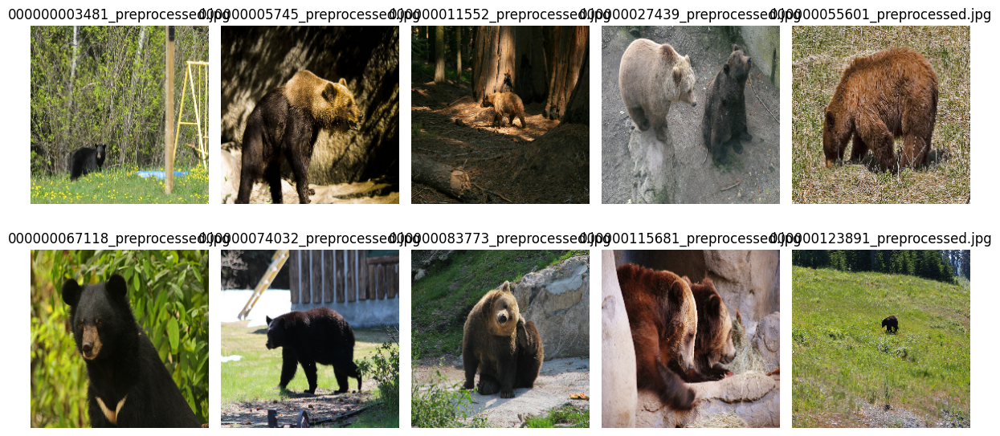

In [ ]:
# Sample data (replace this with your DataFrame)
df_animal = pd.DataFrame({
    'image_file': df_animal["image_file"],
    'memoscore': df_animal["memorability_wo_fa_correction"]
})

# Create a new column to store the paths of preprocessed images
df_animal['preprocessed_image_path'] = ''

# Empty lists to store preprocessed images
images = []

# Load and preprocess images
for index, row in df_animal.iterrows():
    image_path = row['image_file']
    image = cv2.imread(image_path)

    if image is None:
        print(f"Error reading image: {image_path}")
        continue

    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = cv2.resize(image, (224, 224))  # Resize image if necessary

    # Save preprocessed image to the same path
    preprocessed_path = os.path.splitext(image_path)[0] + '_preprocessed.jpg'
    cv2.imwrite(preprocessed_path, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))

    # Store preprocessed image path in the DataFrame
    df_animal.at[index, 'preprocessed_image_path'] = preprocessed_path

    images.append(image)

# Convert the list of images into a NumPy array
images = np.array(images)

# Save preprocessed images as NumPy array (if needed)
#np.save('/content/drive/MyDrive/your_folder/preprocessed_images.npy', images)

# Calculate basic image statistics
print('Image shape:', images.shape)
print('Minimum pixel value:', np.min(images))
print('Maximum pixel value:', np.max(images))
print('Mean pixel value:', np.mean(images))
print('Standard deviation of pixel values:', np.std(images))

# Visualize sample images
fig, axes = plt.subplots(2, 5, figsize=(12, 6))
axes = axes.flatten()
for i in range(min(10, len(images))):
    axes[i].imshow(images[i])
    axes[i].axis('off')
    axes[i].set_title(os.path.basename(df_animal.at[i, 'preprocessed_image_path']))  # Display file name as title
plt.tight_layout()
plt.show()

# Display the updated DataFrame with preprocessed image paths
#print(df_landscape)

In [ ]:
df_animal.head()

,image_file,memoscore,preprocessed_image_path
0,/content/animal/000000003481.jpg,0.561224,/content/animal/000000003481_preprocessed.jpg
1,/content/animal/000000005745.jpg,0.790123,/content/animal/000000005745_preprocessed.jpg
2,/content/animal/000000011552.jpg,0.721154,/content/animal/000000011552_preprocessed.jpg
3,/content/animal/000000027439.jpg,0.807018,/content/animal/000000027439_preprocessed.jpg
4,/content/animal/000000055601.jpg,0.813725,/content/animal/000000055601_preprocessed.jpg


In [ ]:
del df_animal["image_file"]

In [ ]:
df_animal.head()

,memoscore,preprocessed_image_path
0,0.561224,/content/animal/000000003481_preprocessed.jpg
1,0.790123,/content/animal/000000005745_preprocessed.jpg
2,0.721154,/content/animal/000000011552_preprocessed.jpg
3,0.807018,/content/animal/000000027439_preprocessed.jpg
4,0.813725,/content/animal/000000055601_preprocessed.jpg


In [ ]:
from sklearn.model_selection import train_test_split

# Split the DataFrame into train and validation sets
X_train, X_val, y_train, y_val = train_test_split(pd.DataFrame(df_animal.drop('memoscore', axis=1)), pd.DataFrame(df_animal['memoscore']), test_size=0.1)

# Split the validation set into validation and test sets
X_val, X_test, y_val, y_test = train_test_split(X_val, y_val, test_size=0.5)

# Print the train, validation, and test set sizes
print('Train set size:', len(X_train))
print('Validation set size:', len(X_val))
print('Test set size:', len(X_test))

Train set size: 1800
Validation set size: 100
Test set size: 100


In [ ]:
X_train.head()

,preprocessed_image_path
1461,/content/animal/n01811909_4142_preprocessed.jpg
84,/content/animal/n02132136_6967_preprocessed.jpg
1880,/content/animal/n02396427_5189_preprocessed.jpg
1486,/content/animal/n01811909_8202_preprocessed.jpg
107,/content/animal/000000077417_preprocessed.jpg


In [ ]:
merged_train_animal= pd.concat([X_train, y_train], axis=1)
merged_train_animal

,preprocessed_image_path,memoscore
1461,/content/animal/n01811909_4142_preprocessed.jpg,0.649485
84,/content/animal/n02132136_6967_preprocessed.jpg,0.917431
1880,/content/animal/n02396427_5189_preprocessed.jpg,0.820000
1486,/content/animal/n01811909_8202_preprocessed.jpg,0.812500
107,/content/animal/000000077417_preprocessed.jpg,0.830000
...,...,...
1370,/content/animal/n02332755_3073_preprocessed.jpg,0.948980
1809,/content/animal/n02396427_10722_preprocessed.jpg,0.933333
208,/content/animal/n01514668_17062_preprocessed.jpg,0.688172
1776,/content/animal/n02355227_15897_preprocessed.jpg,0.857143


In [ ]:
merged_val_animal = pd.concat([X_val, y_val], axis=1)
merged_val_animal

,preprocessed_image_path,memoscore
637,/content/animal/n01846331_2058_preprocessed.jpg,0.782178
1136,/content/animal/000000280422_preprocessed.jpg,0.639175
1906,/content/animal/000000060316_preprocessed.jpg,0.666667
1709,/content/animal/n02355227_12339_preprocessed.jpg,0.825688
548,/content/animal/000000397034_preprocessed.jpg,0.857143
...,...,...
1289,/content/animal/n02129165_9834_preprocessed.jpg,0.835052
1015,/content/animal/n02342885_12487_preprocessed.jpg,0.872549
1389,/content/animal/n02332755_7430_preprocessed.jpg,0.770642
1374,/content/animal/n02332755_4207_preprocessed.jpg,0.882353


In [ ]:
merged_test_animal = pd.concat([X_test, y_test], axis=1)
merged_test_animal

,preprocessed_image_path,memoscore
1296,/content/animal/n02450034_10449_preprocessed.jpg,0.754902
1892,/content/animal/n02396427_8595_preprocessed.jpg,0.846847
146,/content/animal/000000325298_preprocessed.jpg,0.910112
488,/content/animal/n02434954_3412_preprocessed.jpg,0.559140
1053,/content/animal/n02342885_228_preprocessed.jpg,0.922222
...,...,...
17,/content/animal/000000182927_preprocessed.jpg,0.886364
282,/content/animal/n01792640_712_preprocessed.jpg,0.844660
92,/content/animal/n02132580_23336_preprocessed.jpg,0.771429
1878,/content/animal/n02396427_4851_preprocessed.jpg,0.869159


# Save CSV To GGDrive

In [ ]:
# บันทึกตารางเป็นไฟล์ CSV
csv_train_animal = '/content/drive/MyDrive/IS/MemCat_data/dataproject/train/animal_ResNet.csv'
merged_train_animal.to_csv(csv_train_animal, index=False)

In [ ]:
csv_val_animal = '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/animal_ResNet.csv'
merged_val_animal.to_csv(csv_val_animal, index=False)

In [ ]:
csv_test_animal = '/content/drive/MyDrive/IS/MemCat_data/dataproject/test/animal_ResNet.csv'
merged_test_animal.to_csv(csv_test_animal, index=False)

#Load Dataset

In [ ]:
df_train_animal = pd.read_csv("/content/drive/MyDrive/IS/MemCat_data/dataproject/train/animal_ResNet.csv")
df_val_animal = pd.read_csv( '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/animal_ResNet.csv')
df_test_animal = pd.read_csv('/content/drive/MyDrive/IS/MemCat_data/dataproject/test/animal_ResNet.csv')

In [ ]:
df_train_animal.head()

,preprocessed_image_path,memoscore
0,/content/animal/n02332755_5511_preprocessed.jpg,0.811111
1,/content/animal/000000566598_preprocessed.jpg,0.873684
2,/content/animal/n02324045_7660_preprocessed.jpg,0.881188
3,/content/animal/000000233383_preprocessed.jpg,0.796460
4,/content/animal/000000301697_preprocessed.jpg,0.892157


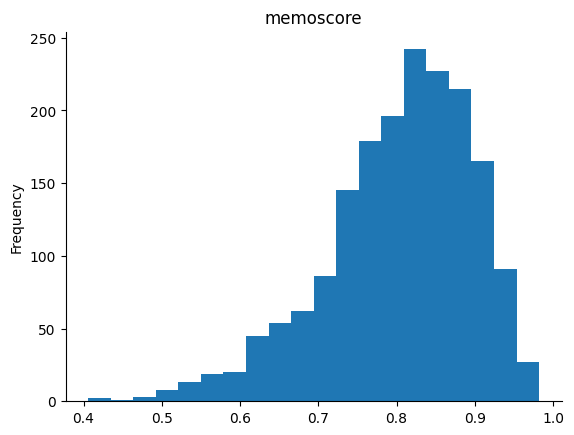

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
df_train_animal['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
df_train_animal.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1800 entries, 0 to 1799
Data columns (total 2 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   preprocessed_image_path  1800 non-null   object 
 1   memoscore                1800 non-null   float64
dtypes: float64(1), object(1)
memory usage: 28.2+ KB


#Load Pretrain

In [ ]:
# Define function to add data/model in to GPU (cuda)
def get_default_device():
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
def to_device(data, device):
    # if data is list or tuple, move each of them to device
    if isinstance(data, (list, tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    def __init__(self, dl, device) -> None:
        self.dl = dl
        self.device = device

    def __iter__(self):
        for b in self.dl:
            # yield only execuate when the function is called
            yield to_device(b, self. device)

    def __len__(self):
        return len(self.dl)

## Train

In [ ]:
class Dataset_res_animal(Dataset):
    def __init__(self, df,Resnet_transform =None):
        self.labels = df_train_animal["memoscore"]
        self.images = df_train_animal["preprocessed_image_path"]
        self.Resnet_transform  = Resnet_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.Resnet_transform (image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
#trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
Resnet_transform   = ConvNextImageProcessor.from_pretrained("facebook/convnext-tiny-224")

# สร้าง Dataset และ DataLoader
train_ds = Dataset_res_animal(df_train_animal, Resnet_transform =Resnet_transform )
train_dl = DataLoader(train_ds, batch_size=32, shuffle=False)



/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/266 [00:00<?, ?B/s]

In [ ]:
class ResNet_model_train_animal(torch.nn.Module):
    def __init__(self, arch="resnet50.a1_in1k"):    #microsoft/resnet-50
        super().__init__()
        self.arch = arch
        self.res = timm.create_model(self.arch, pretrained=True, num_classes=1)
        #self.res_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))


    def forward(self, x):
        resfeat = self.res(x)
        #adap = self.res_AdaptiveAvgPool(x)
        out = torch.sigmoid(resfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

ResNet = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_res =  ResNet_model_train_animal( arch="resnet50.a1_in1k")


model.safetensors:   0%|          | 0.00/102M [00:00<?, ?B/s]

In [ ]:
# Assuming your model is an instance of YourModelClass and is already on GPU
model =ResNet_model_train_animal().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)




----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]           4,096
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
         Identity-10           [-1, 64, 56, 56]               0
             ReLU-11           [-1, 64, 56, 56]               0
         Identity-12           [-1, 64, 56, 56]               0
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 256,

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model_res  = to_device(model_res  , device)

In [ ]:
params = [param for param in list(model_res.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-4)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)


In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/50) Loss = 0.021456096321344376

 Epoch: (1/50) Loss_rmse = 0.14647899568080902

 Epoch: (1/50) R^2 = -6.512317180633545

 Epoch: (1/50) MAE = 0.12353689968585968
Spearman correlation coefficient: SignificanceResult(statistic=0.09618960858721452, pvalue=4.5323425710243525e-05)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.8

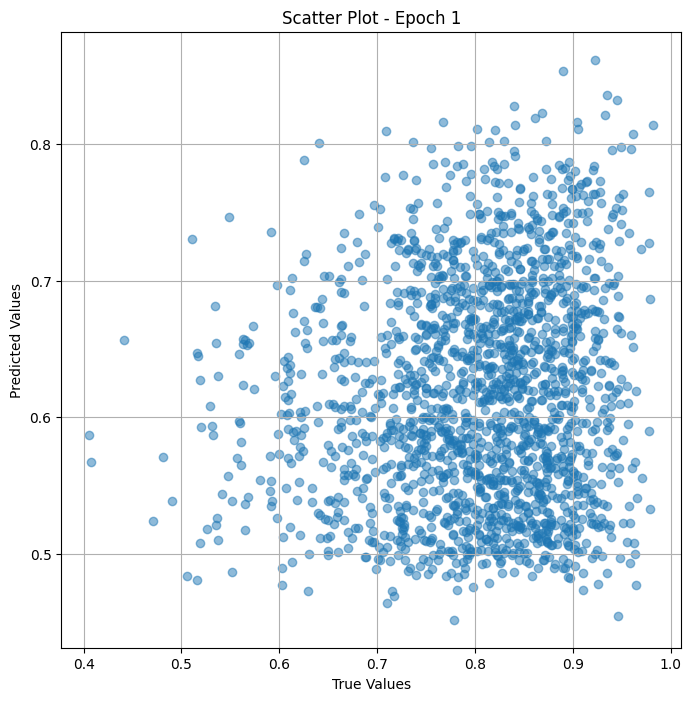

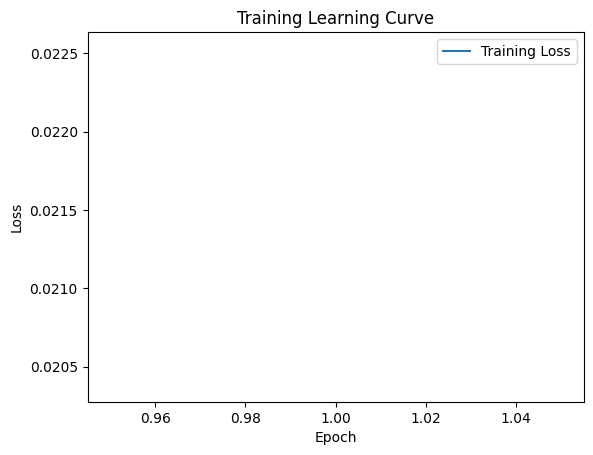


 Epoch: (2/50) Loss = 0.002150351880118251

 Epoch: (2/50) Loss_rmse = 0.04637188836932182

 Epoch: (2/50) R^2 = 0.24710792303085327

 Epoch: (2/50) MAE = 0.04377816617488861
Spearman correlation coefficient: SignificanceResult(statistic=0.5564917759663176, pvalue=3.005176826523235e-146)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.8

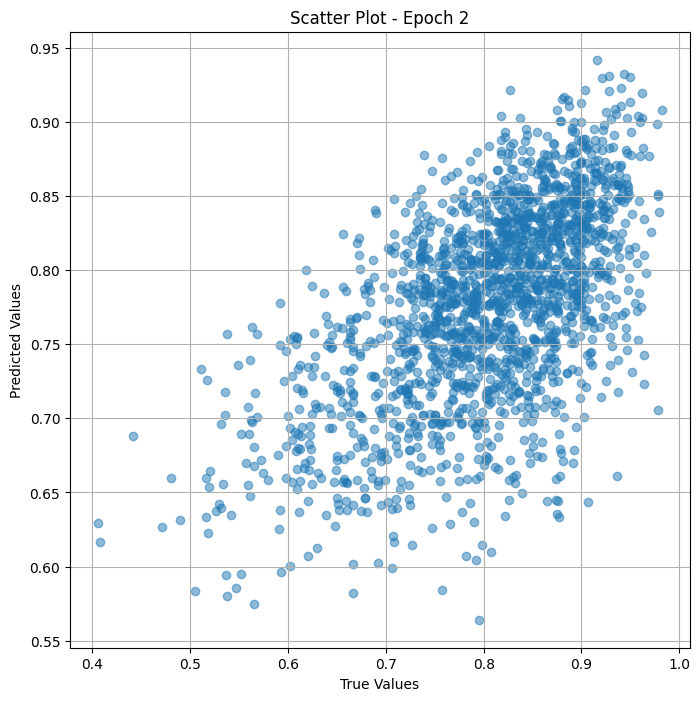

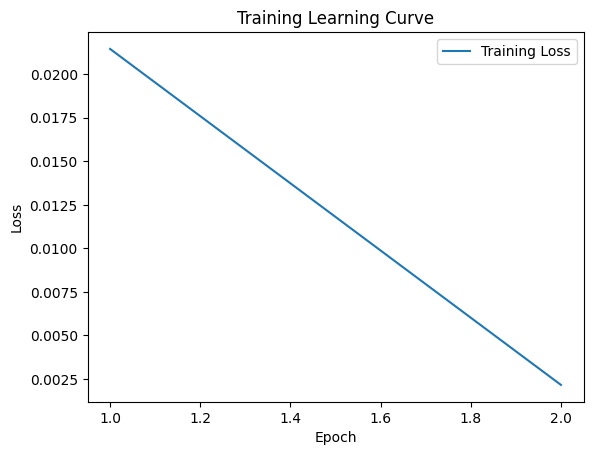


 Epoch: (3/50) Loss = 0.0009253727039322257

 Epoch: (3/50) Loss_rmse = 0.030419940128922462

 Epoch: (3/50) R^2 = 0.6760038137435913

 Epoch: (3/50) MAE = 0.027832381427288055
Spearman correlation coefficient: SignificanceResult(statistic=0.8722012073116275, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 0.7

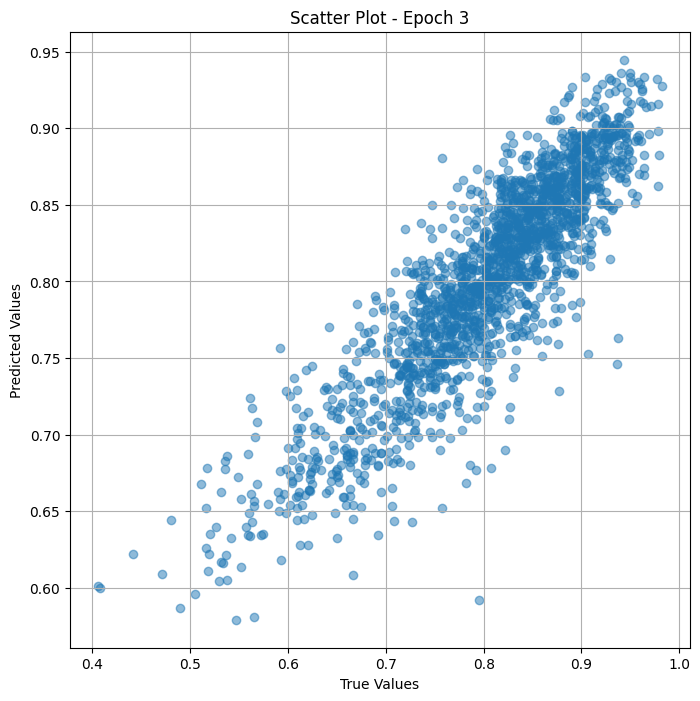

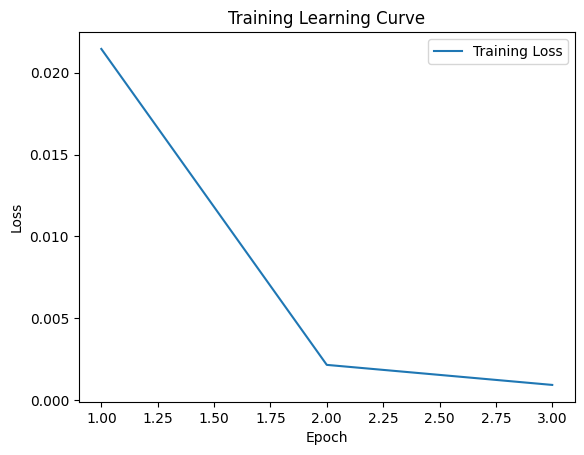


 Epoch: (4/50) Loss = 0.0006715703057125211

 Epoch: (4/50) Loss_rmse = 0.025914672762155533

 Epoch: (4/50) R^2 = 0.7648664116859436

 Epoch: (4/50) MAE = 0.022822007536888123
Spearman correlation coefficient: SignificanceResult(statistic=0.9568548645348312, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 0.7

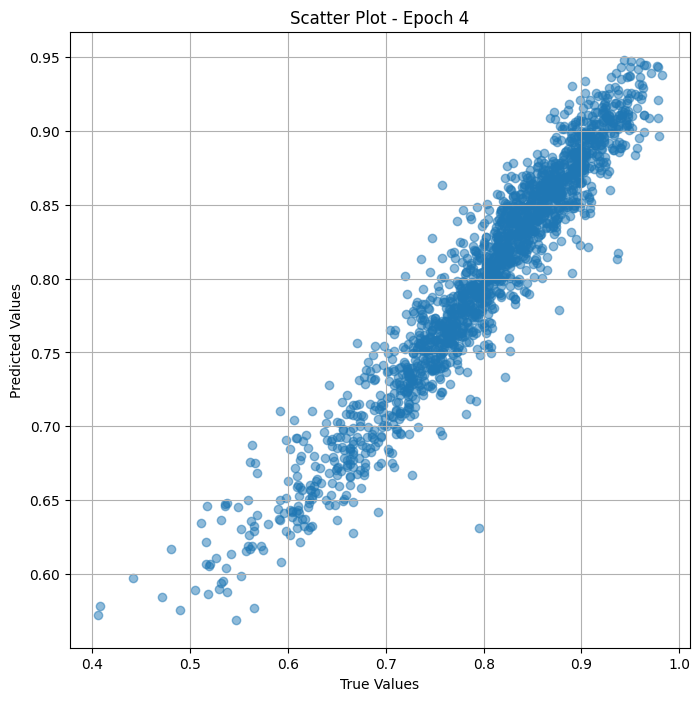

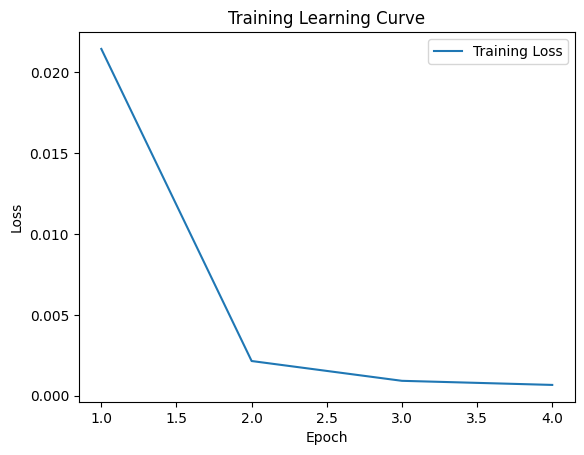


 Epoch: (5/50) Loss = 0.0007679716218262911

 Epoch: (5/50) Loss_rmse = 0.027712300419807434

 Epoch: (5/50) R^2 = 0.7311139106750488

 Epoch: (5/50) MAE = 0.02046079933643341
Spearman correlation coefficient: SignificanceResult(statistic=0.9812765666581729, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 0.77

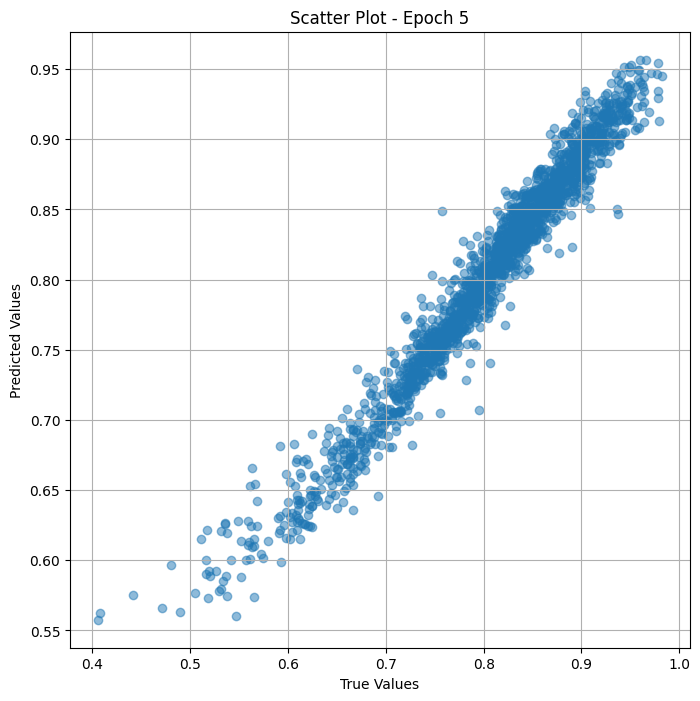

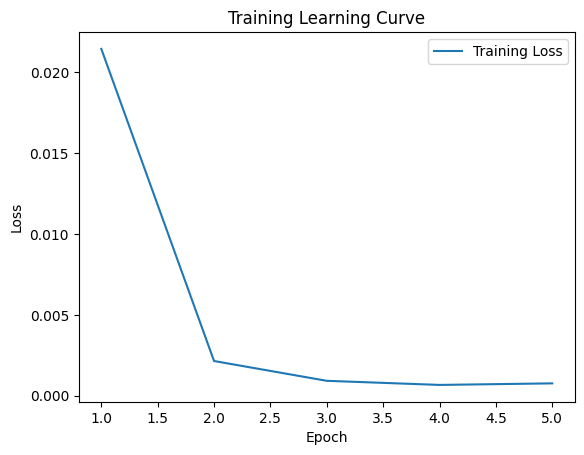


 Epoch: (6/50) Loss = 0.0011739531764760613

 Epoch: (6/50) Loss_rmse = 0.0342629998922348

 Epoch: (6/50) R^2 = 0.5889695882797241

 Epoch: (6/50) MAE = 0.026521727442741394
Spearman correlation coefficient: SignificanceResult(statistic=0.9899170990797256, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 0.775

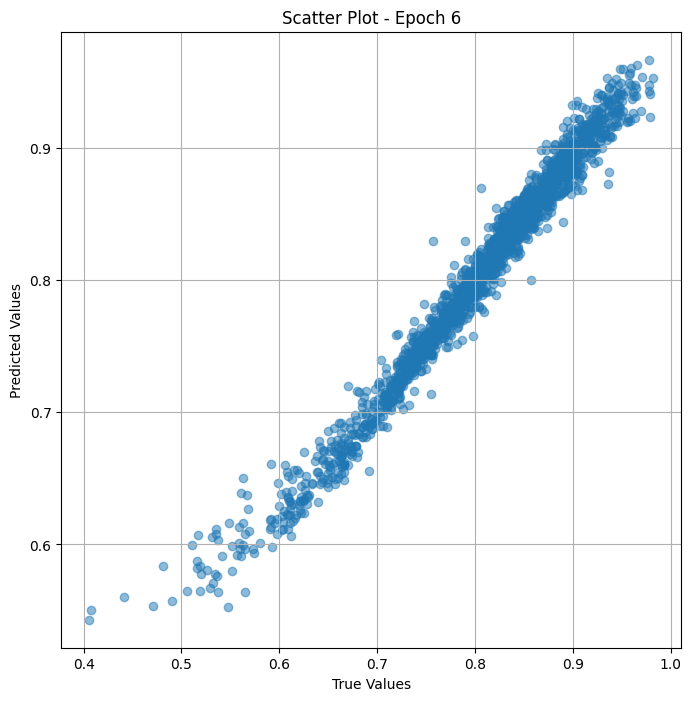

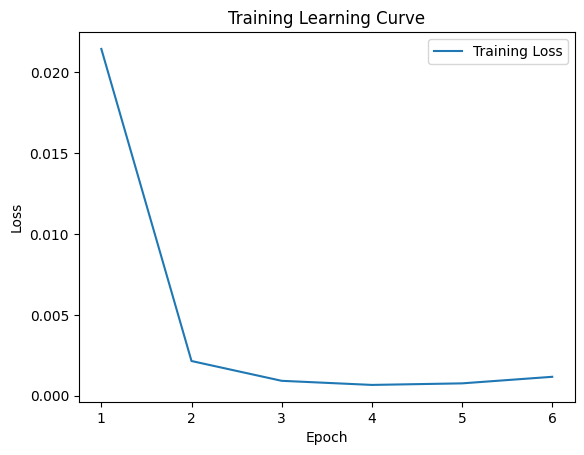

Epoch 0.03: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (7/50) Loss = 0.0011786980321630836

 Epoch: (7/50) Loss_rmse = 0.03433217108249664

 Epoch: (7/50) R^2 = 0.5873082876205444

 Epoch: (7/50) MAE = 0.02441990375518799
Spearman correlation coefficient: SignificanceResult(statistic=0.9934907505514207, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.721649

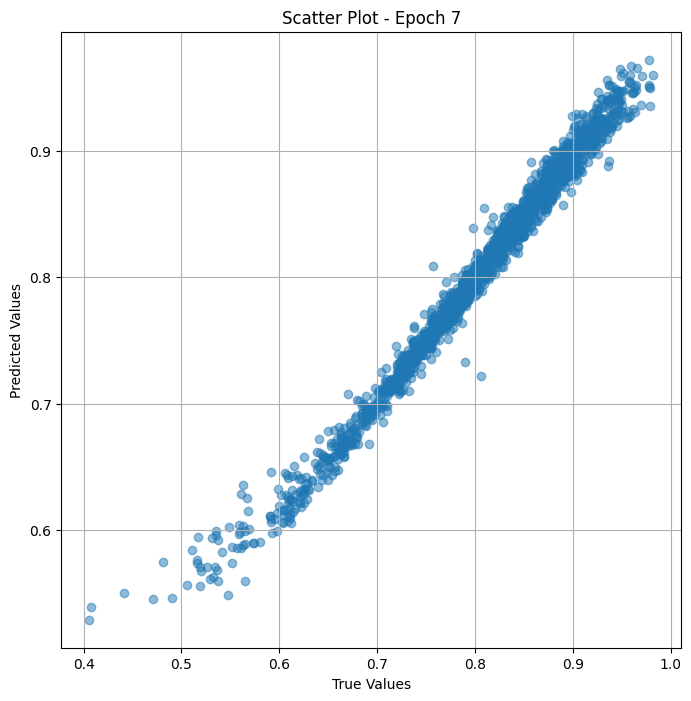

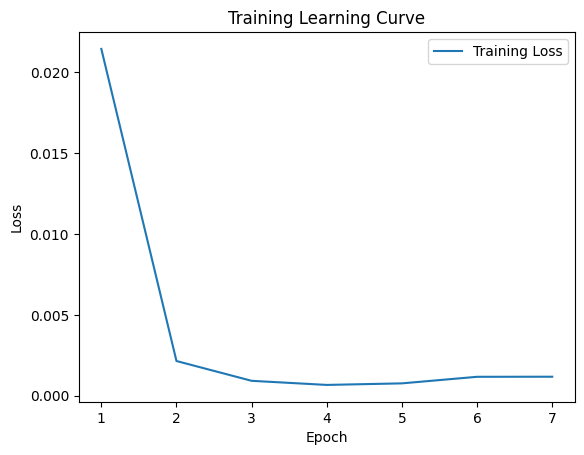


 Epoch: (8/50) Loss = 0.0003200751089025289

 Epoch: (8/50) Loss_rmse = 0.01789064332842827

 Epoch: (8/50) R^2 = 0.8879336714744568

 Epoch: (8/50) MAE = 0.011509113013744354
Spearman correlation coefficient: SignificanceResult(statistic=0.9950003798914001, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 0.77

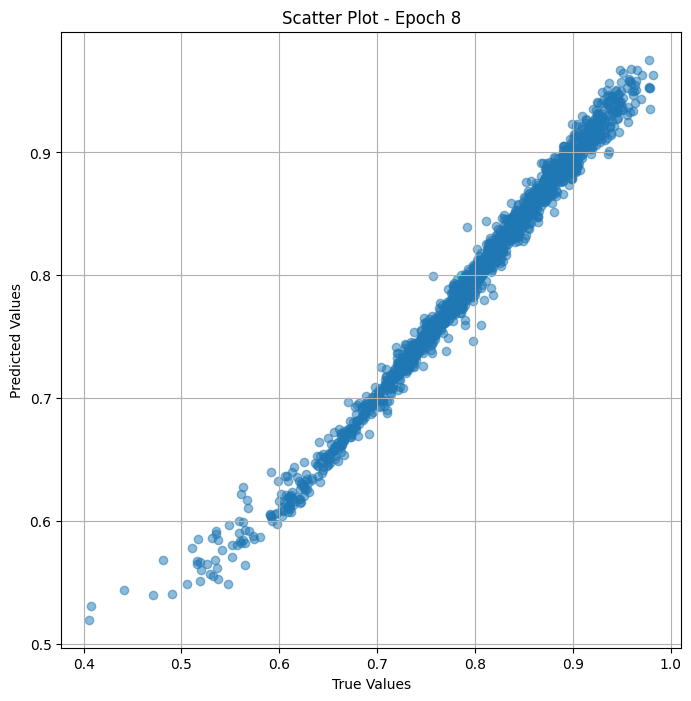

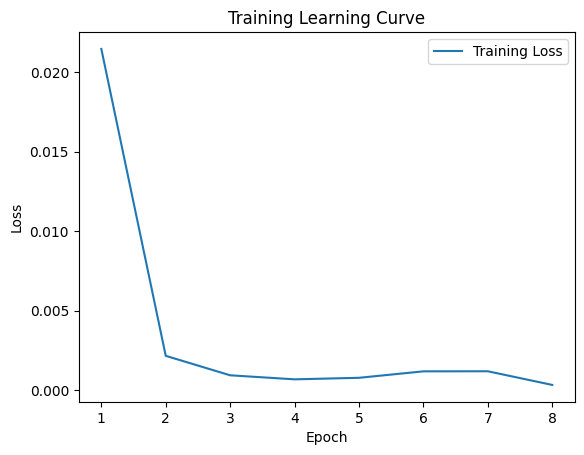


 Epoch: (9/50) Loss = 0.00019349373178556561

 Epoch: (9/50) Loss_rmse = 0.01391020230948925

 Epoch: (9/50) R^2 = 0.9322530031204224

 Epoch: (9/50) MAE = 0.009024403989315033
Spearman correlation coefficient: SignificanceResult(statistic=0.9962065802787596, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 0.7

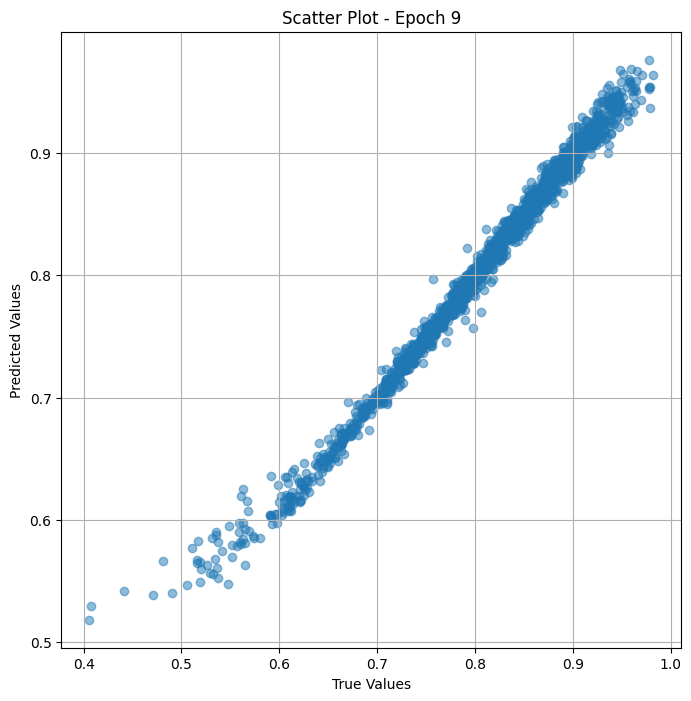

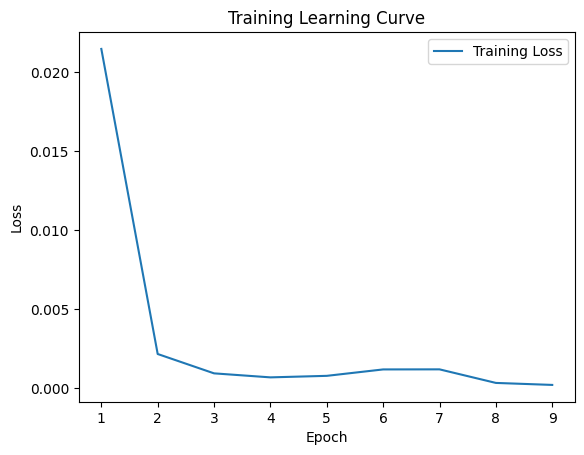


 Epoch: (10/50) Loss = 0.00011618844291660935

 Epoch: (10/50) Loss_rmse = 0.010779074393212795

 Epoch: (10/50) R^2 = 0.959319531917572

 Epoch: (10/50) MAE = 0.007266908884048462
Spearman correlation coefficient: SignificanceResult(statistic=0.9968626210397231, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124,

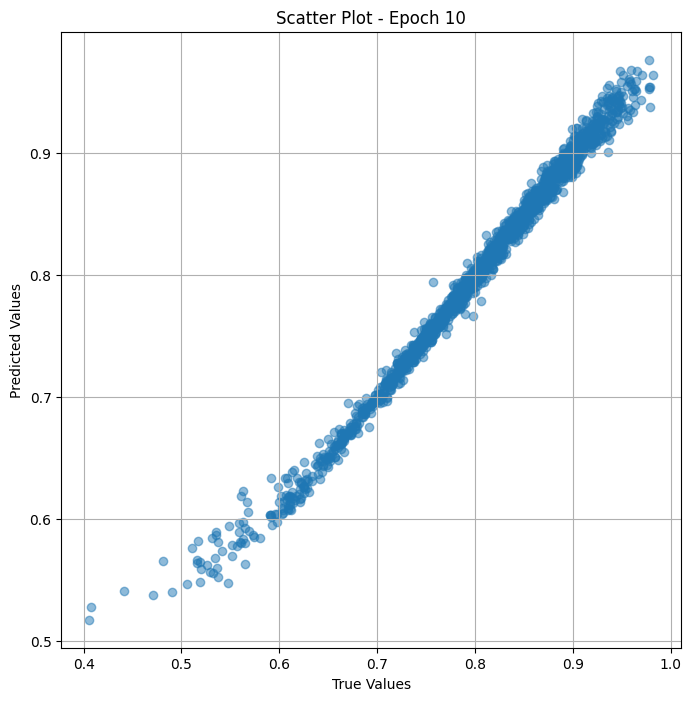

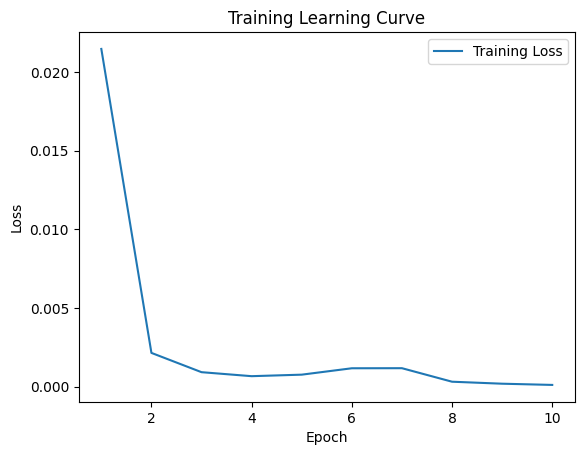


 Epoch: (11/50) Loss = 7.05590719007887e-05

 Epoch: (11/50) Loss_rmse = 0.008399944752454758

 Epoch: (11/50) R^2 = 0.9752954840660095

 Epoch: (11/50) MAE = 0.005987048149108887
Spearman correlation coefficient: SignificanceResult(statistic=0.9972783820041106, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 

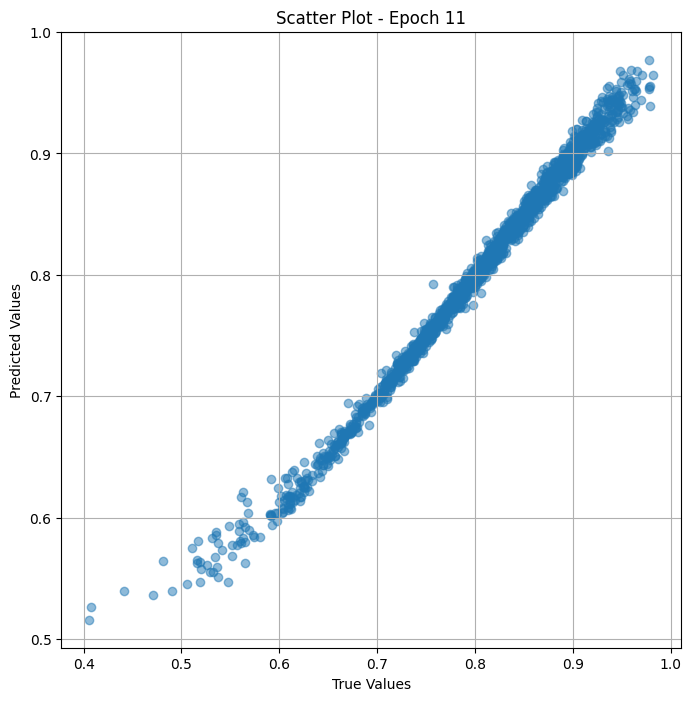

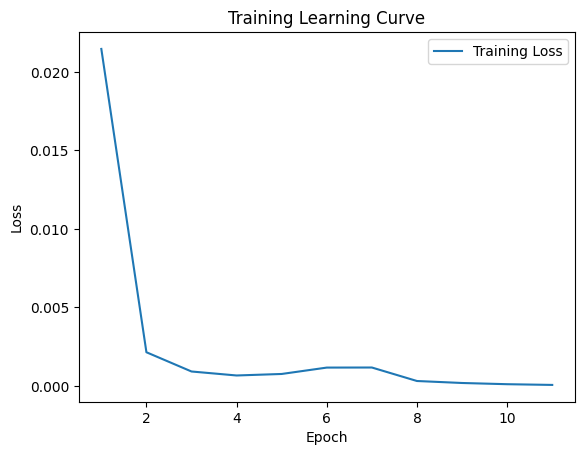


 Epoch: (12/50) Loss = 4.4220178097020835e-05

 Epoch: (12/50) Loss_rmse = 0.006649825256317854

 Epoch: (12/50) R^2 = 0.9845173954963684

 Epoch: (12/50) MAE = 0.0050279125571250916
Spearman correlation coefficient: SignificanceResult(statistic=0.9975648751884512, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.752212

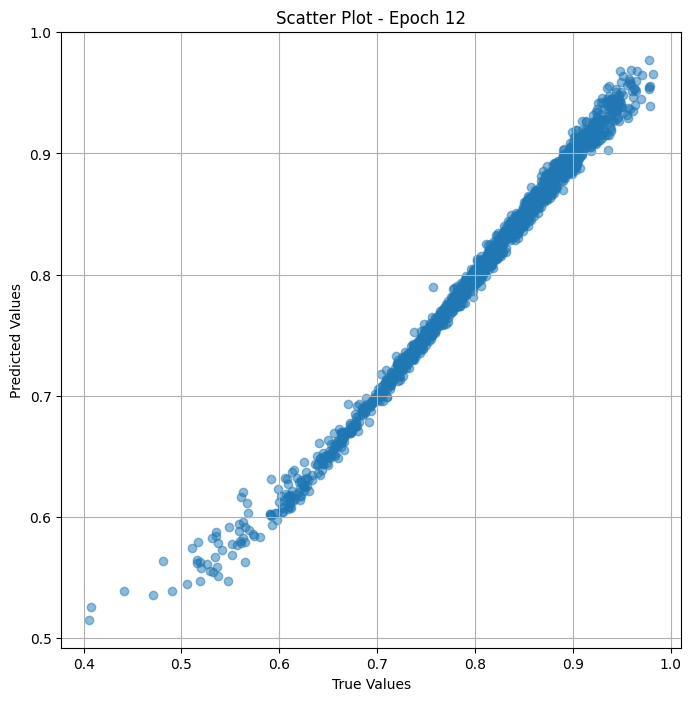

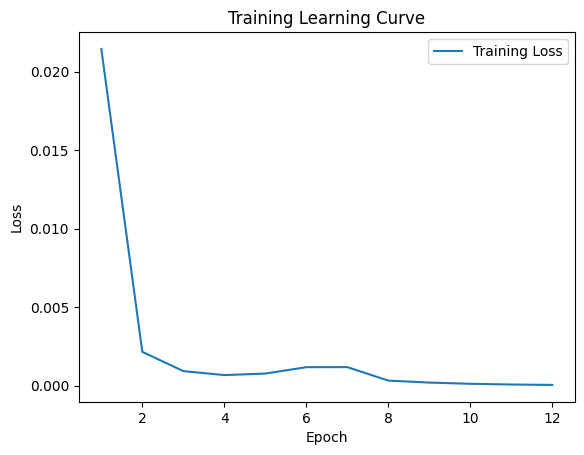


 Epoch: (13/50) Loss = 2.9399672712315805e-05

 Epoch: (13/50) Loss_rmse = 0.005422146525233984

 Epoch: (13/50) R^2 = 0.9897064566612244

 Epoch: (13/50) MAE = 0.004349999129772186
Spearman correlation coefficient: SignificanceResult(statistic=0.9977942186263817, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124

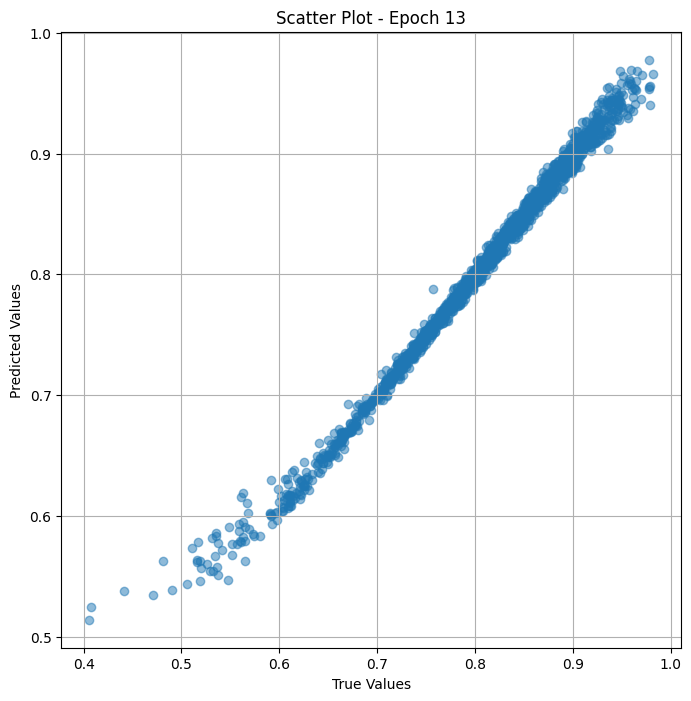

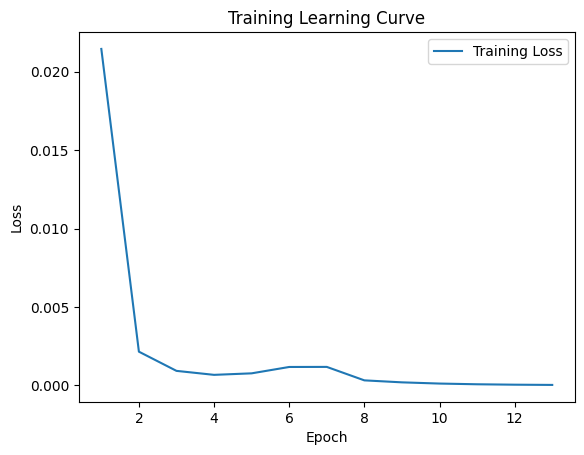


 Epoch: (14/50) Loss = 2.1329953597160056e-05

 Epoch: (14/50) Loss_rmse = 0.004618436098098755

 Epoch: (14/50) R^2 = 0.9925318360328674

 Epoch: (14/50) MAE = 0.004035539925098419
Spearman correlation coefficient: SignificanceResult(statistic=0.9979665572462892, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124

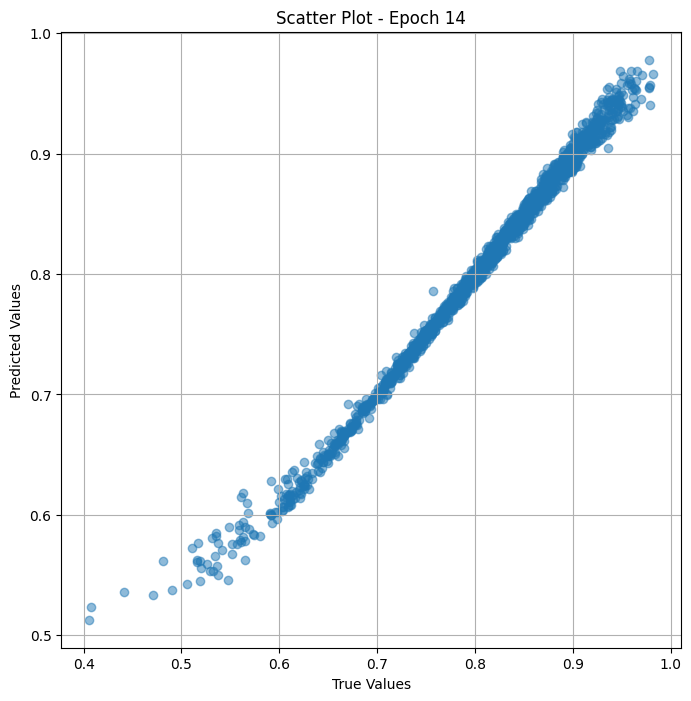

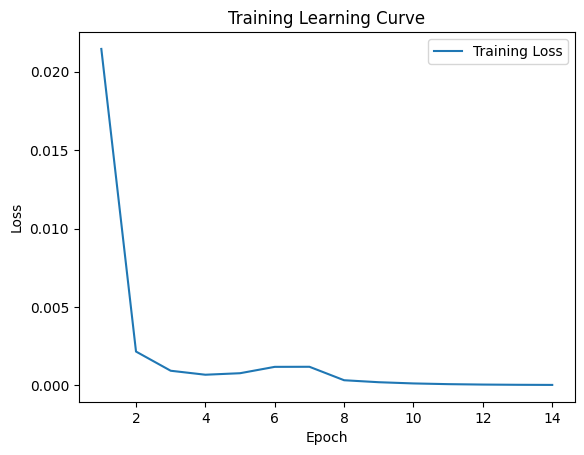


 Epoch: (15/50) Loss = 1.6579033399466425e-05

 Epoch: (15/50) Loss_rmse = 0.00407173577696085

 Epoch: (15/50) R^2 = 0.994195282459259

 Epoch: (15/50) MAE = 0.0037532970309257507
Spearman correlation coefficient: SignificanceResult(statistic=0.9981339933236693, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124,

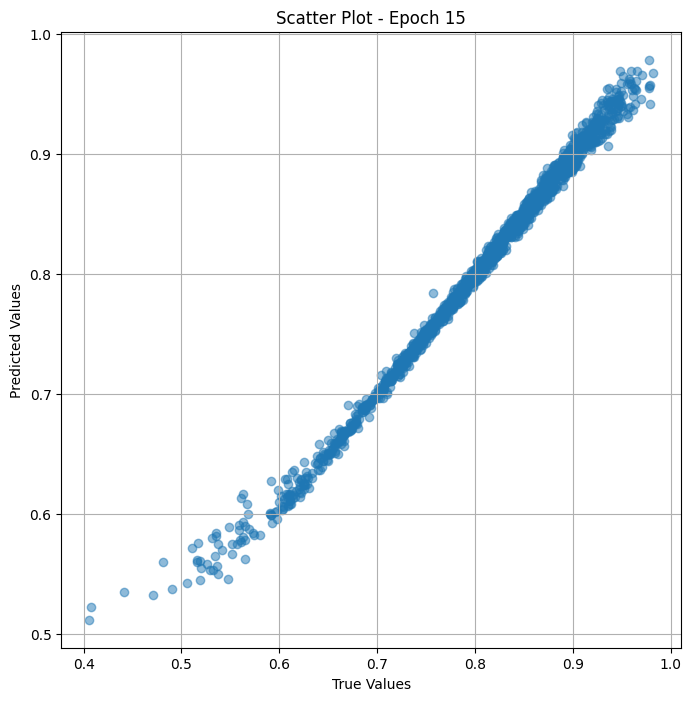

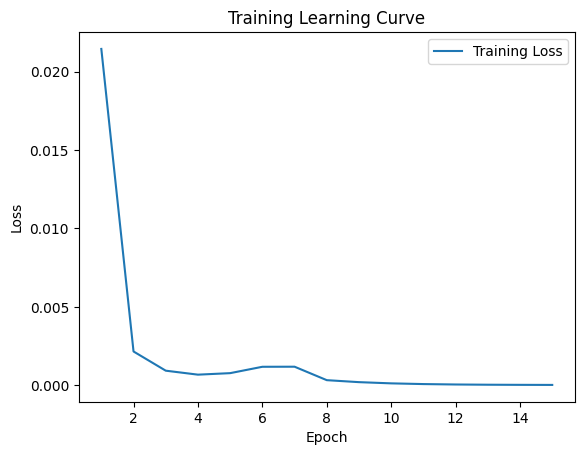


 Epoch: (16/50) Loss = 1.353007428406272e-05

 Epoch: (16/50) Loss_rmse = 0.0036783248651772738

 Epoch: (16/50) R^2 = 0.9952628016471863

 Epoch: (16/50) MAE = 0.0034909620881080627
Spearman correlation coefficient: SignificanceResult(statistic=0.9982797172538472, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.752212

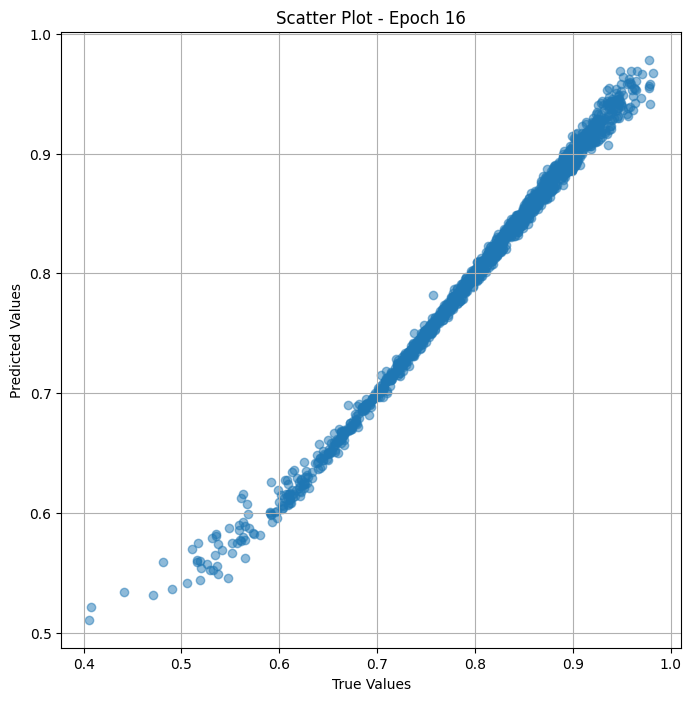

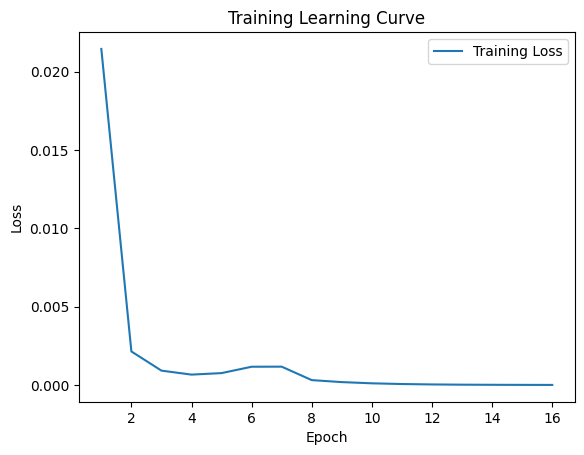


 Epoch: (17/50) Loss = 1.135008096753154e-05

 Epoch: (17/50) Loss_rmse = 0.0033689881674945354

 Epoch: (17/50) R^2 = 0.9960260391235352

 Epoch: (17/50) MAE = 0.00324220210313797
Spearman correlation coefficient: SignificanceResult(statistic=0.9984044442919829, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124,

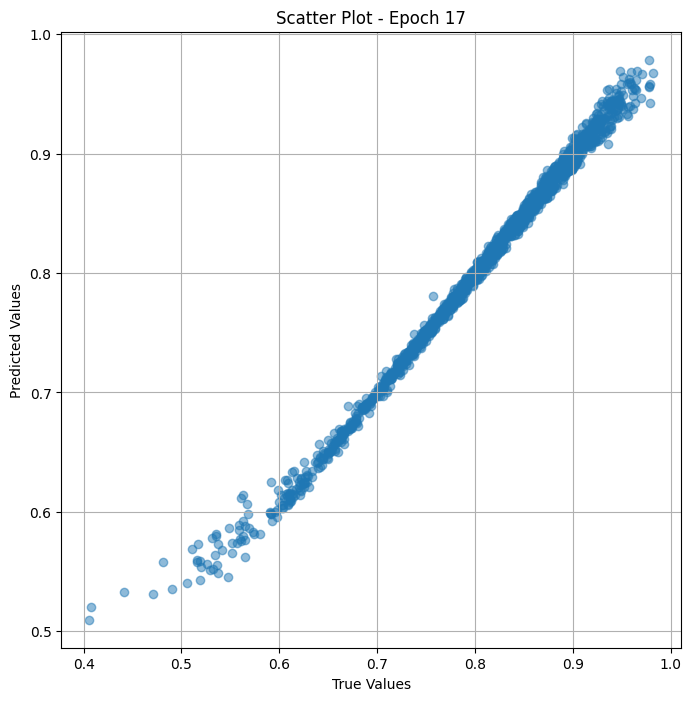

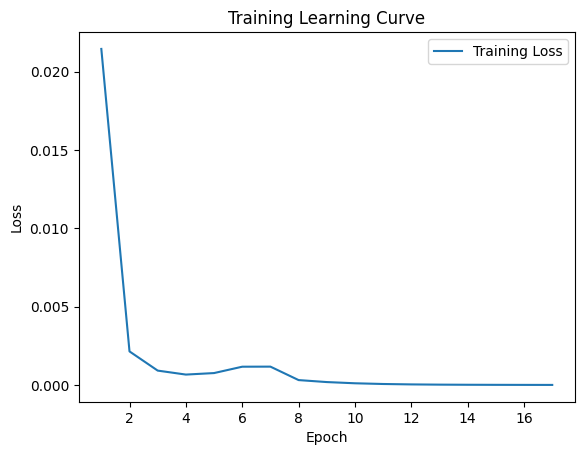


 Epoch: (18/50) Loss = 9.639026757213287e-06

 Epoch: (18/50) Loss_rmse = 0.0031046781223267317

 Epoch: (18/50) R^2 = 0.9966251254081726

 Epoch: (18/50) MAE = 0.0030087754130363464
Spearman correlation coefficient: SignificanceResult(statistic=0.9985220057153901, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.752212

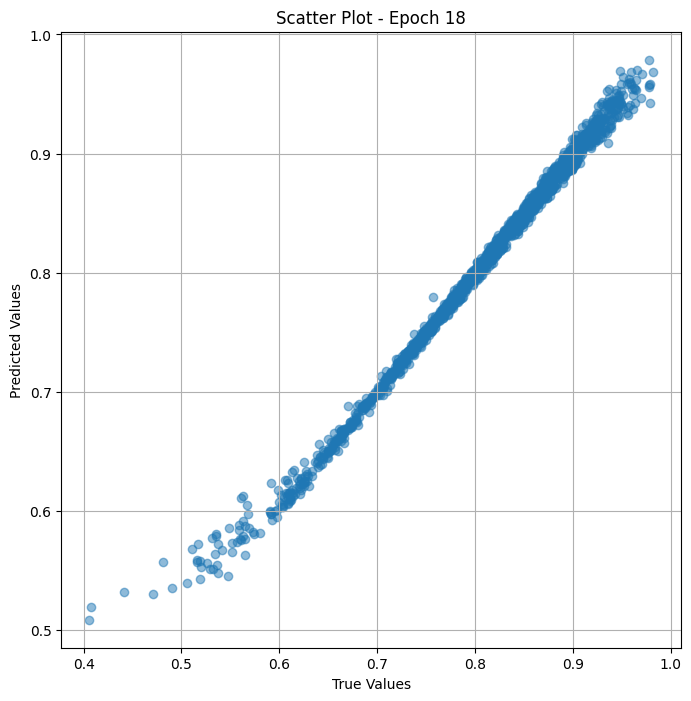

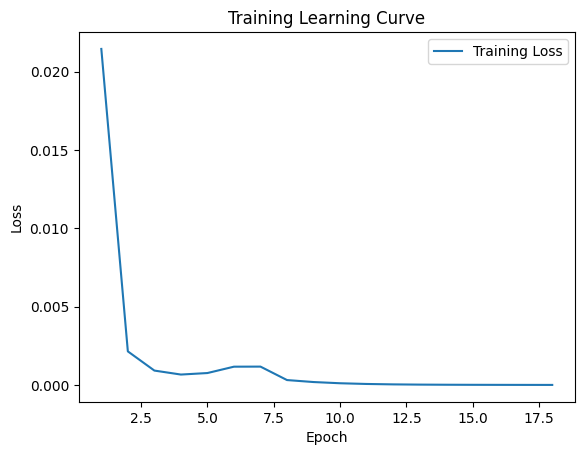


 Epoch: (19/50) Loss = 8.20377954369178e-06

 Epoch: (19/50) Loss_rmse = 0.002864224137738347

 Epoch: (19/50) R^2 = 0.9971276521682739

 Epoch: (19/50) MAE = 0.0027822107076644897
Spearman correlation coefficient: SignificanceResult(statistic=0.9986399748158847, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124,

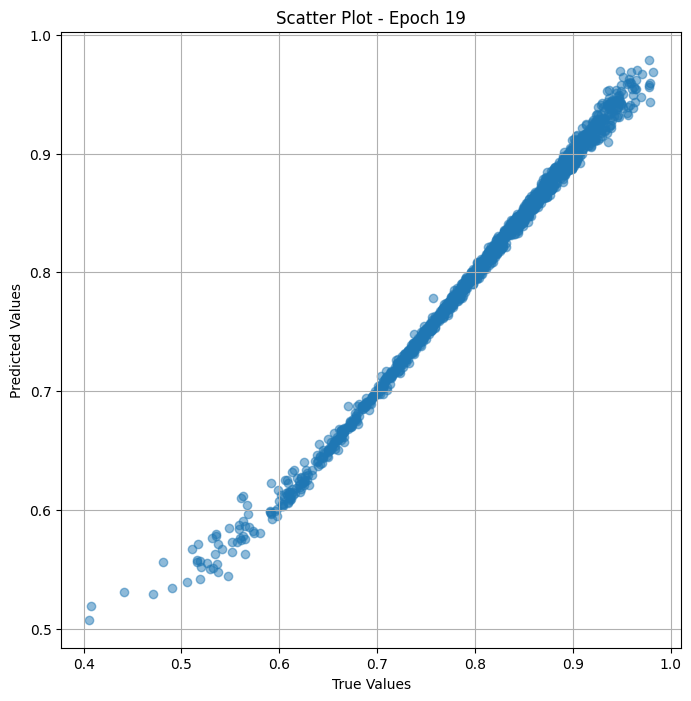

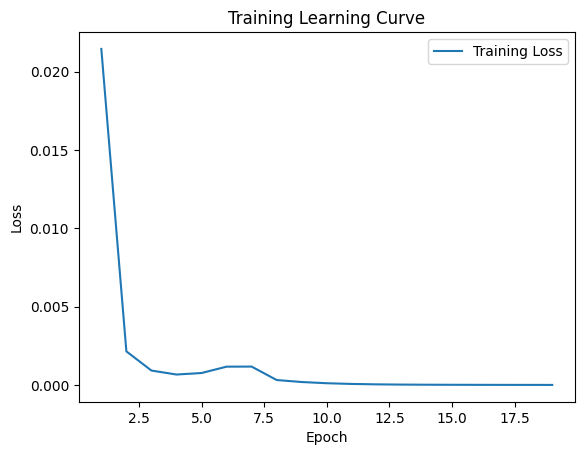


 Epoch: (20/50) Loss = 6.939737431821413e-06

 Epoch: (20/50) Loss_rmse = 0.002634338103234768

 Epoch: (20/50) R^2 = 0.9975702166557312

 Epoch: (20/50) MAE = 0.002560839056968689
Spearman correlation coefficient: SignificanceResult(statistic=0.9987482717711768, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124,

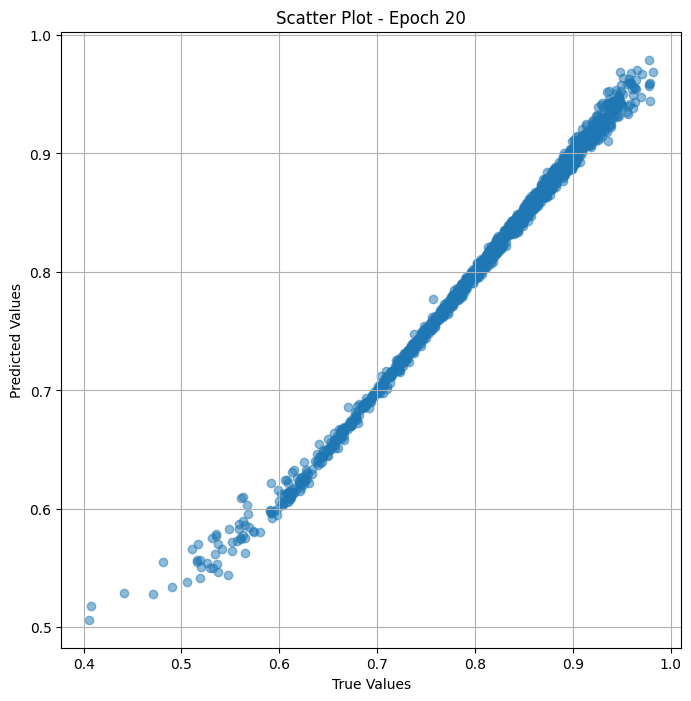

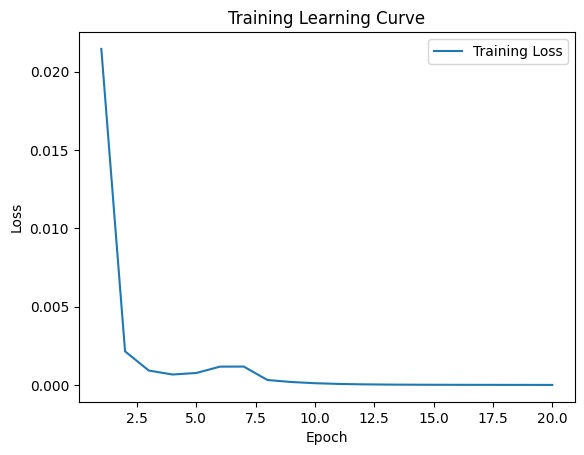


 Epoch: (21/50) Loss = 5.828142093378119e-06

 Epoch: (21/50) Loss_rmse = 0.002414154587313533

 Epoch: (21/50) R^2 = 0.9979594349861145

 Epoch: (21/50) MAE = 0.0023457780480384827
Spearman correlation coefficient: SignificanceResult(statistic=0.9988478365304818, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124

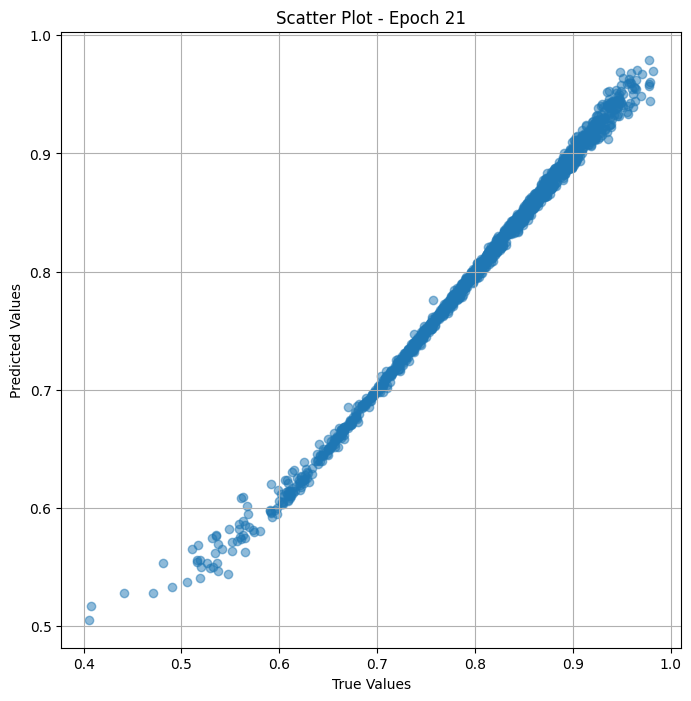

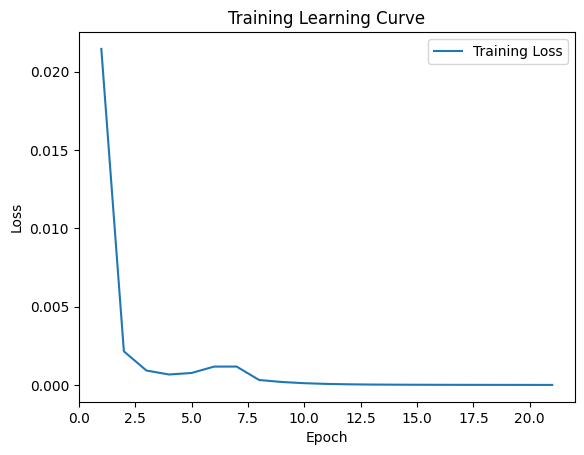


 Epoch: (22/50) Loss = 4.8532783694099635e-06

 Epoch: (22/50) Loss_rmse = 0.0022030158434063196

 Epoch: (22/50) R^2 = 0.9983007311820984

 Epoch: (22/50) MAE = 0.002140730619430542
Spearman correlation coefficient: SignificanceResult(statistic=0.9989411902226996, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.752212

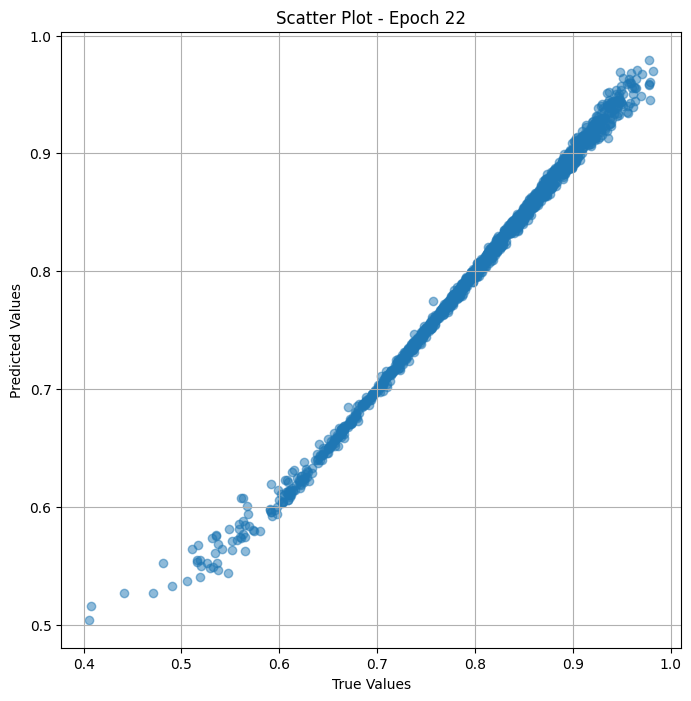

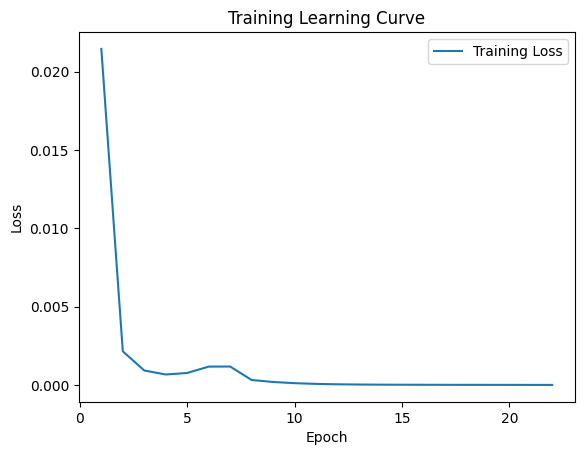


 Epoch: (23/50) Loss = 3.9993442442209926e-06

 Epoch: (23/50) Loss_rmse = 0.0019998359493911266

 Epoch: (23/50) R^2 = 0.9985997080802917

 Epoch: (23/50) MAE = 0.0019411444664001465
Spearman correlation coefficient: SignificanceResult(statistic=0.9990278568763221, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.75221

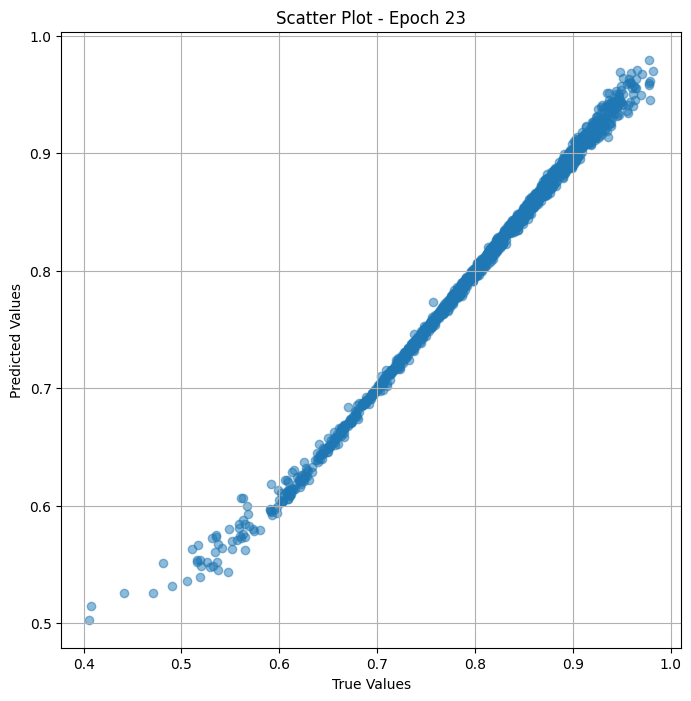

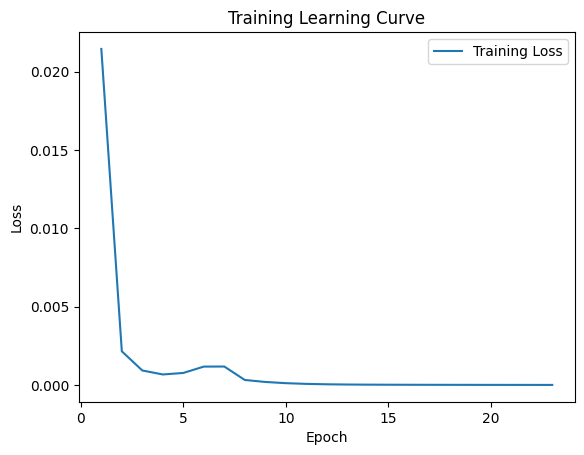


 Epoch: (24/50) Loss = 3.2649254535499495e-06

 Epoch: (24/50) Loss_rmse = 0.0018069104989990592

 Epoch: (24/50) R^2 = 0.9988568425178528

 Epoch: (24/50) MAE = 0.00175447016954422
Spearman correlation coefficient: SignificanceResult(statistic=0.9991072864954612, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124

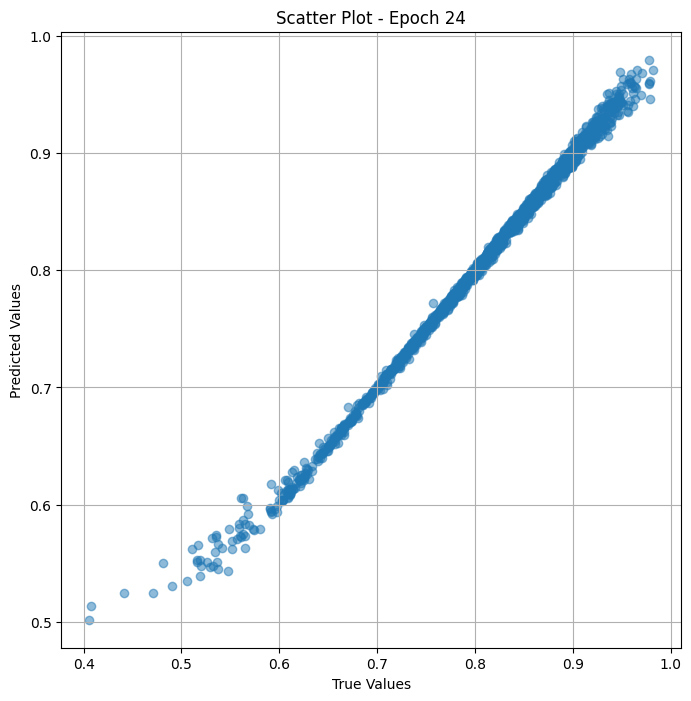

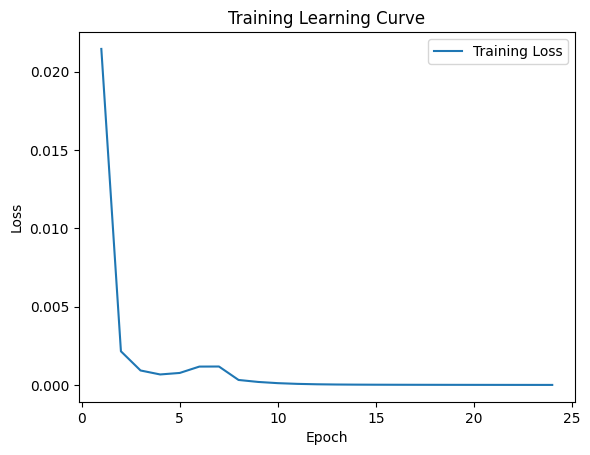


 Epoch: (25/50) Loss = 2.63770289166132e-06

 Epoch: (25/50) Loss_rmse = 0.0016241006087511778

 Epoch: (25/50) R^2 = 0.9990764856338501

 Epoch: (25/50) MAE = 0.001574985682964325
Spearman correlation coefficient: SignificanceResult(statistic=0.9991800415884107, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124,

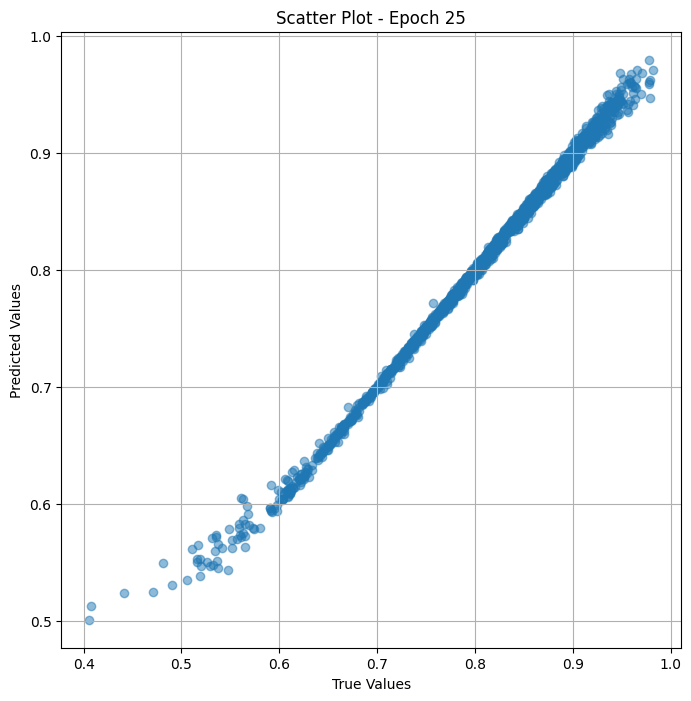

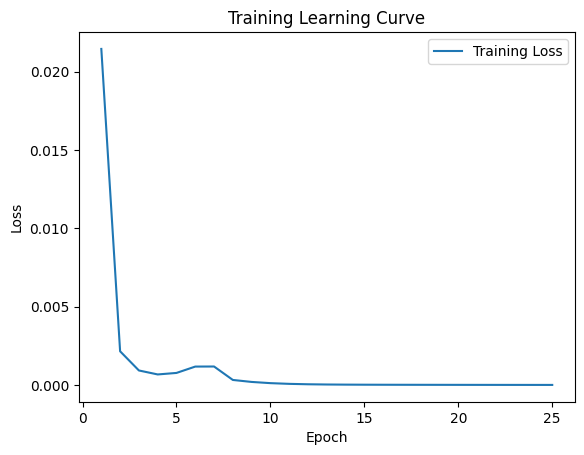


 Epoch: (26/50) Loss = 2.097232481901301e-06

 Epoch: (26/50) Loss_rmse = 0.001448182505555451

 Epoch: (26/50) R^2 = 0.999265730381012

 Epoch: (26/50) MAE = 0.001404888927936554
Spearman correlation coefficient: SignificanceResult(statistic=0.9992487564115773, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 

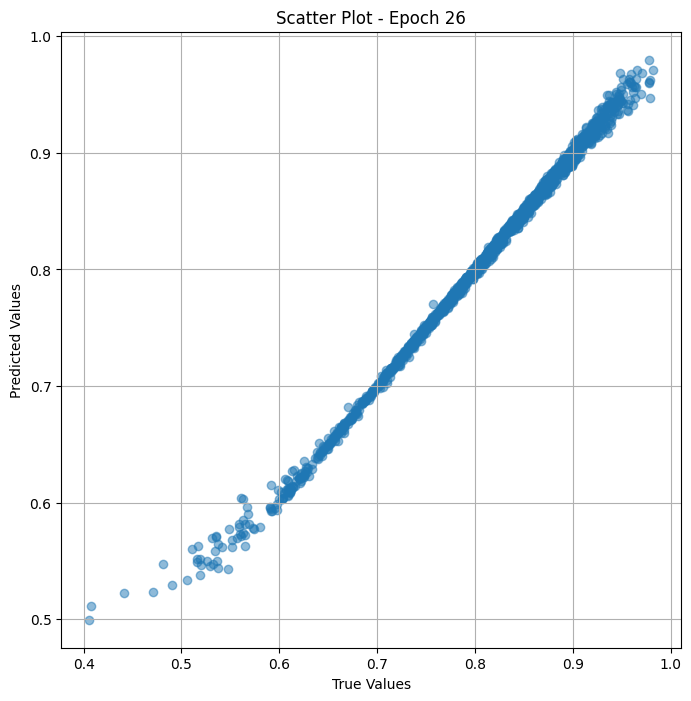

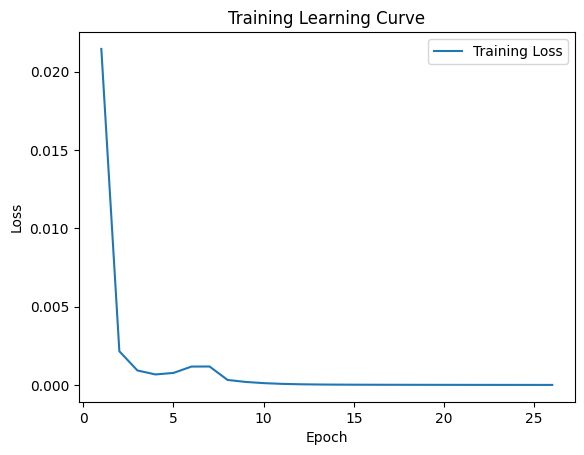


 Epoch: (27/50) Loss = 1.6441847492387751e-06

 Epoch: (27/50) Loss_rmse = 0.0012822577264159918

 Epoch: (27/50) R^2 = 0.9994243383407593

 Epoch: (27/50) MAE = 0.0012435466051101685
Spearman correlation coefficient: SignificanceResult(statistic=0.9993122267039032, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.75221

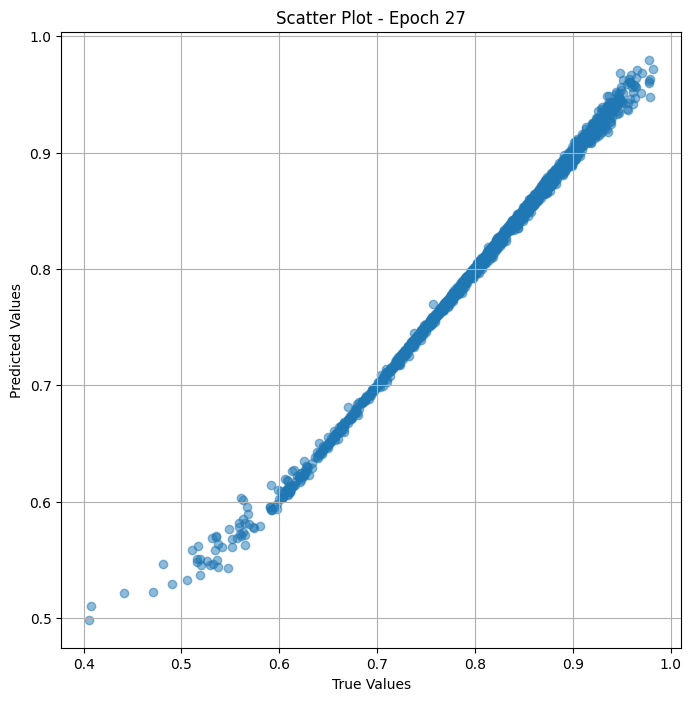

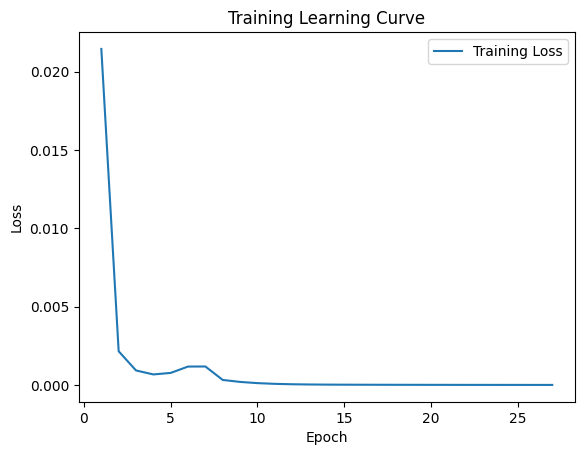


 Epoch: (28/50) Loss = 1.2701009381999029e-06

 Epoch: (28/50) Loss_rmse = 0.0011269875103607774

 Epoch: (28/50) R^2 = 0.9995552897453308

 Epoch: (28/50) MAE = 0.0010907873511314392
Spearman correlation coefficient: SignificanceResult(statistic=0.99937214155882, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124

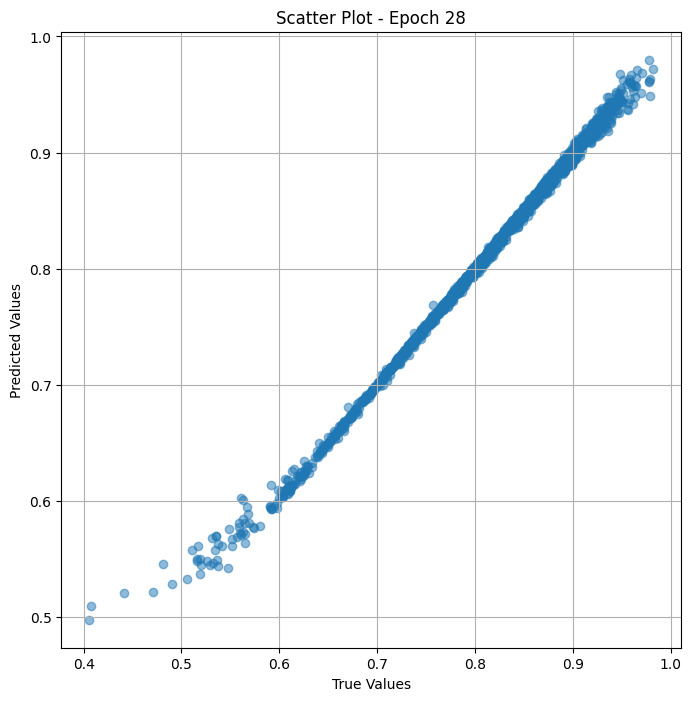

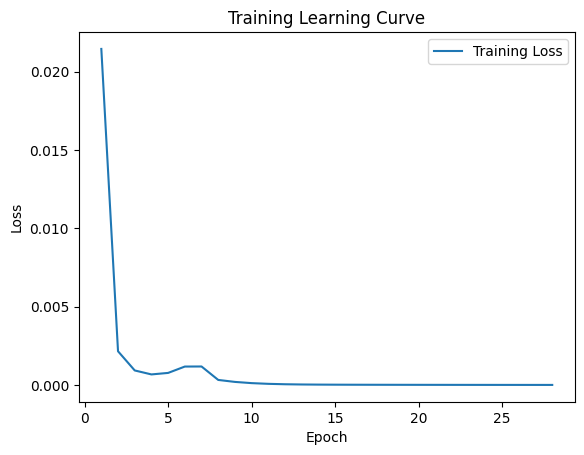


 Epoch: (29/50) Loss = 9.61950945566059e-07

 Epoch: (29/50) Loss_rmse = 0.000980790937319398

 Epoch: (29/50) R^2 = 0.9996631741523743

 Epoch: (29/50) MAE = 0.0009512677788734436
Spearman correlation coefficient: SignificanceResult(statistic=0.9994256524554991, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124,

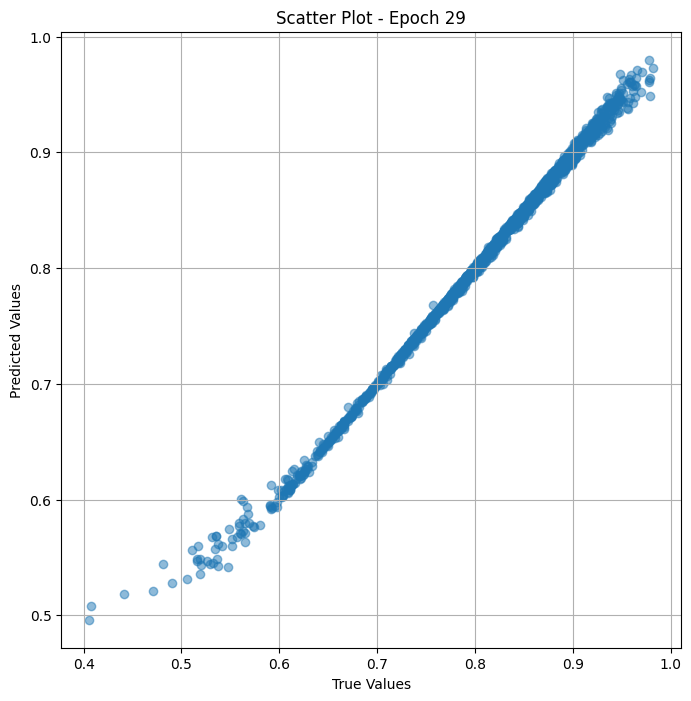

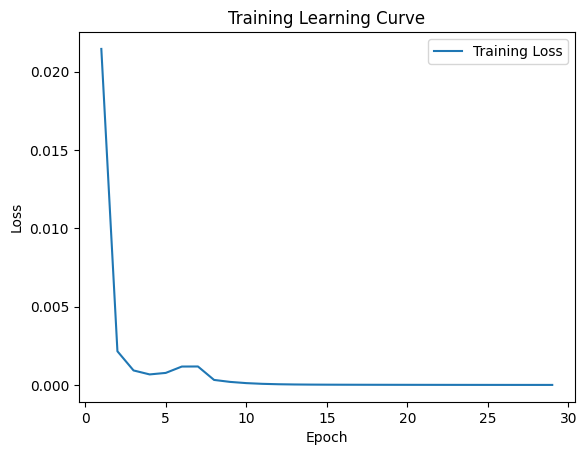


 Epoch: (30/50) Loss = 7.155624075494416e-07

 Epoch: (30/50) Loss_rmse = 0.0008459092350676656

 Epoch: (30/50) R^2 = 0.999749481678009

 Epoch: (30/50) MAE = 0.0008177384734153748
Spearman correlation coefficient: SignificanceResult(statistic=0.999476903929378, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124,

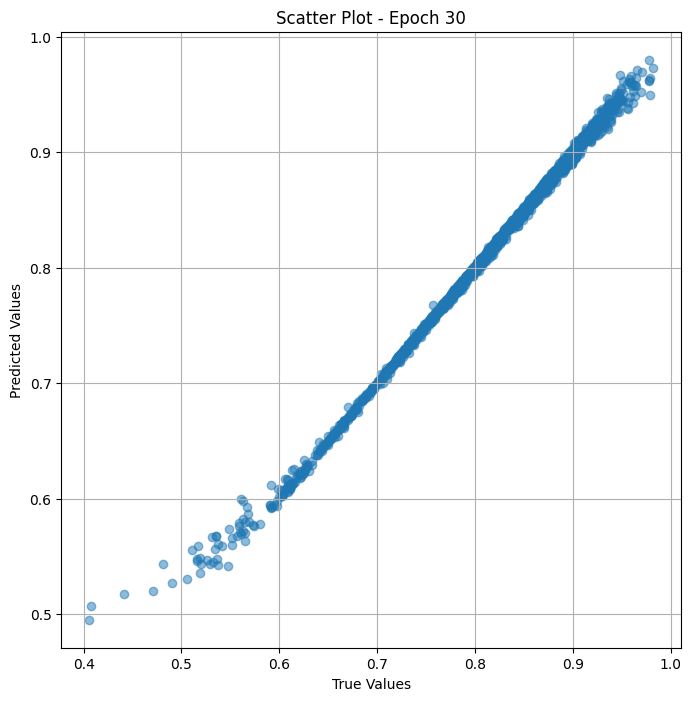

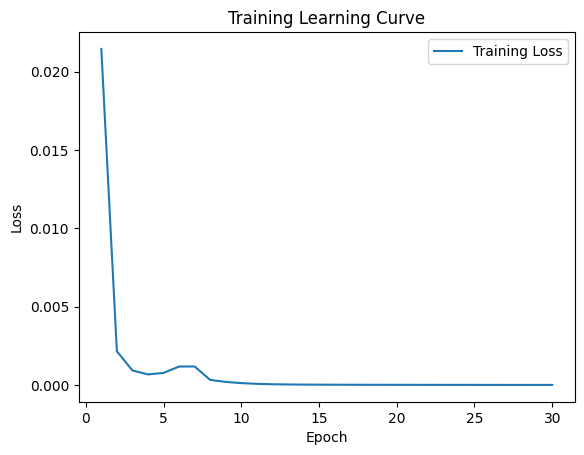


 Epoch: (31/50) Loss = 5.190954652789515e-07

 Epoch: (31/50) Loss_rmse = 0.0007204827852547169

 Epoch: (31/50) R^2 = 0.9998182654380798

 Epoch: (31/50) MAE = 0.0006982535123825073
Spearman correlation coefficient: SignificanceResult(statistic=0.9995199257649506, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.752212

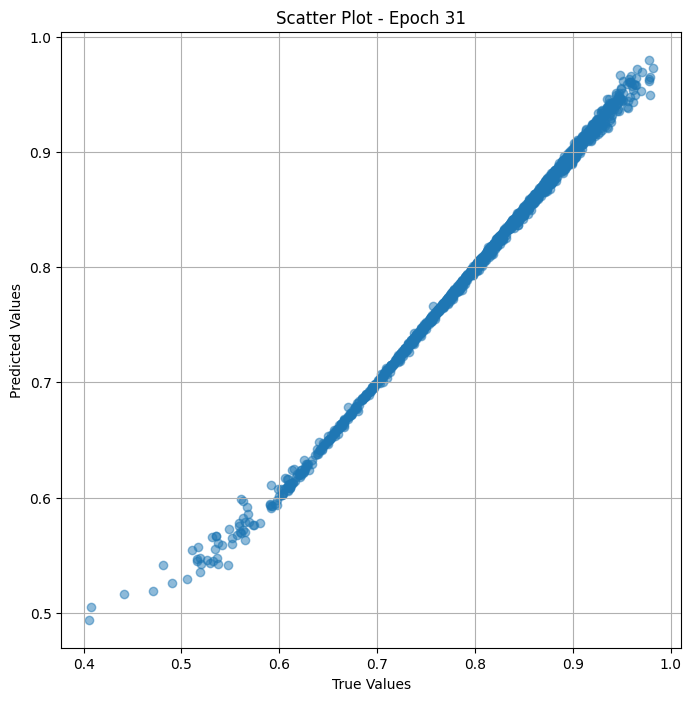

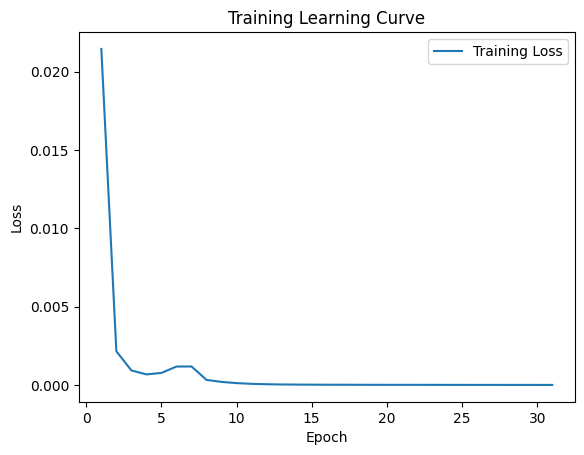


 Epoch: (32/50) Loss = 3.664800374281185e-07

 Epoch: (32/50) Loss_rmse = 0.0006053759716451168

 Epoch: (32/50) R^2 = 0.9998716711997986

 Epoch: (32/50) MAE = 0.0005837827920913696
Spearman correlation coefficient: SignificanceResult(statistic=0.9995617756608892, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.752212

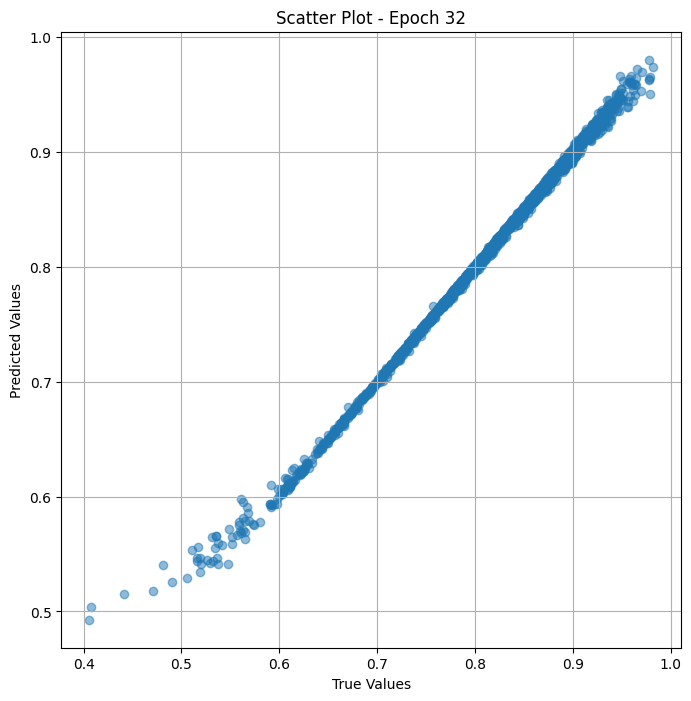

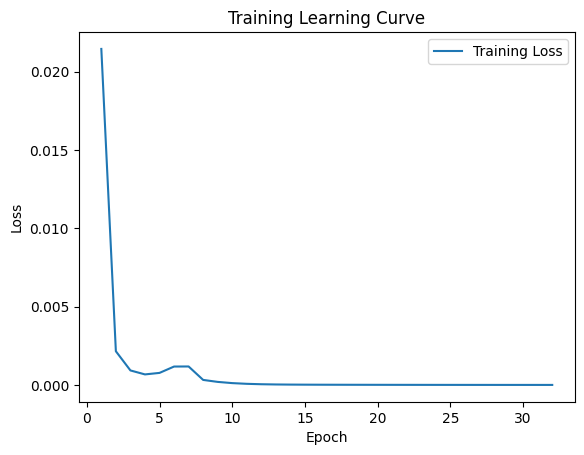


 Epoch: (33/50) Loss = 2.463765440552379e-07

 Epoch: (33/50) Loss_rmse = 0.000496363325510174

 Epoch: (33/50) R^2 = 0.99991375207901

 Epoch: (33/50) MAE = 0.0004799962043762207
Spearman correlation coefficient: SignificanceResult(statistic=0.9996048965484229, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 

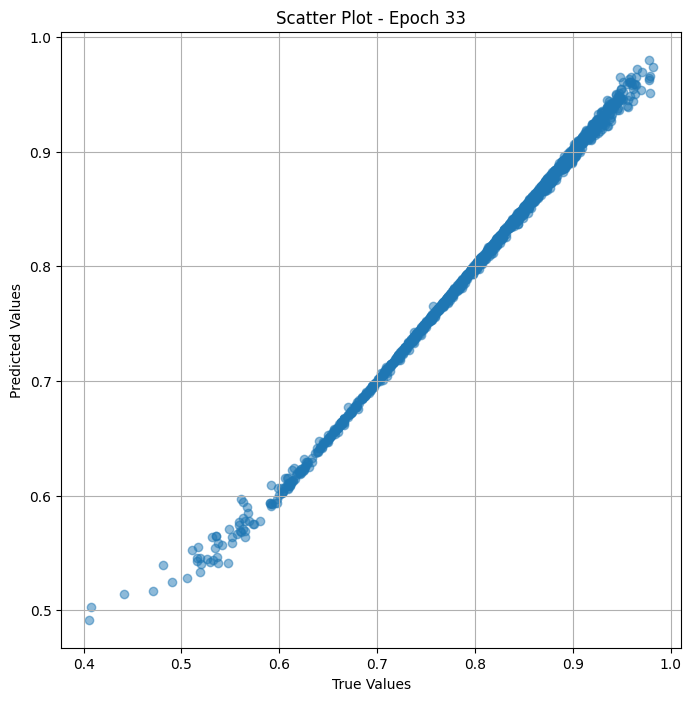

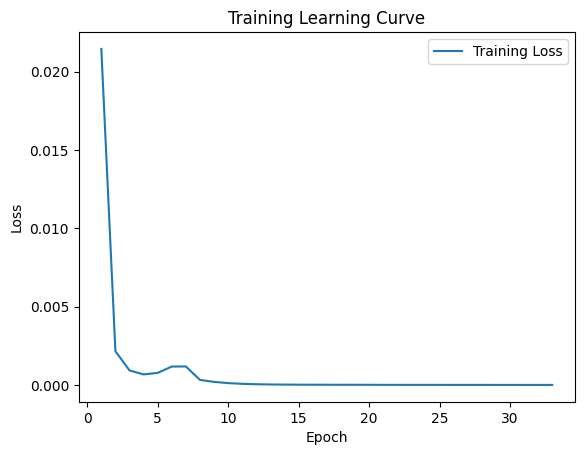


 Epoch: (34/50) Loss = 1.6193428109545493e-07

 Epoch: (34/50) Loss_rmse = 0.0004024106019642204

 Epoch: (34/50) R^2 = 0.9999433159828186

 Epoch: (34/50) MAE = 0.00038370490074157715
Spearman correlation coefficient: SignificanceResult(statistic=0.9996408325325098, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522

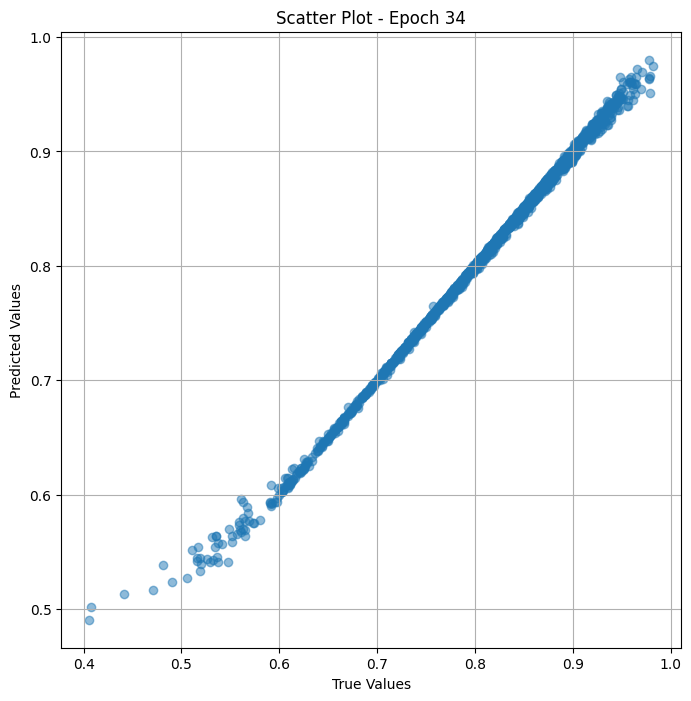

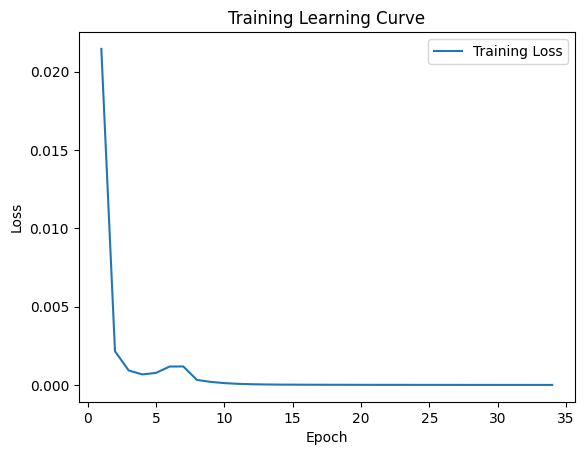


 Epoch: (35/50) Loss = 9.545334478389123e-08

 Epoch: (35/50) Loss_rmse = 0.0003089552337769419

 Epoch: (35/50) R^2 = 0.999966561794281

 Epoch: (35/50) MAE = 0.0002978220582008362
Spearman correlation coefficient: SignificanceResult(statistic=0.9996748844472229, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124

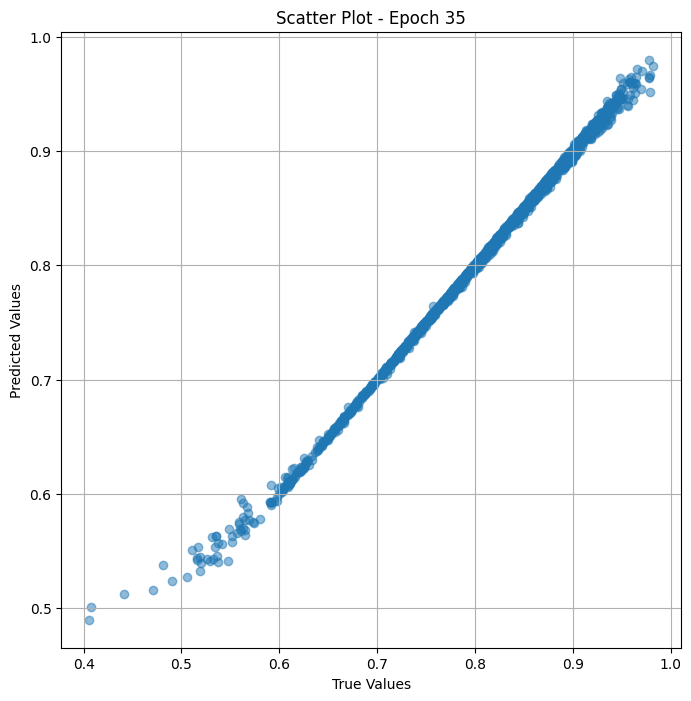

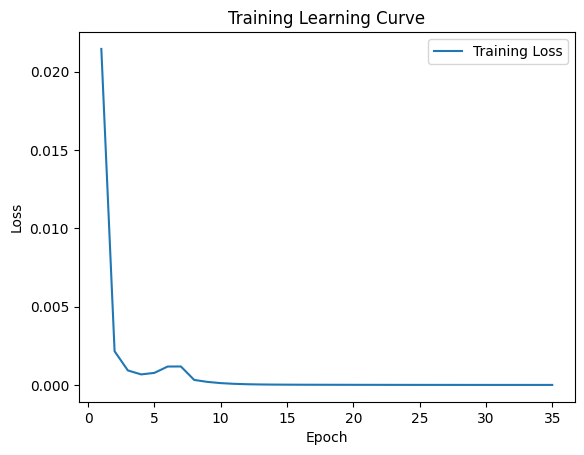


 Epoch: (36/50) Loss = 5.457985707835178e-08

 Epoch: (36/50) Loss_rmse = 0.00023362333013210446

 Epoch: (36/50) R^2 = 0.9999808669090271

 Epoch: (36/50) MAE = 0.00021491944789886475
Spearman correlation coefficient: SignificanceResult(statistic=0.9997068156119779, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522

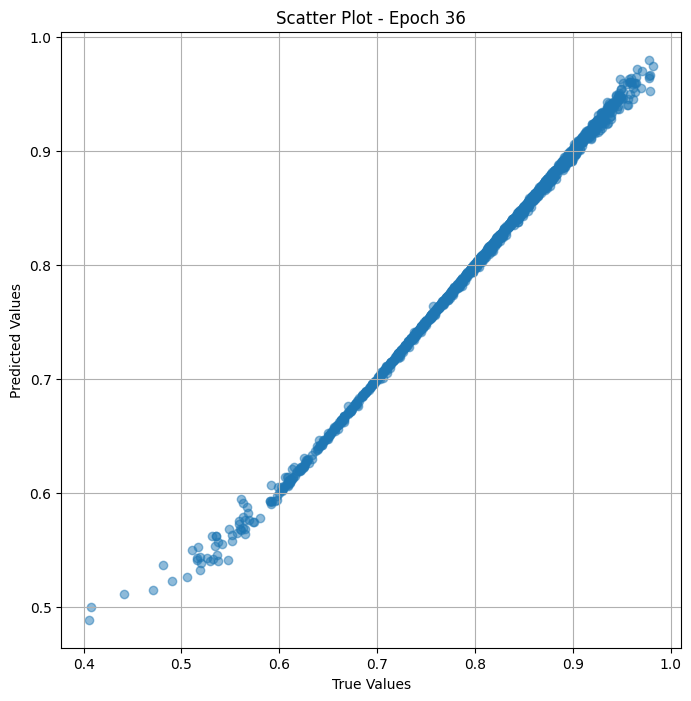

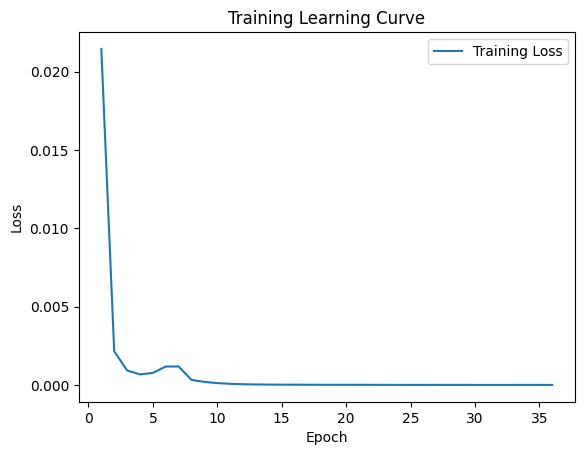


 Epoch: (37/50) Loss = 2.508659413535952e-08

 Epoch: (37/50) Loss_rmse = 0.00015838748367968947

 Epoch: (37/50) R^2 = 0.999991238117218

 Epoch: (37/50) MAE = 0.0001474246382713318
Spearman correlation coefficient: SignificanceResult(statistic=0.9997376592921632, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.752212

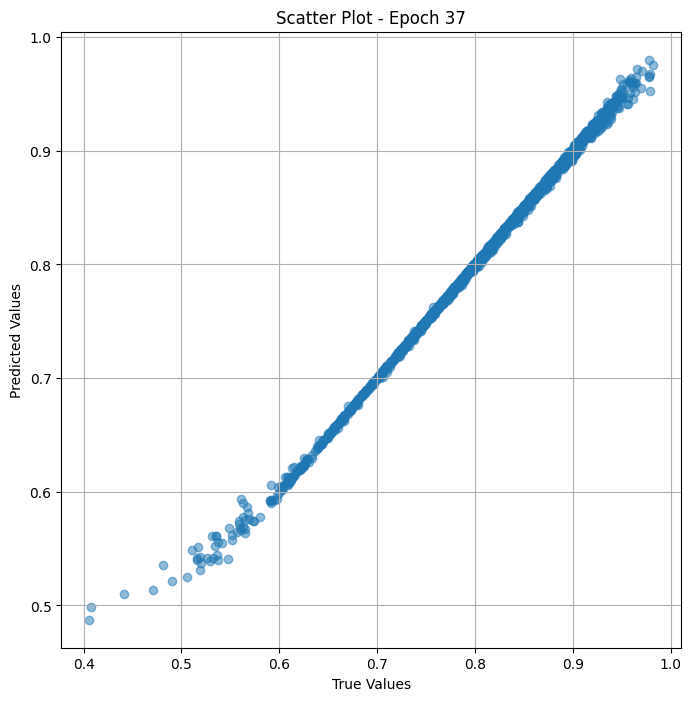

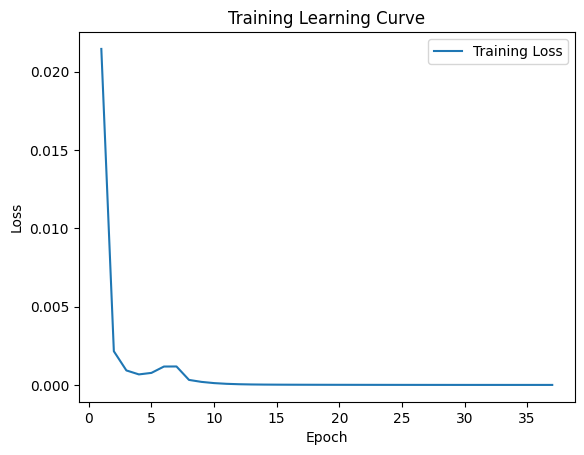


 Epoch: (38/50) Loss = 1.2933618620536436e-08

 Epoch: (38/50) Loss_rmse = 0.0001137260696850717

 Epoch: (38/50) R^2 = 0.9999954700469971

 Epoch: (38/50) MAE = 0.000104561448097229
Spearman correlation coefficient: SignificanceResult(statistic=0.9997629717126839, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.752212

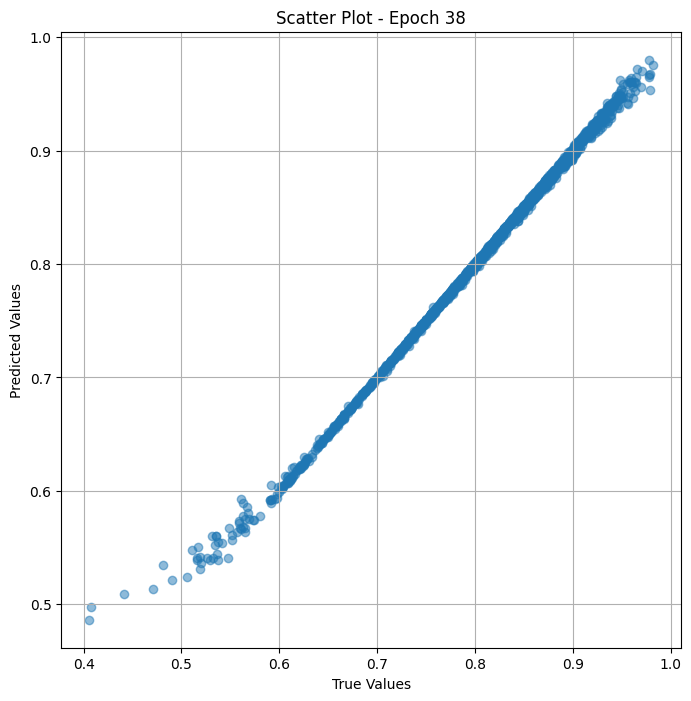

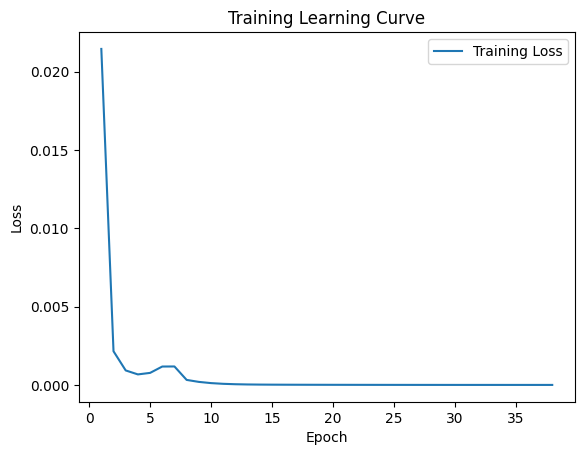


 Epoch: (39/50) Loss = 5.223312449231798e-09

 Epoch: (39/50) Loss_rmse = 7.227248715935275e-05

 Epoch: (39/50) R^2 = 0.999998152256012

 Epoch: (39/50) MAE = 5.377829074859619e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9997855612519204, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124

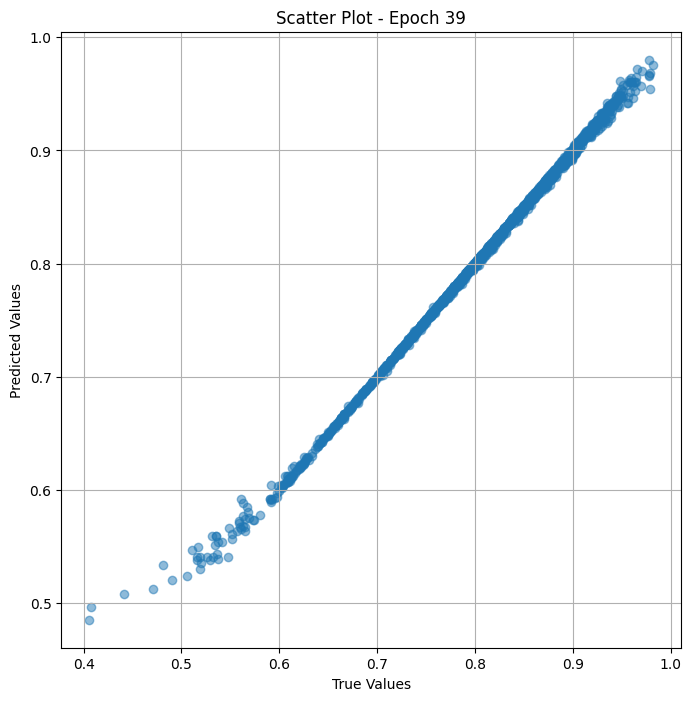

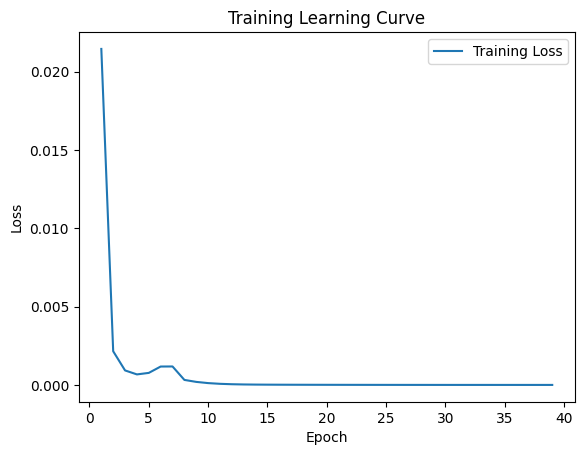


 Epoch: (40/50) Loss = 1.0562183128115521e-08

 Epoch: (40/50) Loss_rmse = 0.00010277247929479927

 Epoch: (40/50) R^2 = 0.9999963045120239

 Epoch: (40/50) MAE = 5.7540833950042725e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998051917499274, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.752

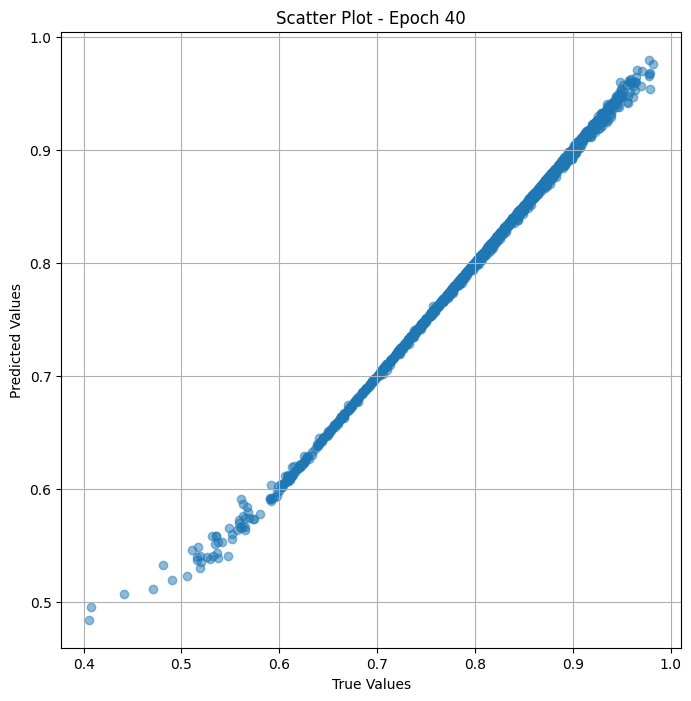

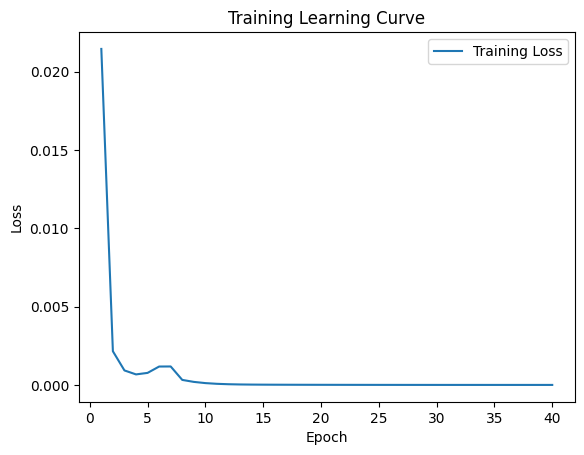


 Epoch: (41/50) Loss = 1.0545937456640786e-08

 Epoch: (41/50) Loss_rmse = 0.00010269341146340594

 Epoch: (41/50) R^2 = 0.9999963045120239

 Epoch: (41/50) MAE = 9.820610284805298e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998214424968872, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522

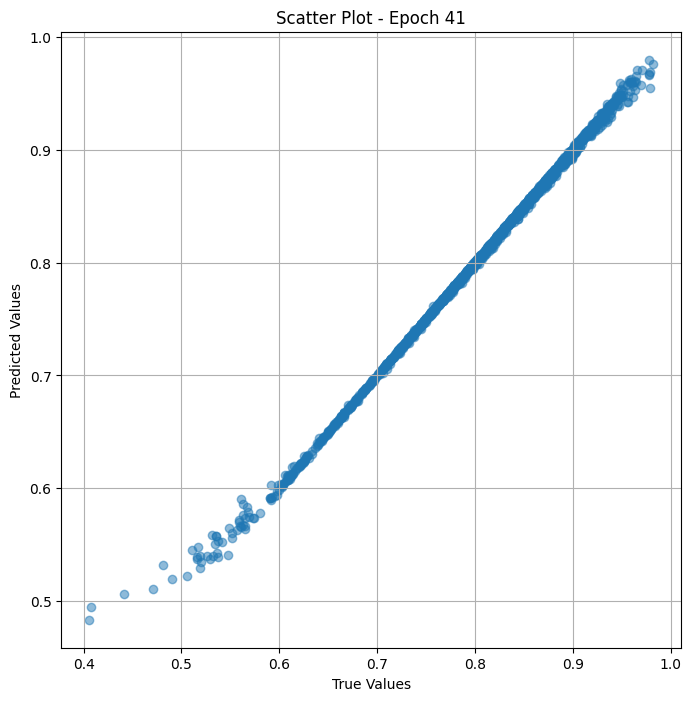

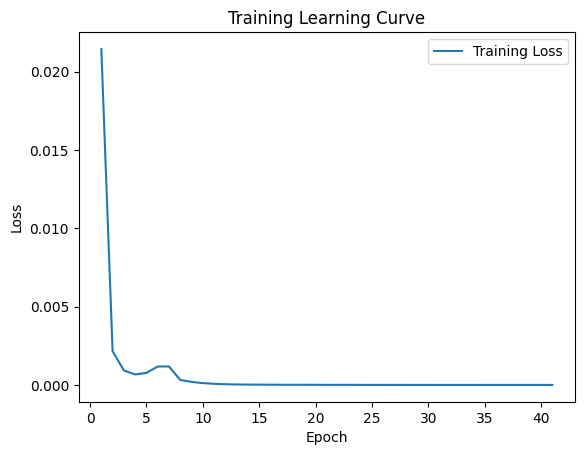

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (42/50) Loss = 2.7766287047370497e-08

 Epoch: (42/50) Loss_rmse = 0.00016663219139445573

 Epoch: (42/50) R^2 = 0.9999902844429016

 Epoch: (42/50) MAE = 0.00011268258094787598
Spearman correlation coefficient: SignificanceResult(statistic=0.9998392499208841, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.728070

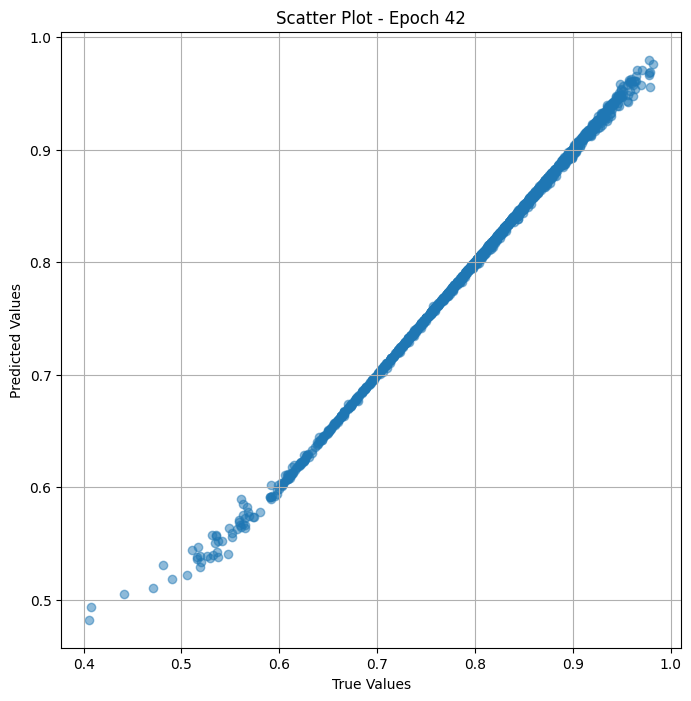

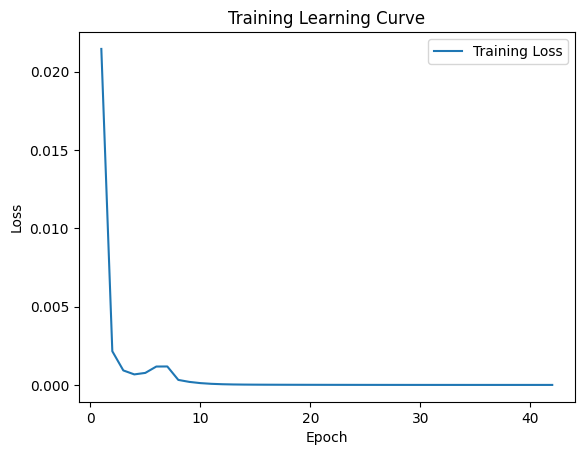


 Epoch: (43/50) Loss = 1.736145804898115e-08

 Epoch: (43/50) Loss_rmse = 0.00013176289212424308

 Epoch: (43/50) R^2 = 0.9999939203262329

 Epoch: (43/50) MAE = 0.00010894238948822021
Spearman correlation coefficient: SignificanceResult(statistic=0.999854022711108, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.75221

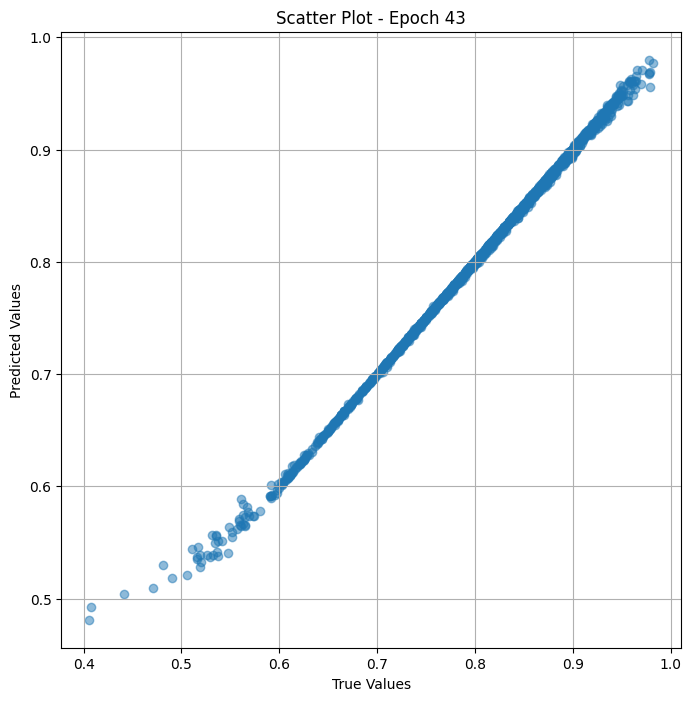

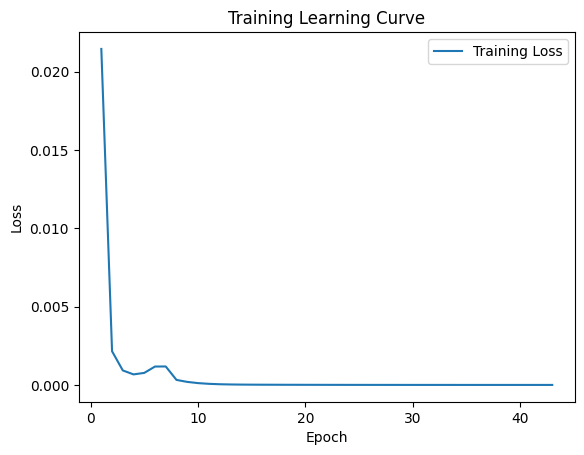


 Epoch: (44/50) Loss = 1.696054319211271e-08

 Epoch: (44/50) Loss_rmse = 0.0001302326563745737

 Epoch: (44/50) R^2 = 0.9999940395355225

 Epoch: (44/50) MAE = 0.00011248886585235596
Spearman correlation coefficient: SignificanceResult(statistic=0.9998550408591711, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.75221

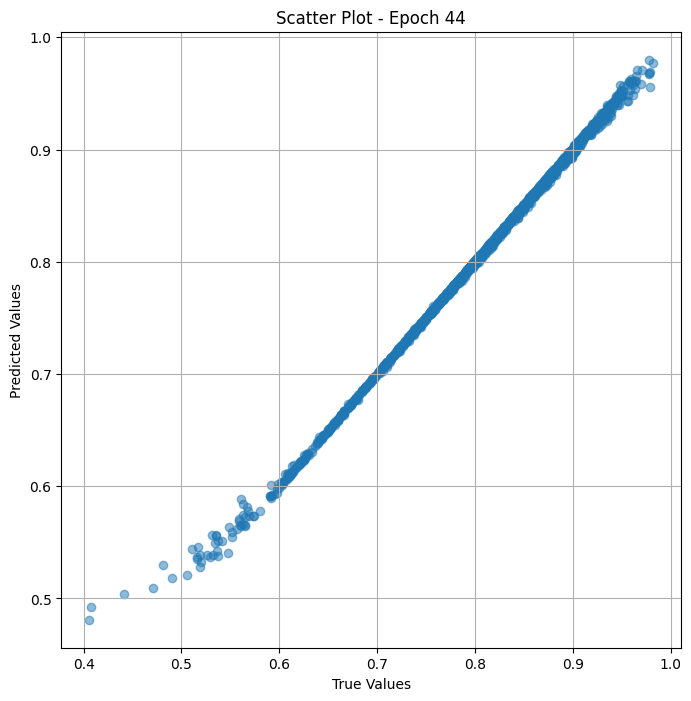

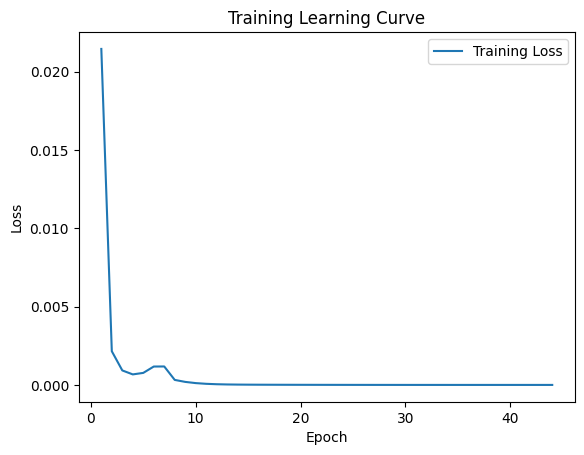

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (45/50) Loss = 1.6975002736785427e-08

 Epoch: (45/50) Loss_rmse = 0.0001302881573792547

 Epoch: (45/50) R^2 = 0.9999940395355225

 Epoch: (45/50) MAE = 0.00011591613292694092
Spearman correlation coefficient: SignificanceResult(statistic=0.9998564223707741, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702

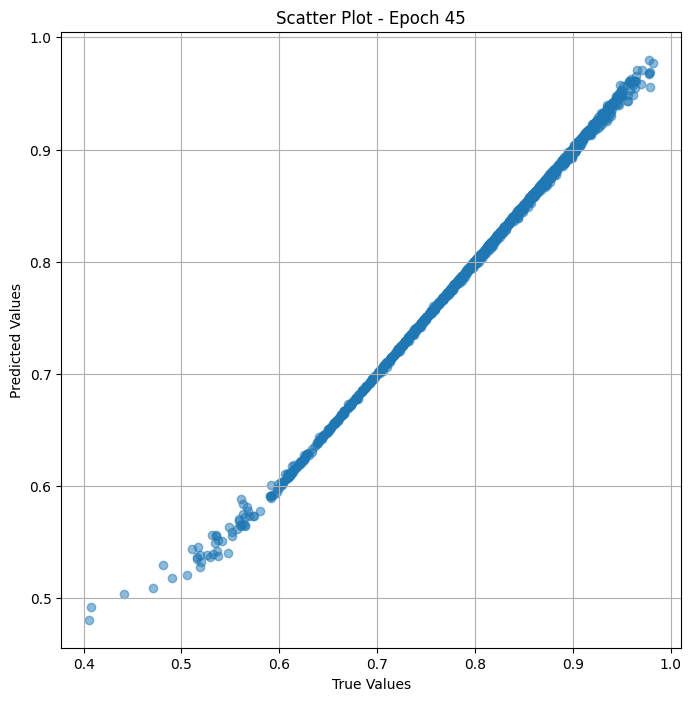

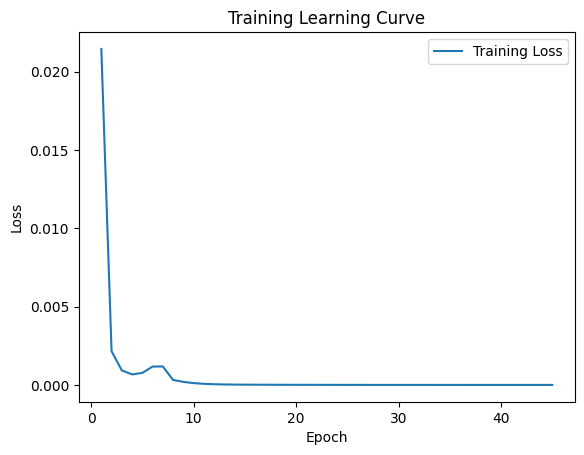


 Epoch: (46/50) Loss = 1.686514217169588e-08

 Epoch: (46/50) Loss_rmse = 0.0001298658607993275

 Epoch: (46/50) R^2 = 0.9999940991401672

 Epoch: (46/50) MAE = 0.00011585652828216553
Spearman correlation coefficient: SignificanceResult(statistic=0.9998579258724587, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.75221

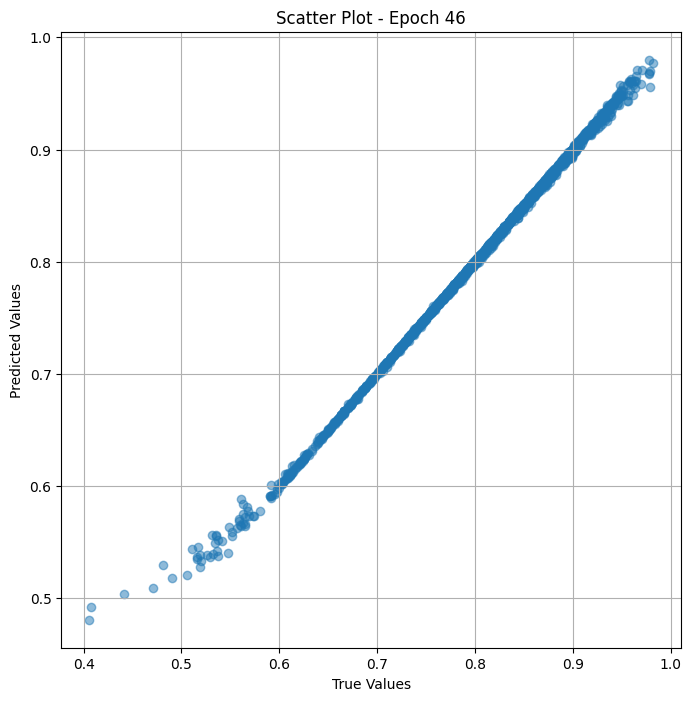

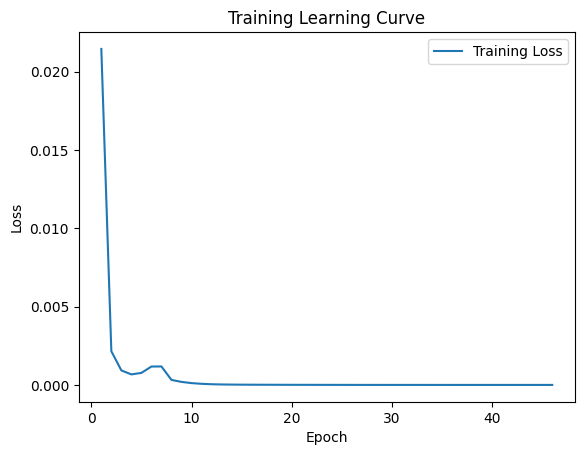


 Epoch: (47/50) Loss = 1.6927019785839548e-08

 Epoch: (47/50) Loss_rmse = 0.0001301038864767179

 Epoch: (47/50) R^2 = 0.9999940991401672

 Epoch: (47/50) MAE = 0.00011620670557022095
Spearman correlation coefficient: SignificanceResult(statistic=0.9998581573408176, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522

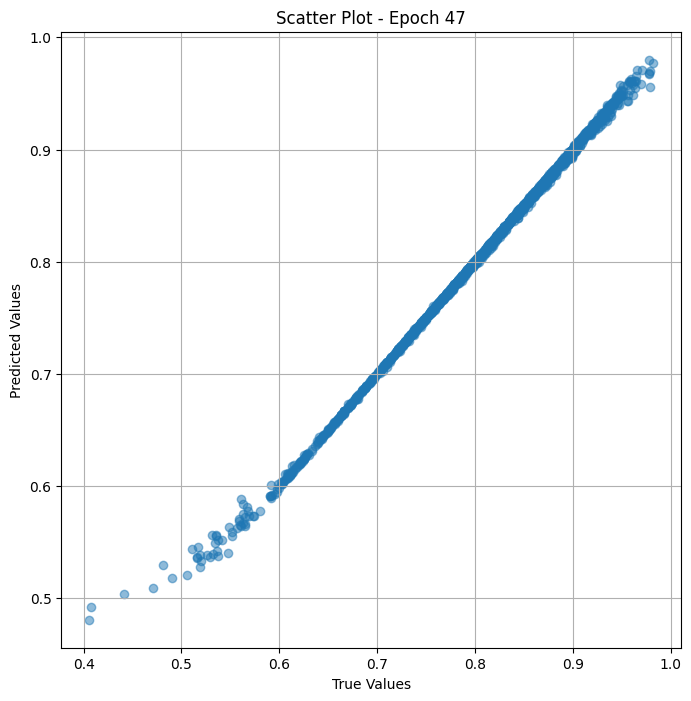

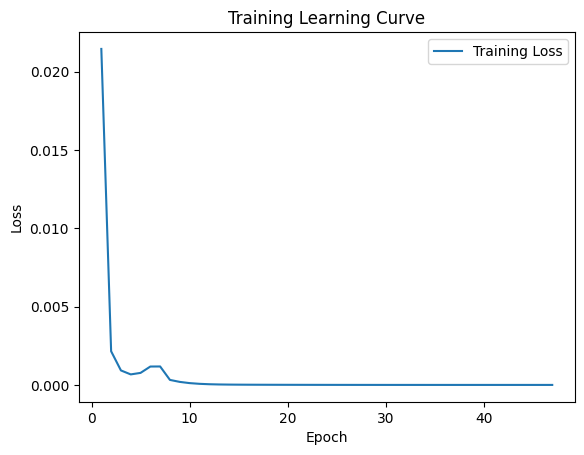

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (48/50) Loss = 1.702389518243308e-08

 Epoch: (48/50) Loss_rmse = 0.00013047564425505698

 Epoch: (48/50) R^2 = 0.9999940395355225

 Epoch: (48/50) MAE = 0.0001166313886642456
Spearman correlation coefficient: SignificanceResult(statistic=0.9998582126012819, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702,

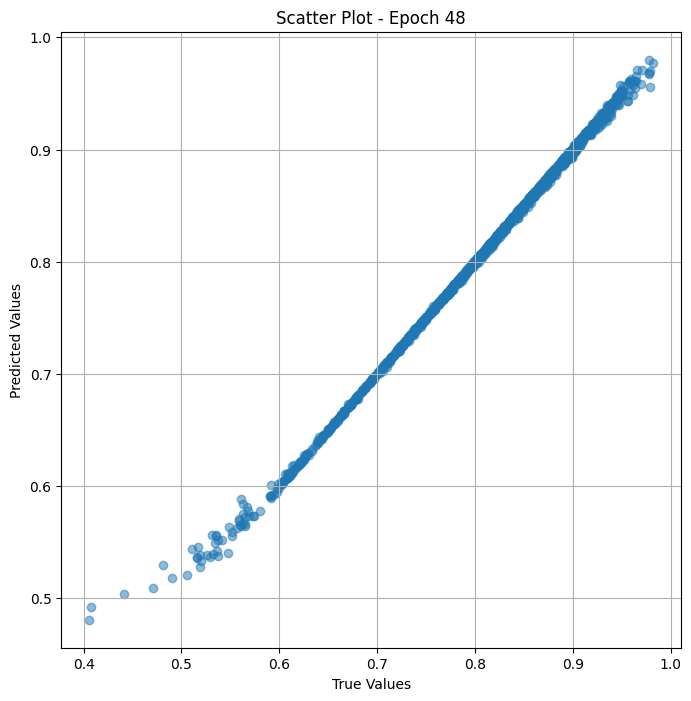

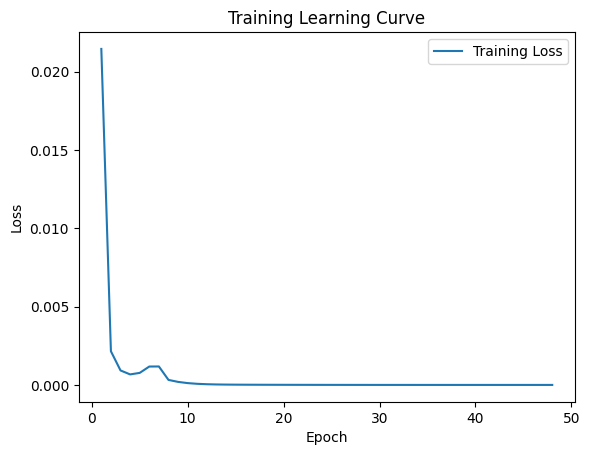


 Epoch: (49/50) Loss = 1.701085849958872e-08

 Epoch: (49/50) Loss_rmse = 0.000130425687530078

 Epoch: (49/50) R^2 = 0.9999940395355225

 Epoch: (49/50) MAE = 0.00011661648750305176
Spearman correlation coefficient: SignificanceResult(statistic=0.9998584440696413, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.752212

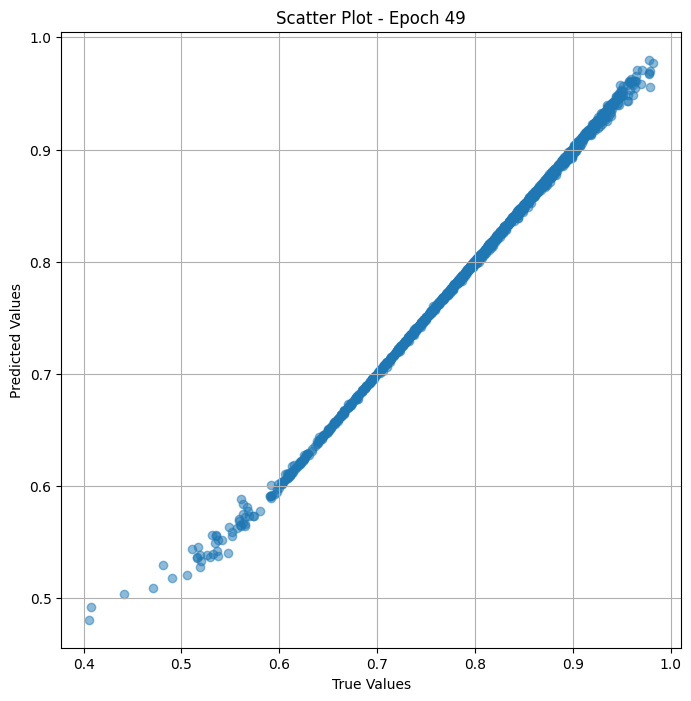

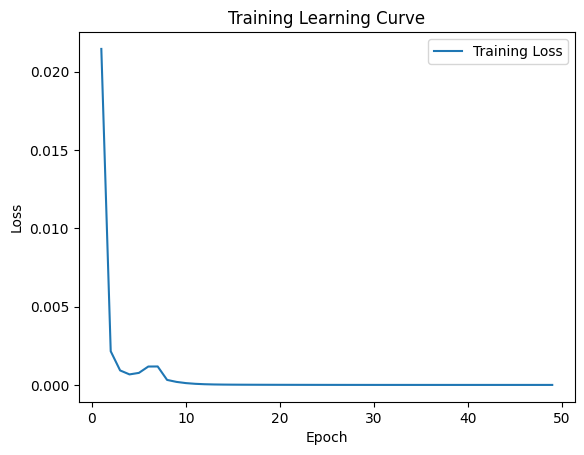


 Epoch: (50/50) Loss = 1.7011327457794323e-08

 Epoch: (50/50) Loss_rmse = 0.00013042747741565108

 Epoch: (50/50) R^2 = 0.9999940395355225

 Epoch: (50/50) MAE = 0.00011662393808364868
Spearman correlation coefficient: SignificanceResult(statistic=0.9998584962021543, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.752

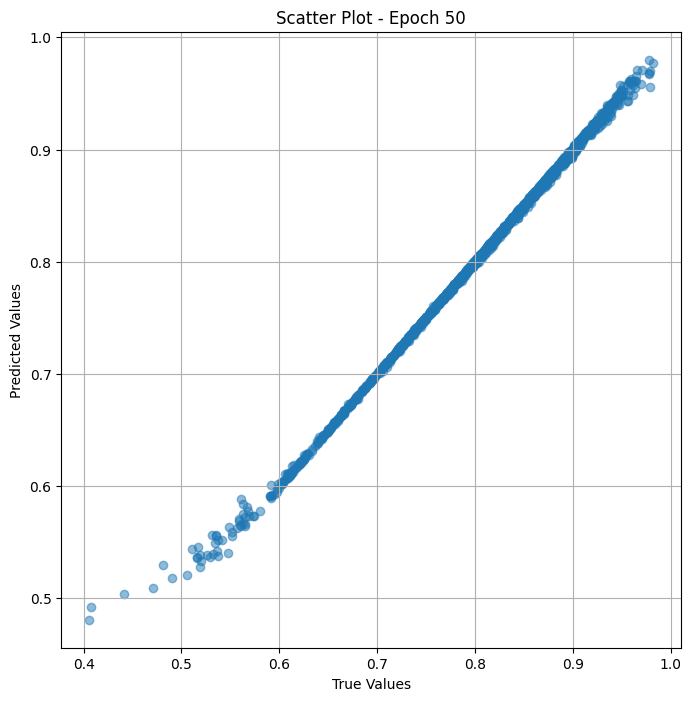

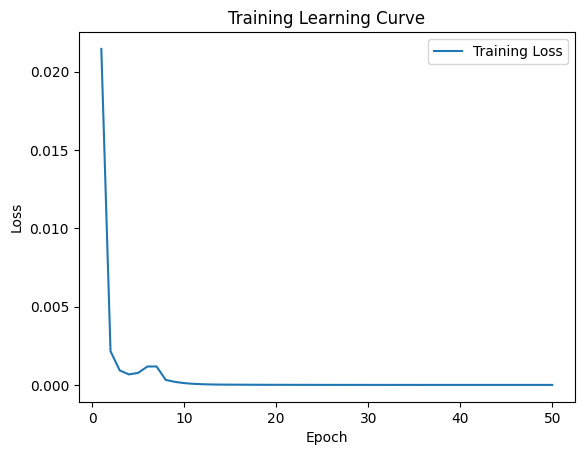

In [ ]:
# Training the model and save weights
fit(50, model_res , train_dl)
torch.save(model_res.state_dict(), "model_weights_1")

In [ ]:
true_values_list = []
predicted_values_list = []

for x_trans, yb in train_dl:
    preds = model_res(x_trans)
    true_values_list.extend(yb.cpu().detach().numpy())
    predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_animal' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_train_animal['preprocessed_image_path'],
    'True Value': true_values_list,  # Replace with your actual true values
    'Predicted Value': predicted_values_list  # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)



                                            Image Path  True Value  \
0      /content/animal/n02332755_5511_preprocessed.jpg    0.811111   
1        /content/animal/000000566598_preprocessed.jpg    0.873684   
2      /content/animal/n02324045_7660_preprocessed.jpg    0.881188   
3        /content/animal/000000233383_preprocessed.jpg    0.796460   
4        /content/animal/000000301697_preprocessed.jpg    0.892157   
...                                                ...         ...   
1795   /content/animal/n02396427_1979_preprocessed.jpg    0.913979   
1796     /content/animal/000000433123_preprocessed.jpg    0.902655   
1797  /content/animal/n02324045_35990_preprocessed.jpg    0.873786   
1798  /content/animal/n02431441_12219_preprocessed.jpg    0.737864   
1799     /content/animal/000000397034_preprocessed.jpg    0.857143   

      Predicted Value  
0            0.502245  
1            0.494452  
2            0.473207  
3            0.487975  
4            0.513275  
...            

In [ ]:
from prettytable import PrettyTable

# Assuming 'df_result' is your DataFrame
# The 'Image Path' column should contain the paths to your images

# Create a PrettyTable instance
table = PrettyTable()

# Add column names
table.field_names = df_result.columns.tolist()

# Add rows
for _, row in df_result.iterrows():
    table.add_row(row.tolist())

# Display the table
print(table)

+--------------------------------------------------+------------+---------------------+
|                    Image Path                    | True Value |   Predicted Value   |
+--------------------------------------------------+------------+---------------------+
| /content/animal/n02332755_5511_preprocessed.jpg  | 0.8111111  |  0.5022447109222412 |
|  /content/animal/000000566598_preprocessed.jpg   | 0.8736842  |  0.4944519102573395 |
| /content/animal/n02324045_7660_preprocessed.jpg  | 0.8811881  | 0.47320717573165894 |
|  /content/animal/000000233383_preprocessed.jpg   | 0.79646015 |  0.4879746437072754 |
|  /content/animal/000000301697_preprocessed.jpg   | 0.89215684 |  0.5132747292518616 |
|  /content/animal/000000051831_preprocessed.jpg   | 0.8695652  | 0.49266982078552246 |
|  /content/animal/000000383368_preprocessed.jpg   | 0.8453608  |  0.4867962896823883 |
| /content/animal/n02118333_8882_preprocessed.jpg  | 0.8947368  |  0.476828008890152  |
| /content/animal/n01846331_1327

## Valid

In [ ]:
class Dataset_val_resnet_animal(Dataset):
    def __init__(self, df,res_transform=None):
        self.labels = df_val_animal["memoscore"]
        self.images = df_val_animal["preprocessed_image_path"]
        self.res_transform = res_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.res_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
res_transform   = ConvNextImageProcessor.from_pretrained("facebook/convnext-tiny-224")

# สร้าง Dataset และ DataLoader
val_ds =Dataset_val_resnet_animal(df_val_animal,res_transform=res_transform)
val_dl = DataLoader(val_ds, batch_size=32, shuffle=False)

In [ ]:
class ResNet_model_val_animal(torch.nn.Module):
    def __init__(self, arch="resnet50.a1_in1k"):
        super().__init__()
        self.arch = arch
        self.res = timm.create_model(self.arch, pretrained=True, num_classes=1)


    def forward(self, x):
        resfeat = self.res(x)
        out = torch.sigmoid(resfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

ResNet = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_res_val =  ResNet_model_val_animal( arch="resnet50.a1_in1k")

In [ ]:


# Assuming your model is an instance of YourModelClass and is already on GPU
model = ResNet_model_val_animal().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]           4,096
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
         Identity-10           [-1, 64, 56, 56]               0
             ReLU-11           [-1, 64, 56, 56]               0
         Identity-12           [-1, 64, 56, 56]               0
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 256,

In [ ]:
device = get_default_device()
val_dl = DeviceDataLoader(val_dl, device)
model_res_val  = to_device(model_res_val  , device)

In [ ]:
params = [param for param in list(model_res_val.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-4)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Val Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res_val, val_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res_val.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in val_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res_val(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.10395802557468414

 Epoch: (1/50) Loss_rmse = 0.3224252164363861

 Epoch: (1/50) R^2 = -21.210935592651367

 Epoch: (1/50) MAE = 0.3132893145084381
Spearman correlation coefficient: SignificanceResult(statistic=0.0505232743581465, pvalue=0.6249459301709853)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965, 0.7333

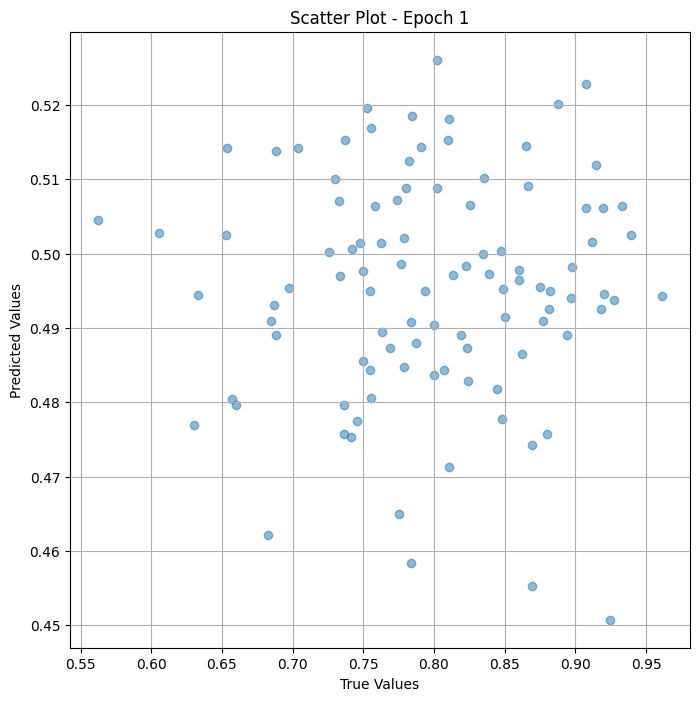

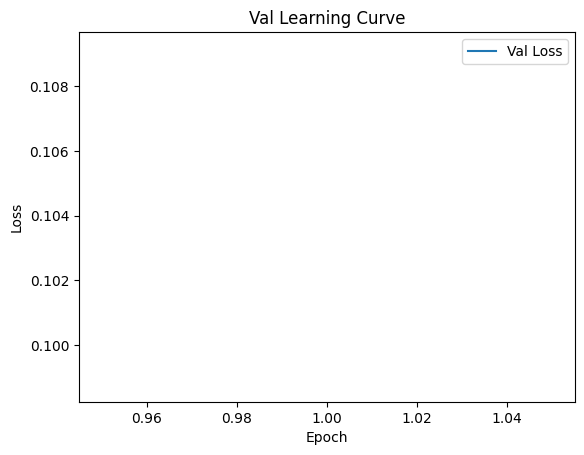


 Epoch: (2/50) Loss = 0.07960471510887146

 Epoch: (2/50) Loss_rmse = 0.28214308619499207

 Epoch: (2/50) R^2 = -16.007780075073242

 Epoch: (2/50) MAE = 0.27433064579963684
Spearman correlation coefficient: SignificanceResult(statistic=0.3831195697938332, pvalue=0.00011682125831707587)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965, 

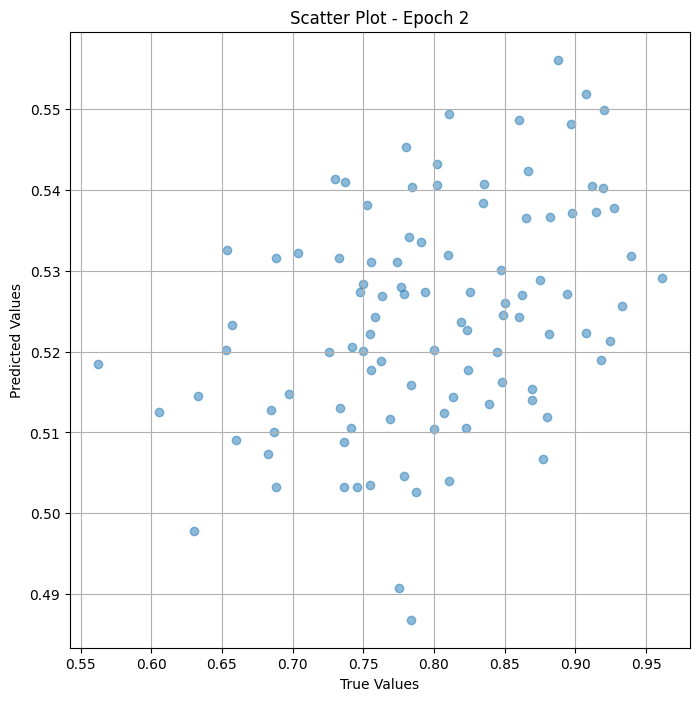

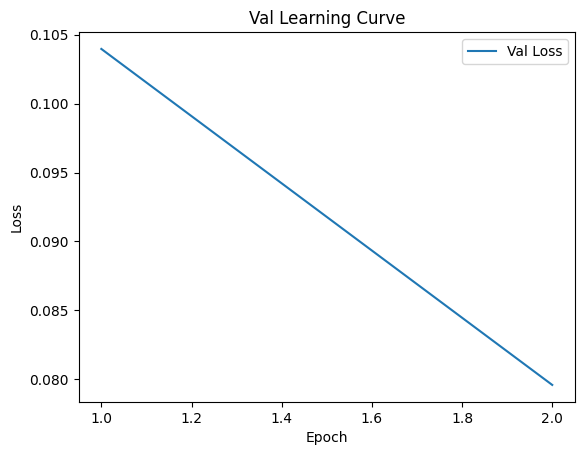


 Epoch: (3/50) Loss = 0.05883379653096199

 Epoch: (3/50) Loss_rmse = 0.24255679547786713

 Epoch: (3/50) R^2 = -11.570013046264648

 Epoch: (3/50) MAE = 0.236707866191864
Spearman correlation coefficient: SignificanceResult(statistic=0.4352231801602289, pvalue=9.361290434080356e-06)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965, 0.7

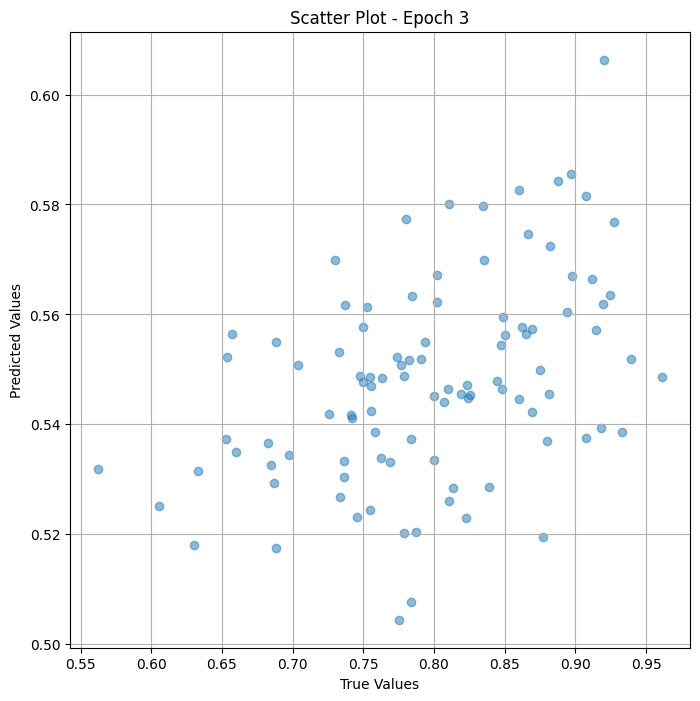

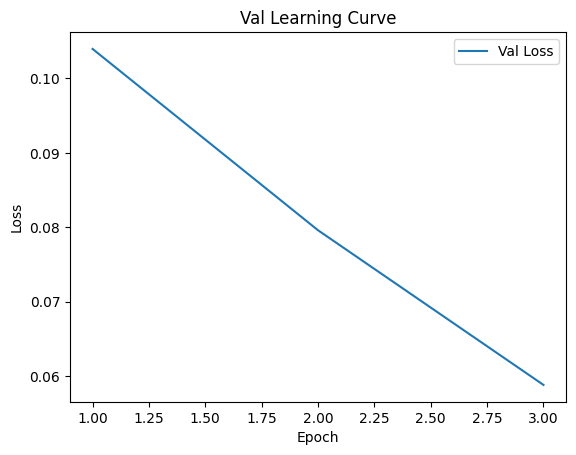


 Epoch: (4/50) Loss = 0.04160979390144348

 Epoch: (4/50) Loss_rmse = 0.20398478209972382

 Epoch: (4/50) R^2 = -7.890053749084473

 Epoch: (4/50) MAE = 0.19950580596923828
Spearman correlation coefficient: SignificanceResult(statistic=0.44825925658879073, pvalue=4.651170876876924e-06)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965, 0

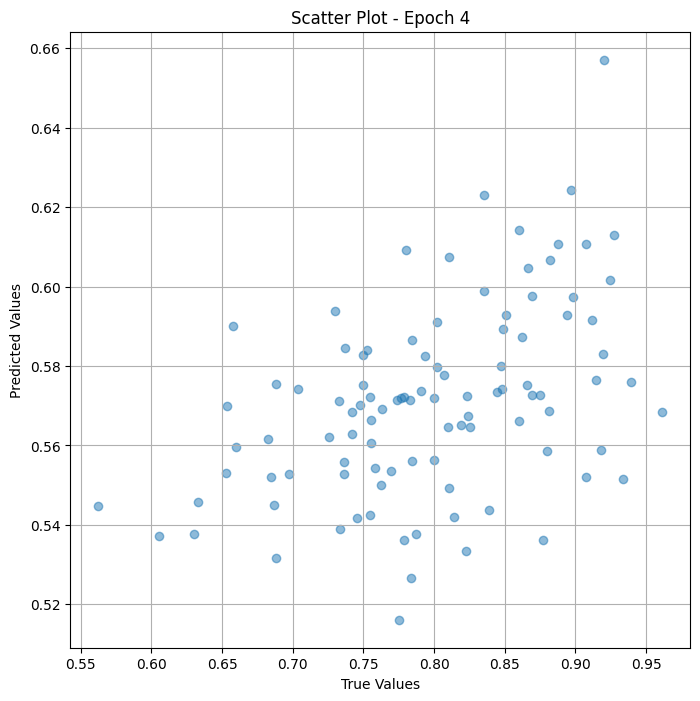

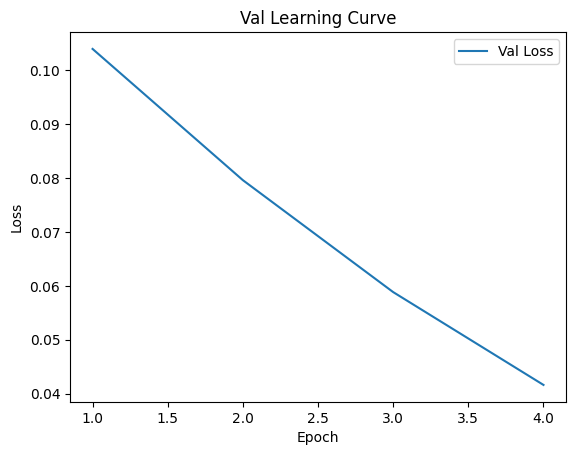


 Epoch: (5/50) Loss = 0.02765878662467003

 Epoch: (5/50) Loss_rmse = 0.16630931198596954

 Epoch: (5/50) R^2 = -4.9093804359436035

 Epoch: (5/50) MAE = 0.16392891108989716
Spearman correlation coefficient: SignificanceResult(statistic=0.4680304130868438, pvalue=1.5215980746101892e-06)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965, 

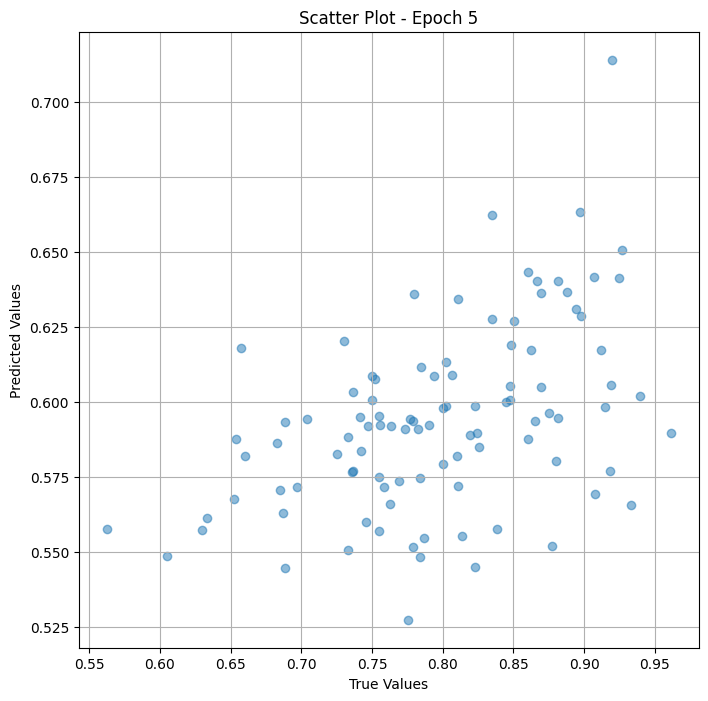

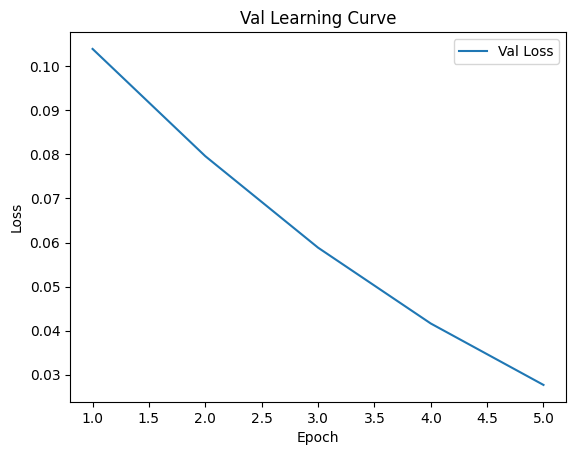


 Epoch: (6/50) Loss = 0.018085157498717308

 Epoch: (6/50) Loss_rmse = 0.13448107242584229

 Epoch: (6/50) R^2 = -2.8639466762542725

 Epoch: (6/50) MAE = 0.1329811066389084
Spearman correlation coefficient: SignificanceResult(statistic=0.480347538370022, pvalue=7.316322220039726e-07)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965, 0.

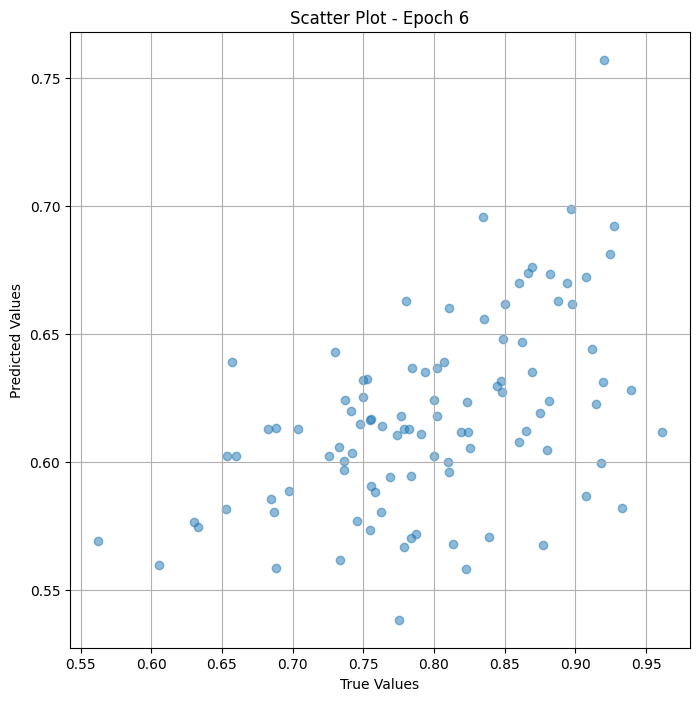

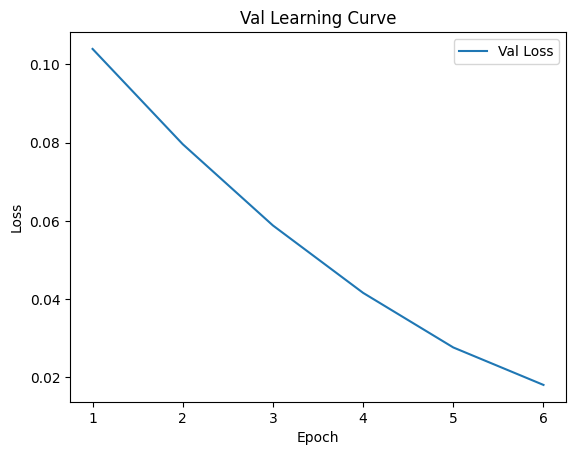


 Epoch: (7/50) Loss = 0.011200365610420704

 Epoch: (7/50) Loss_rmse = 0.10583177953958511

 Epoch: (7/50) R^2 = -1.3929908275604248

 Epoch: (7/50) MAE = 0.10476838052272797
Spearman correlation coefficient: SignificanceResult(statistic=0.548457985558169, pvalue=7.264552430800088e-09)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965, 0

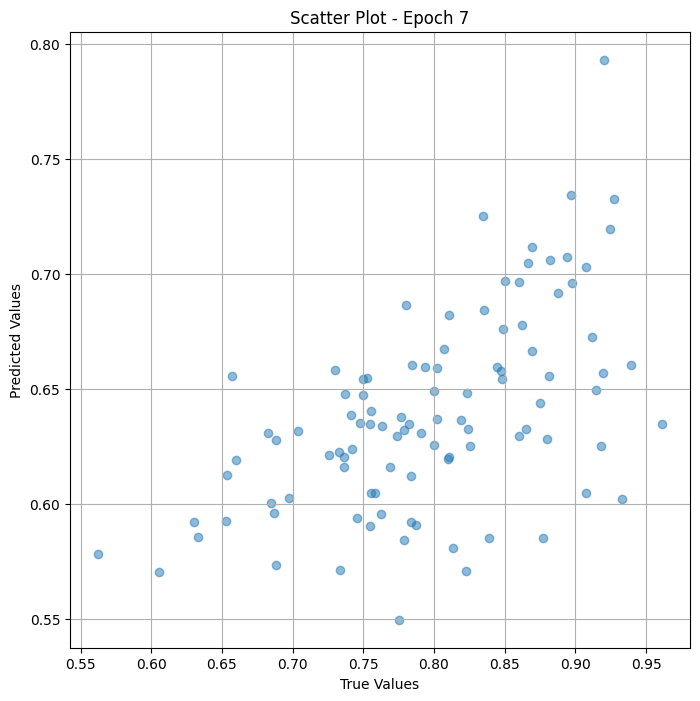

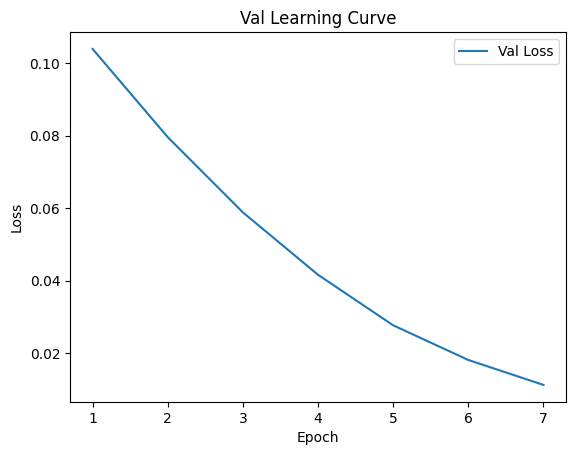


 Epoch: (8/50) Loss = 0.0065336674451828

 Epoch: (8/50) Loss_rmse = 0.08083110302686691

 Epoch: (8/50) R^2 = -0.3959372043609619

 Epoch: (8/50) MAE = 0.08016397058963776
Spearman correlation coefficient: SignificanceResult(statistic=0.6115900351924323, pvalue=3.6149319513764554e-11)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965, 0

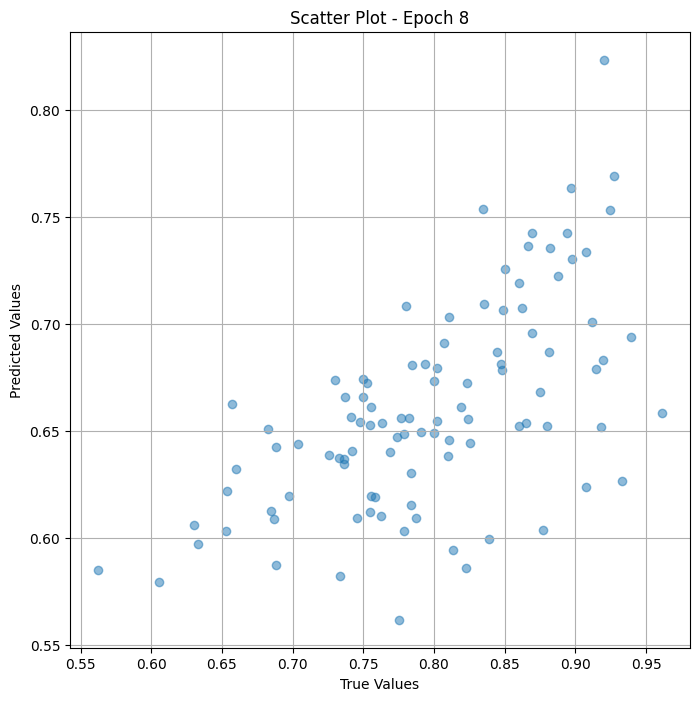

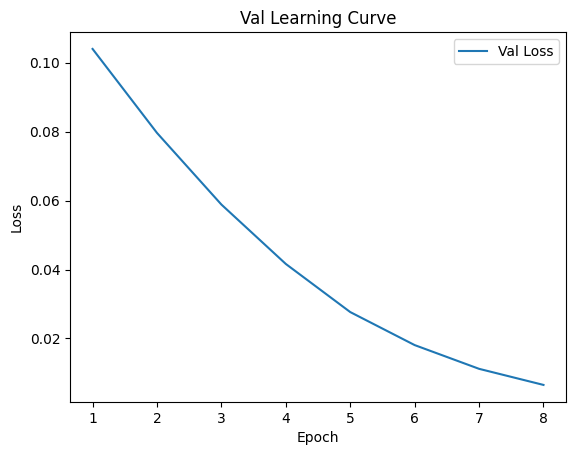


 Epoch: (9/50) Loss = 0.0035454409662634134

 Epoch: (9/50) Loss_rmse = 0.05954360589385033

 Epoch: (9/50) R^2 = 0.24250614643096924

 Epoch: (9/50) MAE = 0.05867069959640503
Spearman correlation coefficient: SignificanceResult(statistic=0.681952291628385, pvalue=2.0220266921306745e-14)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965,

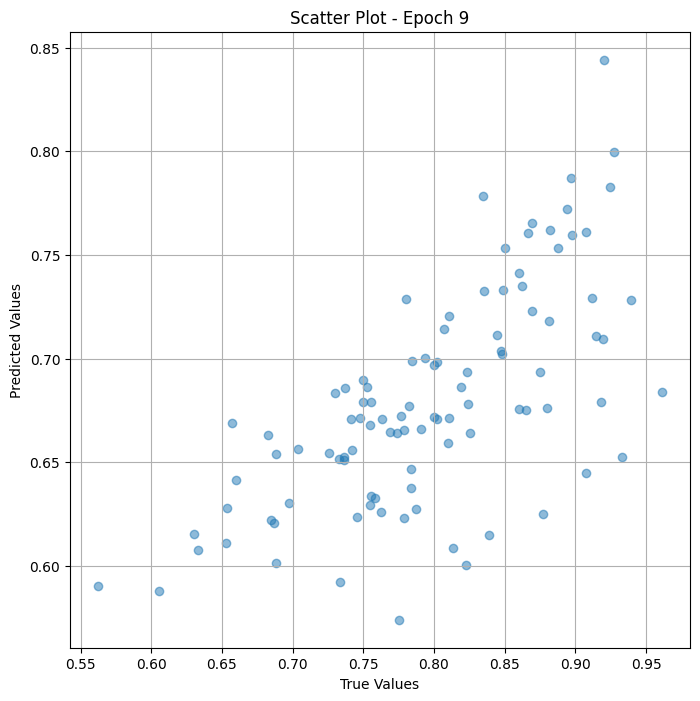

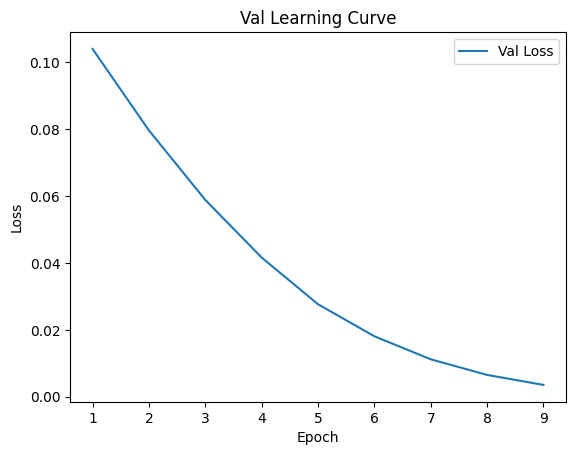


 Epoch: (10/50) Loss = 0.0017527760937809944

 Epoch: (10/50) Loss_rmse = 0.04186616837978363

 Epoch: (10/50) R^2 = 0.6255142688751221

 Epoch: (10/50) MAE = 0.04072384536266327
Spearman correlation coefficient: SignificanceResult(statistic=0.7458507703138593, pvalue=2.828390255762139e-18)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.838709

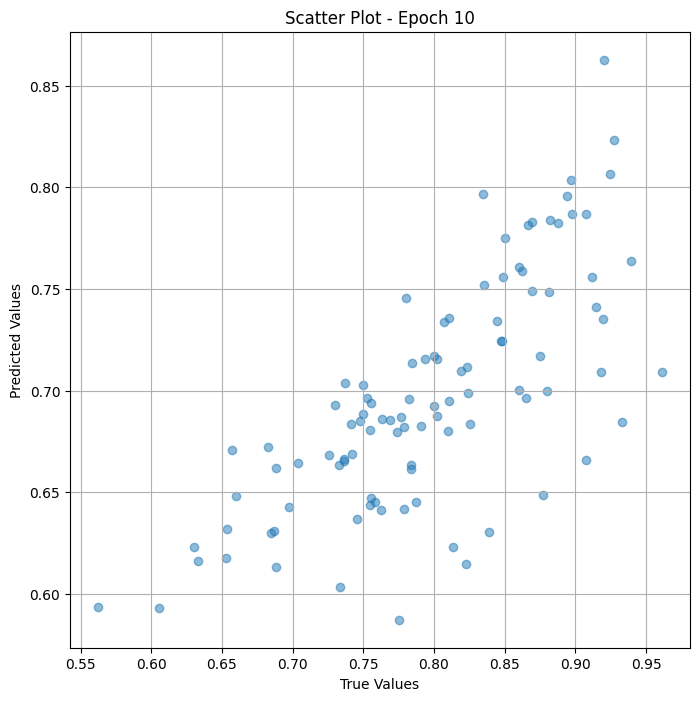

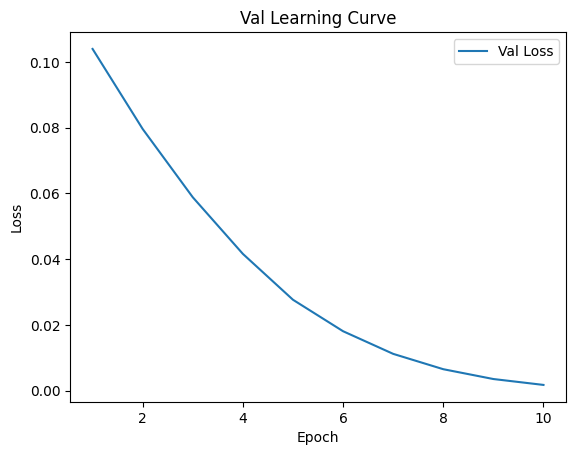


 Epoch: (11/50) Loss = 0.000749272177927196

 Epoch: (11/50) Loss_rmse = 0.02737283706665039

 Epoch: (11/50) R^2 = 0.8399158120155334

 Epoch: (11/50) MAE = 0.025884389877319336
Spearman correlation coefficient: SignificanceResult(statistic=0.8090370804119252, pvalue=2.0348501537219614e-23)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870

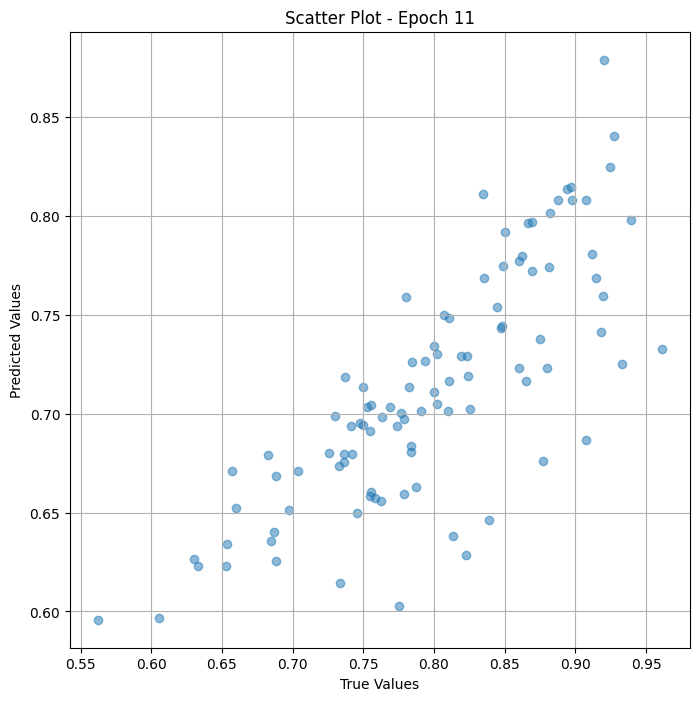

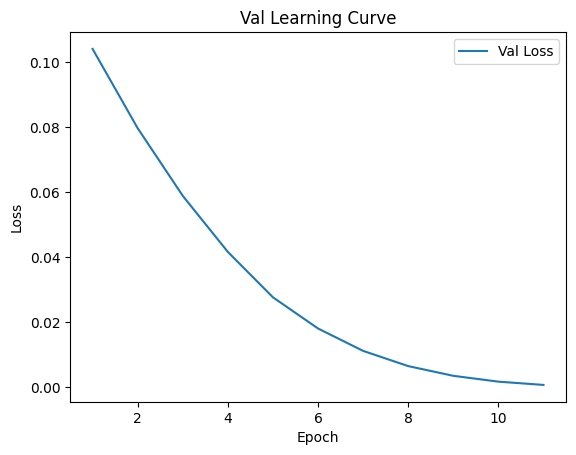


 Epoch: (12/50) Loss = 0.0002570084179751575

 Epoch: (12/50) Loss_rmse = 0.016031481325626373

 Epoch: (12/50) R^2 = 0.9450893998146057

 Epoch: (12/50) MAE = 0.014283314347267151
Spearman correlation coefficient: SignificanceResult(statistic=0.8529134479542597, pvalue=2.797421353967132e-28)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.8387

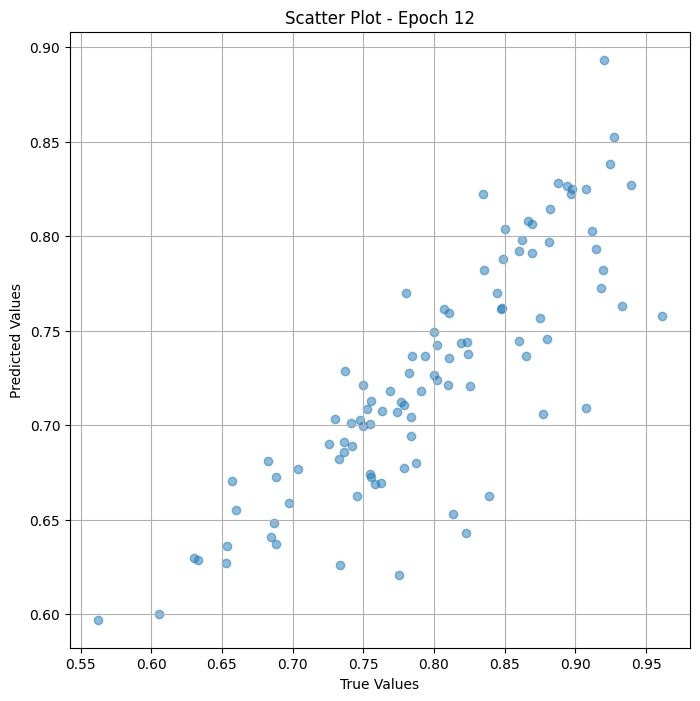

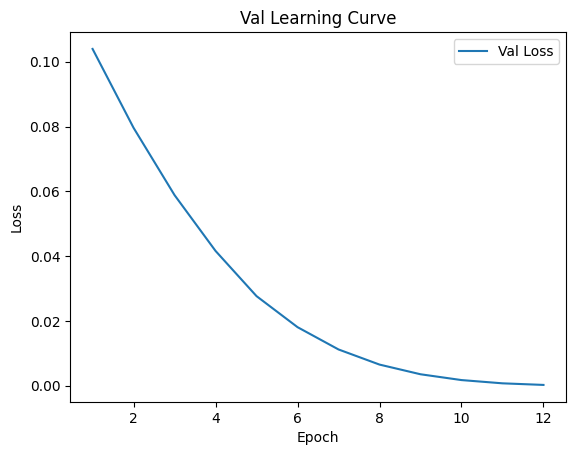


 Epoch: (13/50) Loss = 6.007342381053604e-05

 Epoch: (13/50) Loss_rmse = 0.007750704884529114

 Epoch: (13/50) R^2 = 0.9871651530265808

 Epoch: (13/50) MAE = 0.005454689264297485
Spearman correlation coefficient: SignificanceResult(statistic=0.8884608343029033, pvalue=1.480970139304137e-33)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.8387

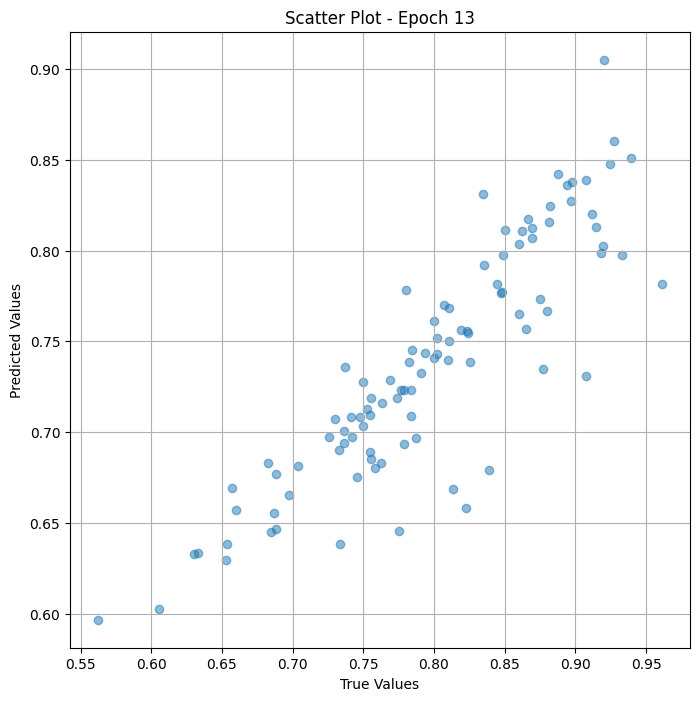

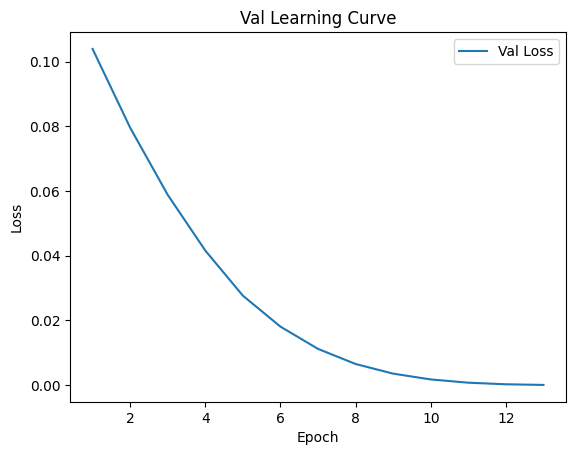


 Epoch: (14/50) Loss = 1.3355533155845478e-05

 Epoch: (14/50) Loss_rmse = 0.003654522355645895

 Epoch: (14/50) R^2 = 0.9971465468406677

 Epoch: (14/50) MAE = 0.00354941189289093
Spearman correlation coefficient: SignificanceResult(statistic=0.9170086208210183, pvalue=2.6845847704859738e-39)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.838

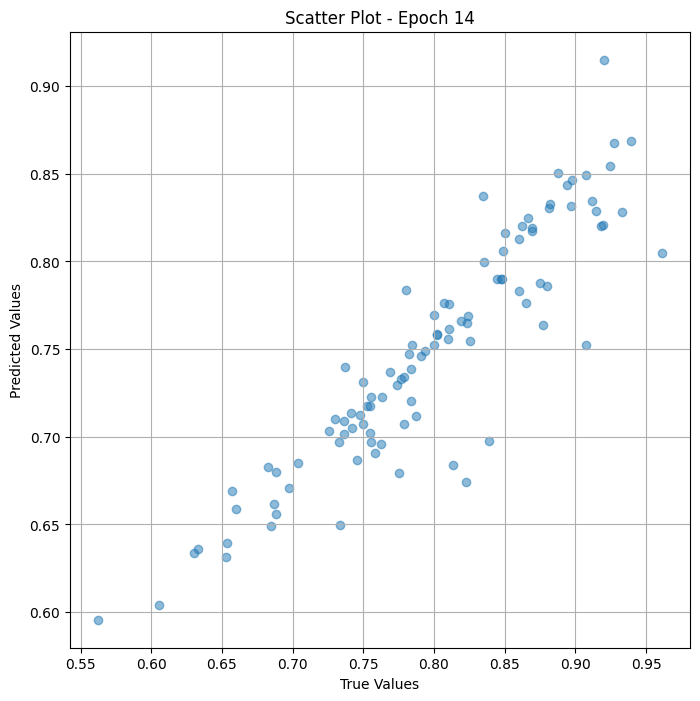

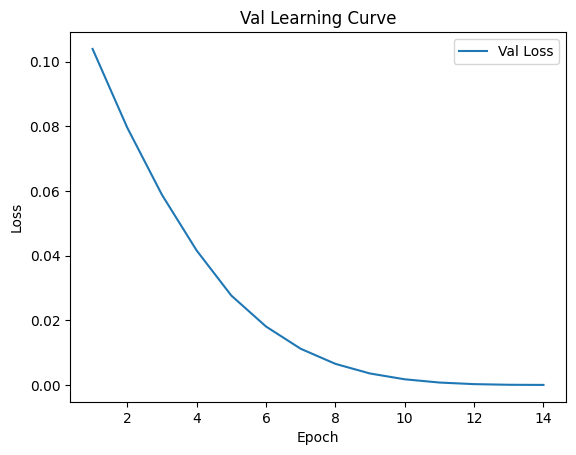


 Epoch: (15/50) Loss = 3.3510950743220747e-05

 Epoch: (15/50) Loss_rmse = 0.005788864567875862

 Epoch: (15/50) R^2 = 0.9928402900695801

 Epoch: (15/50) MAE = 0.005588114261627197
Spearman correlation coefficient: SignificanceResult(statistic=0.9398997539877177, pvalue=1.1840084440669307e-45)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

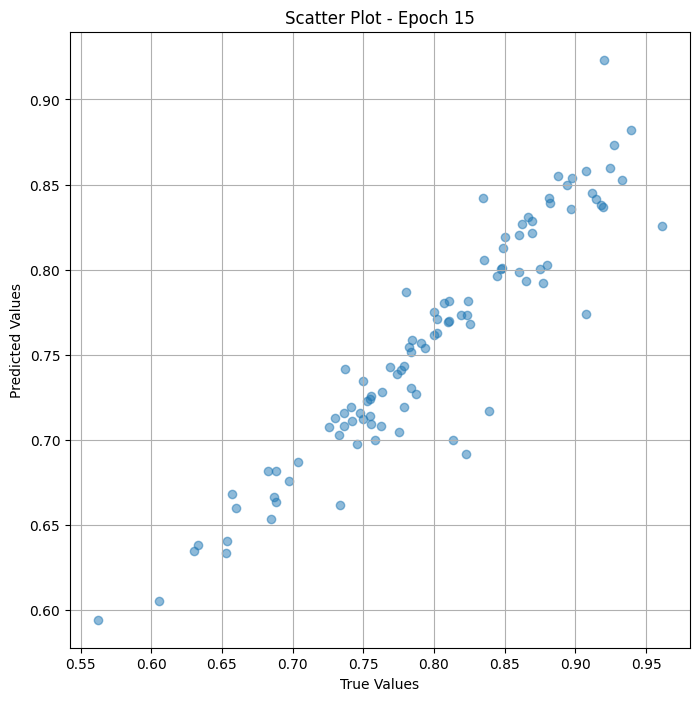

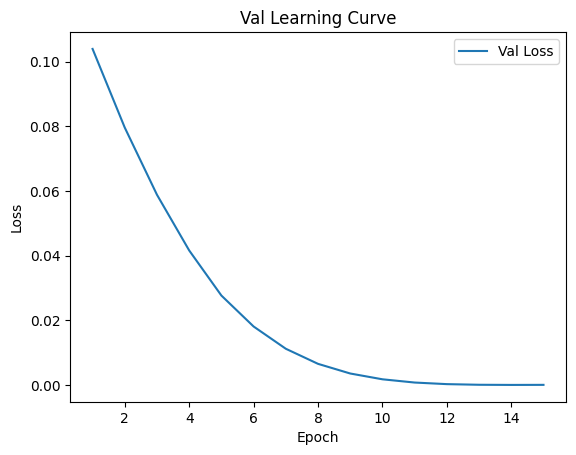


 Epoch: (16/50) Loss = 7.351762906182557e-05

 Epoch: (16/50) Loss_rmse = 0.008574241772294044

 Epoch: (16/50) R^2 = 0.98429274559021

 Epoch: (16/50) MAE = 0.008371204137802124
Spearman correlation coefficient: SignificanceResult(statistic=0.9583211814486825, pvalue=6.121769381778698e-53)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.838709

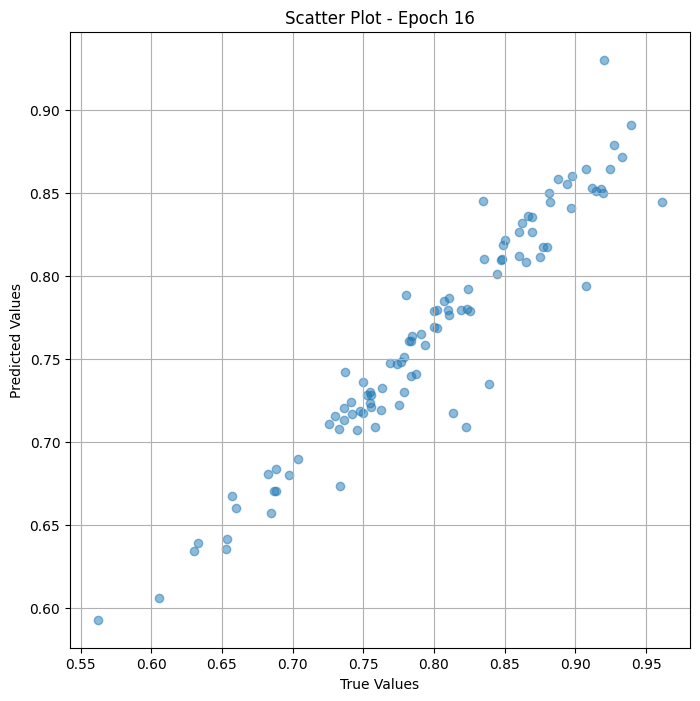

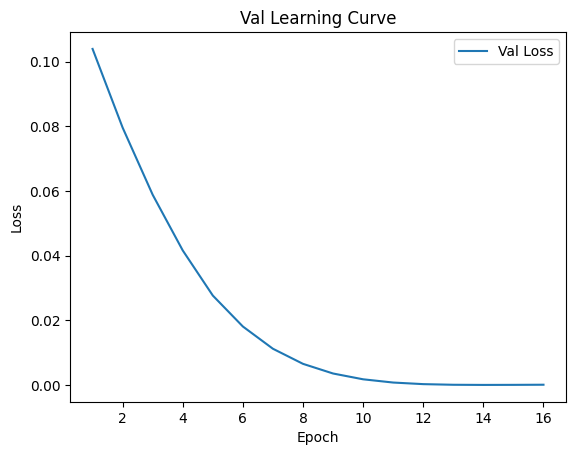

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (17/50) Loss = 0.00011045779683627188

 Epoch: (17/50) Loss_rmse = 0.010509890504181385

 Epoch: (17/50) R^2 = 0.9764003753662109

 Epoch: (17/50) MAE = 0.009831726551055908
Spearman correlation coefficient: SignificanceResult(statistic=0.9723814241315175, pvalue=3.366331483865191e-61)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.652631

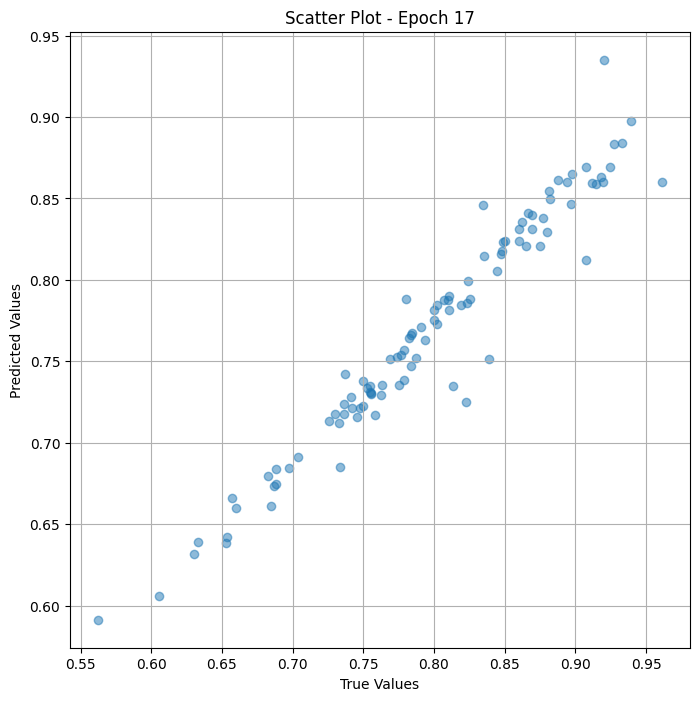

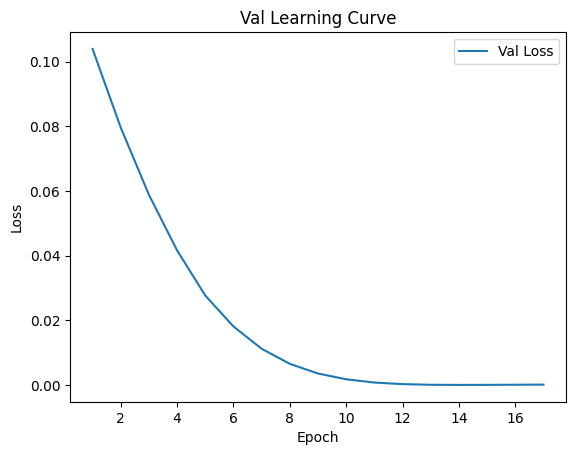


 Epoch: (18/50) Loss = 0.00011673118569888175

 Epoch: (18/50) Loss_rmse = 0.010804221034049988

 Epoch: (18/50) R^2 = 0.9750600457191467

 Epoch: (18/50) MAE = 0.009905874729156494
Spearman correlation coefficient: SignificanceResult(statistic=0.9817752669273334, pvalue=1.363552758976102e-69)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.838

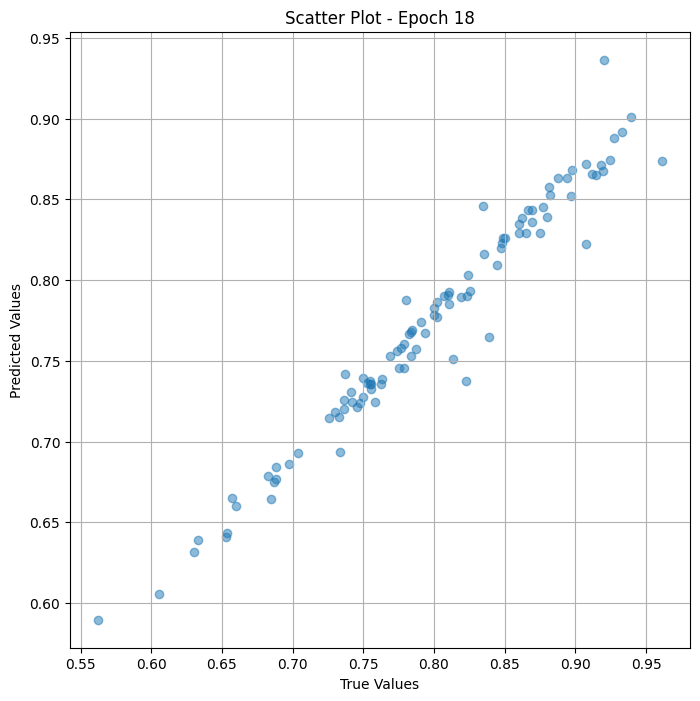

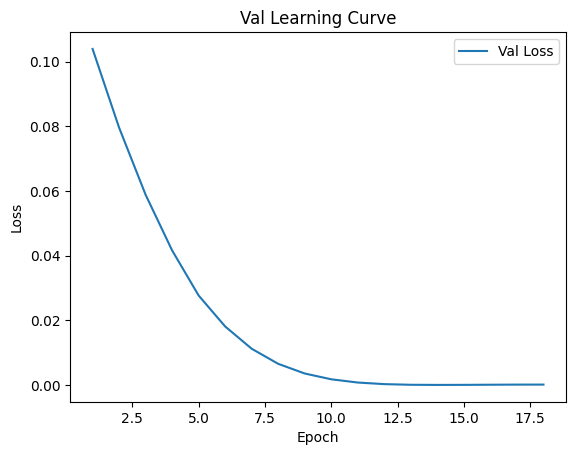


 Epoch: (19/50) Loss = 0.00011766222451115027

 Epoch: (19/50) Loss_rmse = 0.010847222059965134

 Epoch: (19/50) R^2 = 0.9748611450195312

 Epoch: (19/50) MAE = 0.009891748428344727
Spearman correlation coefficient: SignificanceResult(statistic=0.9826569994641247, pvalue=1.352489791065173e-70)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.838

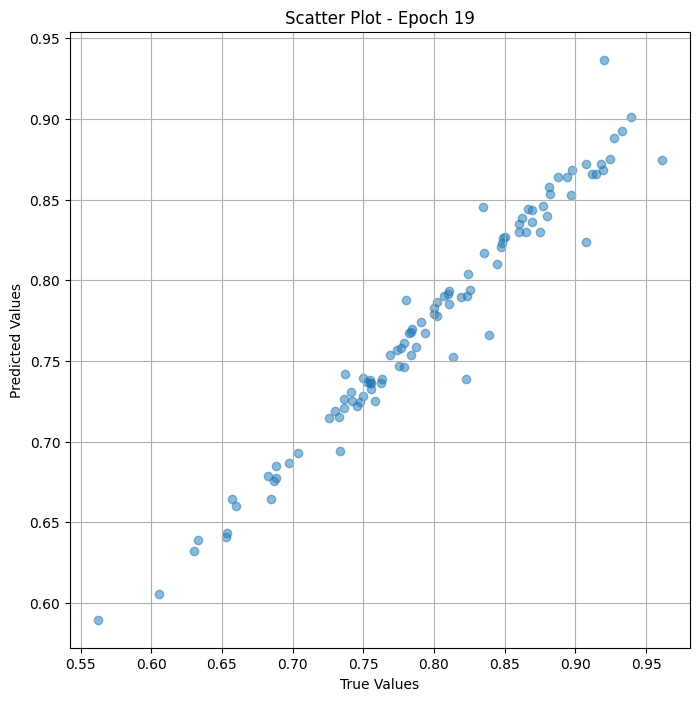

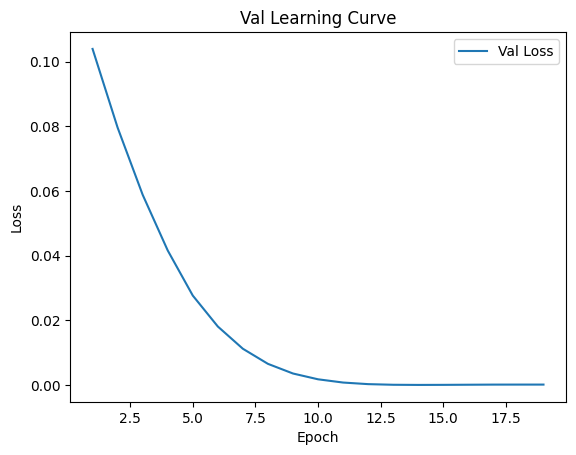

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (20/50) Loss = 0.00011765959789045155

 Epoch: (20/50) Loss_rmse = 0.010847100988030434

 Epoch: (20/50) R^2 = 0.9748616814613342

 Epoch: (20/50) MAE = 0.009843066334724426
Spearman correlation coefficient: SignificanceResult(statistic=0.9841559447766701, pvalue=1.9989021425770776e-72)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.65263

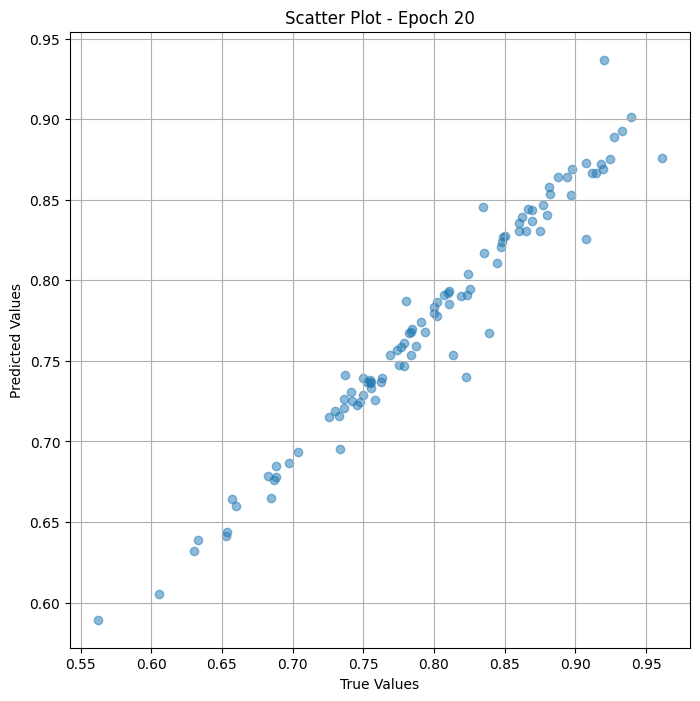

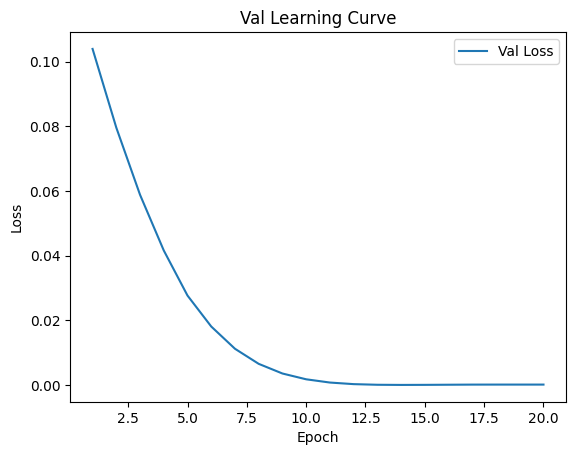


 Epoch: (21/50) Loss = 0.00011725074000423774

 Epoch: (21/50) Loss_rmse = 0.010828237980604172

 Epoch: (21/50) R^2 = 0.974949061870575

 Epoch: (21/50) MAE = 0.009808570146560669
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.838

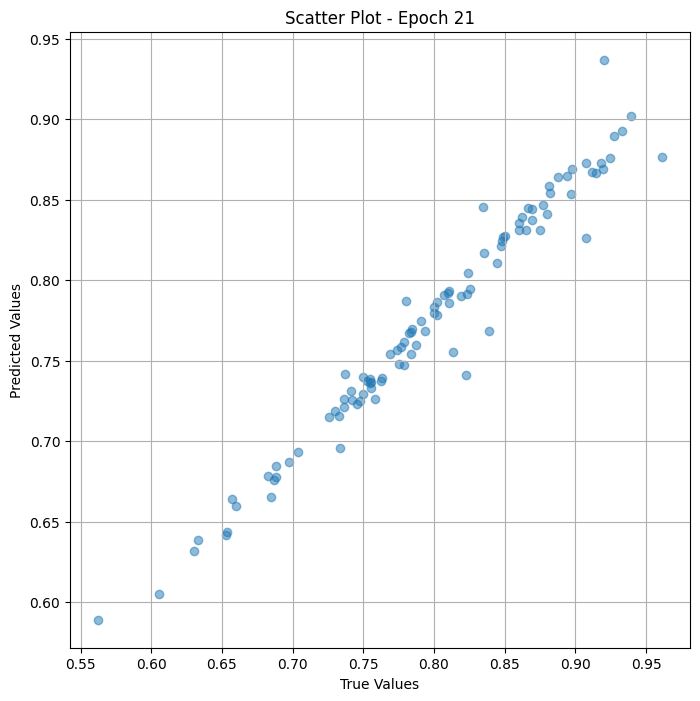

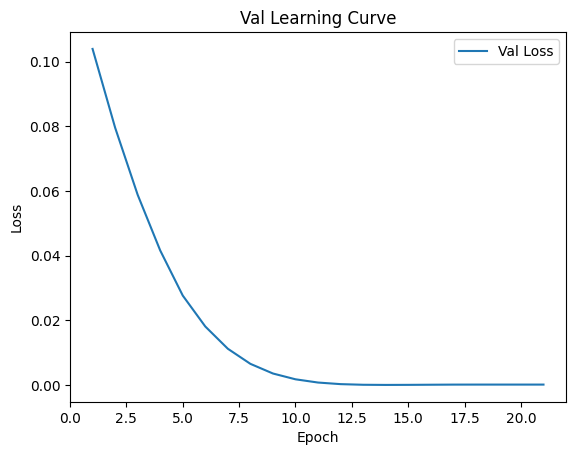


 Epoch: (22/50) Loss = 0.00011713523417711258

 Epoch: (22/50) Loss_rmse = 0.010822903364896774

 Epoch: (22/50) R^2 = 0.974973738193512

 Epoch: (22/50) MAE = 0.009799420833587646
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.838

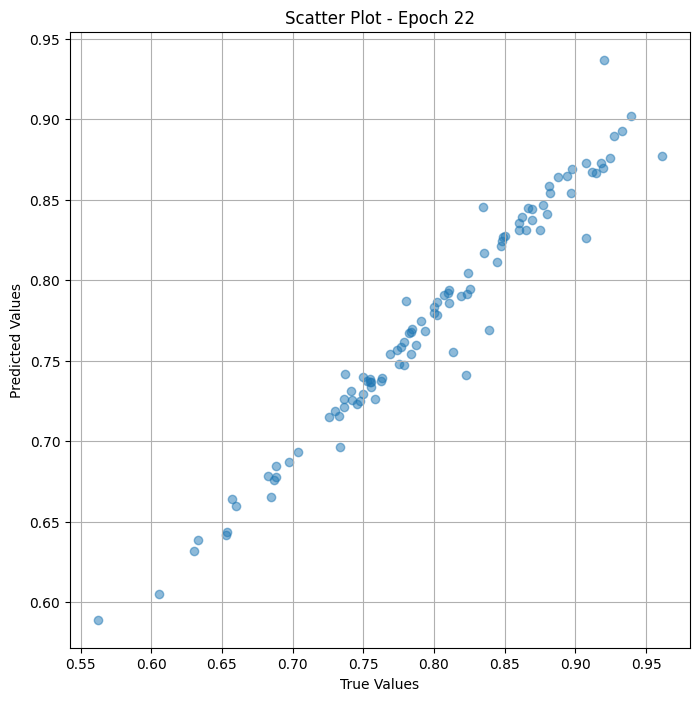

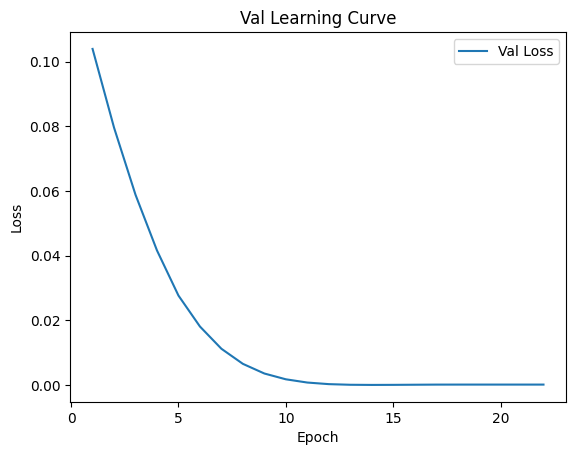

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (23/50) Loss = 0.0001169856550404802

 Epoch: (23/50) Loss_rmse = 0.010815991088747978

 Epoch: (23/50) R^2 = 0.9750056862831116

 Epoch: (23/50) MAE = 0.009789004921913147
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.652631

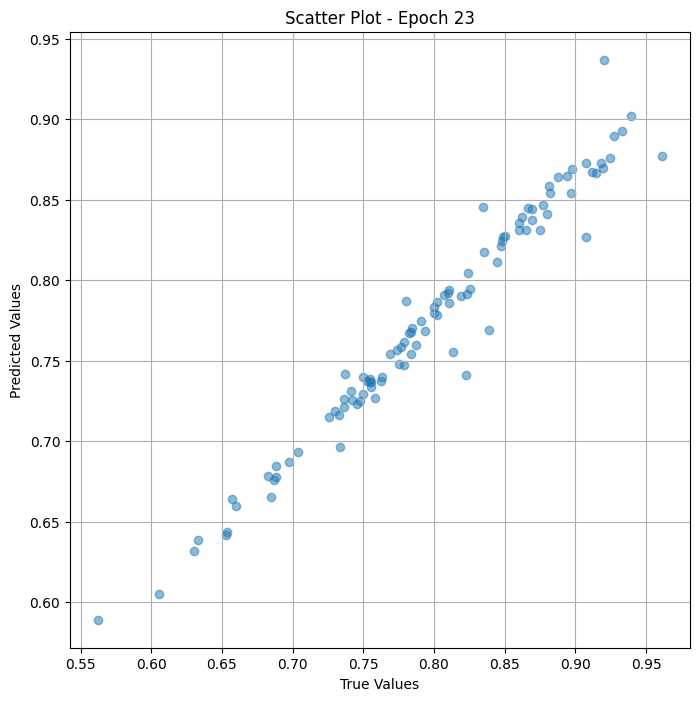

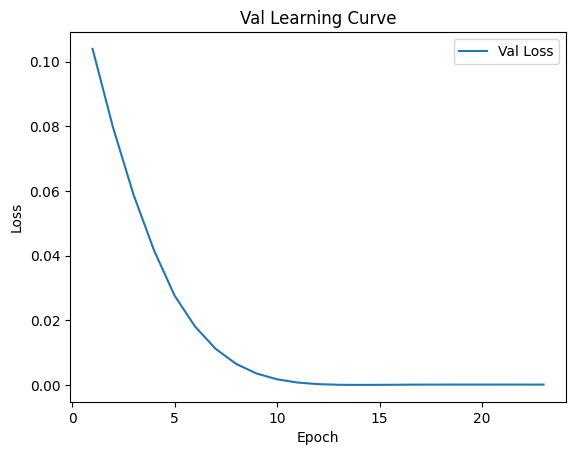


 Epoch: (24/50) Loss = 0.00011691085819620639

 Epoch: (24/50) Loss_rmse = 0.010812532156705856

 Epoch: (24/50) R^2 = 0.9750216603279114

 Epoch: (24/50) MAE = 0.009784221649169922
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

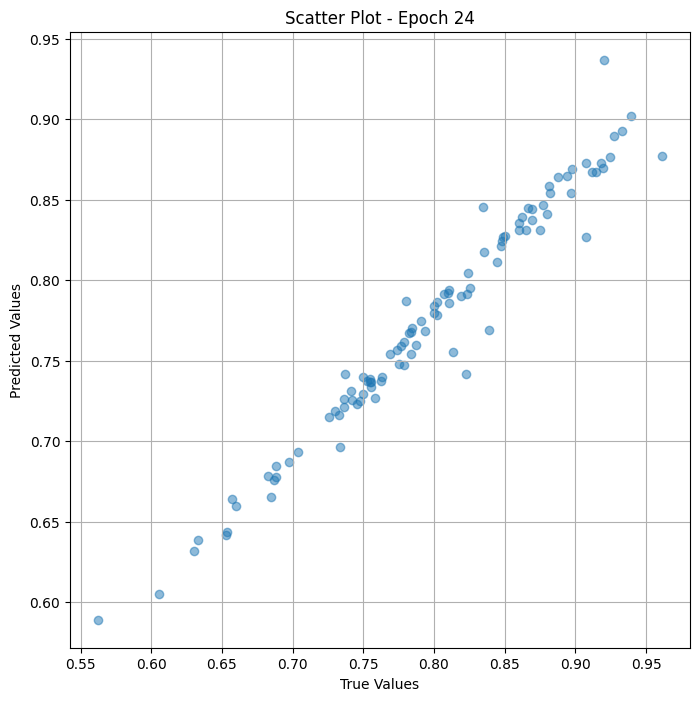

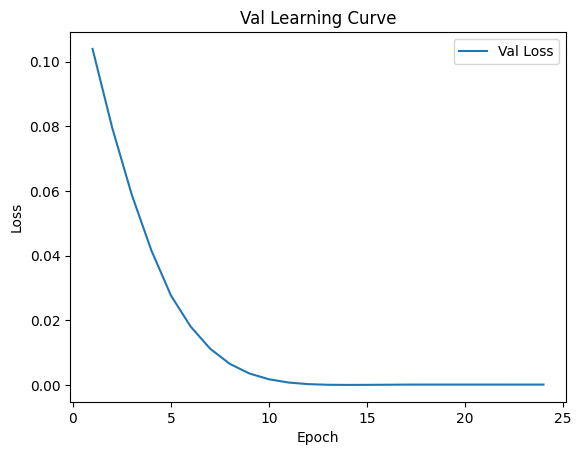


 Epoch: (25/50) Loss = 0.00011689960956573486

 Epoch: (25/50) Loss_rmse = 0.010812012478709221

 Epoch: (25/50) R^2 = 0.9750240445137024

 Epoch: (25/50) MAE = 0.009783416986465454
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

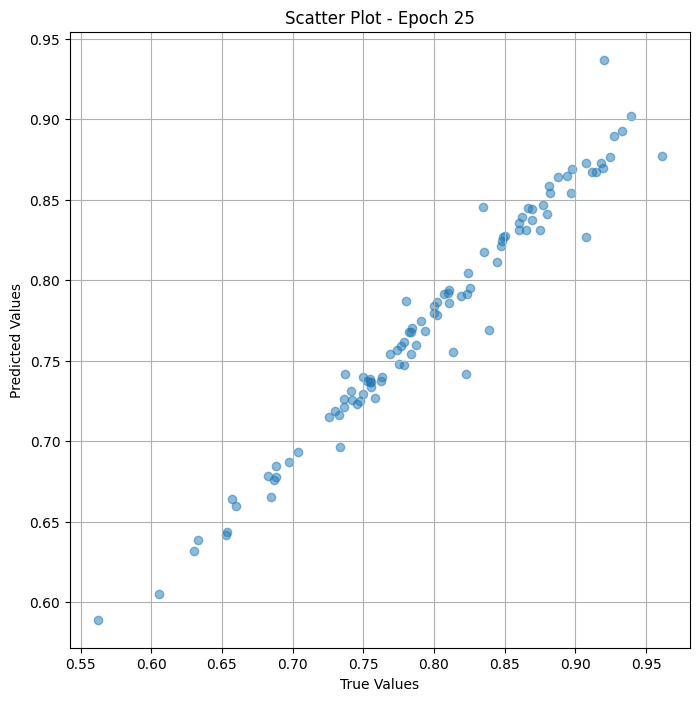

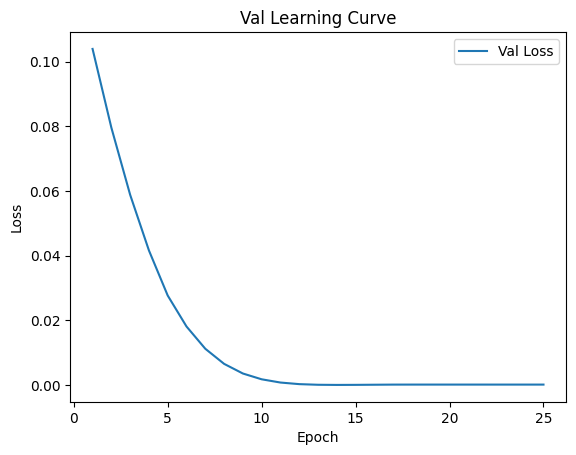

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (26/50) Loss = 0.00011688679660437629

 Epoch: (26/50) Loss_rmse = 0.010811420157551765

 Epoch: (26/50) R^2 = 0.9750267863273621

 Epoch: (26/50) MAE = 0.009782582521438599
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.65263

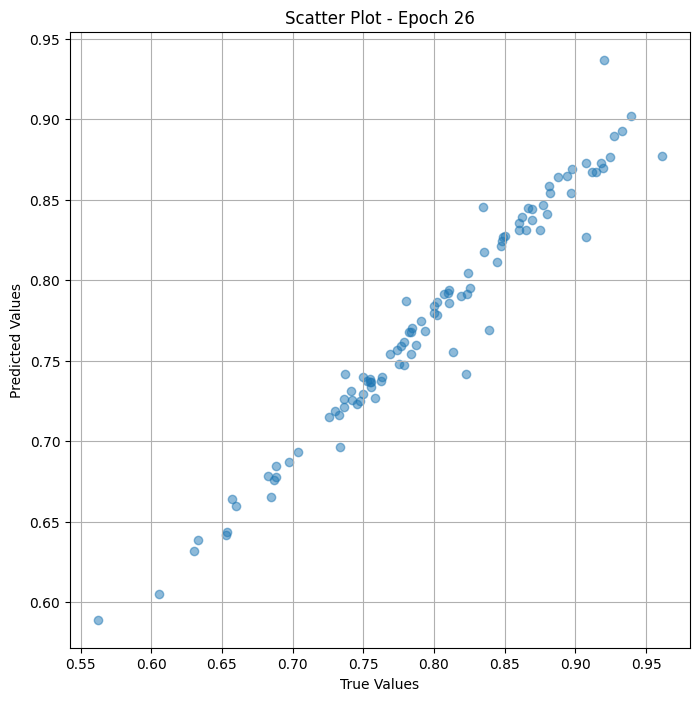

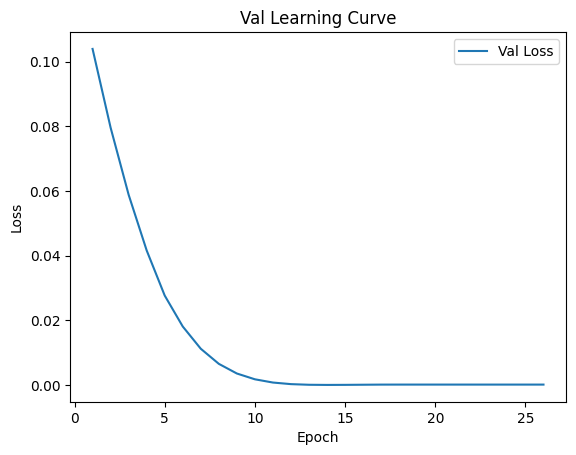


 Epoch: (27/50) Loss = 0.00011688277299981564

 Epoch: (27/50) Loss_rmse = 0.010811233893036842

 Epoch: (27/50) R^2 = 0.9750276803970337

 Epoch: (27/50) MAE = 0.009782284498214722
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

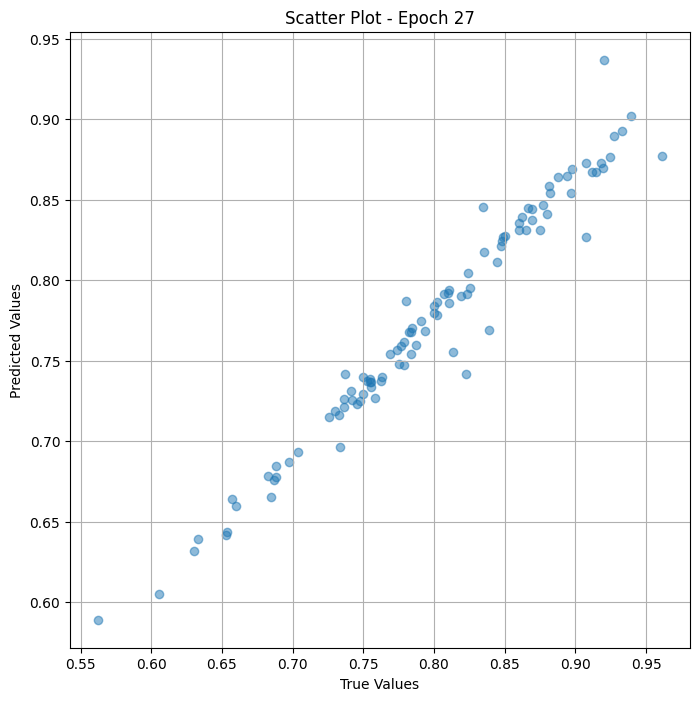

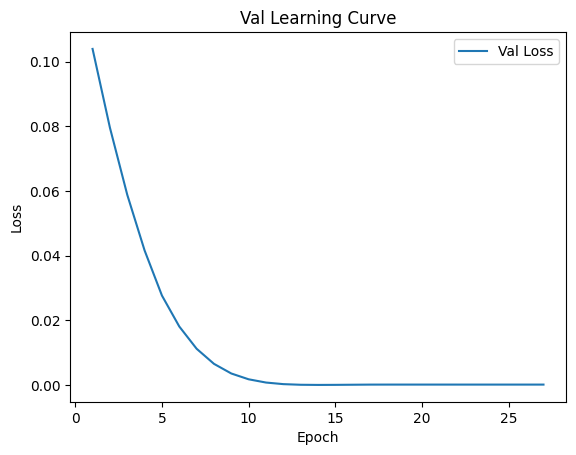


 Epoch: (28/50) Loss = 0.0001168850576505065

 Epoch: (28/50) Loss_rmse = 0.010811339132487774

 Epoch: (28/50) R^2 = 0.9750271439552307

 Epoch: (28/50) MAE = 0.009782388806343079
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.838

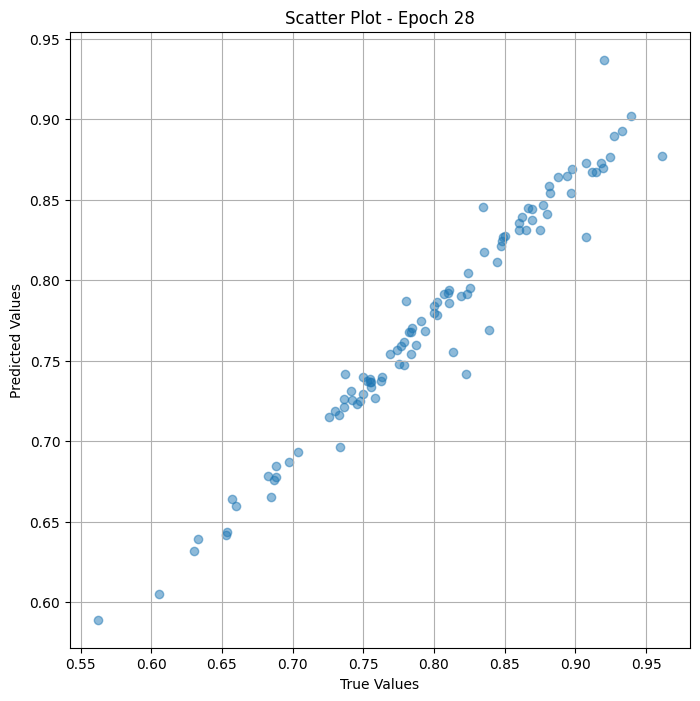

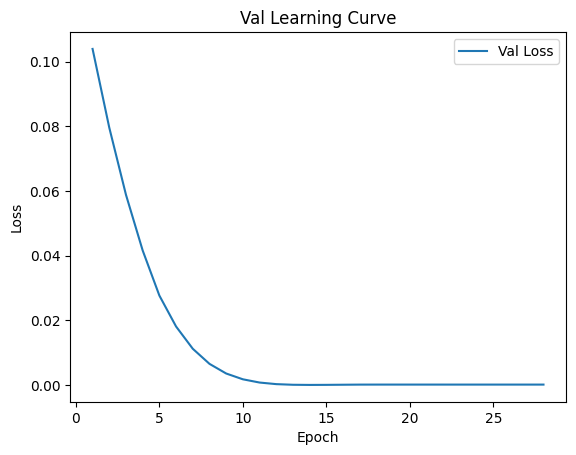


 Epoch: (29/50) Loss = 0.00011688656377373263

 Epoch: (29/50) Loss_rmse = 0.01081140898168087

 Epoch: (29/50) R^2 = 0.9750268459320068

 Epoch: (29/50) MAE = 0.009782478213310242
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.838

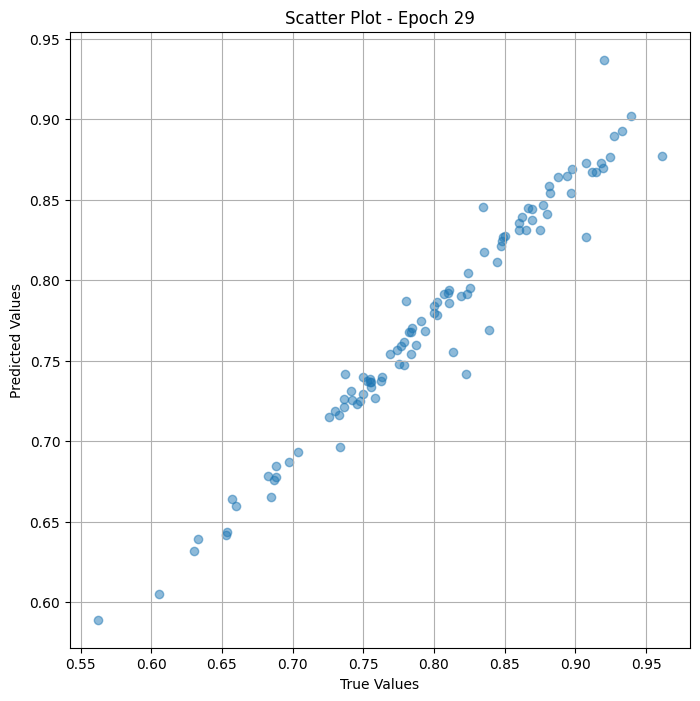

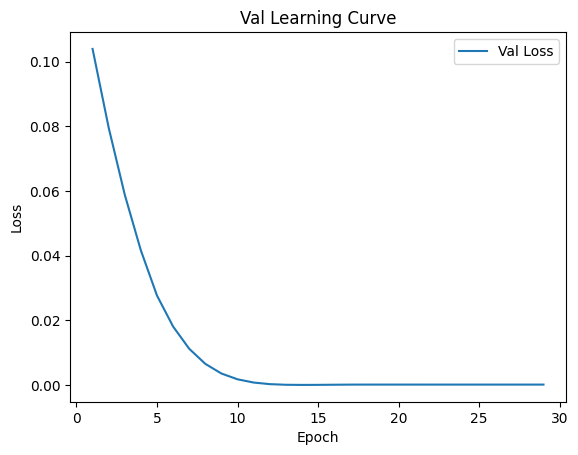


 Epoch: (30/50) Loss = 0.00011688857921399176

 Epoch: (30/50) Loss_rmse = 0.010811502113938332

 Epoch: (30/50) R^2 = 0.9750264286994934

 Epoch: (30/50) MAE = 0.009782552719116211
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

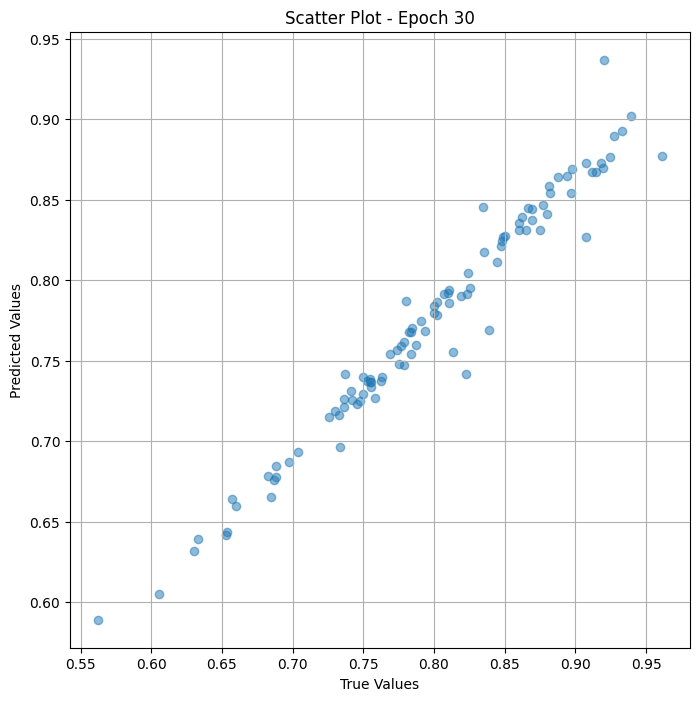

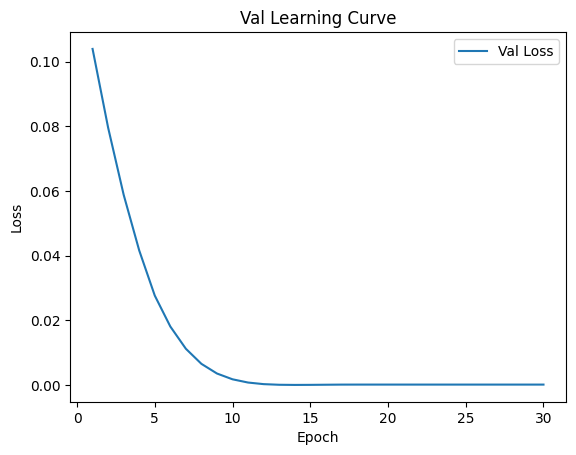


 Epoch: (31/50) Loss = 0.00011689102393575013

 Epoch: (31/50) Loss_rmse = 0.01081161480396986

 Epoch: (31/50) R^2 = 0.9750258922576904

 Epoch: (31/50) MAE = 0.00978270173072815
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.8387

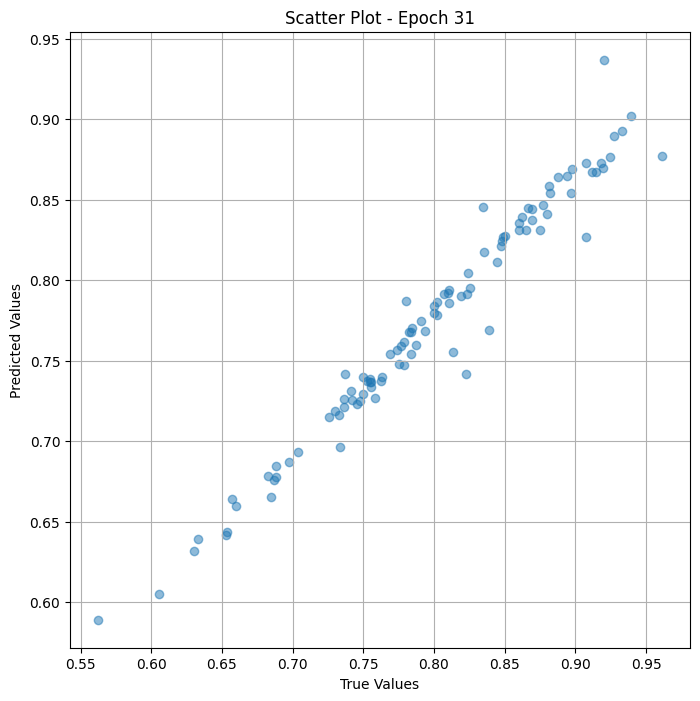

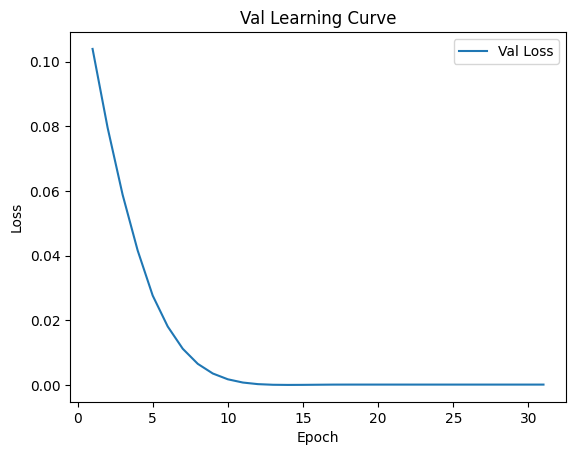


 Epoch: (32/50) Loss = 0.00011689335224218667

 Epoch: (32/50) Loss_rmse = 0.010811722837388515

 Epoch: (32/50) R^2 = 0.9750254154205322

 Epoch: (32/50) MAE = 0.0097828209400177
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.8387

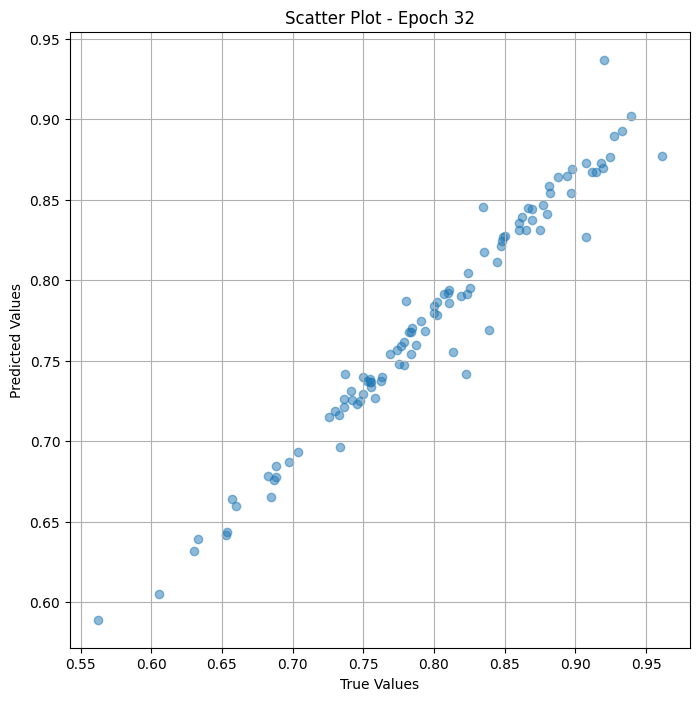

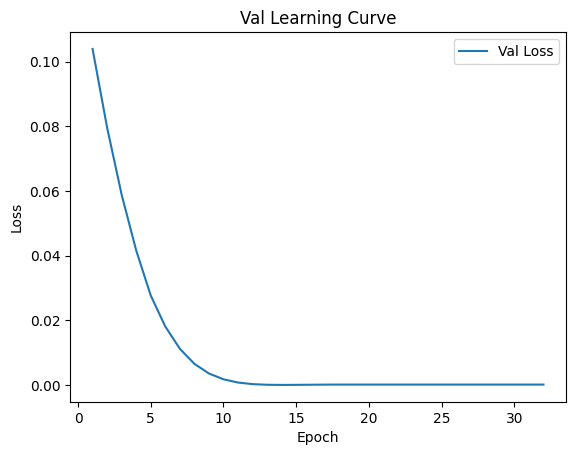


 Epoch: (33/50) Loss = 0.00011689474195009097

 Epoch: (33/50) Loss_rmse = 0.010811787098646164

 Epoch: (33/50) R^2 = 0.9750251173973083

 Epoch: (33/50) MAE = 0.00978289544582367
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.838

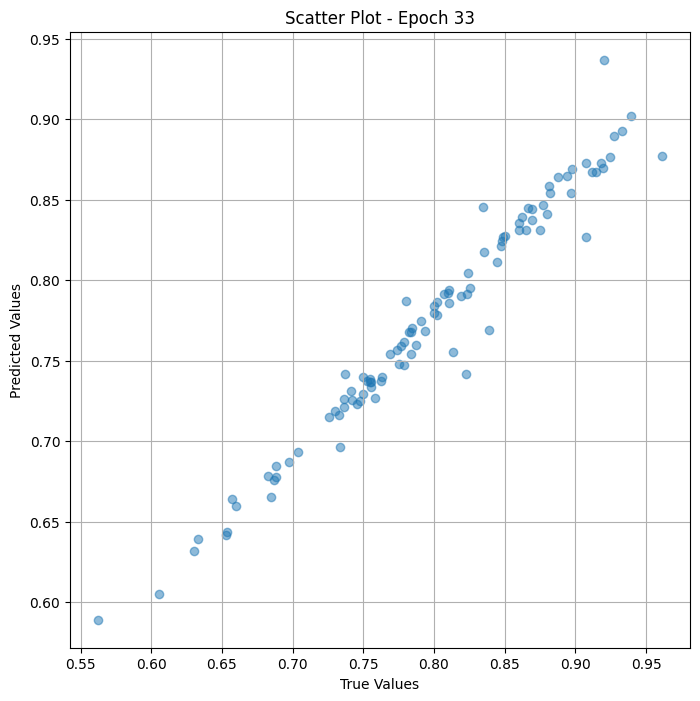

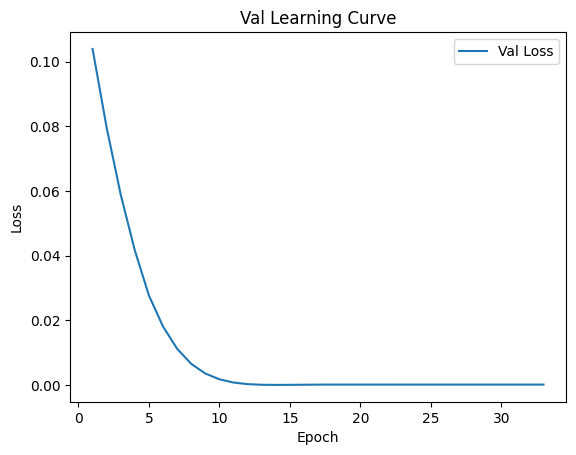


 Epoch: (34/50) Loss = 0.00011689744860632345

 Epoch: (34/50) Loss_rmse = 0.010811911895871162

 Epoch: (34/50) R^2 = 0.9750245213508606

 Epoch: (34/50) MAE = 0.009783029556274414
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

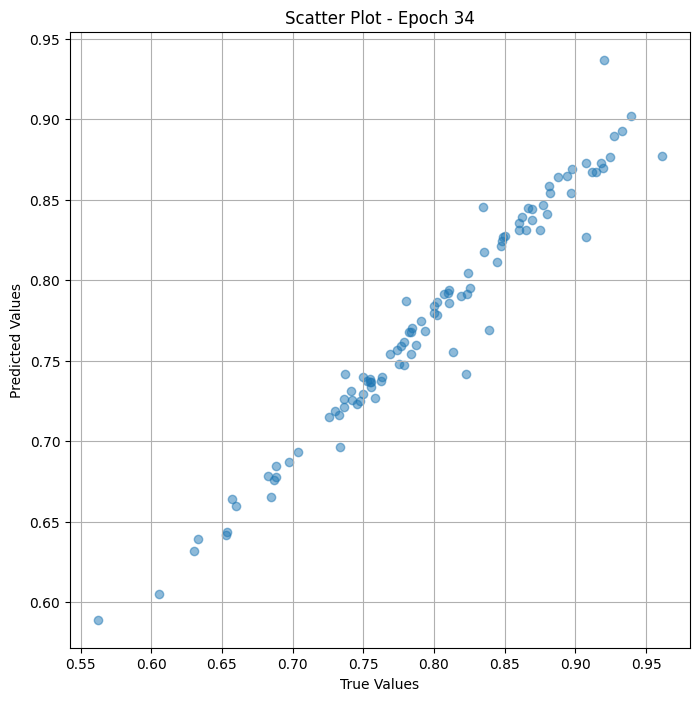

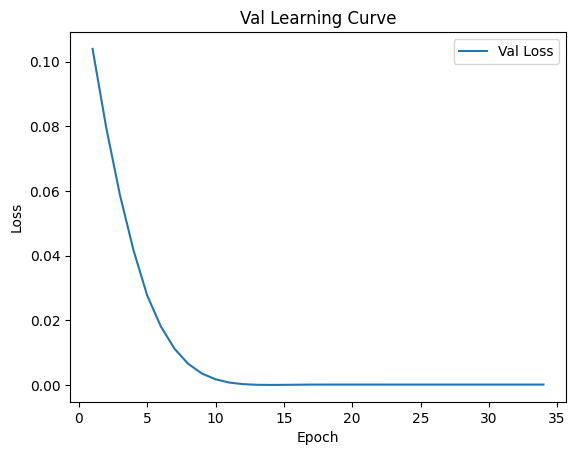


 Epoch: (35/50) Loss = 0.0001168986564152874

 Epoch: (35/50) Loss_rmse = 0.01081196777522564

 Epoch: (35/50) R^2 = 0.9750242829322815

 Epoch: (35/50) MAE = 0.00978308916091919
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870

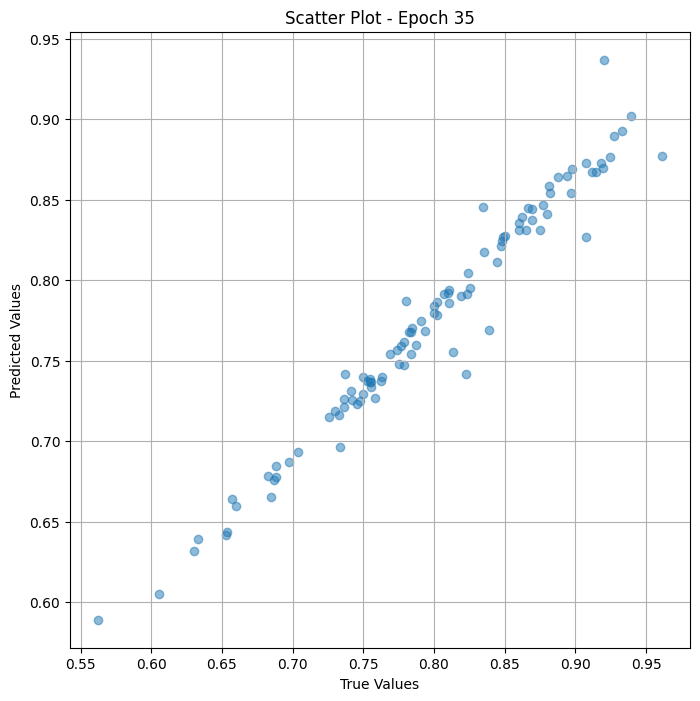

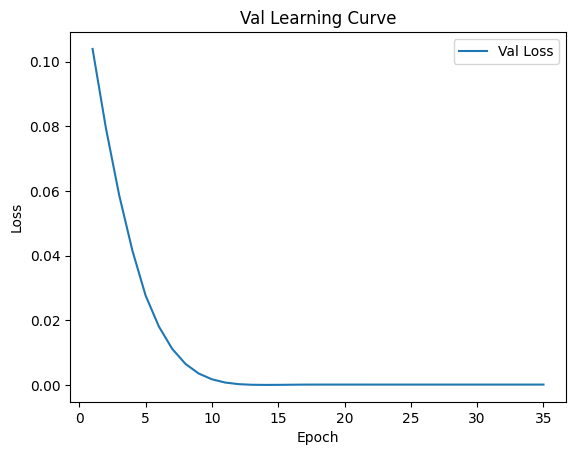


 Epoch: (36/50) Loss = 0.00011690093379002064

 Epoch: (36/50) Loss_rmse = 0.010812073945999146

 Epoch: (36/50) R^2 = 0.9750237464904785

 Epoch: (36/50) MAE = 0.009783193469047546
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

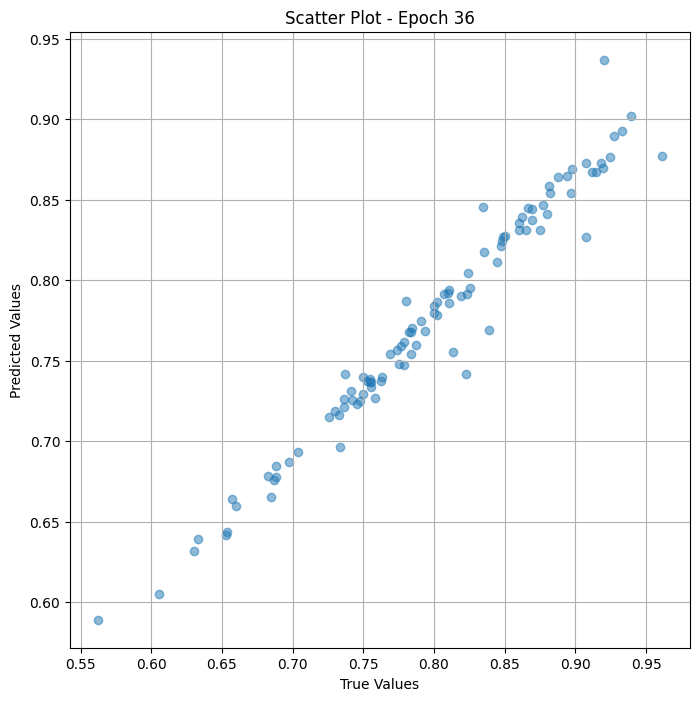

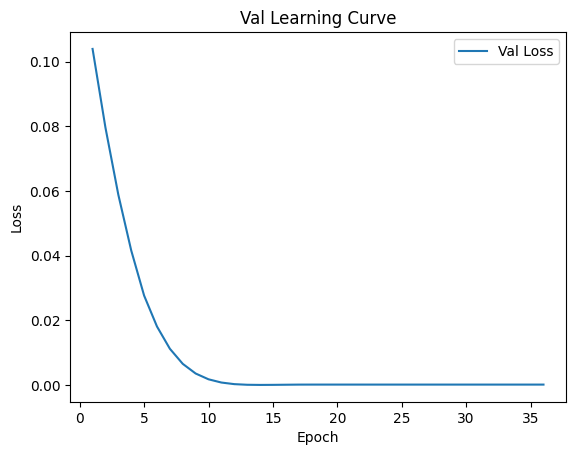


 Epoch: (37/50) Loss = 0.00011690250539686531

 Epoch: (37/50) Loss_rmse = 0.010812146589159966

 Epoch: (37/50) R^2 = 0.9750234484672546

 Epoch: (37/50) MAE = 0.009783297777175903
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

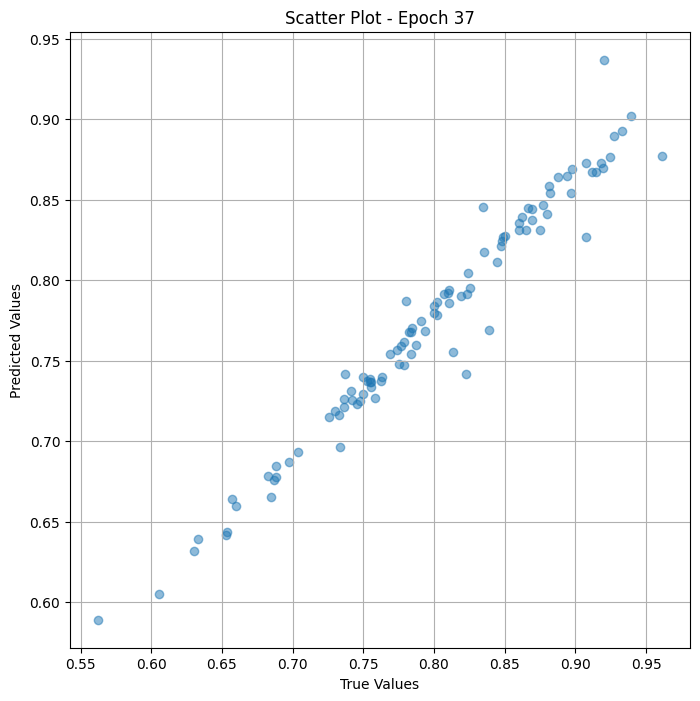

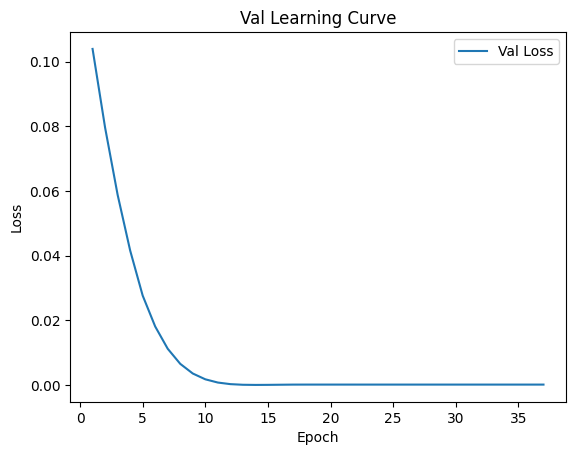


 Epoch: (38/50) Loss = 0.00011690426617860794

 Epoch: (38/50) Loss_rmse = 0.010812227614223957

 Epoch: (38/50) R^2 = 0.9750230312347412

 Epoch: (38/50) MAE = 0.009783372282981873
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

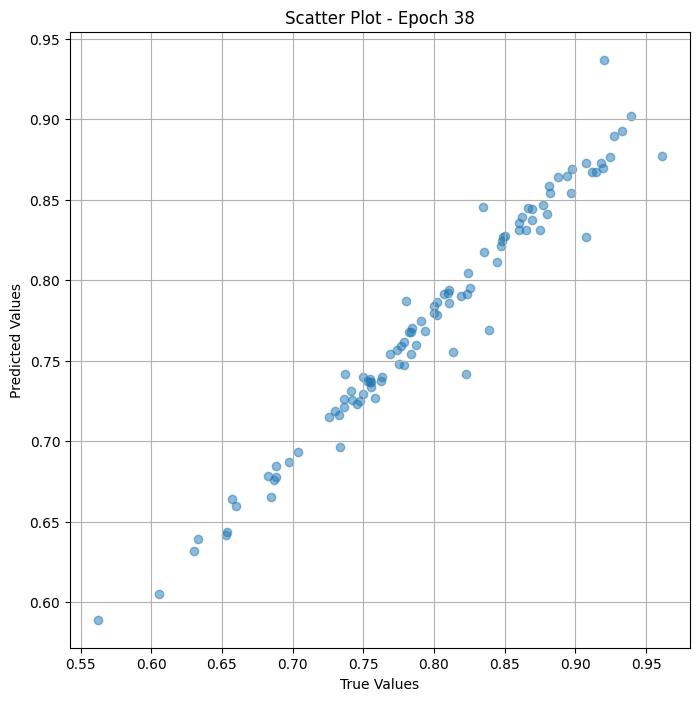

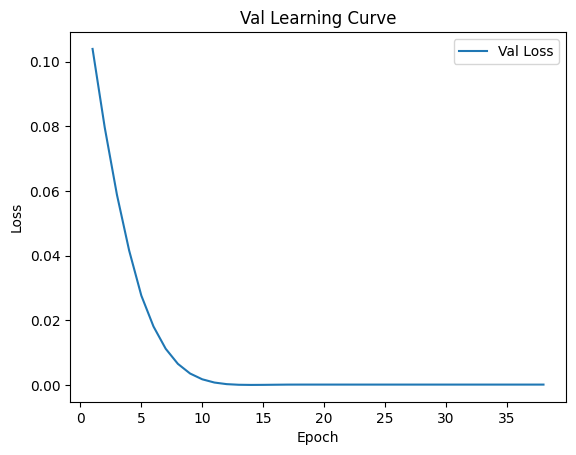


 Epoch: (39/50) Loss = 0.00011690739484038204

 Epoch: (39/50) Loss_rmse = 0.010812371969223022

 Epoch: (39/50) R^2 = 0.9750223755836487

 Epoch: (39/50) MAE = 0.009783506393432617
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

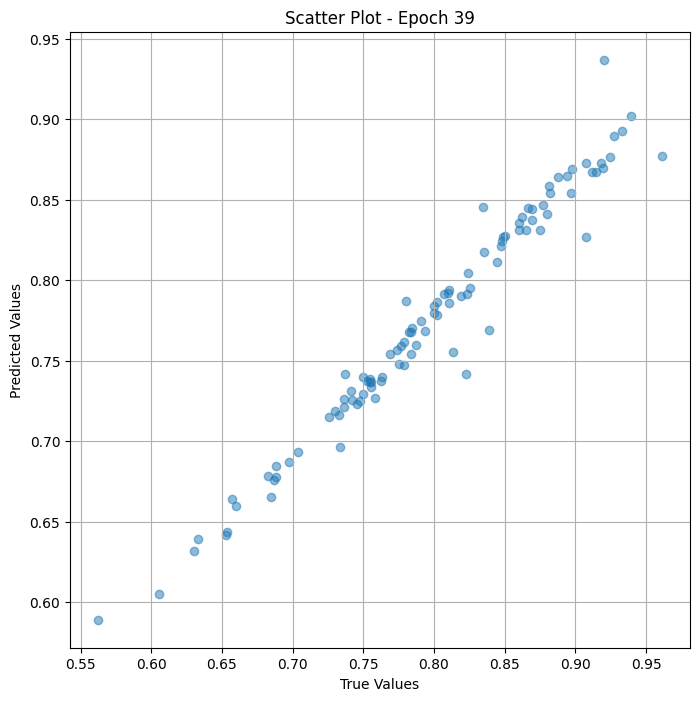

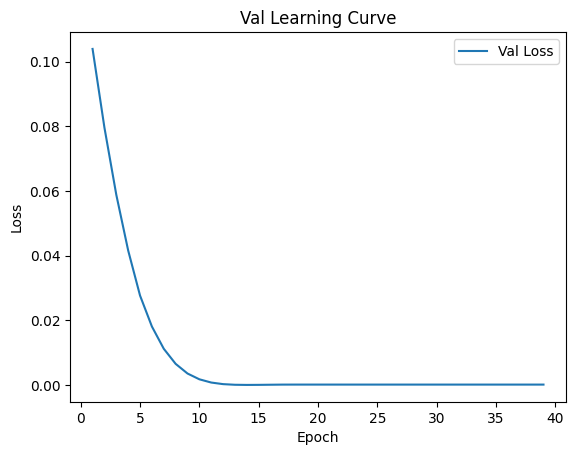


 Epoch: (40/50) Loss = 0.00011690920655382797

 Epoch: (40/50) Loss_rmse = 0.010812455788254738

 Epoch: (40/50) R^2 = 0.97502201795578

 Epoch: (40/50) MAE = 0.00978359580039978
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870

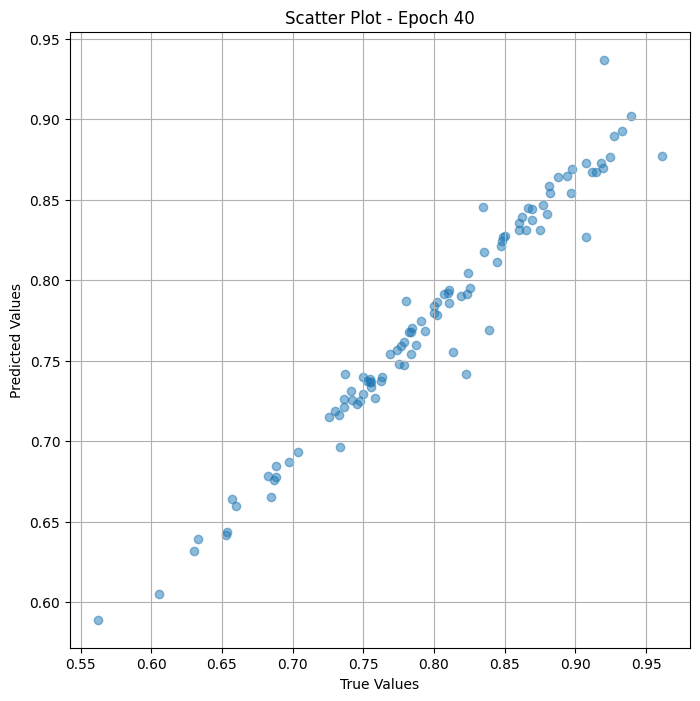

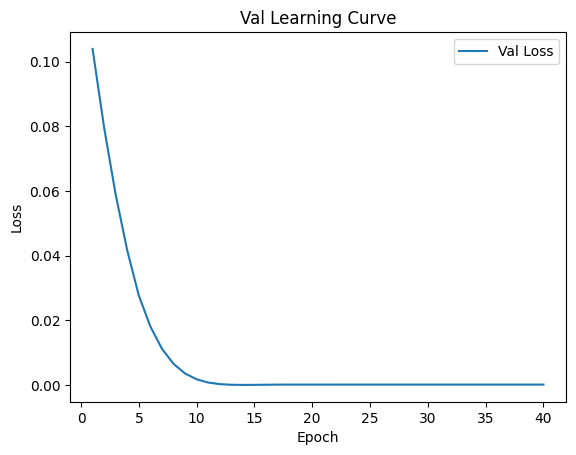


 Epoch: (41/50) Loss = 0.00011691097461152822

 Epoch: (41/50) Loss_rmse = 0.010812537744641304

 Epoch: (41/50) R^2 = 0.9750216007232666

 Epoch: (41/50) MAE = 0.009783685207366943
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

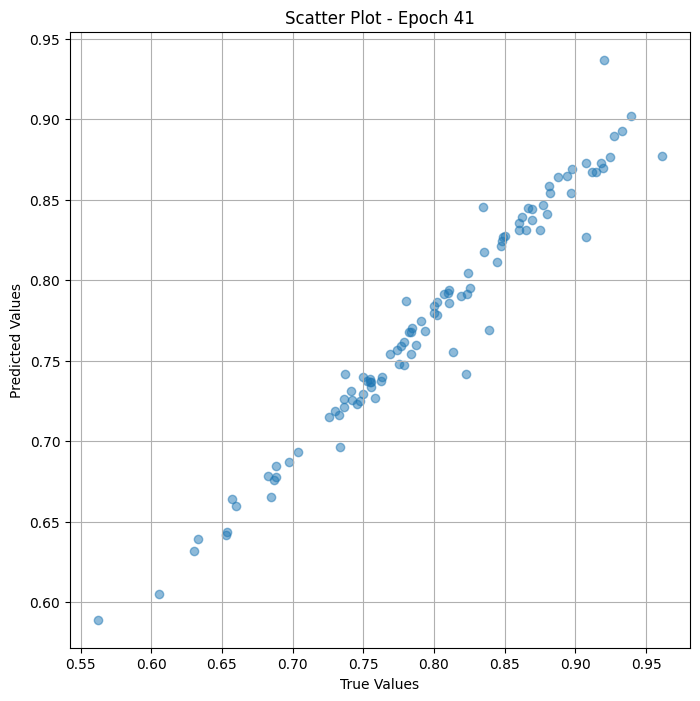

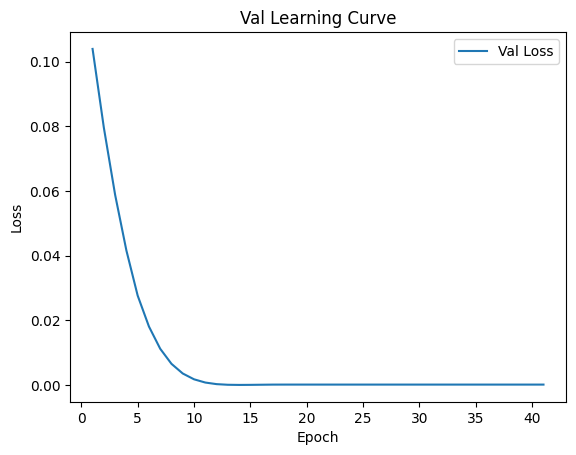


 Epoch: (42/50) Loss = 0.00011691369581967592

 Epoch: (42/50) Loss_rmse = 0.010812663473188877

 Epoch: (42/50) R^2 = 0.9750210642814636

 Epoch: (42/50) MAE = 0.00978386402130127
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.838

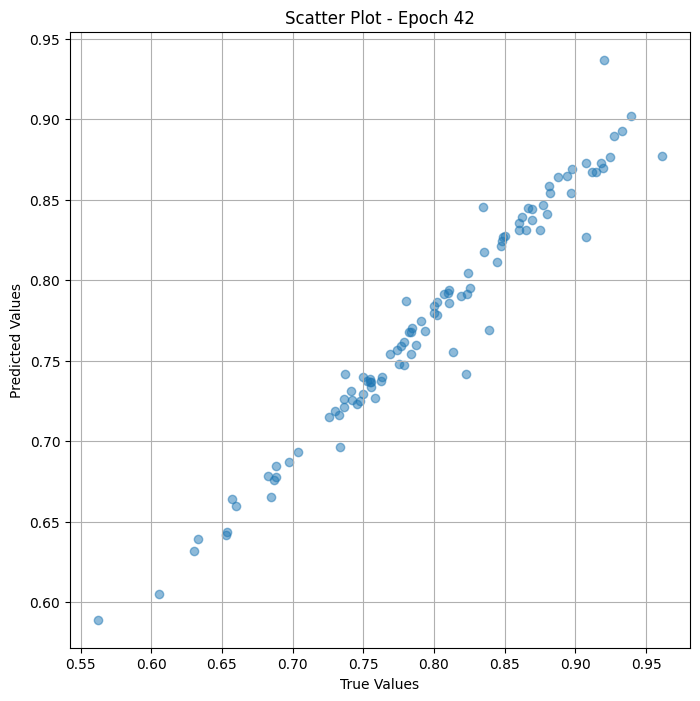

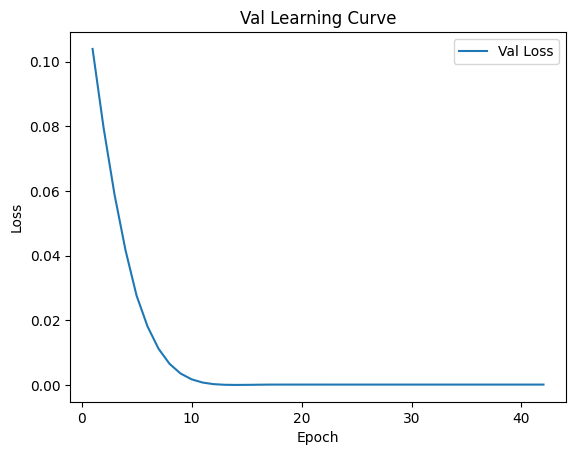


 Epoch: (43/50) Loss = 0.00011691570398397744

 Epoch: (43/50) Loss_rmse = 0.010812756605446339

 Epoch: (43/50) R^2 = 0.9750206470489502

 Epoch: (43/50) MAE = 0.009783938527107239
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

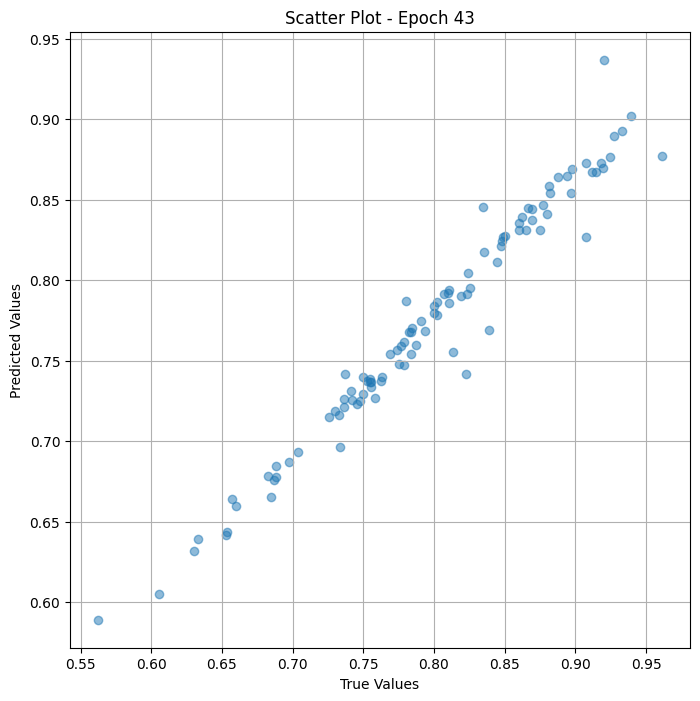

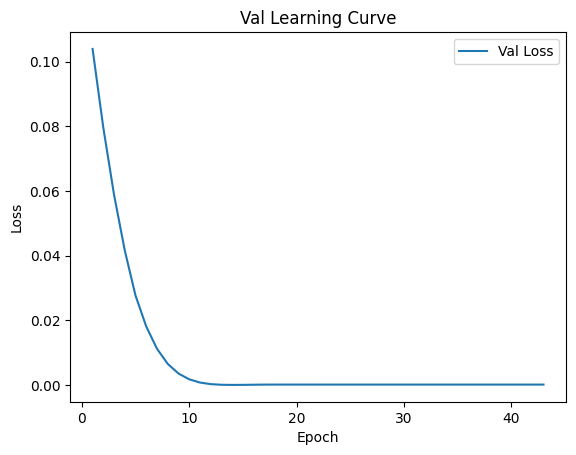


 Epoch: (44/50) Loss = 0.00011691731924656779

 Epoch: (44/50) Loss_rmse = 0.010812831111252308

 Epoch: (44/50) R^2 = 0.9750202894210815

 Epoch: (44/50) MAE = 0.009784013032913208
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

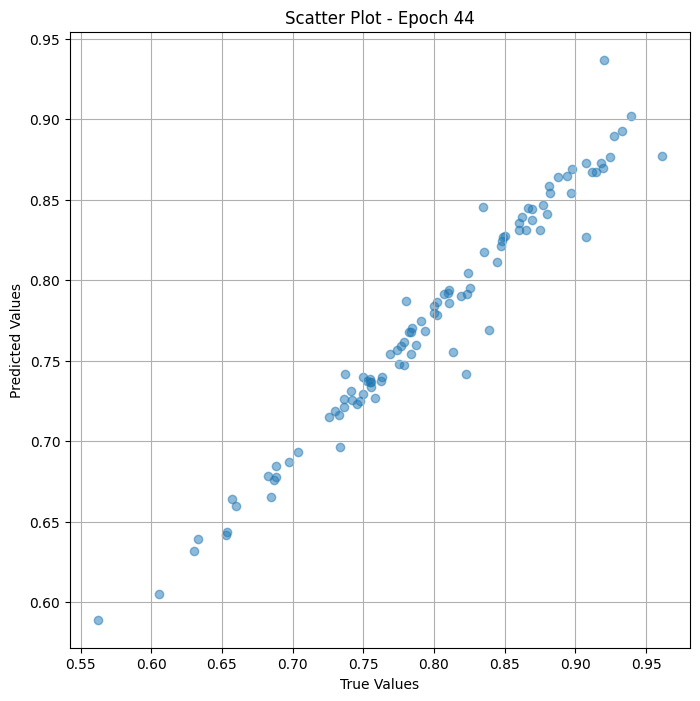

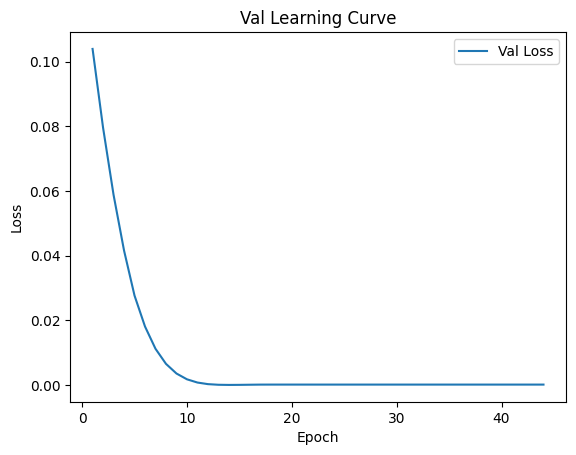


 Epoch: (45/50) Loss = 0.00011691947293002158

 Epoch: (45/50) Loss_rmse = 0.010812930762767792

 Epoch: (45/50) R^2 = 0.9750198125839233

 Epoch: (45/50) MAE = 0.009784147143363953
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

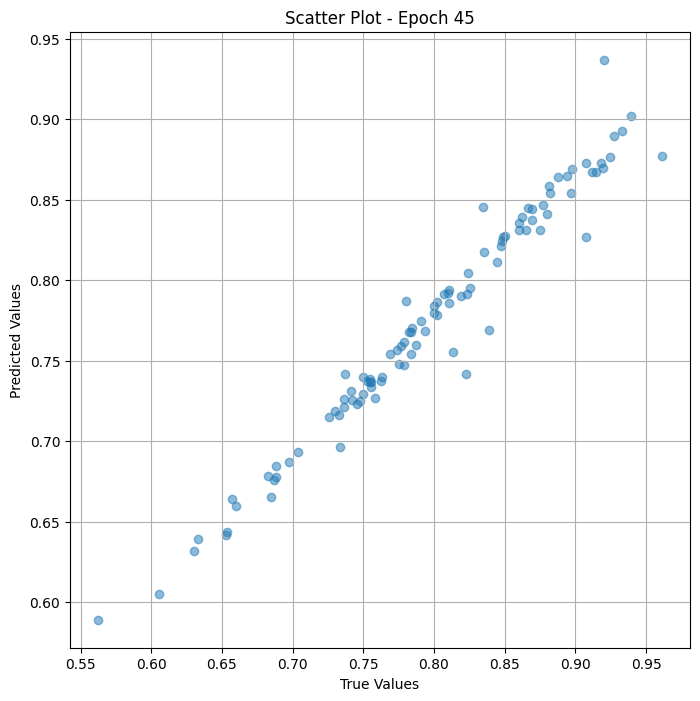

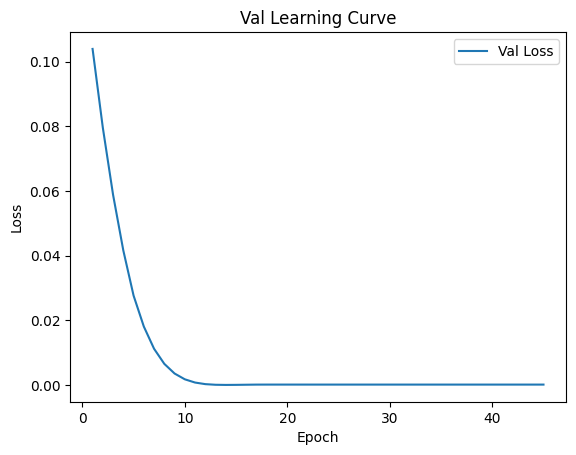


 Epoch: (46/50) Loss = 0.00011692147381836548

 Epoch: (46/50) Loss_rmse = 0.010813022963702679

 Epoch: (46/50) R^2 = 0.9750193953514099

 Epoch: (46/50) MAE = 0.009784266352653503
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

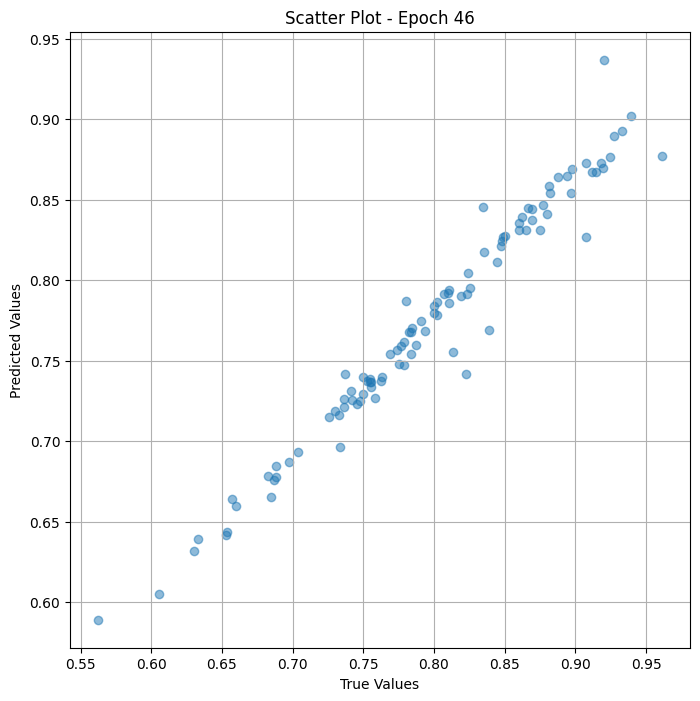

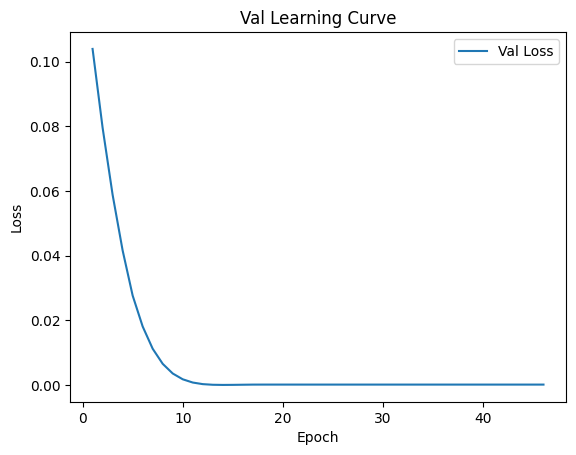


 Epoch: (47/50) Loss = 0.00011692362022586167

 Epoch: (47/50) Loss_rmse = 0.010813122615218163

 Epoch: (47/50) R^2 = 0.9750189185142517

 Epoch: (47/50) MAE = 0.009784340858459473
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

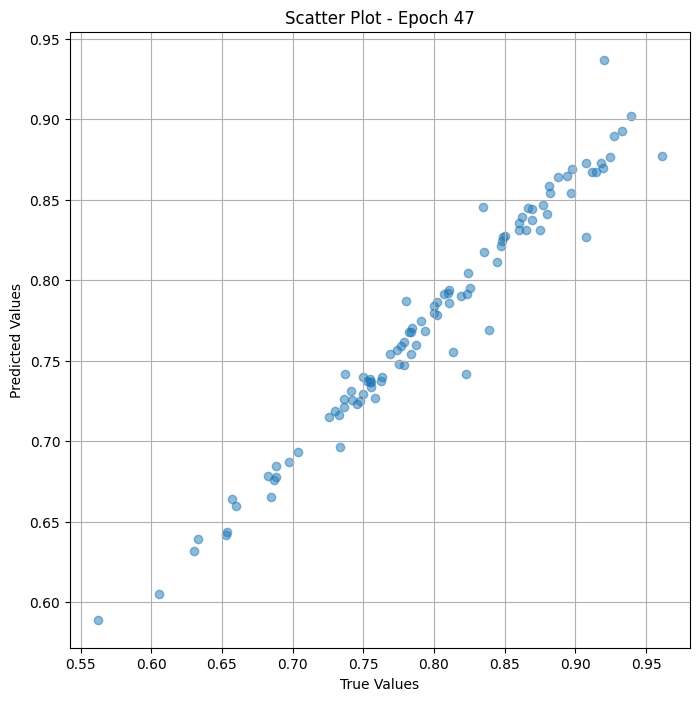

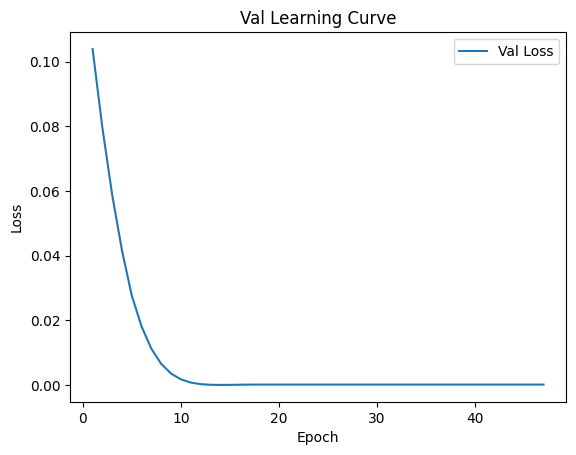


 Epoch: (48/50) Loss = 0.00011692536645568907

 Epoch: (48/50) Loss_rmse = 0.010813203640282154

 Epoch: (48/50) R^2 = 0.9750185608863831

 Epoch: (48/50) MAE = 0.00978444516658783
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.838

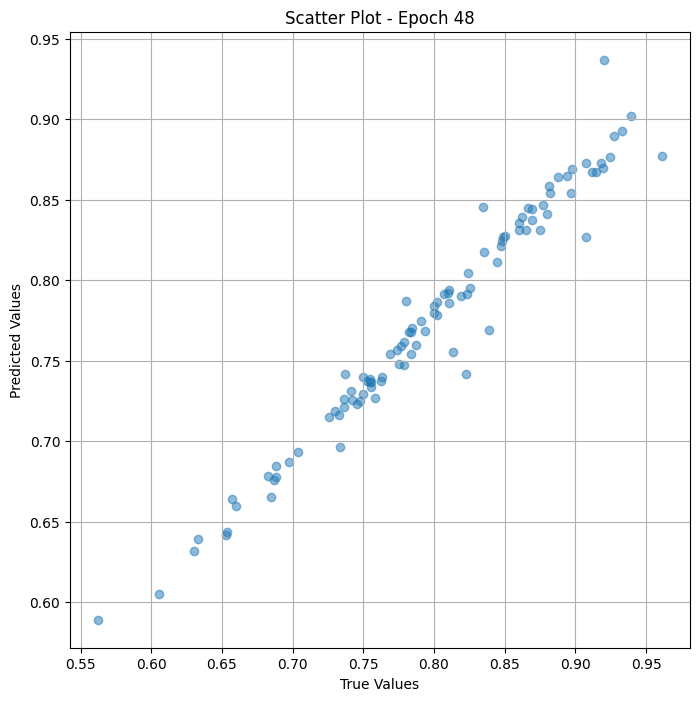

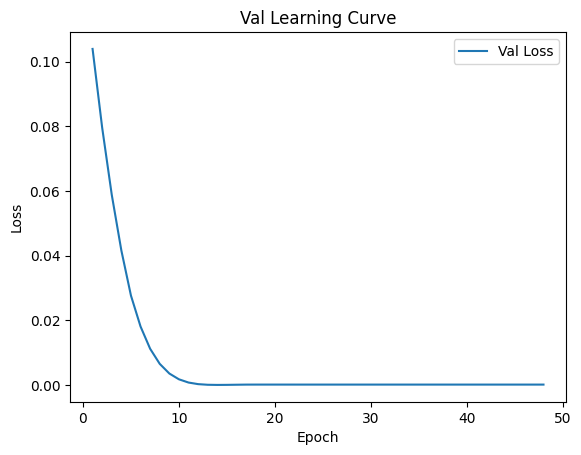


 Epoch: (49/50) Loss = 0.00011692727275658399

 Epoch: (49/50) Loss_rmse = 0.010813291184604168

 Epoch: (49/50) R^2 = 0.9750181436538696

 Epoch: (49/50) MAE = 0.009784534573554993
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

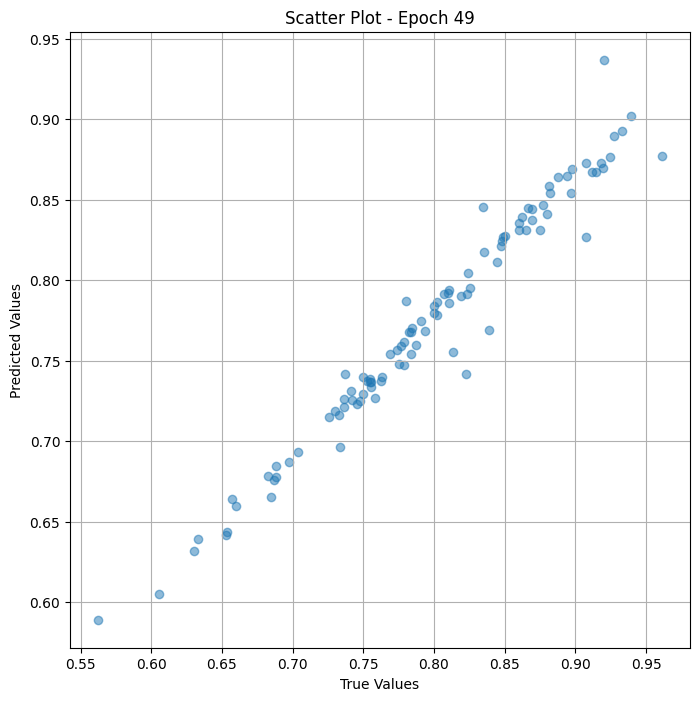

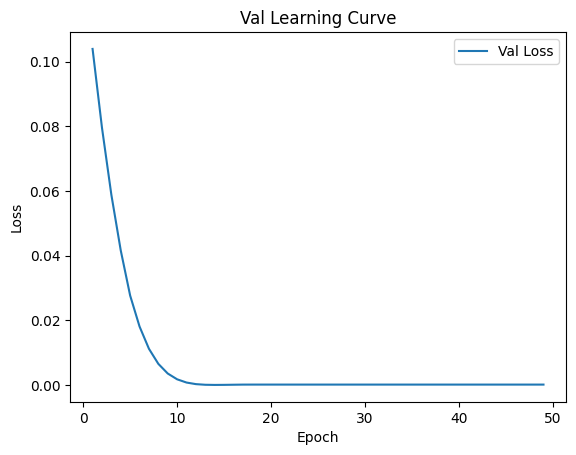


 Epoch: (50/50) Loss = 0.00011692980478983372

 Epoch: (50/50) Loss_rmse = 0.01081340853124857

 Epoch: (50/50) R^2 = 0.9750176072120667

 Epoch: (50/50) MAE = 0.009784668684005737
Spearman correlation coefficient: SignificanceResult(statistic=0.9853632400962768, pvalue=4.9531440566511635e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.838

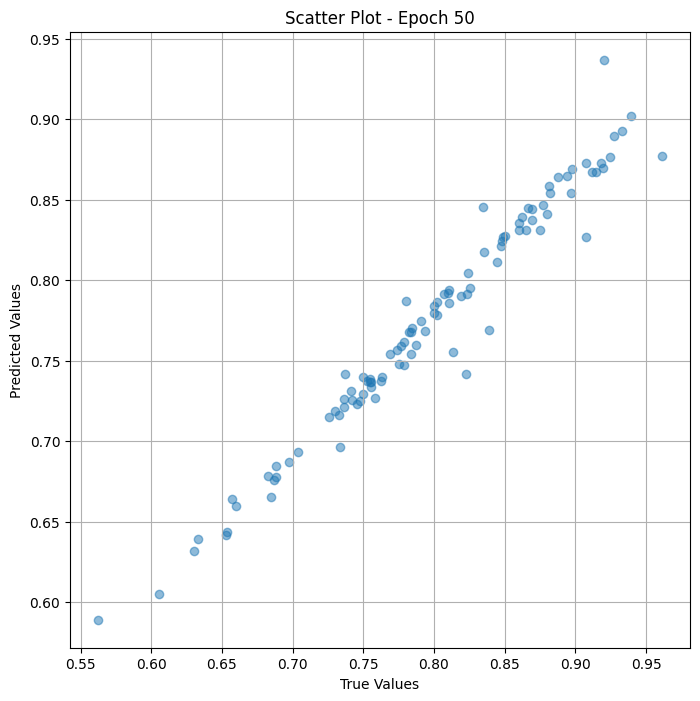

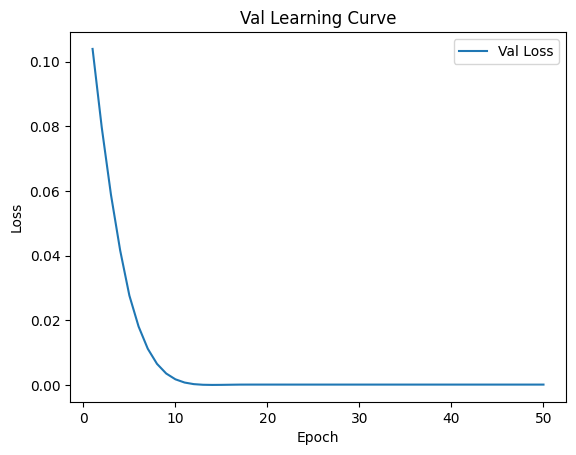

In [ ]:
# val the model and save weights
fit(50, model_res_val , val_dl )
torch.save(model_res_val .state_dict(), "model_weights_s")

In [ ]:
true_values_list_val = []
predicted_values_list_val = []

for x_trans, yb in val_dl:
    preds = model_res_val(x_trans)
    true_values_list_val.extend(yb.cpu().detach().numpy())
    predicted_values_list_val.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_animal' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_val_animal['preprocessed_image_path'],
    'True Value': true_values_list_val,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_val # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)

                                          Image Path  True Value  \
0    /content/animal/n02118333_6662_preprocessed.jpg    0.810526   
1      /content/animal/n02342885_78_preprocessed.jpg    0.819149   
2    /content/animal/n02434954_5901_preprocessed.jpg    0.784091   
3      /content/animal/000000055601_preprocessed.jpg    0.813725   
4      /content/animal/000000414487_preprocessed.jpg    0.911765   
..                                               ...         ...   
95     /content/animal/000000103331_preprocessed.jpg    0.810000   
96   /content/animal/n02430045_2199_preprocessed.jpg    0.780000   
97   /content/animal/n02381004_7100_preprocessed.jpg    0.736842   
98  /content/animal/n02355227_13168_preprocessed.jpg    0.920000   
99  /content/animal/n02129165_11498_preprocessed.jpg    0.834951   

    Predicted Value  
0          0.785795  
1          0.790420  
2          0.754431  
3          0.755636  
4          0.867227  
..              ...  
95         0.792126  
96     

## Test

In [ ]:
df_test_animal.head()


,preprocessed_image_path,memoscore
0,/content/animal/n01846331_1102_preprocessed.jpg,0.885714
1,/content/animal/n01846331_2820_preprocessed.jpg,0.873684
2,/content/animal/n02118333_329_preprocessed.jpg,0.914894
3,/content/animal/000000144157_preprocessed.jpg,0.890909
4,/content/animal/000000140360_preprocessed.jpg,0.821053


In [ ]:
class Dataset_test_res_animal(Dataset):
    def __init__(self, df, res_transform =None):
        self.labels = df_test_animal["memoscore"]
        self.images = df_test_animal["preprocessed_image_path"]
        self.res_transform  = res_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.res_transform (image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
res_transform   = ConvNextImageProcessor.from_pretrained("facebook/convnext-tiny-224")

# สร้าง Dataset และ DataLoader
test_ds = Dataset_test_res_animal(df_test_animal, res_transform =res_transform )
test_dl = DataLoader(test_ds, batch_size=32, shuffle=False)

In [ ]:
print(test_ds)

In [ ]:
class Resnet_model_test_res_animal(torch.nn.Module):
    def __init__(self, arch="resnet50.a1_in1k"):
        super().__init__()
        self.arch = arch
        self.res = timm.create_model(self.arch, pretrained=True, num_classes=1)

    def forward(self, x):
        resfeat = self.res(x)
        out = torch.sigmoid(resfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_res_test = Resnet_model_test_res_animal( arch="resnet50.a1_in1k")

In [ ]:


# Assuming your model is an instance of YourModelClass and is already on GPU
model = Resnet_model_test_res_animal().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]           4,096
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
         Identity-10           [-1, 64, 56, 56]               0
             ReLU-11           [-1, 64, 56, 56]               0
         Identity-12           [-1, 64, 56, 56]               0
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 256,

In [ ]:
device = get_default_device()
test_dl = DeviceDataLoader(test_dl, device)
model_res_test  = to_device(model_res_test  , device)

In [ ]:
params = [param for param in list(model_res_test.parameters()) if param.requires_grad ]
optimizer = torch.optim.Adam(params, lr=1e-4)   #,weight_decay=1e-7

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res_test, test_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in test_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res_test(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)




 Epoch: (1/50) Loss = 0.0002624299959279597

 Epoch: (1/50) Loss_rmse = 0.016199691221117973

 Epoch: (1/50) R^2 = 0.8395382165908813

 Epoch: (1/50) MAE = 0.014274105429649353
Spearman correlation coefficient: SignificanceResult(statistic=0.9574058249093669, pvalue=1.6640855912398934e-52)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.726

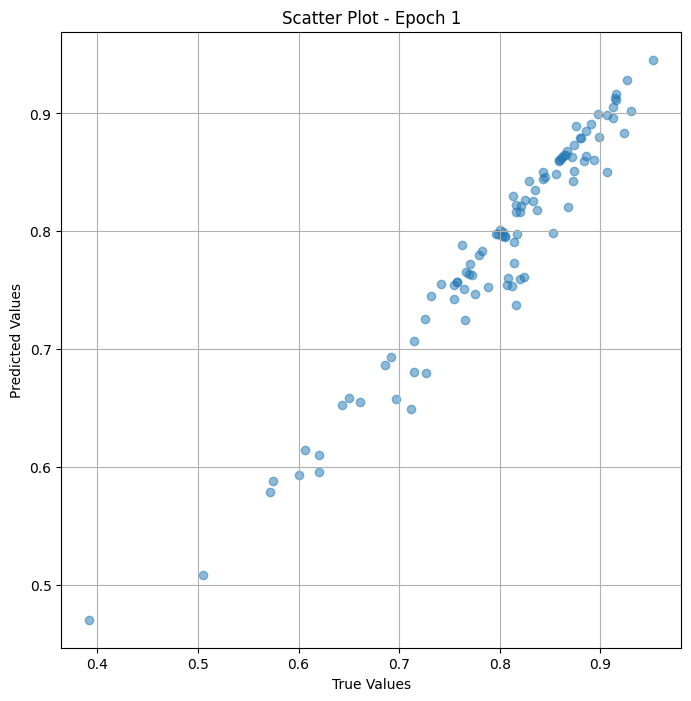

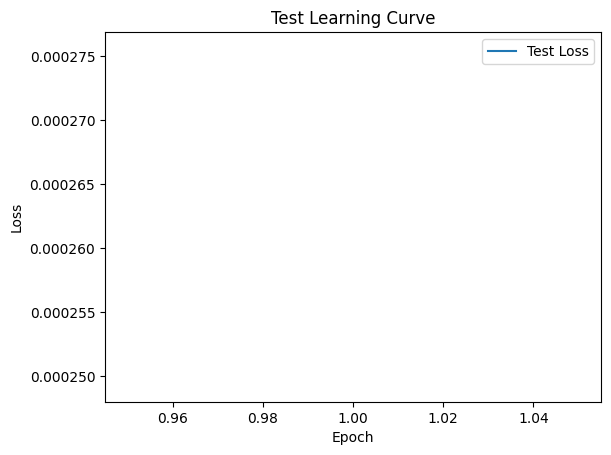


 Epoch: (2/50) Loss = 0.0012199690099805593

 Epoch: (2/50) Loss_rmse = 0.03492805361747742

 Epoch: (2/50) R^2 = 0.2540549039840698

 Epoch: (2/50) MAE = 0.031682878732681274
Spearman correlation coefficient: SignificanceResult(statistic=0.9273660793864522, pvalue=6.502949114660046e-42)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.72631

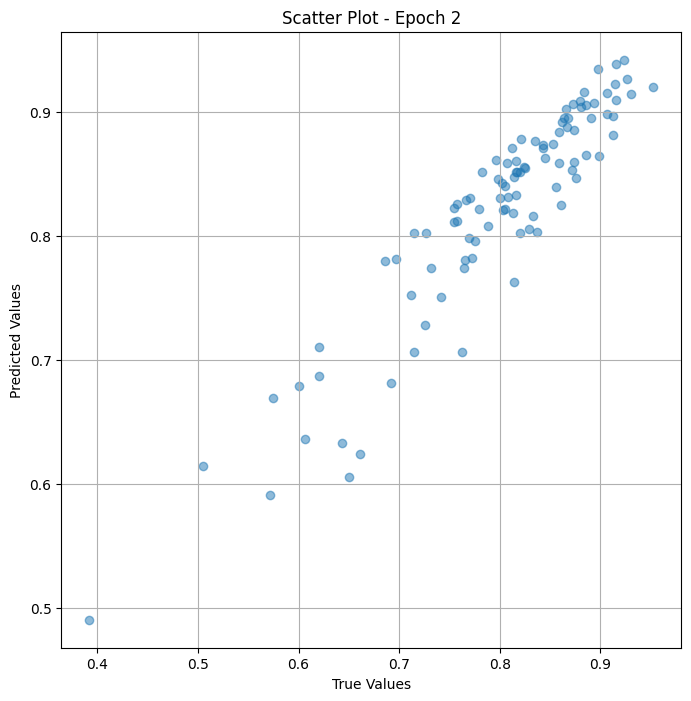

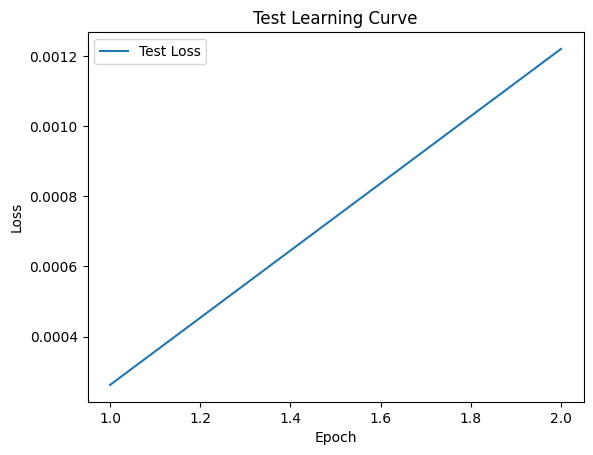


 Epoch: (3/50) Loss = 0.0004284018068574369

 Epoch: (3/50) Loss_rmse = 0.02069786936044693

 Epoch: (3/50) R^2 = 0.7380554676055908

 Epoch: (3/50) MAE = 0.014575257897377014
Spearman correlation coefficient: SignificanceResult(statistic=0.9628996596064905, pvalue=2.8658745872015203e-55)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.7263

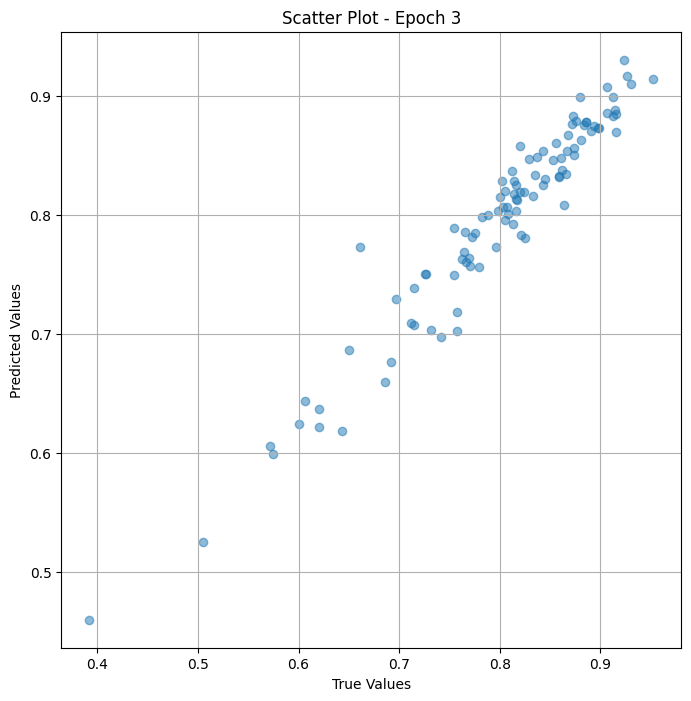

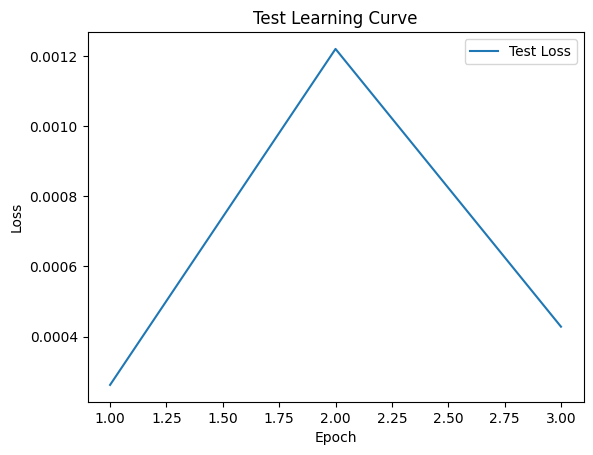

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (4/50) Loss = 0.0003394979576114565

 Epoch: (4/50) Loss_rmse = 0.0184254702180624

 Epoch: (4/50) R^2 = 0.7924153804779053

 Epoch: (4/50) MAE = 0.017947331070899963
Spearman correlation coefficient: SignificanceResult(statistic=0.9625130564241003, pvalue=4.623890764953859e-55)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.8

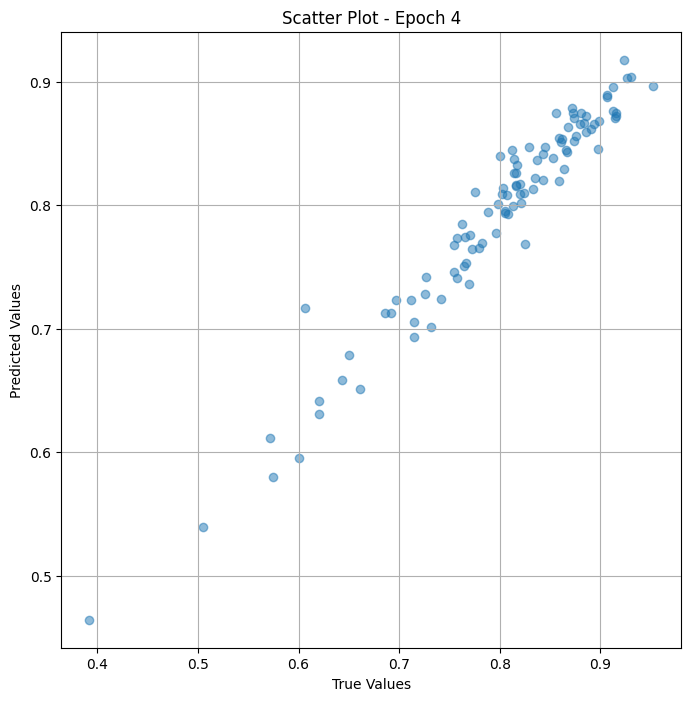

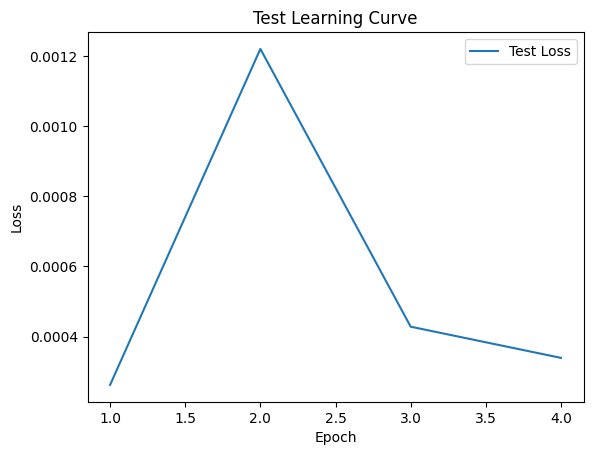


 Epoch: (5/50) Loss = 0.00015137309674173594

 Epoch: (5/50) Loss_rmse = 0.012303377501666546

 Epoch: (5/50) R^2 = 0.9074435234069824

 Epoch: (5/50) MAE = 0.01169423758983612
Spearman correlation coefficient: SignificanceResult(statistic=0.9774888428577414, pvalue=2.5348734435233812e-65)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.726

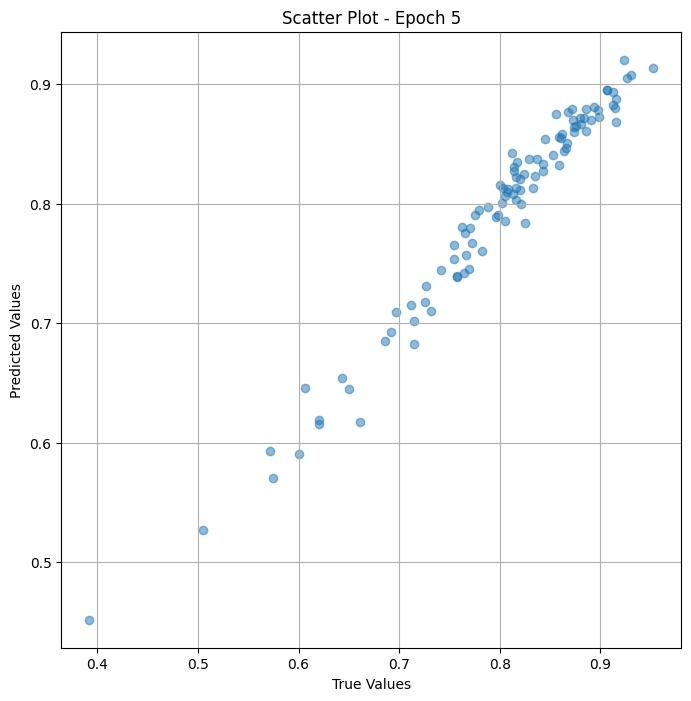

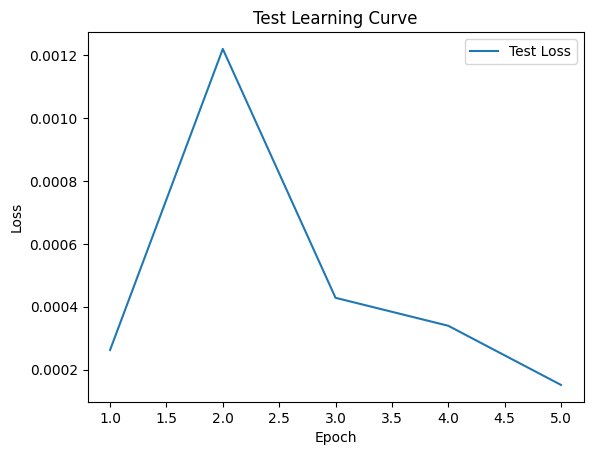


 Epoch: (6/50) Loss = 8.00963316578418e-05

 Epoch: (6/50) Loss_rmse = 0.00894965510815382

 Epoch: (6/50) R^2 = 0.9510254263877869

 Epoch: (6/50) MAE = 0.007915586233139038
Spearman correlation coefficient: SignificanceResult(statistic=0.9801340225267267, pvalue=7.560721712935025e-68)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.726315

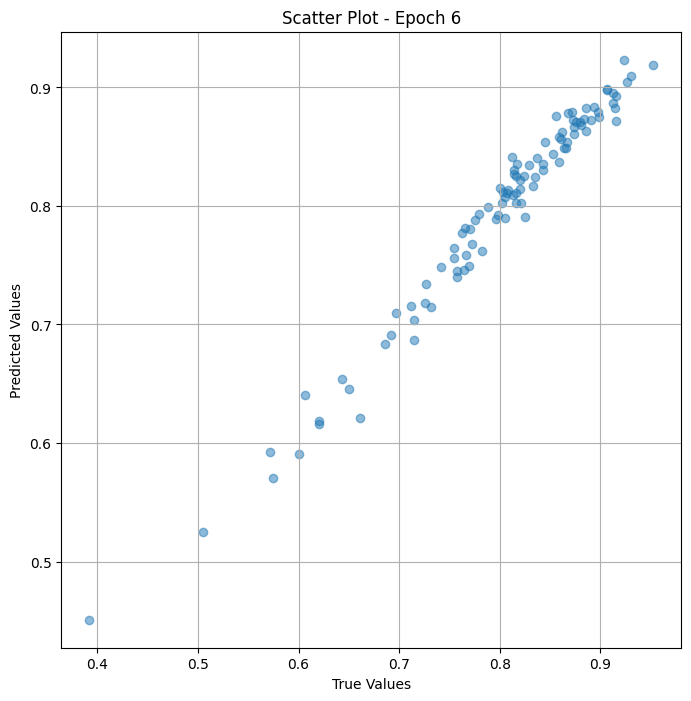

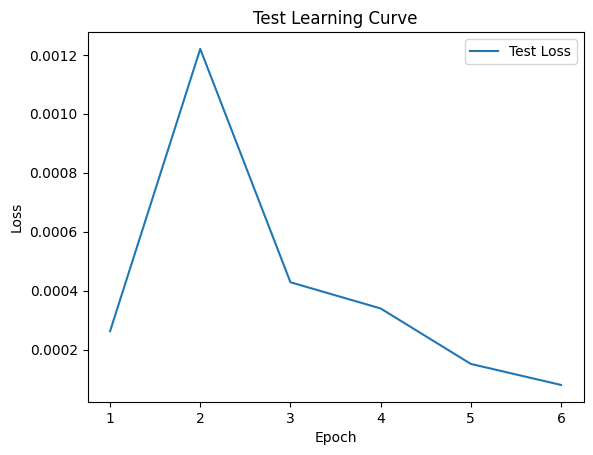


 Epoch: (7/50) Loss = 3.138531974400394e-05

 Epoch: (7/50) Loss_rmse = 0.005602260120213032

 Epoch: (7/50) R^2 = 0.9808095693588257

 Epoch: (7/50) MAE = 0.003765478730201721
Spearman correlation coefficient: SignificanceResult(statistic=0.9836677112640124, pvalue=8.231369700691789e-72)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.7263

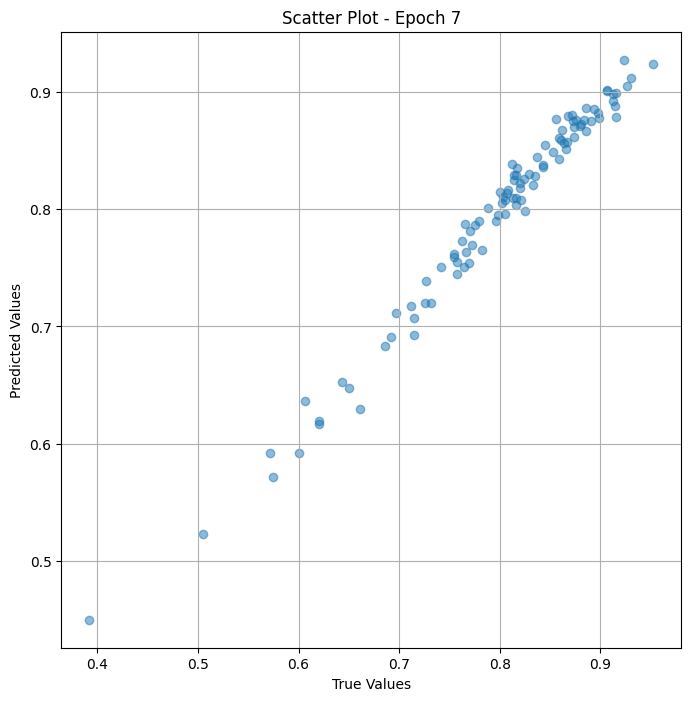

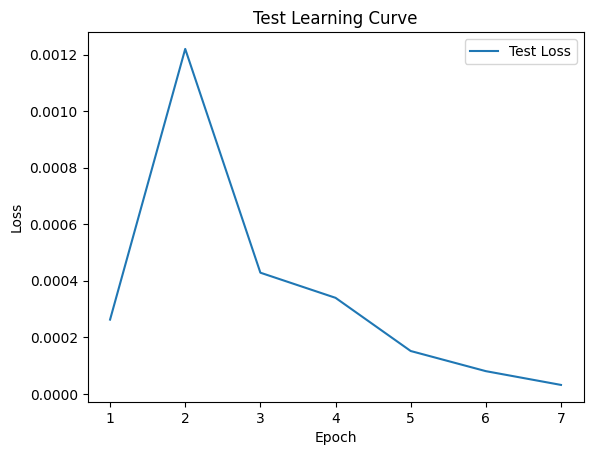


 Epoch: (8/50) Loss = 1.417266594216926e-05

 Epoch: (8/50) Loss_rmse = 0.003764660097658634

 Epoch: (8/50) R^2 = 0.9913341999053955

 Epoch: (8/50) MAE = 0.0029911398887634277
Spearman correlation coefficient: SignificanceResult(statistic=0.9869097519865125, pvalue=2.696160368831346e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.726

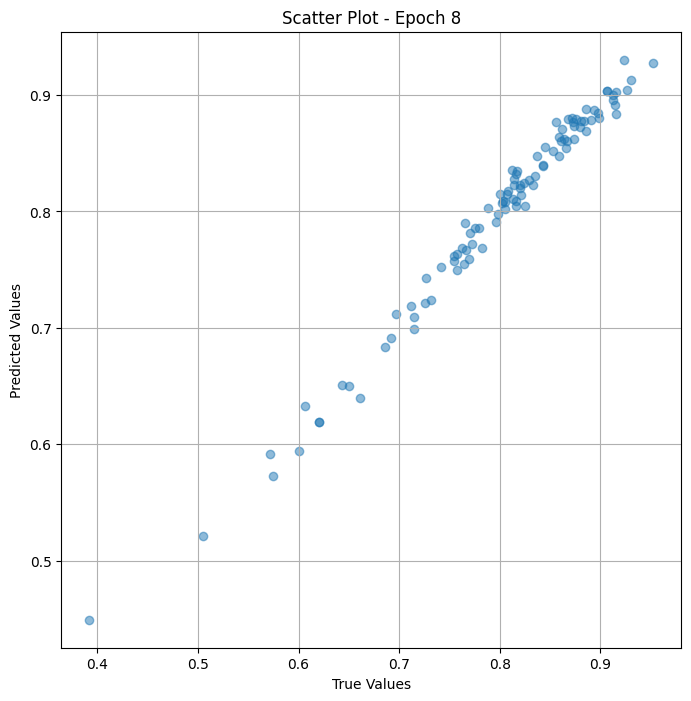

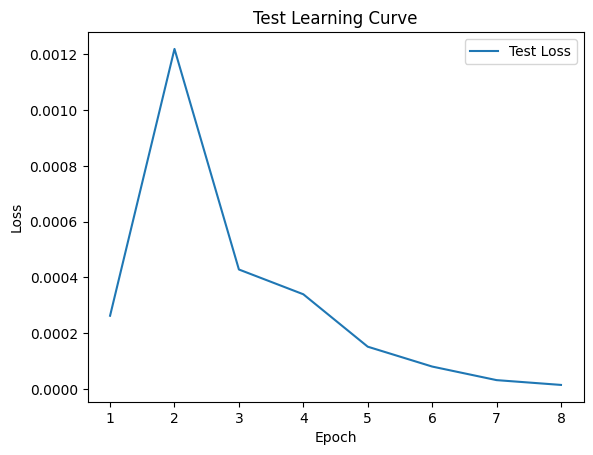


 Epoch: (9/50) Loss = 1.3195407518651336e-05

 Epoch: (9/50) Loss_rmse = 0.00363254826515913

 Epoch: (9/50) R^2 = 0.9919317364692688

 Epoch: (9/50) MAE = 0.0031435638666152954
Spearman correlation coefficient: SignificanceResult(statistic=0.98956171416747, pvalue=6.852555244755551e-81)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.72631

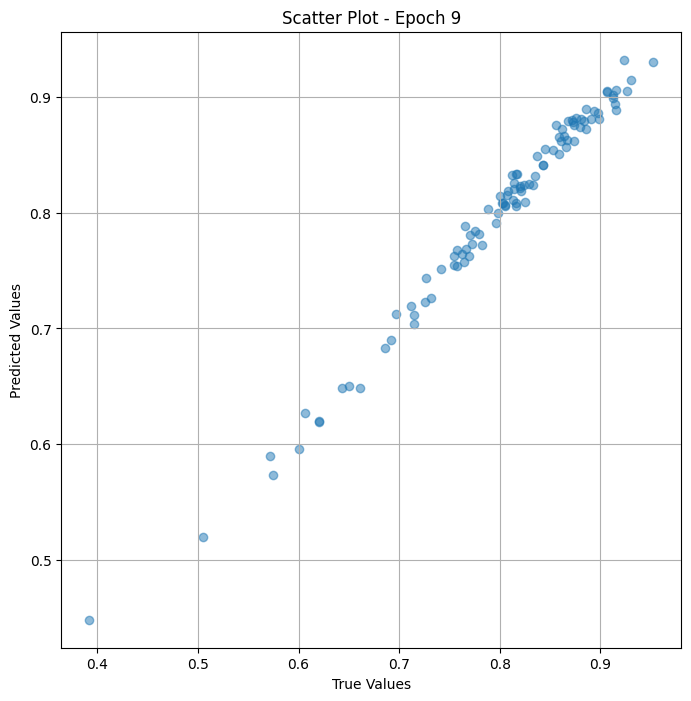

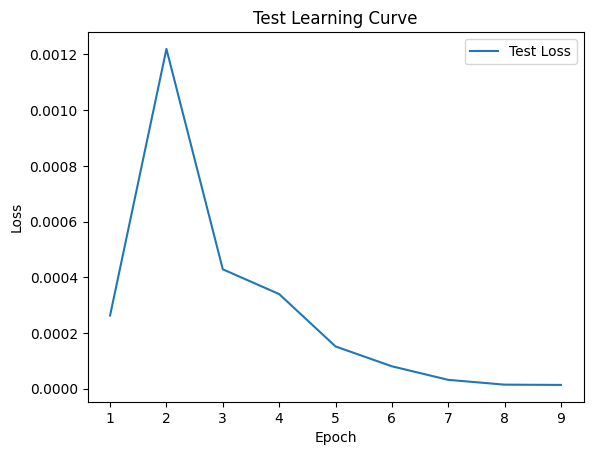


 Epoch: (10/50) Loss = 1.4647284842794761e-05

 Epoch: (10/50) Loss_rmse = 0.003827177220955491

 Epoch: (10/50) R^2 = 0.9910439848899841

 Epoch: (10/50) MAE = 0.0030949264764785767
Spearman correlation coefficient: SignificanceResult(statistic=0.9911962995526634, pvalue=2.374703736038019e-84)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 

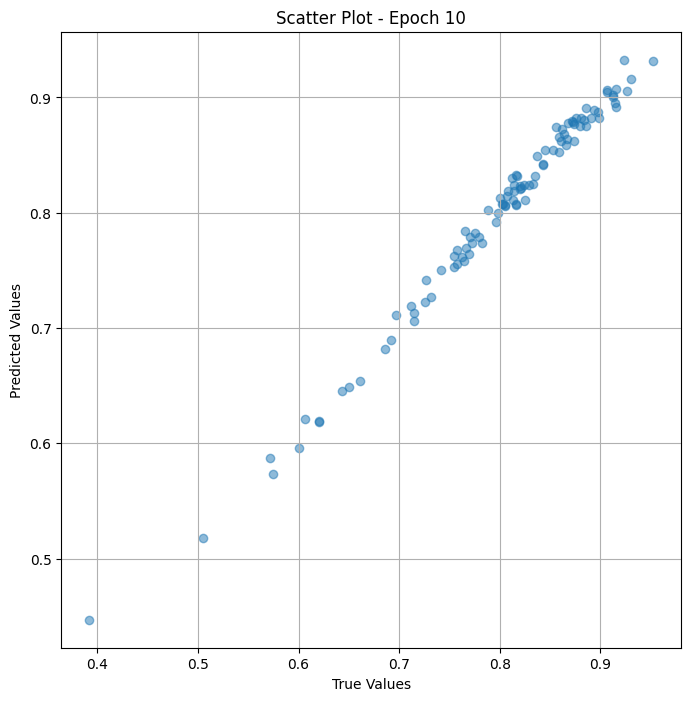

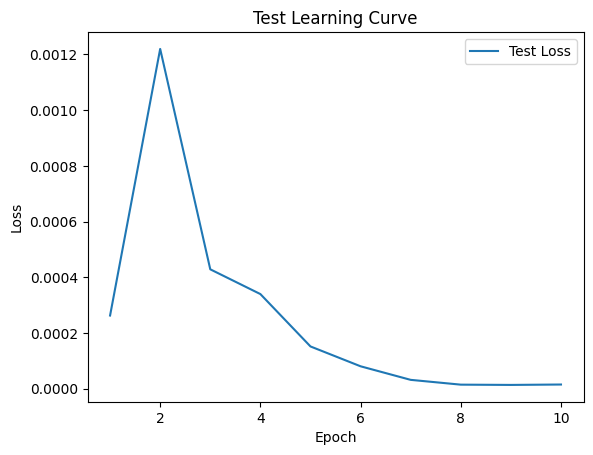


 Epoch: (11/50) Loss = 1.3063972801319323e-05

 Epoch: (11/50) Loss_rmse = 0.003614411922171712

 Epoch: (11/50) R^2 = 0.992012083530426

 Epoch: (11/50) MAE = 0.003044530749320984
Spearman correlation coefficient: SignificanceResult(statistic=0.9932107056082755, pvalue=1.2355966399238389e-89)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0

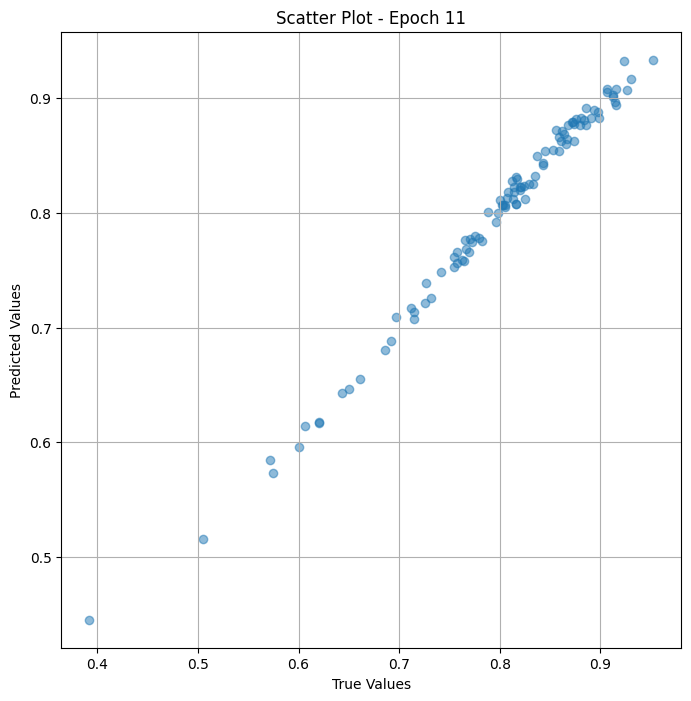

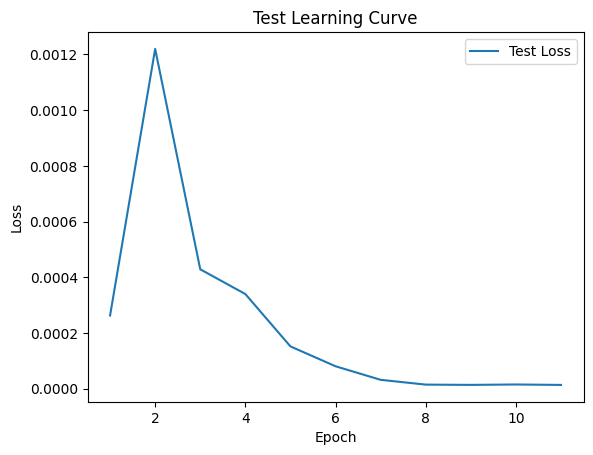


 Epoch: (12/50) Loss = 9.281964594265446e-06

 Epoch: (12/50) Loss_rmse = 0.0030466315802186728

 Epoch: (12/50) R^2 = 0.9943245649337769

 Epoch: (12/50) MAE = 0.0027367472648620605
Spearman correlation coefficient: SignificanceResult(statistic=0.9944993828829094, pvalue=6.428306511268004e-94)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 

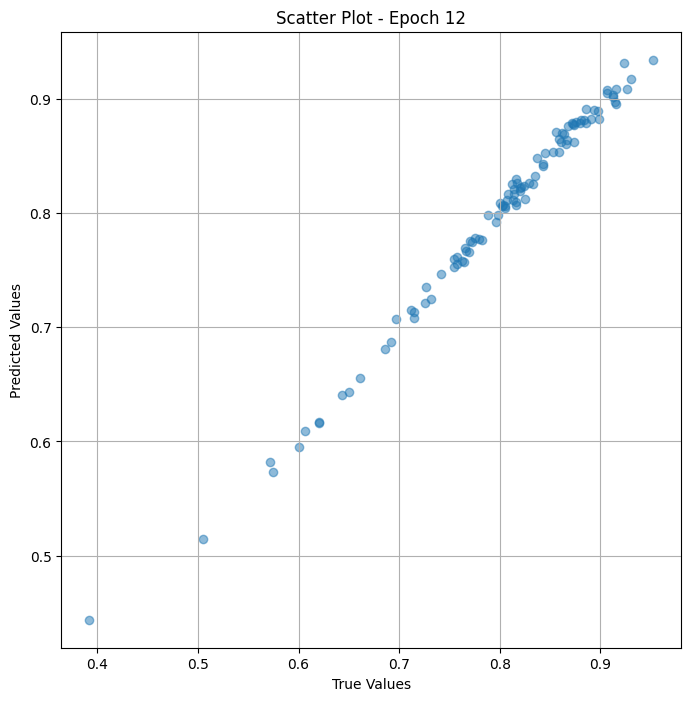

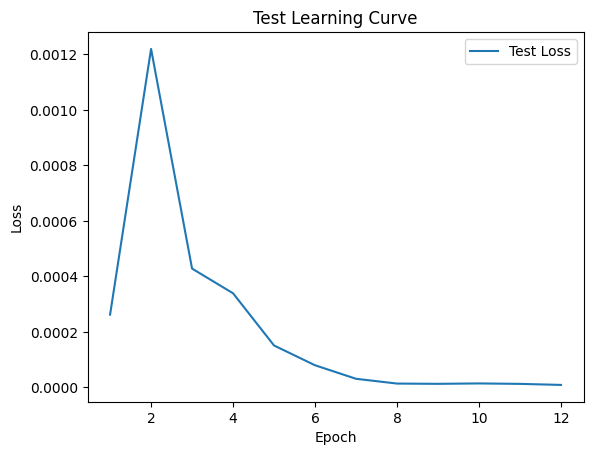


 Epoch: (13/50) Loss = 5.42327006769483e-06

 Epoch: (13/50) Loss_rmse = 0.002328791655600071

 Epoch: (13/50) R^2 = 0.9966839551925659

 Epoch: (13/50) MAE = 0.00199832022190094
Spearman correlation coefficient: SignificanceResult(statistic=0.9954014569751533, pvalue=1.447959122157149e-97)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.72

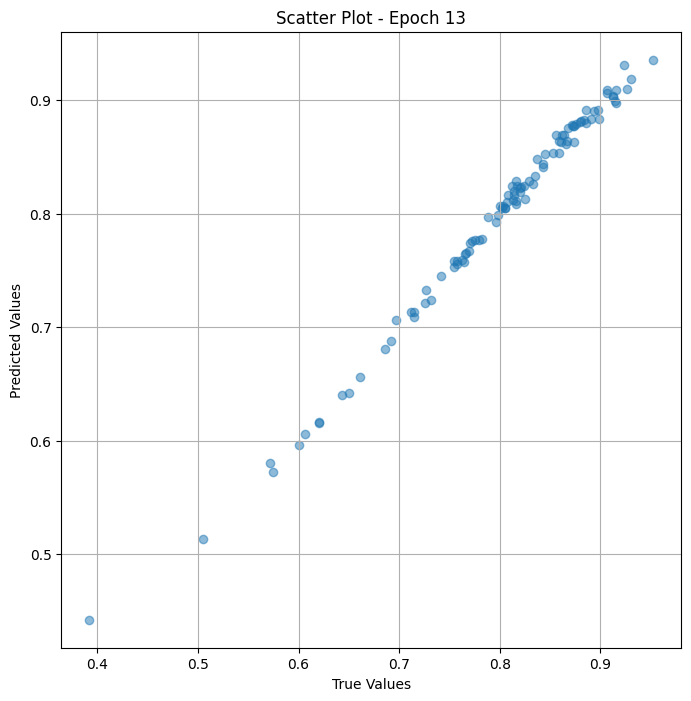

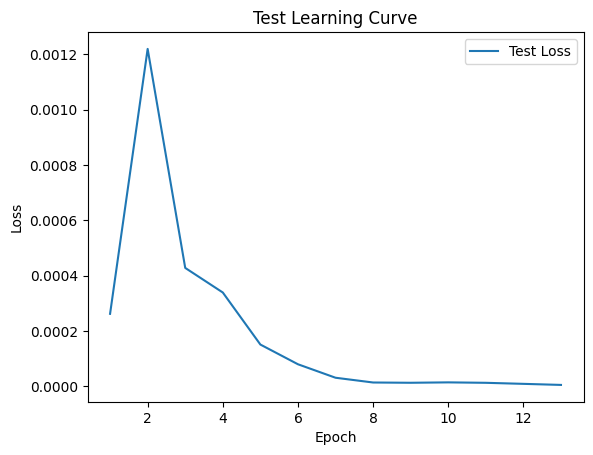


 Epoch: (14/50) Loss = 2.4402502276643645e-06

 Epoch: (14/50) Loss_rmse = 0.0015621300553902984

 Epoch: (14/50) R^2 = 0.9985079169273376

 Epoch: (14/50) MAE = 0.001405864953994751
Spearman correlation coefficient: SignificanceResult(statistic=0.9961136207321877, pvalue=5.410127512106655e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093,

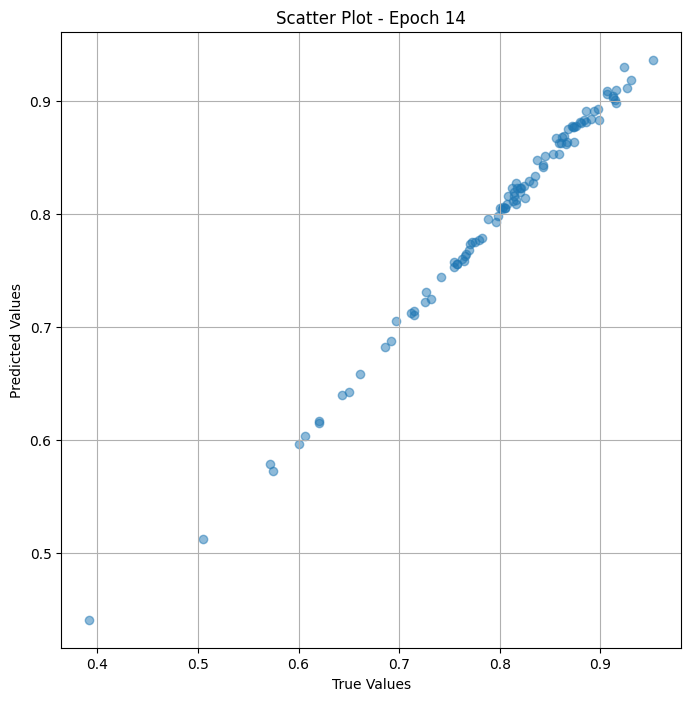

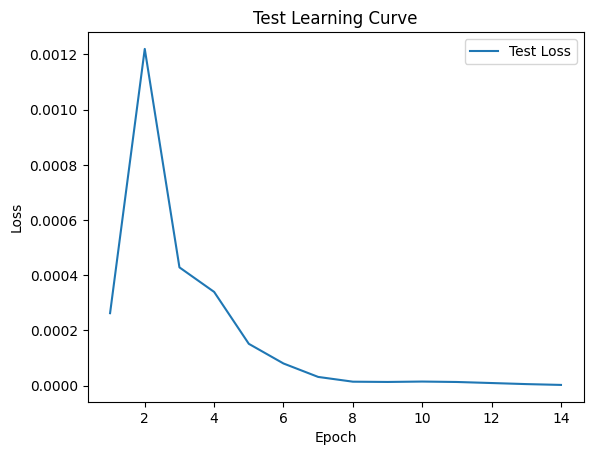


 Epoch: (15/50) Loss = 6.73587578603474e-07

 Epoch: (15/50) Loss_rmse = 0.0008207238279283047

 Epoch: (15/50) R^2 = 0.999588131904602

 Epoch: (15/50) MAE = 0.000762641429901123
Spearman correlation coefficient: SignificanceResult(statistic=0.9967647418814765, pvalue=9.923920876855183e-105)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.

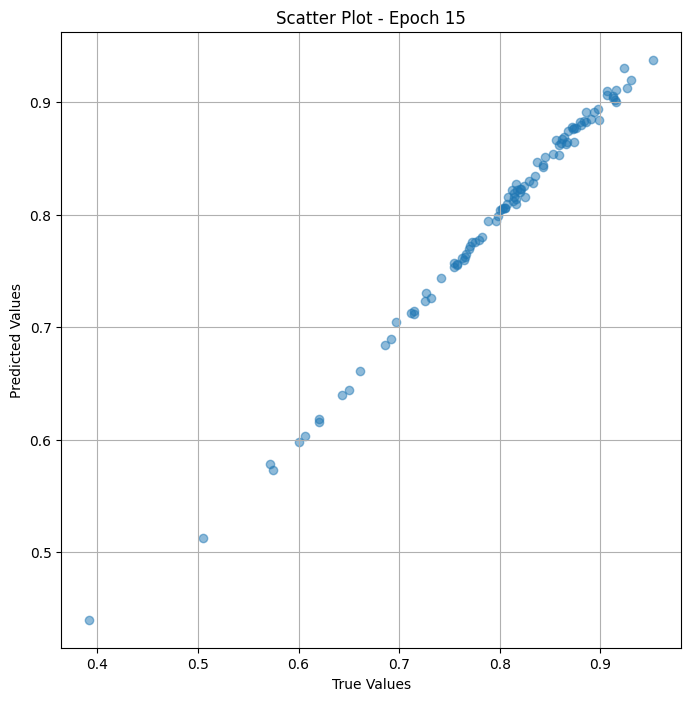

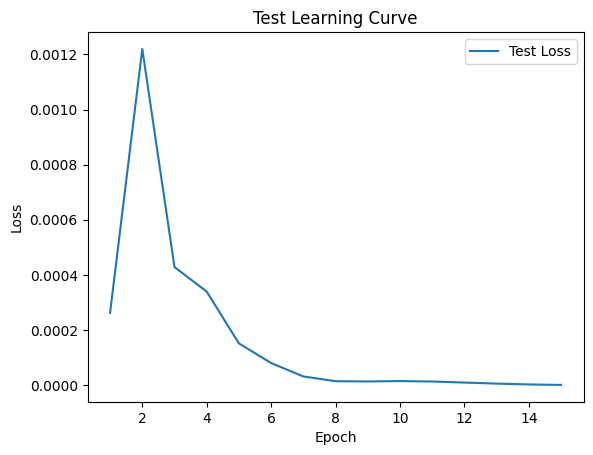


 Epoch: (16/50) Loss = 2.0473855499858473e-07

 Epoch: (16/50) Loss_rmse = 0.00045248045353218913

 Epoch: (16/50) R^2 = 0.9998748302459717

 Epoch: (16/50) MAE = 0.00042688846588134766
Spearman correlation coefficient: SignificanceResult(statistic=0.9971920401356973, pvalue=1.2868287564687954e-107)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372

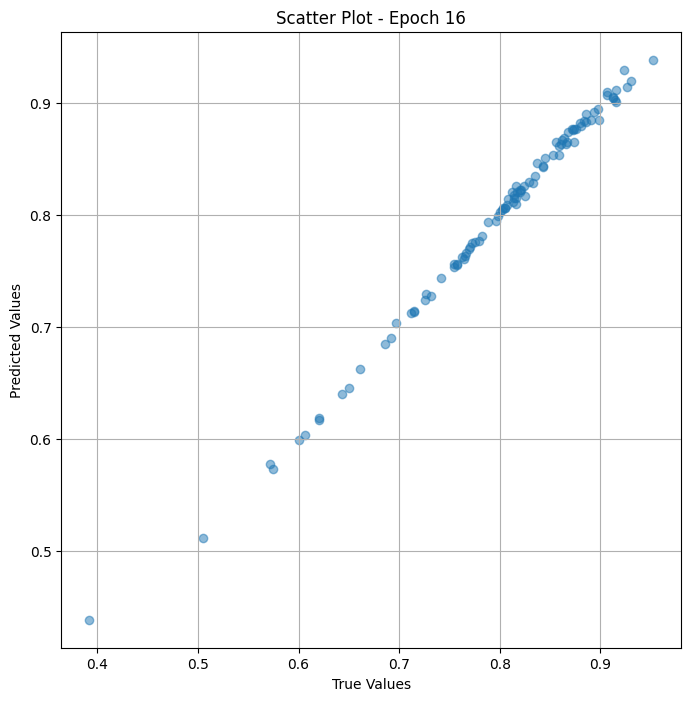

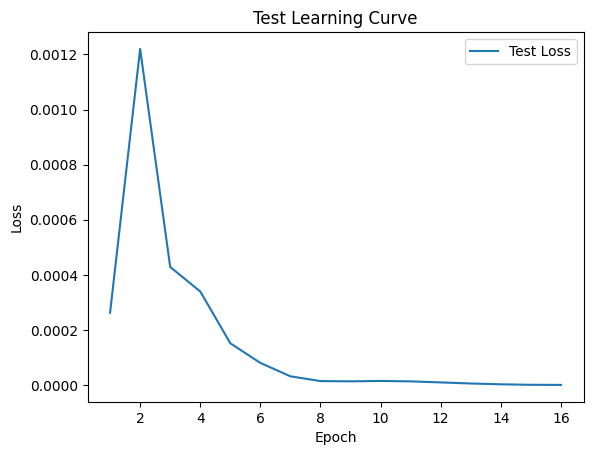


 Epoch: (17/50) Loss = 4.361555170362408e-07

 Epoch: (17/50) Loss_rmse = 0.0006604206864722073

 Epoch: (17/50) R^2 = 0.9997333288192749

 Epoch: (17/50) MAE = 0.0005293041467666626
Spearman correlation coefficient: SignificanceResult(statistic=0.9975989908540027, pvalue=8.27262162370751e-111)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 

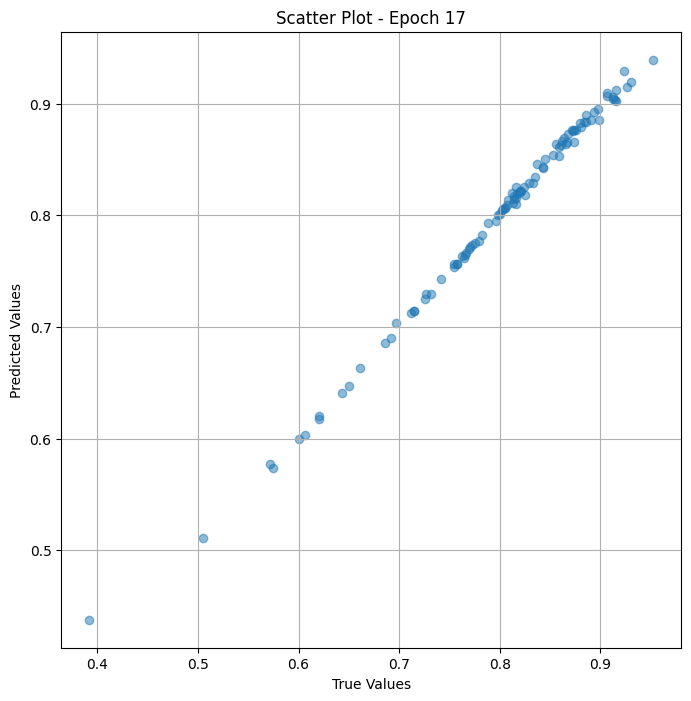

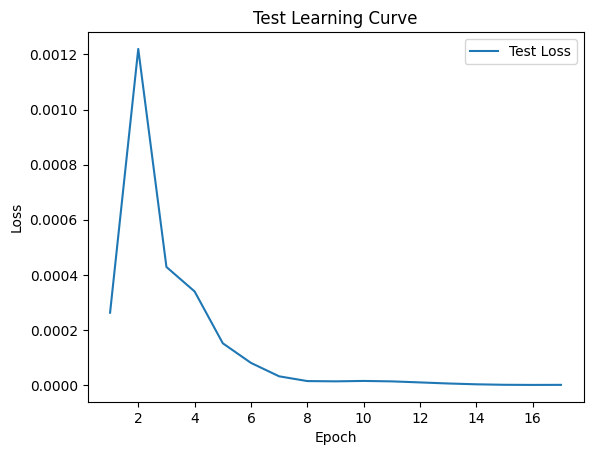


 Epoch: (18/50) Loss = 5.38887036327651e-07

 Epoch: (18/50) Loss_rmse = 0.0007340892334468663

 Epoch: (18/50) R^2 = 0.9996705055236816

 Epoch: (18/50) MAE = 0.0006007254123687744
Spearman correlation coefficient: SignificanceResult(statistic=0.9979381164525906, pvalue=6.49932986983632e-114)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0

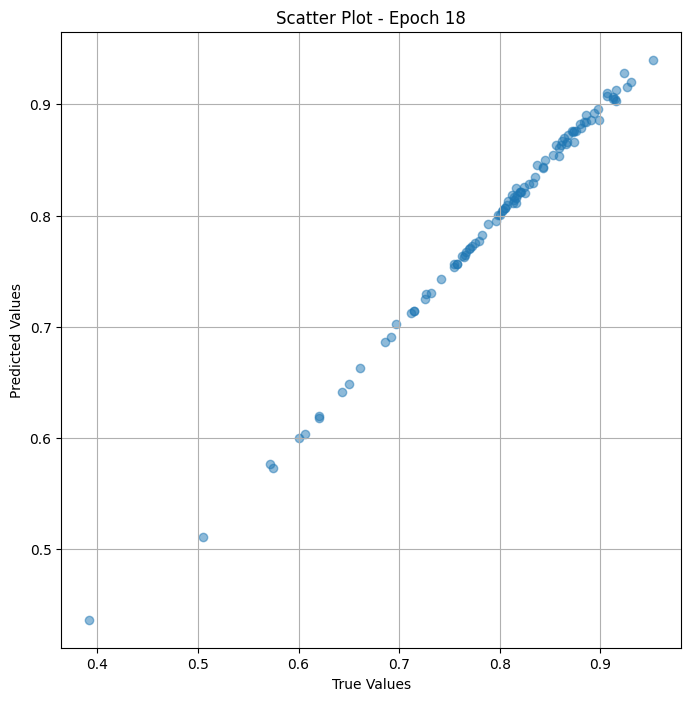

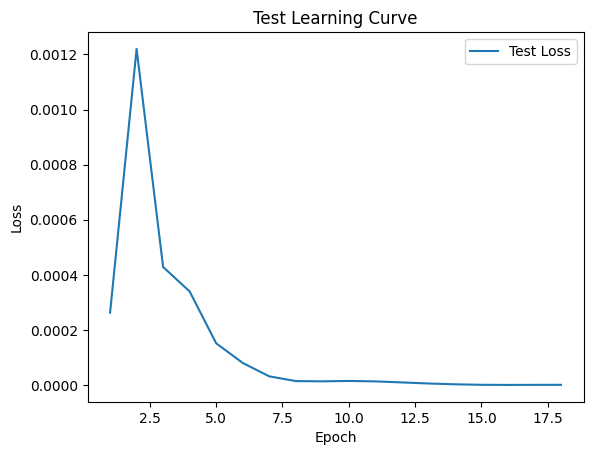

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (19/50) Loss = 3.3232717555620184e-07

 Epoch: (19/50) Loss_rmse = 0.0005764782545156777

 Epoch: (19/50) R^2 = 0.9997968077659607

 Epoch: (19/50) MAE = 0.00048083066940307617
Spearman correlation coefficient: SignificanceResult(statistic=0.9982704595392068, pvalue=1.6922010314675663e-117)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.

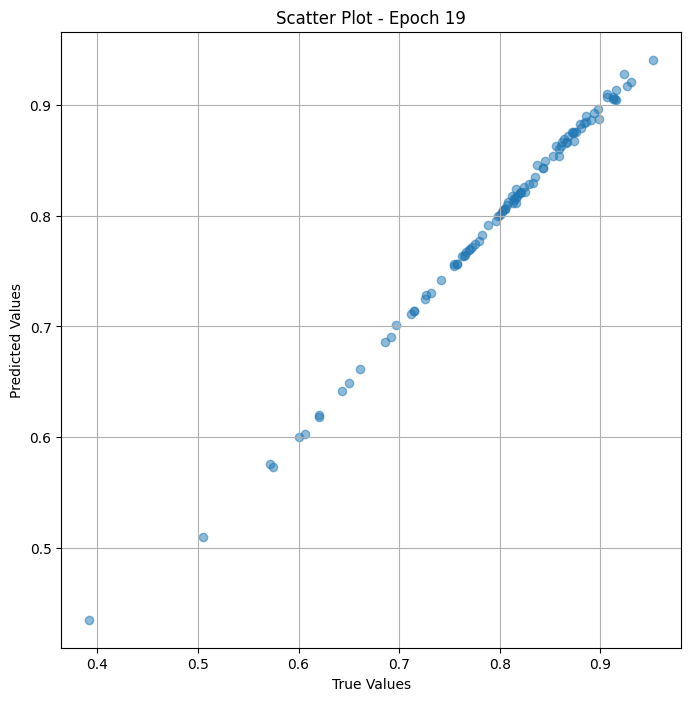

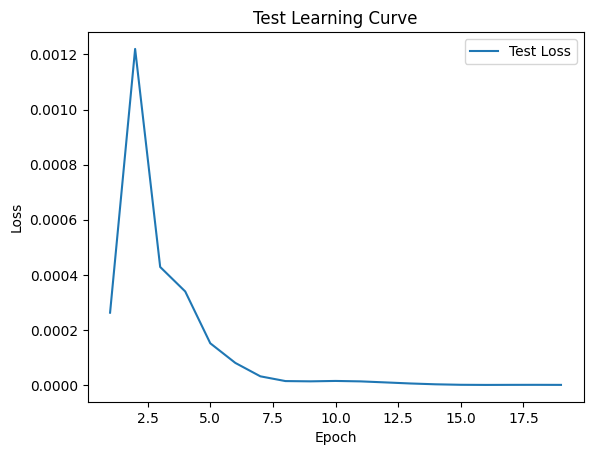


 Epoch: (20/50) Loss = 2.384440165315027e-07

 Epoch: (20/50) Loss_rmse = 0.0004883072688244283

 Epoch: (20/50) R^2 = 0.9998542070388794

 Epoch: (20/50) MAE = 0.00039708614349365234
Spearman correlation coefficient: SignificanceResult(statistic=0.9984807174103313, pvalue=3.843954645431235e-120)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093

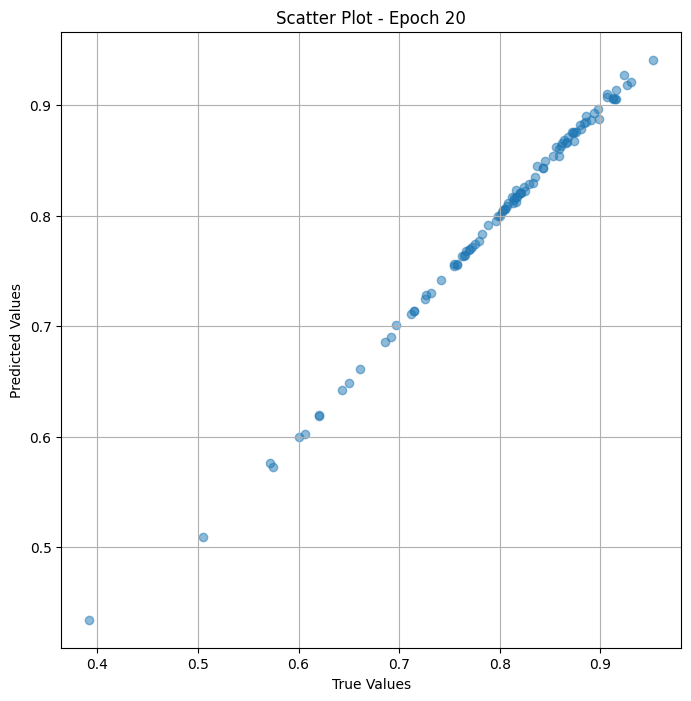

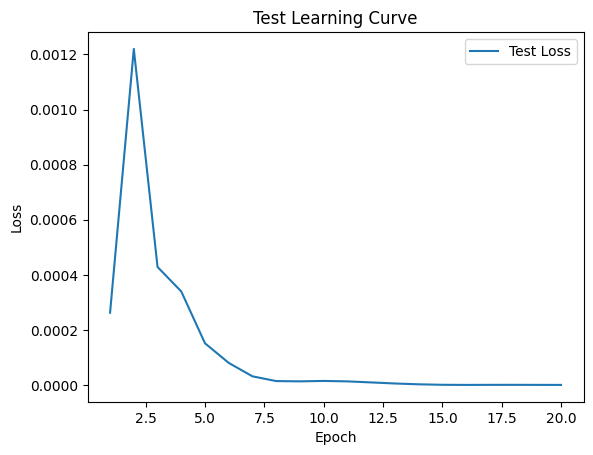


 Epoch: (21/50) Loss = 2.1161741869946127e-07

 Epoch: (21/50) Loss_rmse = 0.0004600189276970923

 Epoch: (21/50) R^2 = 0.9998705983161926

 Epoch: (21/50) MAE = 0.00036741793155670166
Spearman correlation coefficient: SignificanceResult(statistic=0.9984807174103313, pvalue=3.843954645431235e-120)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.8837209

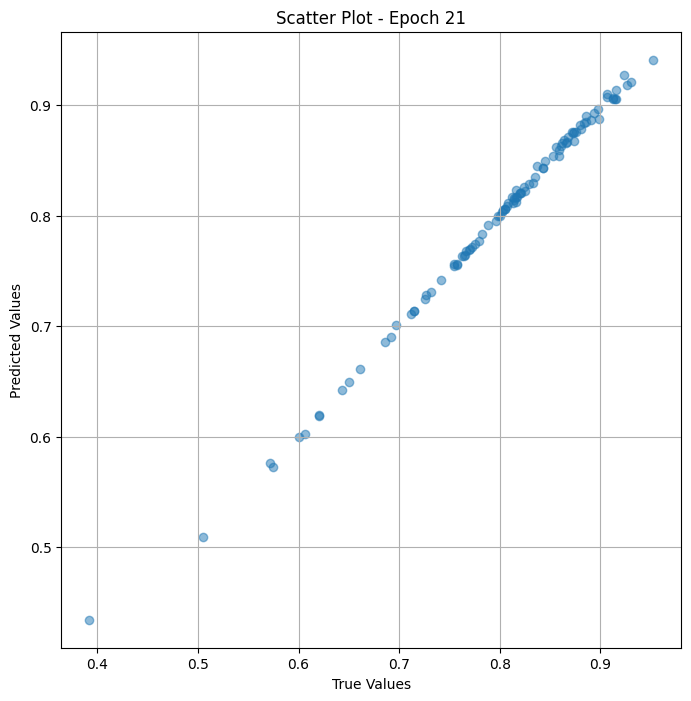

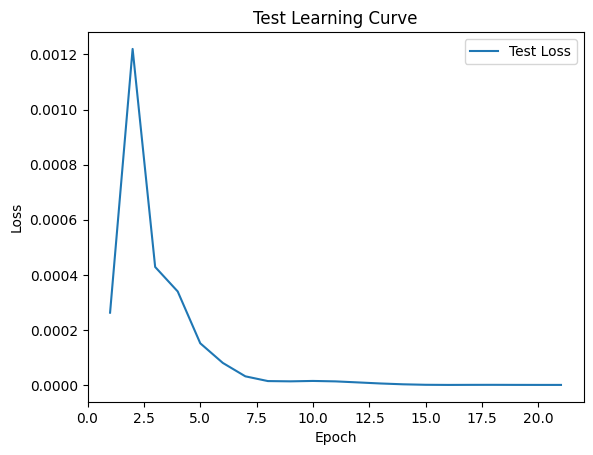


 Epoch: (22/50) Loss = 1.845265273914265e-07

 Epoch: (22/50) Loss_rmse = 0.0004295655235182494

 Epoch: (22/50) R^2 = 0.9998871684074402

 Epoch: (22/50) MAE = 0.0003353804349899292
Spearman correlation coefficient: SignificanceResult(statistic=0.9984807174103313, pvalue=3.843954645431235e-120)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093,

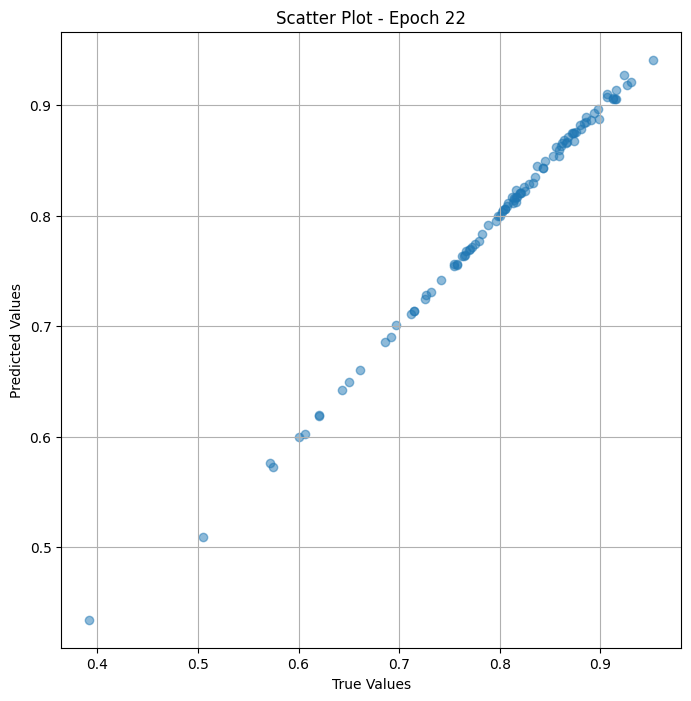

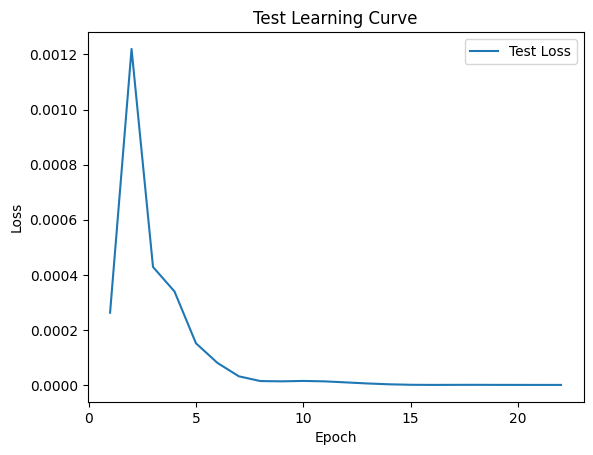


 Epoch: (23/50) Loss = 1.587059159646742e-07

 Epoch: (23/50) Loss_rmse = 0.0003983791102655232

 Epoch: (23/50) R^2 = 0.9999029636383057

 Epoch: (23/50) MAE = 0.0003025531768798828
Spearman correlation coefficient: SignificanceResult(statistic=0.9985078474582181, pvalue=1.649122478248237e-120)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093,

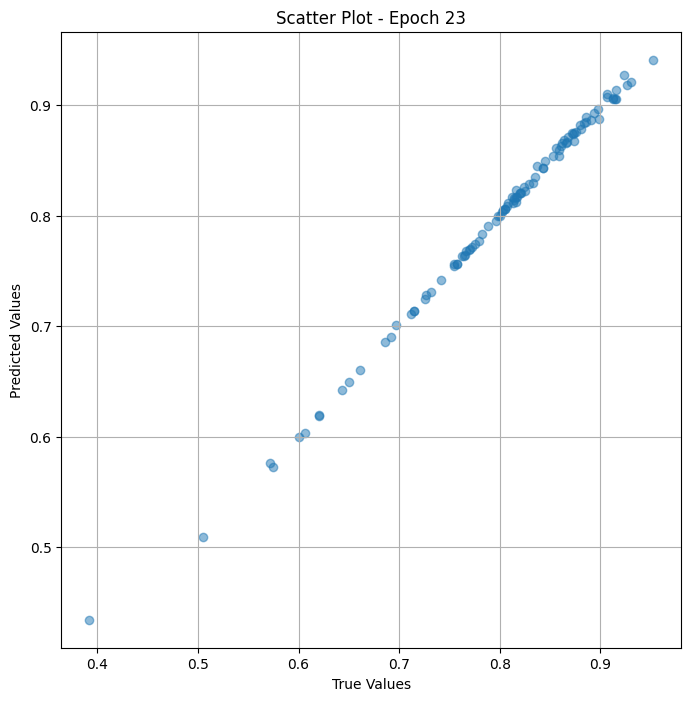

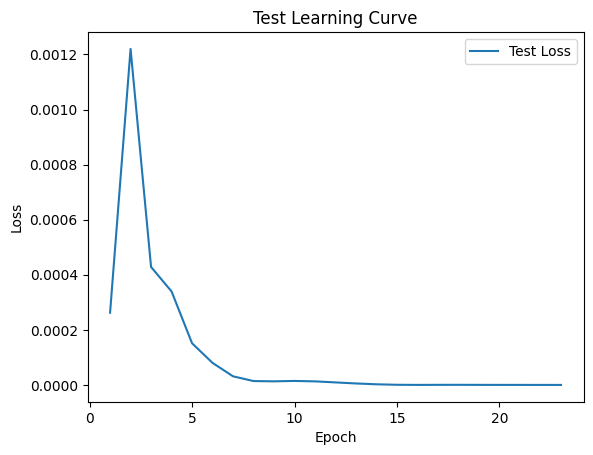


 Epoch: (24/50) Loss = 1.3518062758066662e-07

 Epoch: (24/50) Loss_rmse = 0.00036766918492503464

 Epoch: (24/50) R^2 = 0.9999173283576965

 Epoch: (24/50) MAE = 0.00027023255825042725
Spearman correlation coefficient: SignificanceResult(statistic=0.9985349775061052, pvalue=6.965924003328481e-121)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.883720

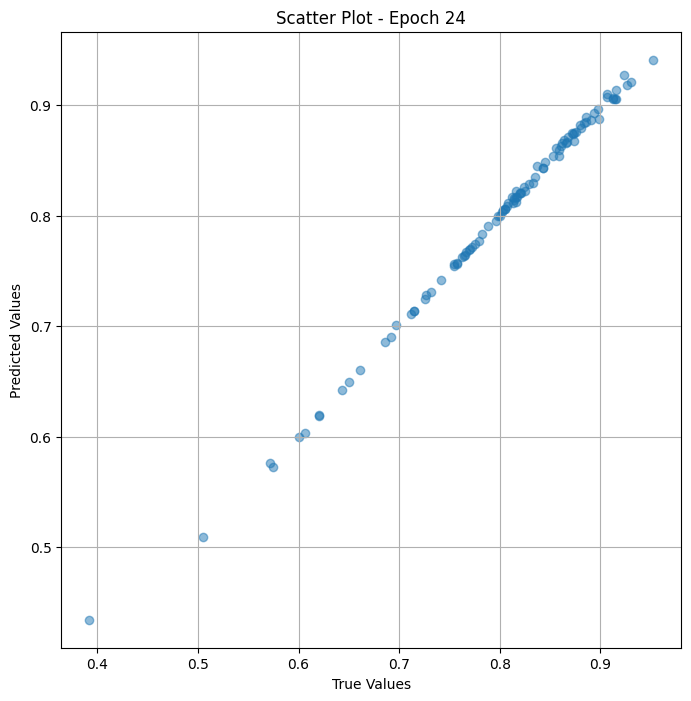

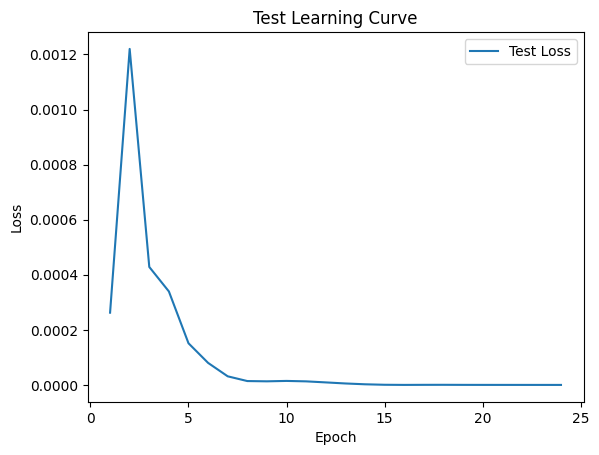


 Epoch: (25/50) Loss = 1.1456667436959833e-07

 Epoch: (25/50) Loss_rmse = 0.0003384769952390343

 Epoch: (25/50) R^2 = 0.9999299645423889

 Epoch: (25/50) MAE = 0.0002534538507461548
Spearman correlation coefficient: SignificanceResult(statistic=0.9985349775061052, pvalue=6.965924003328481e-121)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093

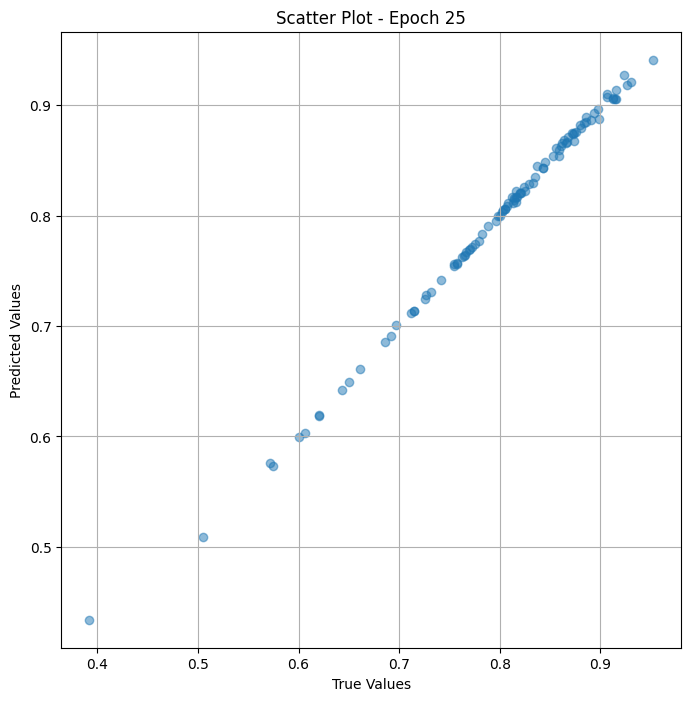

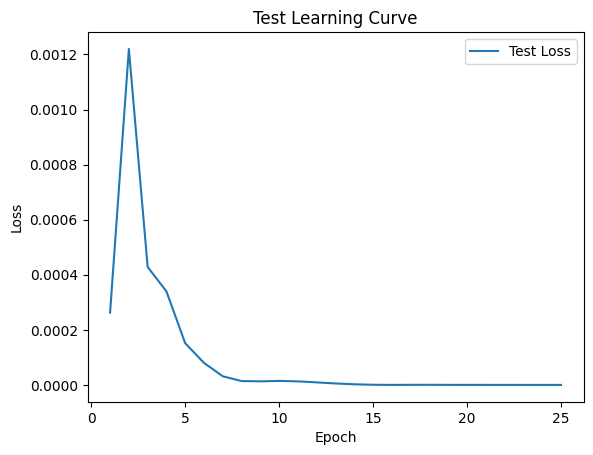


 Epoch: (26/50) Loss = 9.69101137116013e-08

 Epoch: (26/50) Loss_rmse = 0.00031130388379096985

 Epoch: (26/50) R^2 = 0.9999407529830933

 Epoch: (26/50) MAE = 0.00023724138736724854
Spearman correlation coefficient: SignificanceResult(statistic=0.9985349775061052, pvalue=6.965924003328481e-121)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093

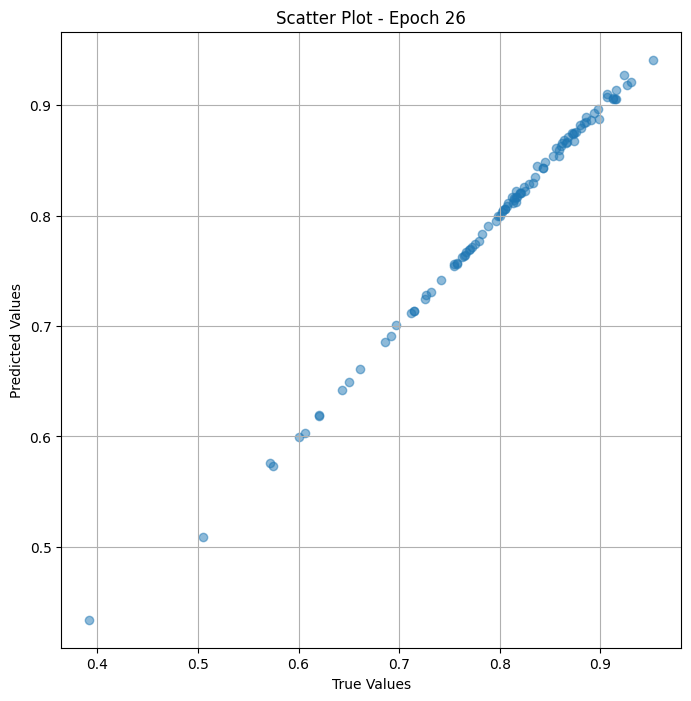

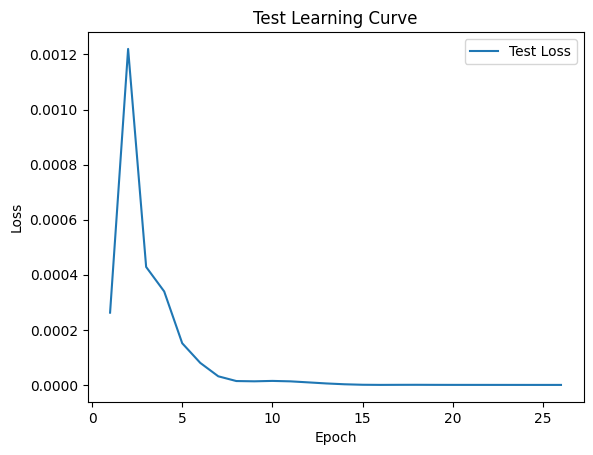


 Epoch: (27/50) Loss = 8.209748614262935e-08

 Epoch: (27/50) Loss_rmse = 0.0002865265996661037

 Epoch: (27/50) R^2 = 0.9999498128890991

 Epoch: (27/50) MAE = 0.00022155046463012695
Spearman correlation coefficient: SignificanceResult(statistic=0.9985485425300487, pvalue=4.5002074204316595e-121)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.8837209

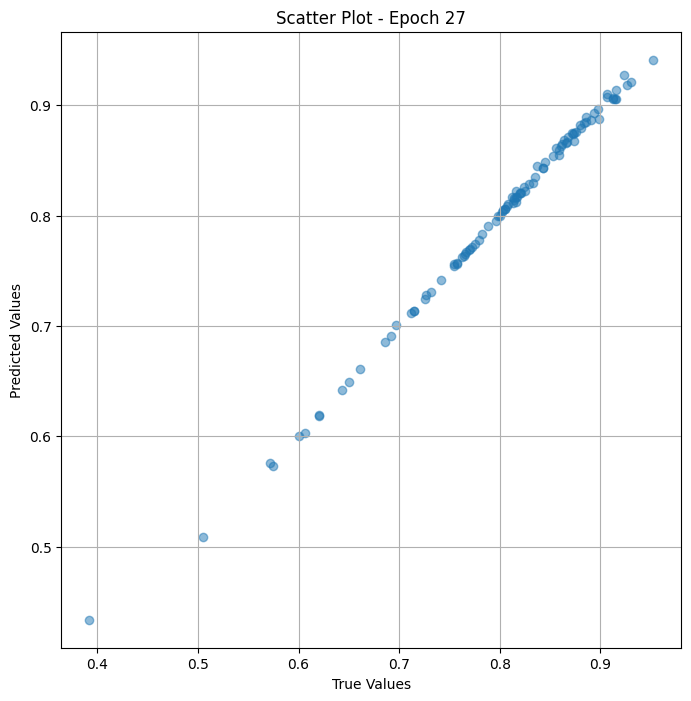

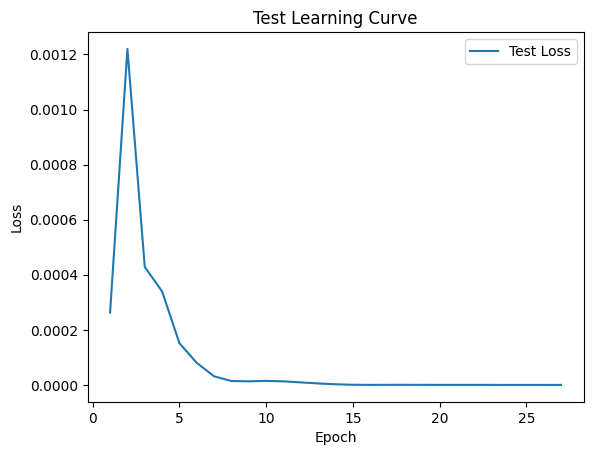


 Epoch: (28/50) Loss = 6.972189936504947e-08

 Epoch: (28/50) Loss_rmse = 0.0002640490420162678

 Epoch: (28/50) R^2 = 0.9999573826789856

 Epoch: (28/50) MAE = 0.00020641088485717773
Spearman correlation coefficient: SignificanceResult(statistic=0.9985485425300487, pvalue=4.5002074204316595e-121)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.8837209

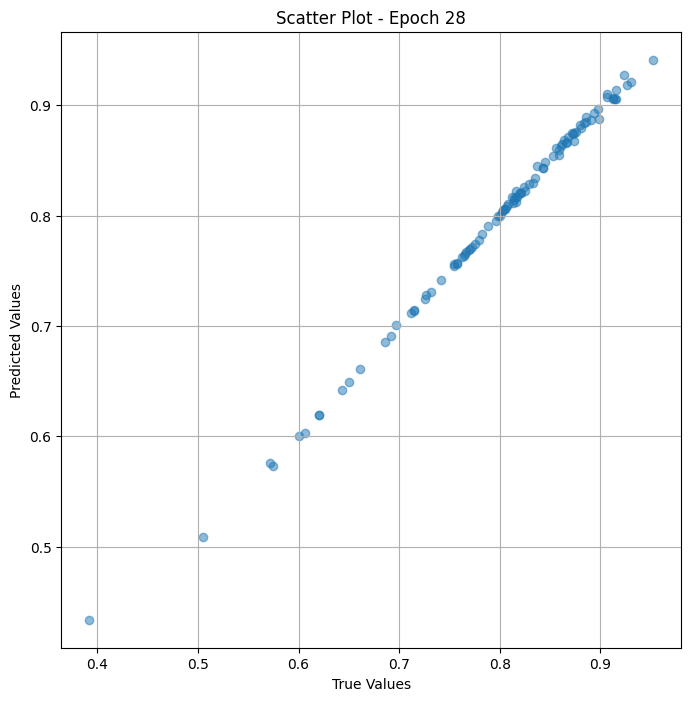

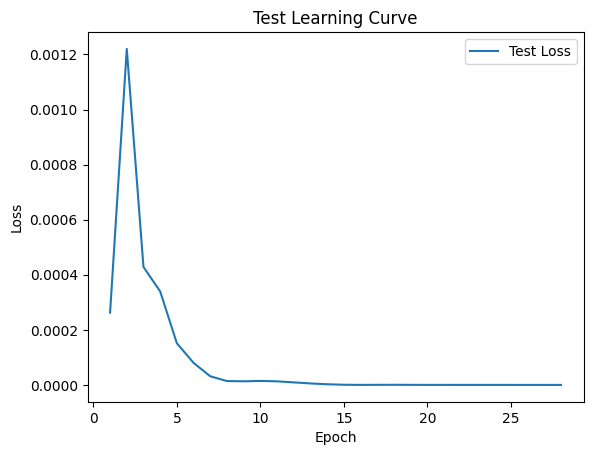


 Epoch: (29/50) Loss = 5.938168712305014e-08

 Epoch: (29/50) Loss_rmse = 0.00024368357844650745

 Epoch: (29/50) R^2 = 0.9999637007713318

 Epoch: (29/50) MAE = 0.00019182264804840088
Spearman correlation coefficient: SignificanceResult(statistic=0.9985485425300487, pvalue=4.5002074204316595e-121)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.883720

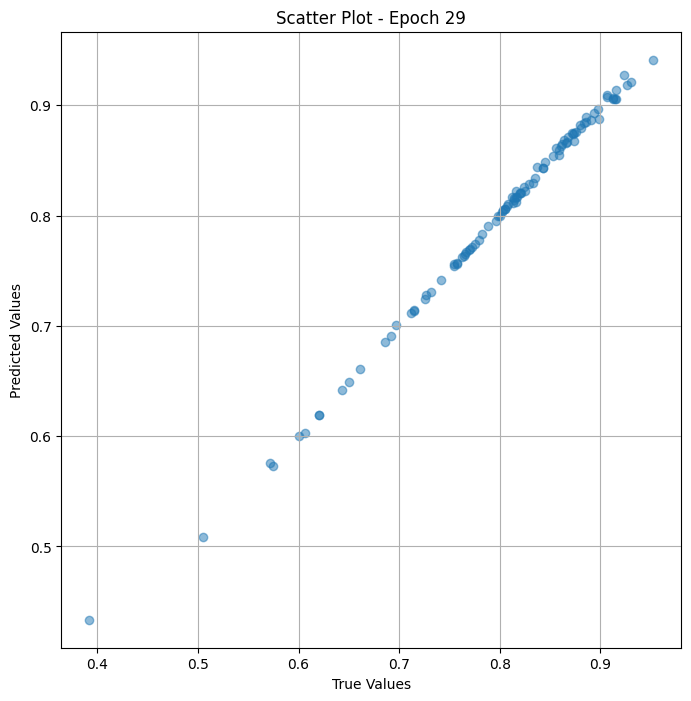

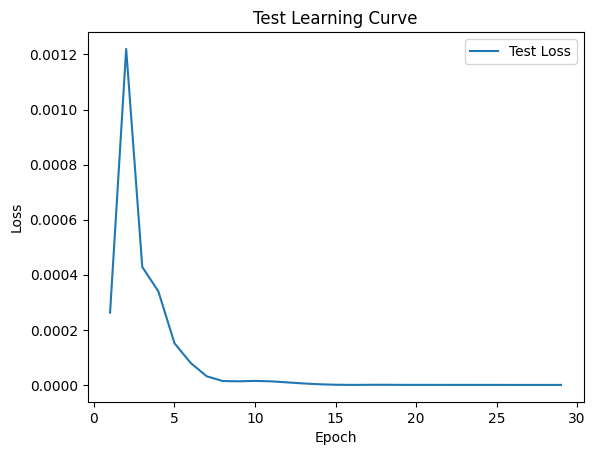


 Epoch: (30/50) Loss = 5.072404363204441e-08

 Epoch: (30/50) Loss_rmse = 0.00022521999198943377

 Epoch: (30/50) R^2 = 0.9999690055847168

 Epoch: (30/50) MAE = 0.00017759203910827637
Spearman correlation coefficient: SignificanceResult(statistic=0.9985485425300487, pvalue=4.5002074204316595e-121)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.883720

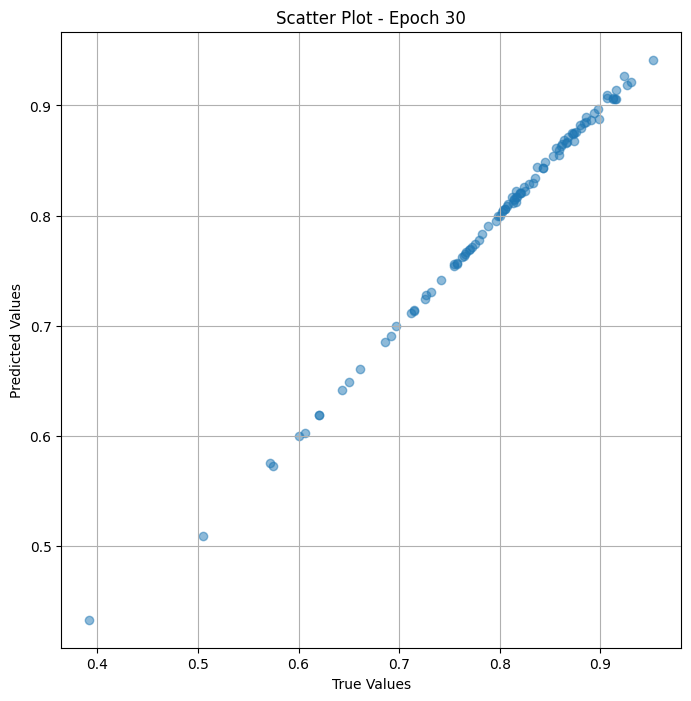

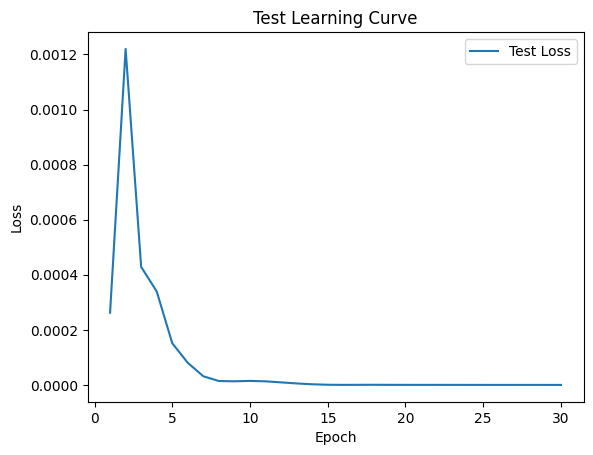


 Epoch: (31/50) Loss = 4.362046013284271e-08

 Epoch: (31/50) Loss_rmse = 0.0002088551118504256

 Epoch: (31/50) R^2 = 0.9999733567237854

 Epoch: (31/50) MAE = 0.00016410648822784424
Spearman correlation coefficient: SignificanceResult(statistic=0.9986434976976535, pvalue=1.8755309767661946e-122)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.8837209

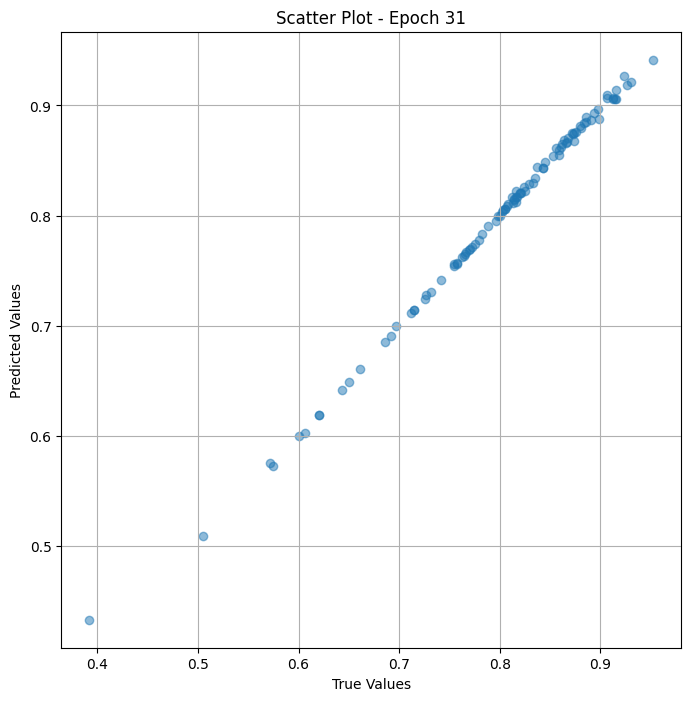

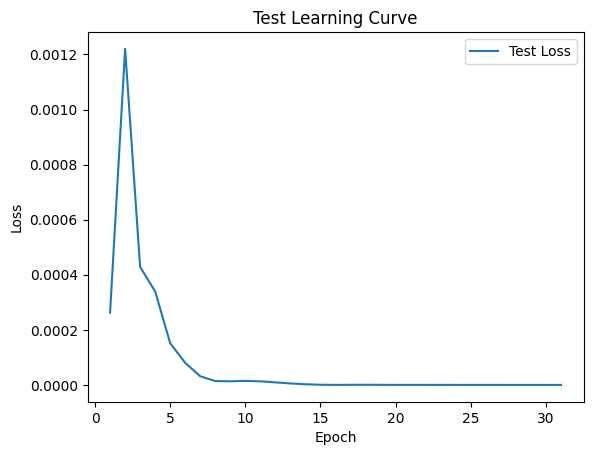


 Epoch: (32/50) Loss = 3.7617315484794744e-08

 Epoch: (32/50) Loss_rmse = 0.00019395184062886983

 Epoch: (32/50) R^2 = 0.9999769926071167

 Epoch: (32/50) MAE = 0.00015094876289367676
Spearman correlation coefficient: SignificanceResult(statistic=0.9986434976976535, pvalue=1.8755309767661946e-122)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372

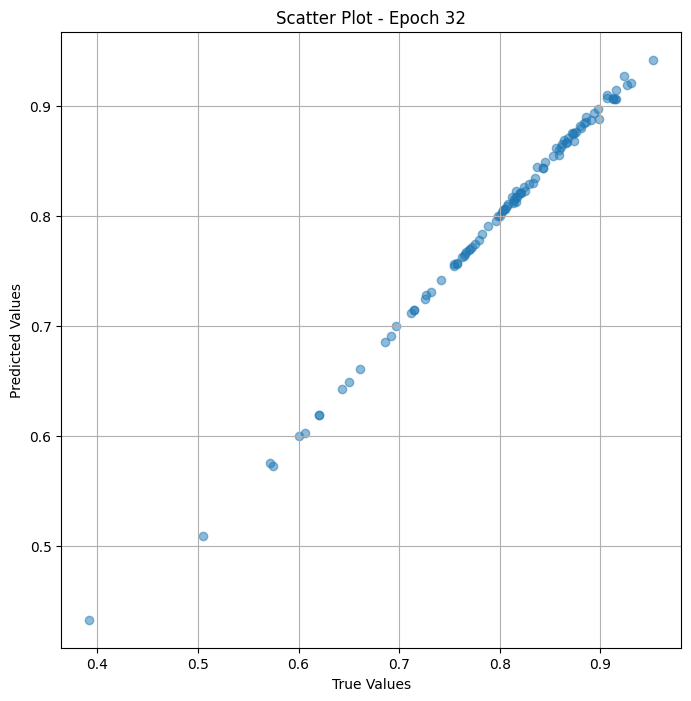

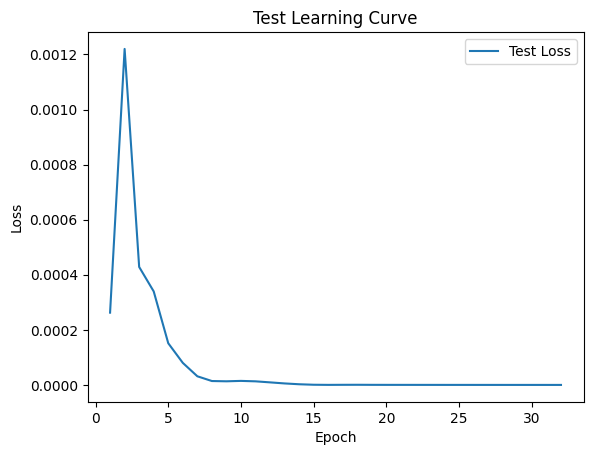


 Epoch: (33/50) Loss = 3.261840930690596e-08

 Epoch: (33/50) Loss_rmse = 0.000180605667992495

 Epoch: (33/50) R^2 = 0.9999800324440002

 Epoch: (33/50) MAE = 0.00013817846775054932
Spearman correlation coefficient: SignificanceResult(statistic=0.9986434976976535, pvalue=1.8755309767661946e-122)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093

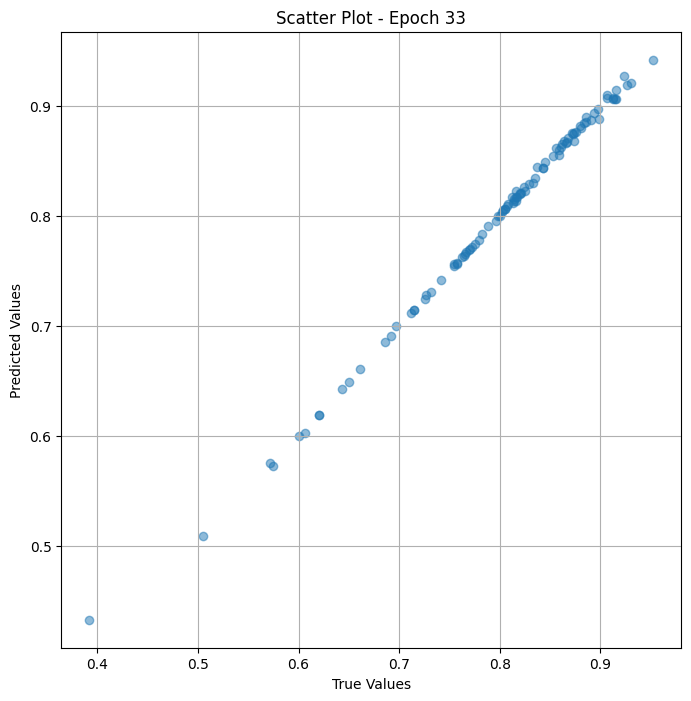

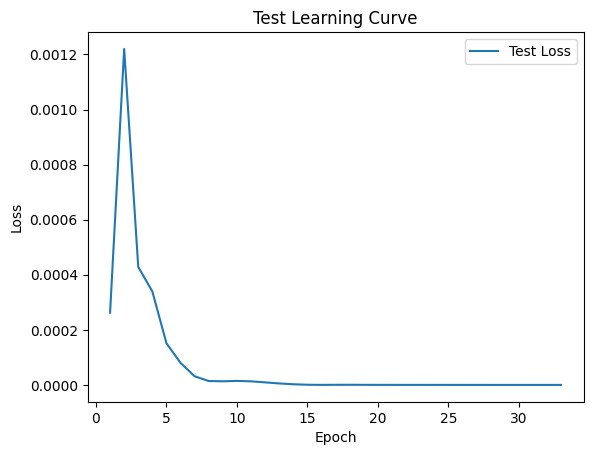


 Epoch: (34/50) Loss = 2.8571516708097988e-08

 Epoch: (34/50) Loss_rmse = 0.0001690311182755977

 Epoch: (34/50) R^2 = 0.9999825358390808

 Epoch: (34/50) MAE = 0.00013373792171478271
Spearman correlation coefficient: SignificanceResult(statistic=0.9986706277455403, pvalue=7.261315250137766e-123)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.8837209

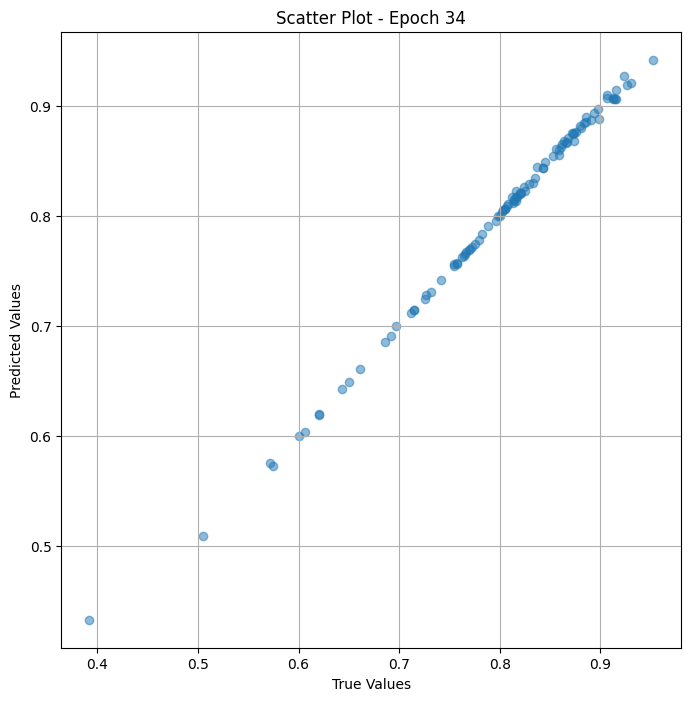

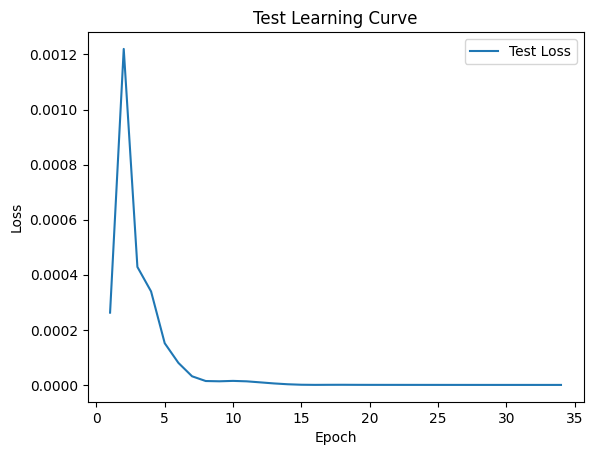


 Epoch: (35/50) Loss = 2.52061944649995e-08

 Epoch: (35/50) Loss_rmse = 0.00015876458201091737

 Epoch: (35/50) R^2 = 0.9999845623970032

 Epoch: (35/50) MAE = 0.00013169646263122559
Spearman correlation coefficient: SignificanceResult(statistic=0.9987316703532864, pvalue=7.982387156409997e-124)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093

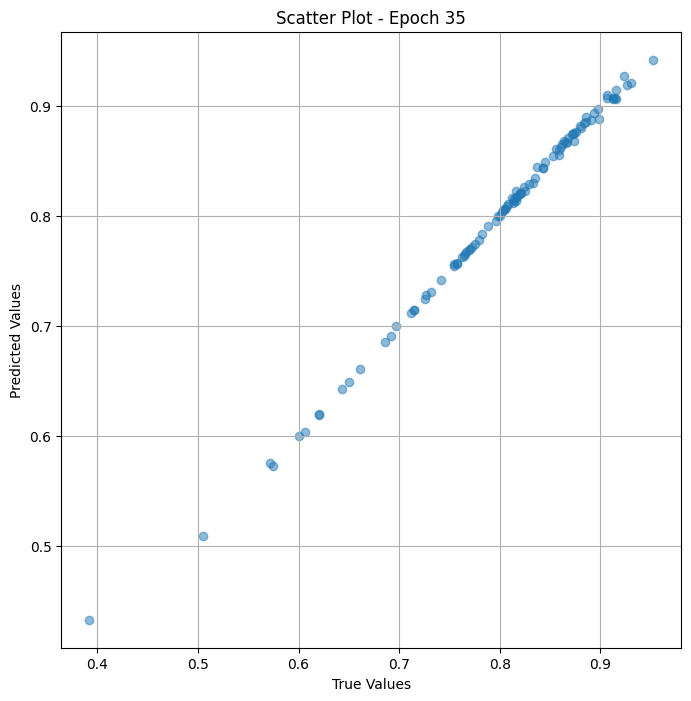

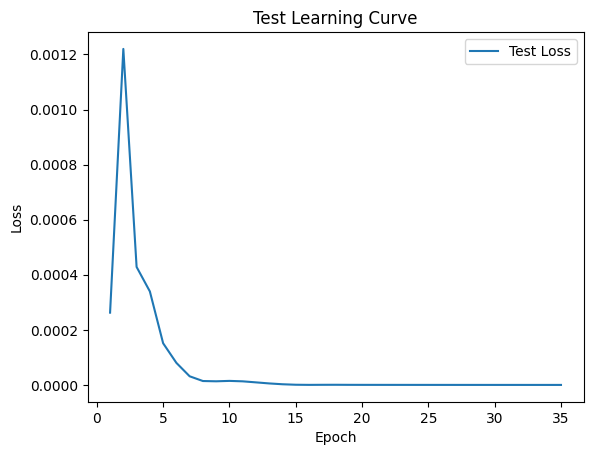


 Epoch: (36/50) Loss = 2.2501286167653234e-08

 Epoch: (36/50) Loss_rmse = 0.00015000428538769484

 Epoch: (36/50) R^2 = 0.9999862313270569

 Epoch: (36/50) MAE = 0.00012965500354766846
Spearman correlation coefficient: SignificanceResult(statistic=0.9987316703532864, pvalue=7.982387156409997e-124)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.883720

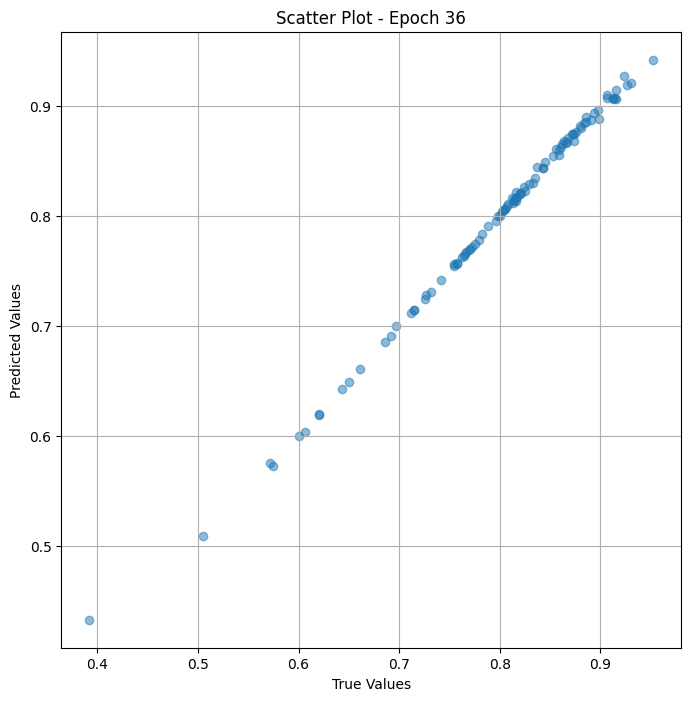

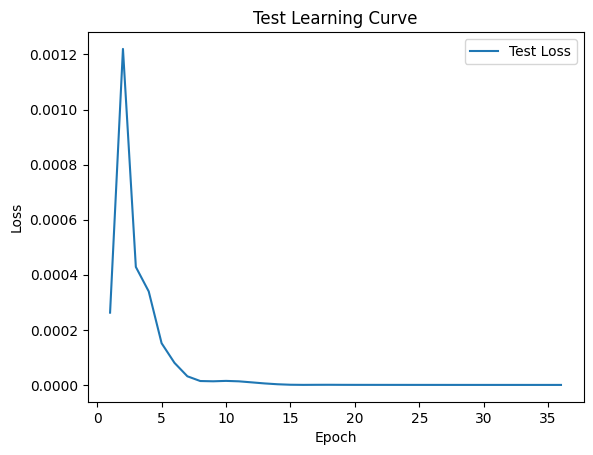


 Epoch: (37/50) Loss = 2.038146007521391e-08

 Epoch: (37/50) Loss_rmse = 0.00014276364527177066

 Epoch: (37/50) R^2 = 0.9999875426292419

 Epoch: (37/50) MAE = 0.00012759864330291748
Spearman correlation coefficient: SignificanceResult(statistic=0.9988198430089191, pvalue=2.705544829128084e-125)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.8837209

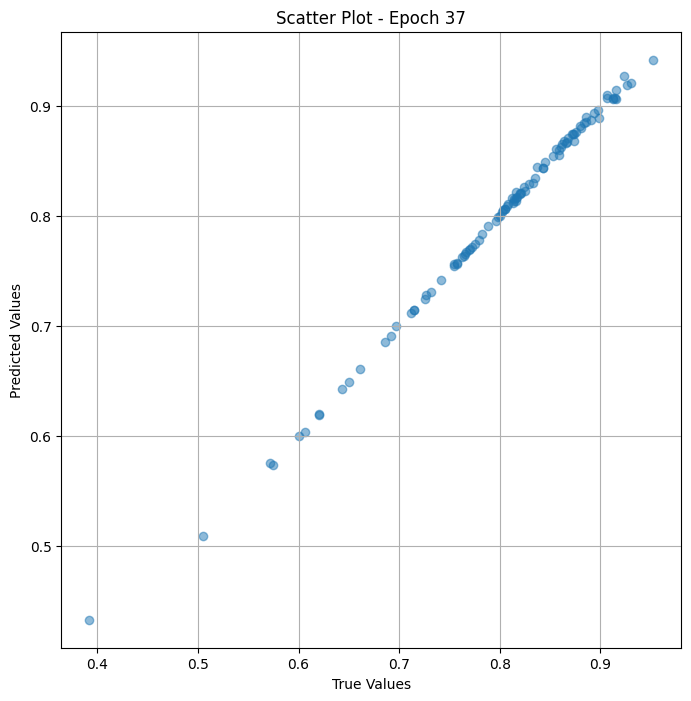

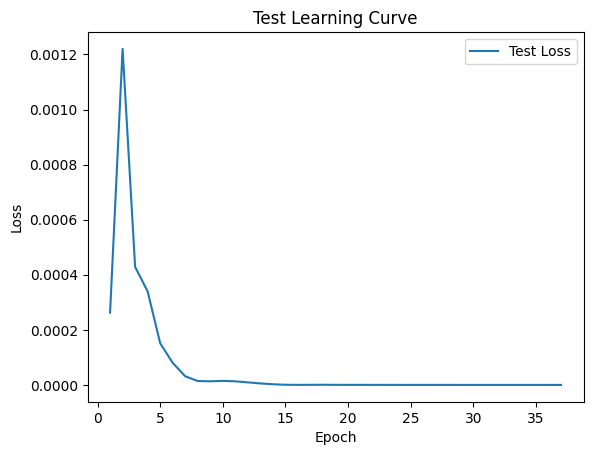


 Epoch: (38/50) Loss = 1.8754123587427785e-08

 Epoch: (38/50) Loss_rmse = 0.00013694570225197822

 Epoch: (38/50) R^2 = 0.9999885559082031

 Epoch: (38/50) MAE = 0.00012549757957458496
Spearman correlation coefficient: SignificanceResult(statistic=0.9988198430089191, pvalue=2.705544829128084e-125)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.883720

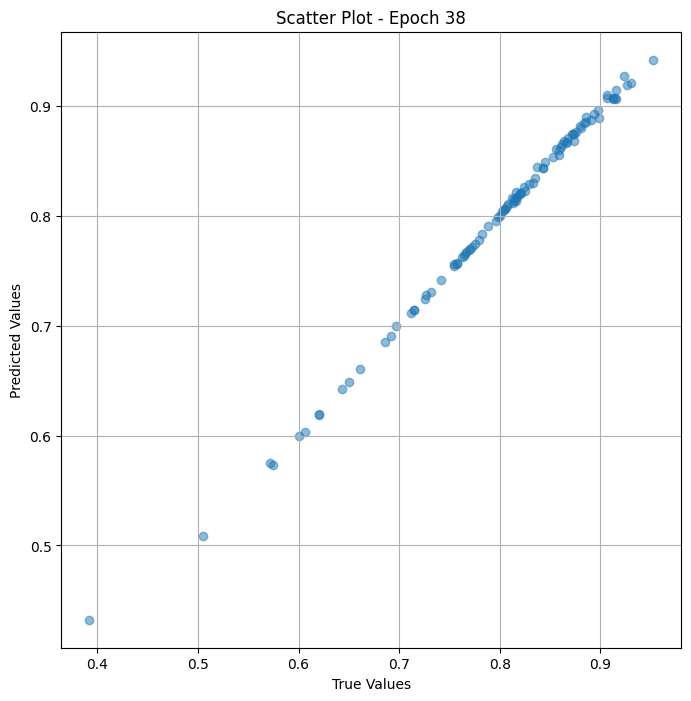

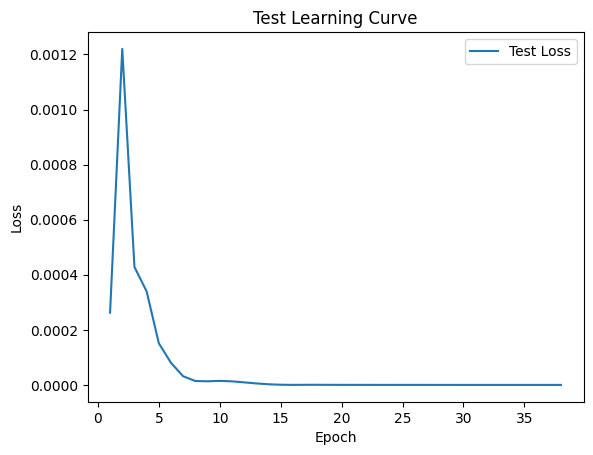


 Epoch: (39/50) Loss = 1.7402937757537984e-08

 Epoch: (39/50) Loss_rmse = 0.00013192019832786173

 Epoch: (39/50) R^2 = 0.9999893307685852

 Epoch: (39/50) MAE = 0.00012305378913879395
Spearman correlation coefficient: SignificanceResult(statistic=0.9988198430089191, pvalue=2.705544829128084e-125)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.883720

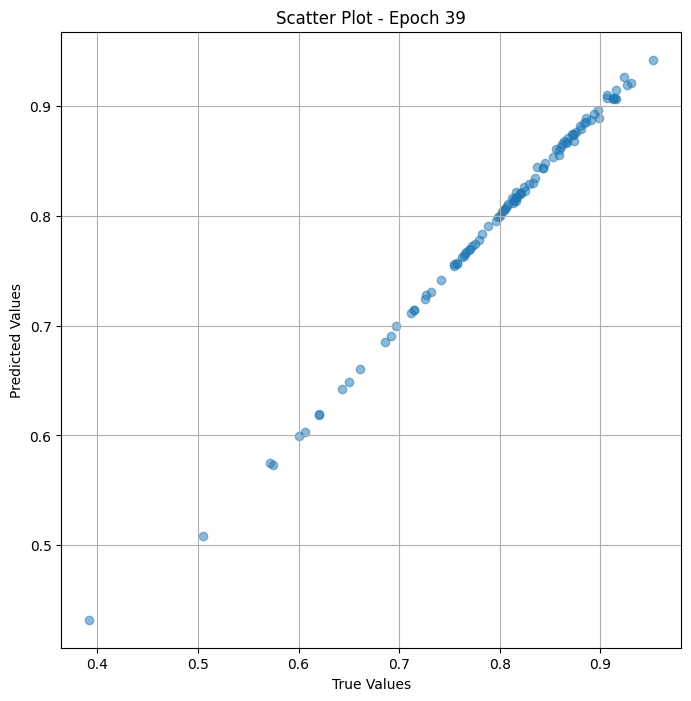

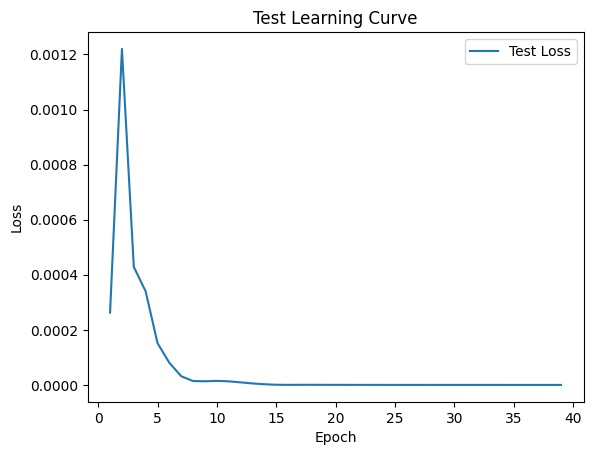


 Epoch: (40/50) Loss = 1.6393931545621854e-08

 Epoch: (40/50) Loss_rmse = 0.0001280387950828299

 Epoch: (40/50) R^2 = 0.9999899864196777

 Epoch: (40/50) MAE = 0.00012066960334777832
Spearman correlation coefficient: SignificanceResult(statistic=0.9988198430089191, pvalue=2.705544829128084e-125)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.8837209

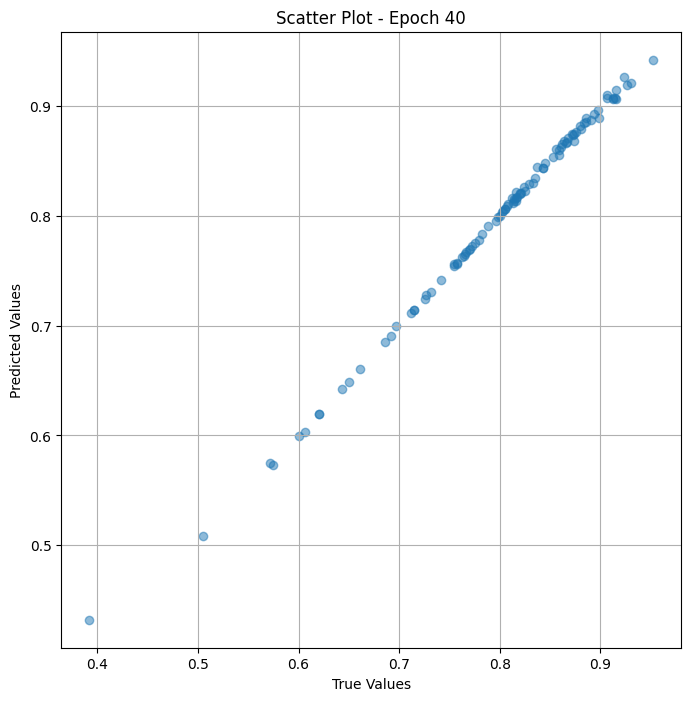

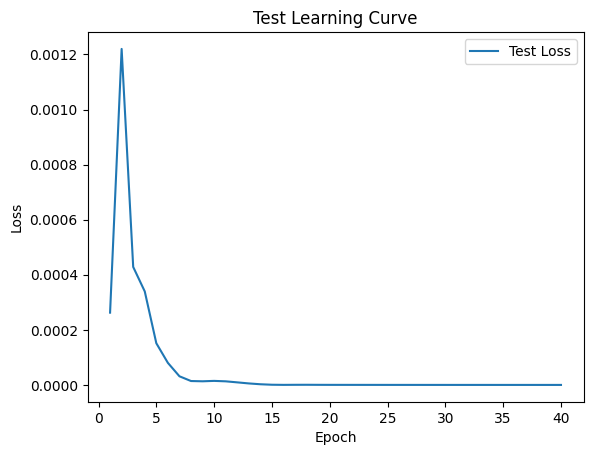


 Epoch: (41/50) Loss = 1.5726232760471248e-08

 Epoch: (41/50) Loss_rmse = 0.00012540427269414067

 Epoch: (41/50) R^2 = 0.9999904036521912

 Epoch: (41/50) MAE = 0.00011873245239257812
Spearman correlation coefficient: SignificanceResult(statistic=0.9988198430089191, pvalue=2.705544829128084e-125)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.883720

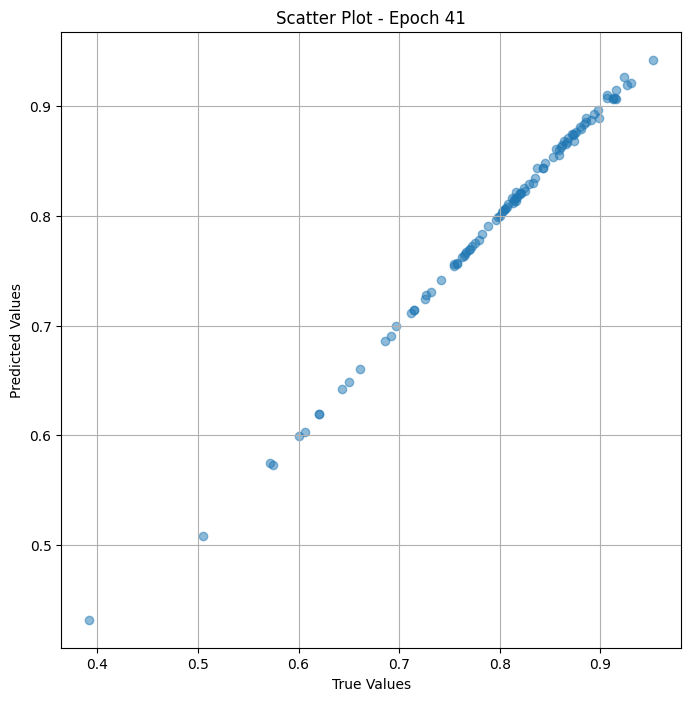

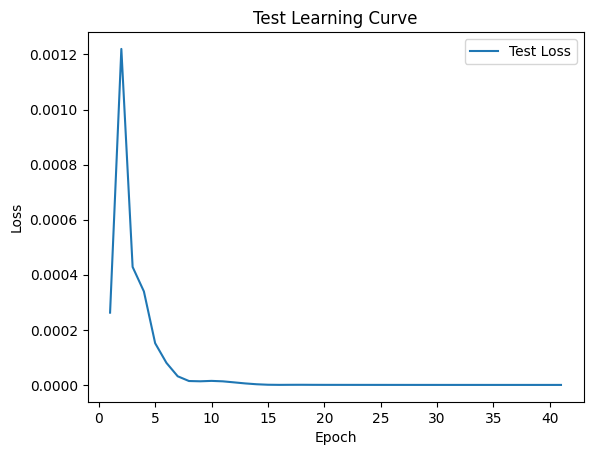


 Epoch: (42/50) Loss = 1.531998350401409e-08

 Epoch: (42/50) Loss_rmse = 0.00012377391976770014

 Epoch: (42/50) R^2 = 0.9999906420707703

 Epoch: (42/50) MAE = 0.00011710822582244873
Spearman correlation coefficient: SignificanceResult(statistic=0.9988198430089191, pvalue=2.705544829128084e-125)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.8837209

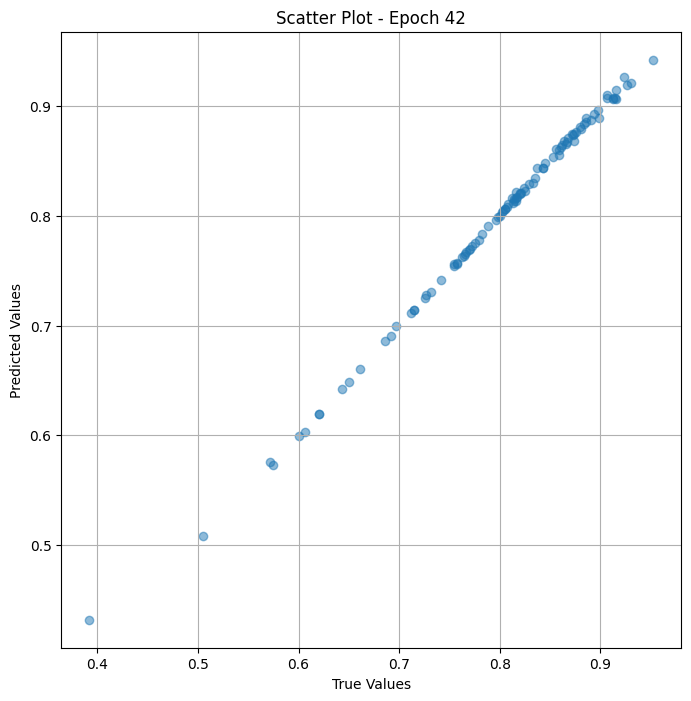

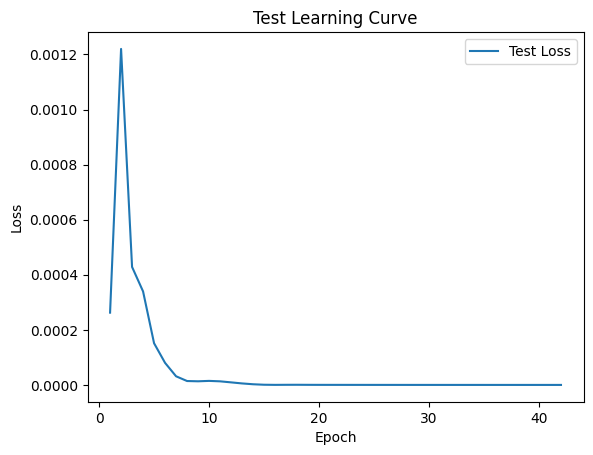


 Epoch: (43/50) Loss = 1.5041672796201055e-08

 Epoch: (43/50) Loss_rmse = 0.0001226445019710809

 Epoch: (43/50) R^2 = 0.9999908208847046

 Epoch: (43/50) MAE = 0.00011533498764038086
Spearman correlation coefficient: SignificanceResult(statistic=0.9988198430089191, pvalue=2.705544829128084e-125)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.8837209

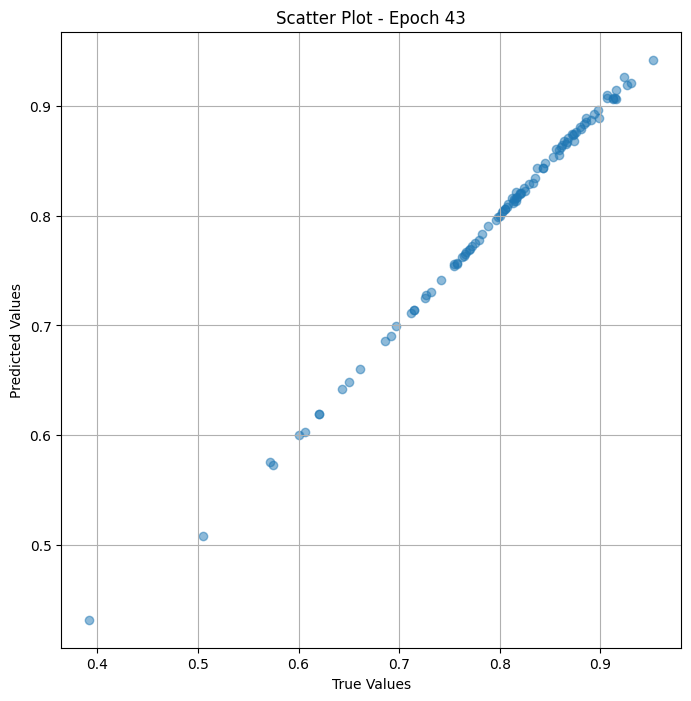

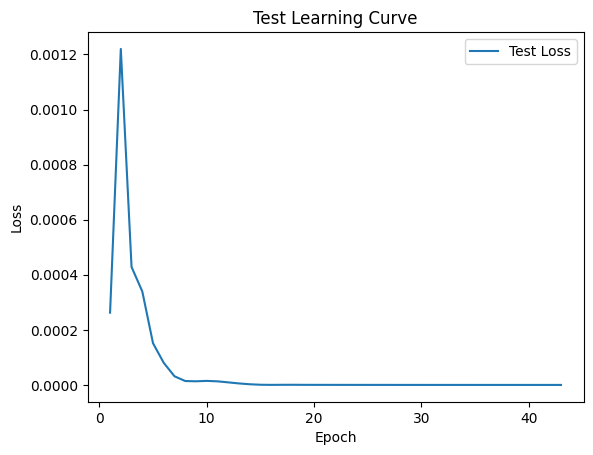


 Epoch: (44/50) Loss = 1.482704448108052e-08

 Epoch: (44/50) Loss_rmse = 0.00012176635209470987

 Epoch: (44/50) R^2 = 0.9999909400939941

 Epoch: (44/50) MAE = 0.00011336803436279297
Spearman correlation coefficient: SignificanceResult(statistic=0.9988198430089191, pvalue=2.705544829128084e-125)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.8837209

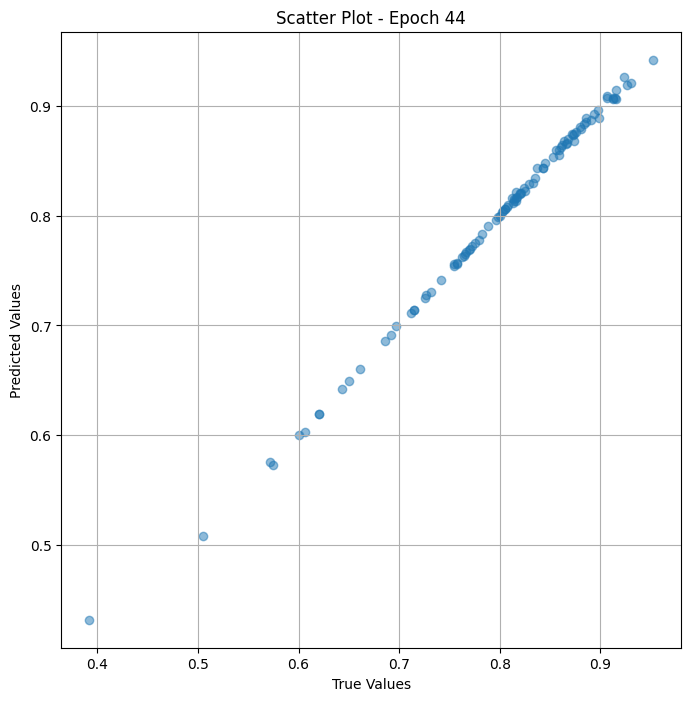

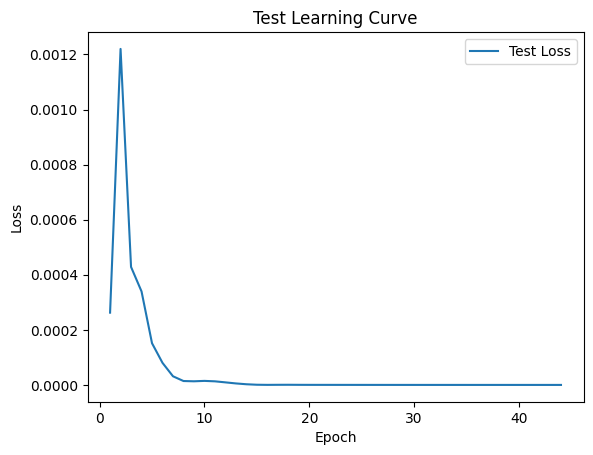


 Epoch: (45/50) Loss = 1.4673405601683953e-08

 Epoch: (45/50) Loss_rmse = 0.00012113383127143607

 Epoch: (45/50) R^2 = 0.9999909996986389

 Epoch: (45/50) MAE = 0.00011143088340759277
Spearman correlation coefficient: SignificanceResult(statistic=0.9988198430089191, pvalue=2.705544829128084e-125)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.883720

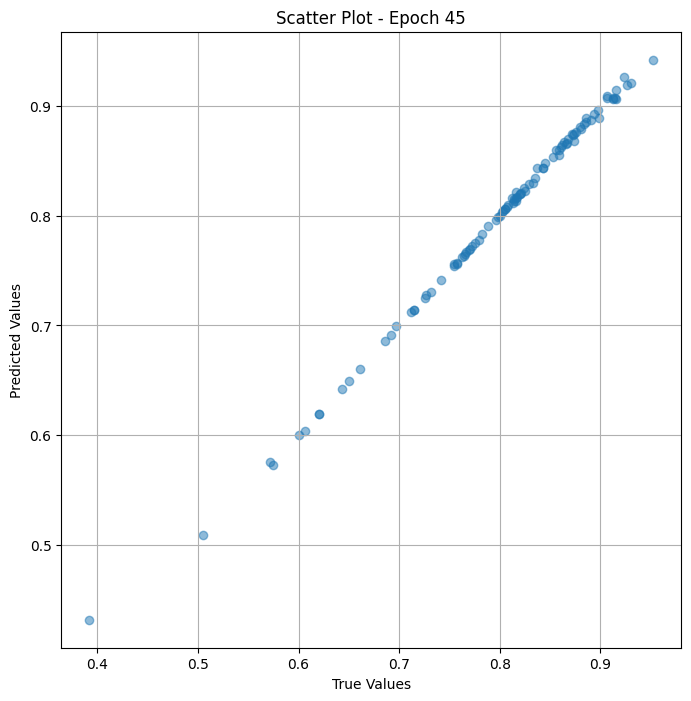

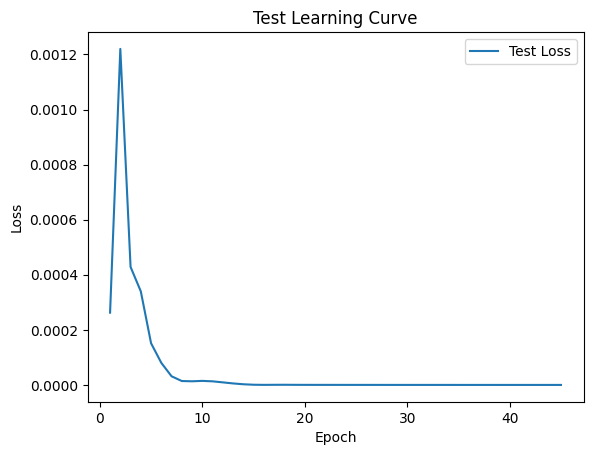


 Epoch: (46/50) Loss = 1.4596489350537922e-08

 Epoch: (46/50) Loss_rmse = 0.00012081593013135716

 Epoch: (46/50) R^2 = 0.9999910593032837

 Epoch: (46/50) MAE = 0.00010976195335388184
Spearman correlation coefficient: SignificanceResult(statistic=0.9988741031046932, pvalue=2.965180397556319e-126)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.883720

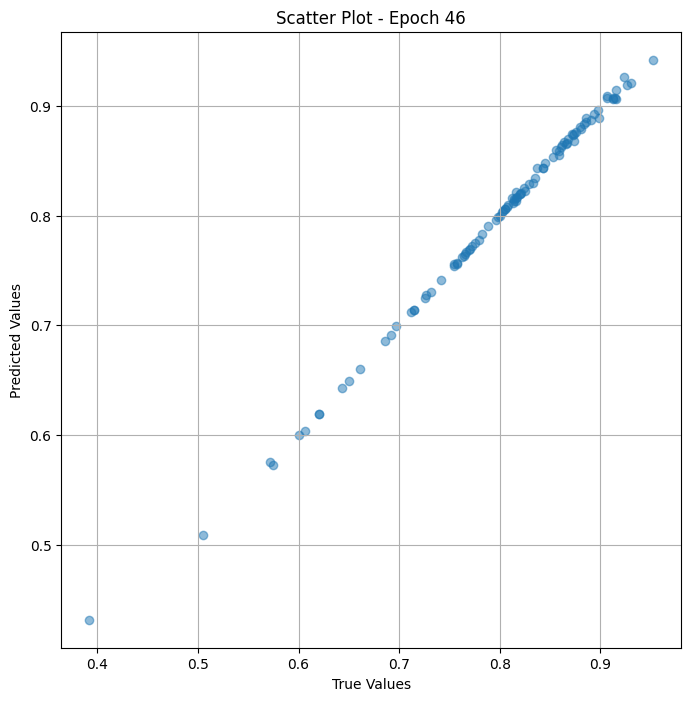

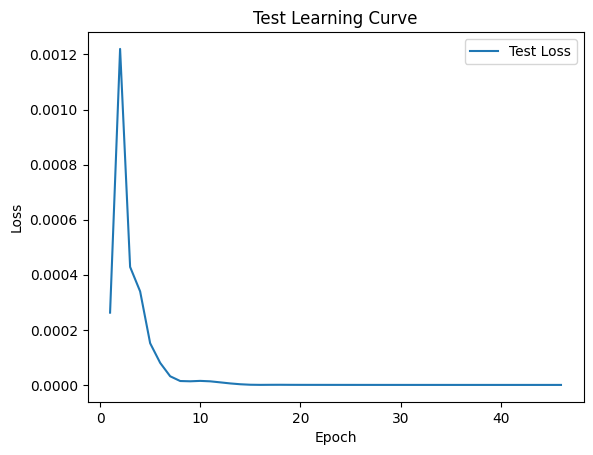


 Epoch: (47/50) Loss = 1.4591053698609358e-08

 Epoch: (47/50) Loss_rmse = 0.00012079343287041411

 Epoch: (47/50) R^2 = 0.9999910593032837

 Epoch: (47/50) MAE = 0.00010851025581359863
Spearman correlation coefficient: SignificanceResult(statistic=0.9988876681286366, pvalue=1.677894176715171e-126)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.883720

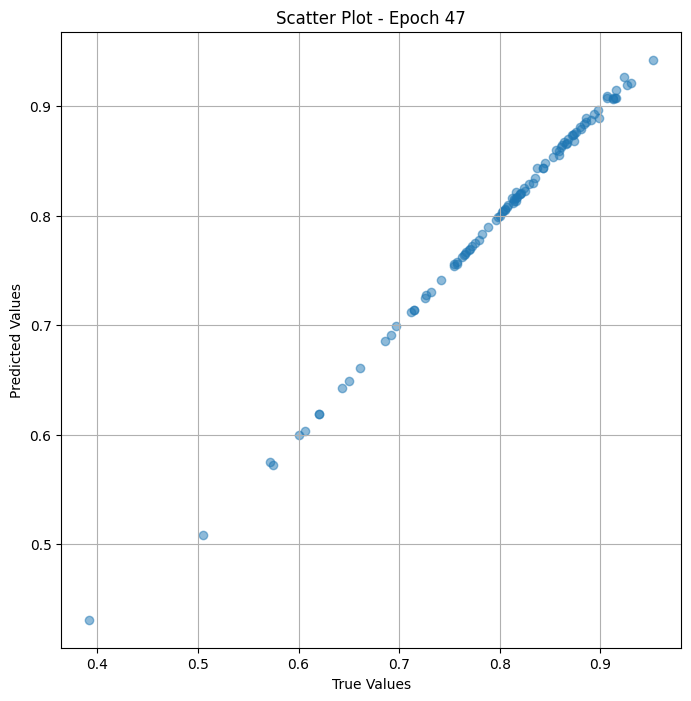

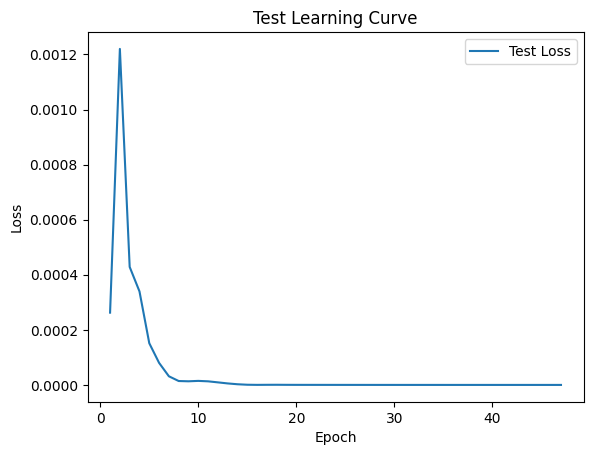


 Epoch: (48/50) Loss = 1.4593493524728274e-08

 Epoch: (48/50) Loss_rmse = 0.0001208035318995826

 Epoch: (48/50) R^2 = 0.9999910593032837

 Epoch: (48/50) MAE = 0.00010733306407928467
Spearman correlation coefficient: SignificanceResult(statistic=0.9990572309279306, pvalue=7.086932129957641e-130)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.8837209

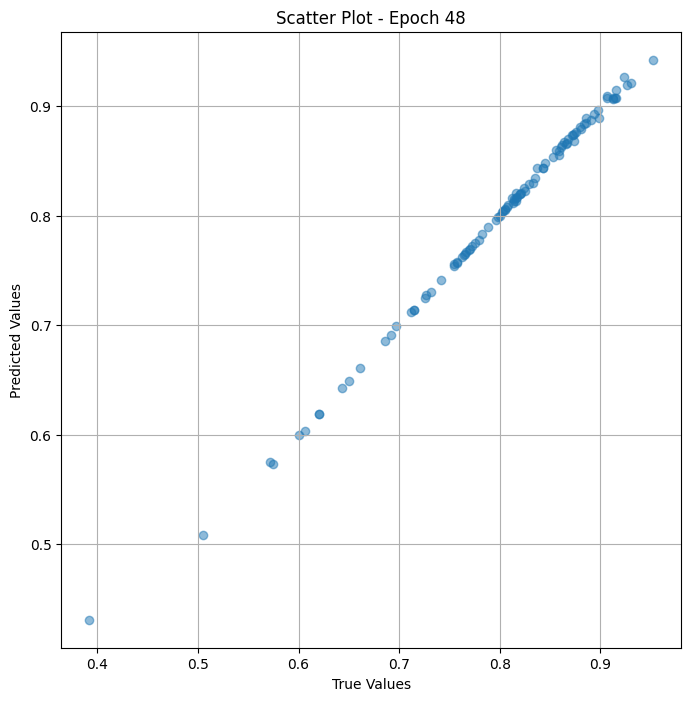

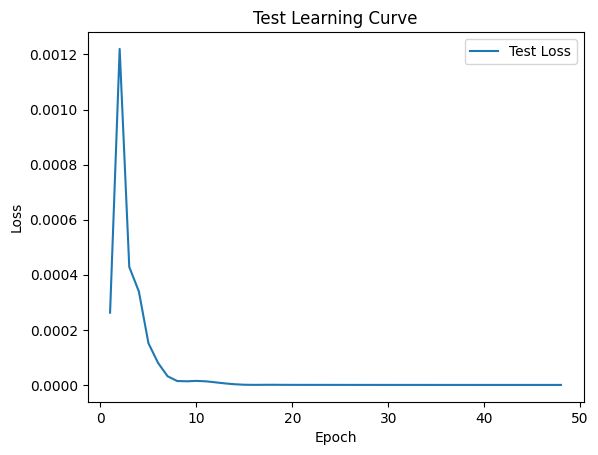


 Epoch: (49/50) Loss = 1.460123488783438e-08

 Epoch: (49/50) Loss_rmse = 0.00012083556794095784

 Epoch: (49/50) R^2 = 0.9999910593032837

 Epoch: (49/50) MAE = 0.00010617077350616455
Spearman correlation coefficient: SignificanceResult(statistic=0.9990572309279306, pvalue=7.086932129957641e-130)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.8837209

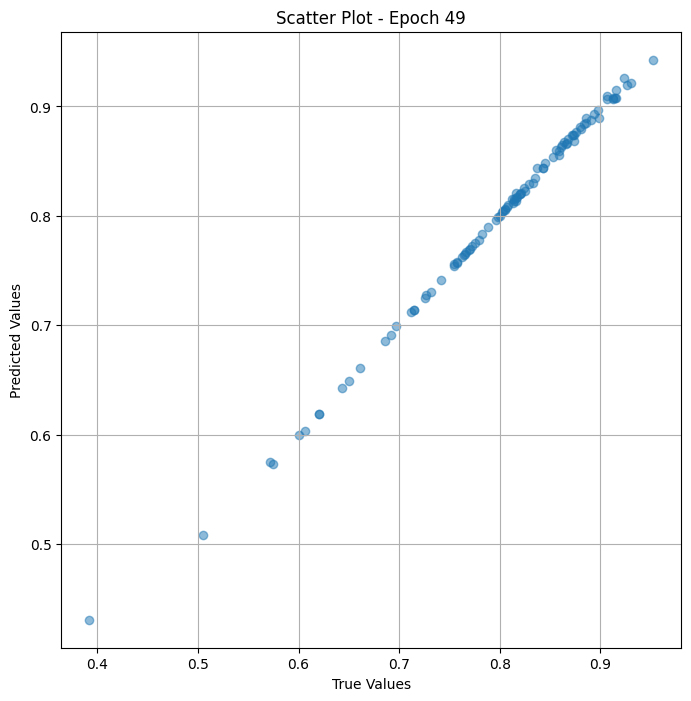

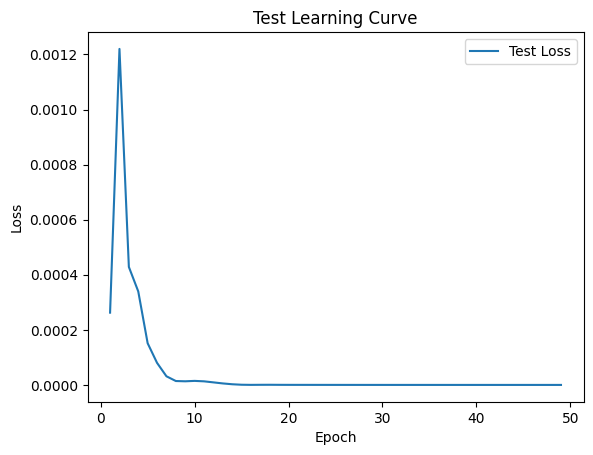

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (50/50) Loss = 1.4606272635830919e-08

 Epoch: (50/50) Loss_rmse = 0.00012085641355952248

 Epoch: (50/50) R^2 = 0.9999910593032837

 Epoch: (50/50) MAE = 0.0001051872968673706
Spearman correlation coefficient: SignificanceResult(statistic=0.9990572309279306, pvalue=7.086932129957641e-130)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8

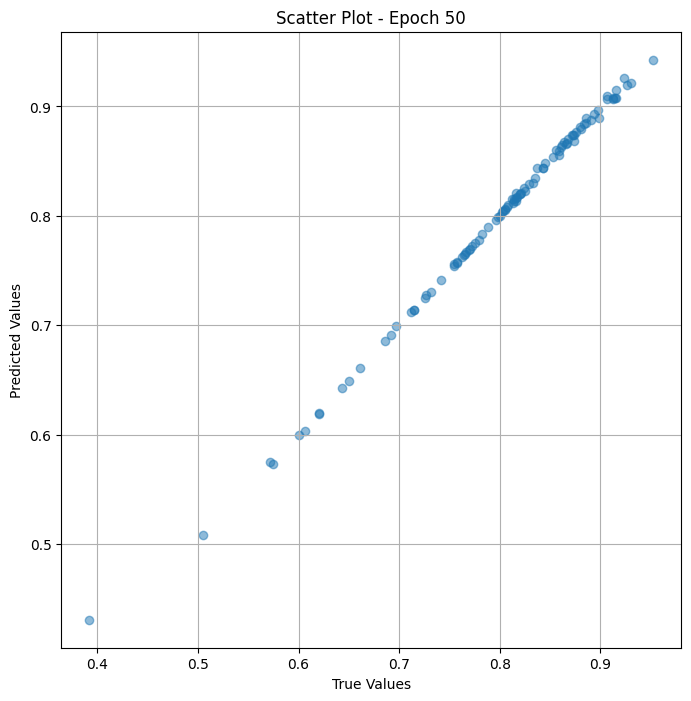

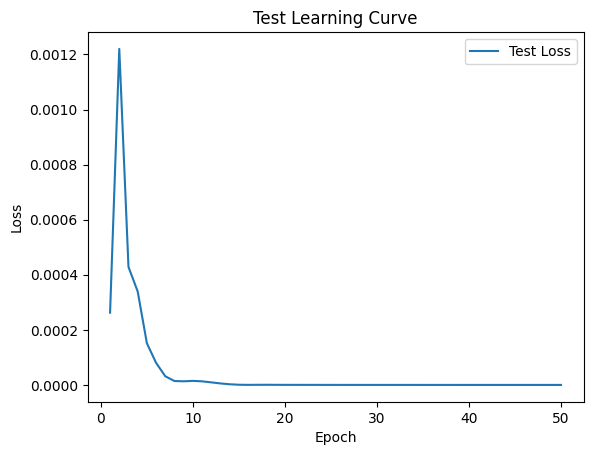

In [ ]:
# val the model and save weights
fit(50, model_res_test , test_dl )
torch.save(model_res_test.state_dict(), "model_weights_s")

In [ ]:
true_values_list_test = []
predicted_values_list_test = []

for x_trans, yb in test_dl:
    preds =model_res_test(x_trans)
    true_values_list_test.extend(yb.cpu().detach().numpy())
    predicted_values_list_test.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_animal' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_test_animal['preprocessed_image_path'],
    'True Value': true_values_list_test,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_test # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)

                                         Image Path  True Value  \
0   /content/animal/n01846331_1102_preprocessed.jpg    0.885714   
1   /content/animal/n01846331_2820_preprocessed.jpg    0.873684   
2    /content/animal/n02118333_329_preprocessed.jpg    0.914894   
3     /content/animal/000000144157_preprocessed.jpg    0.890909   
4     /content/animal/000000140360_preprocessed.jpg    0.821053   
..                                              ...         ...   
95  /content/animal/n01846331_6225_preprocessed.jpg    0.650000   
96  /content/animal/n02129165_5082_preprocessed.jpg    0.828829   
97  /content/animal/n01811909_5541_preprocessed.jpg    0.820225   
98    /content/animal/000000257214_preprocessed.jpg    0.876106   
99    /content/animal/000000551602_preprocessed.jpg    0.762295   

    Predicted Value  
0          0.811961  
1          0.837237  
2          0.830303  
3          0.782433  
4          0.812322  
..              ...  
95         0.708165  
96         0.833926

#Finetuning

##Train

In [ ]:
class Dataset_train_fine(Dataset):
    def __init__(self, df,res_fine_transform =None):
        self.labels = df_train_animal["memoscore"]
        self.images = df_train_animal["preprocessed_image_path"]
        self.res_fine_transform  = res_fine_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.res_fine_transform (image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
res_fine_transform   = ConvNextImageProcessor.from_pretrained("facebook/convnext-tiny-224")

# สร้าง Dataset และ DataLoader
train_ds_fine = Dataset_train_fine(df_train_animal, res_fine_transform =res_fine_transform )
train_dl_fine = DataLoader(train_ds_fine, batch_size=16, shuffle=False)

# เรียกดูข้อมูลจาก DataLoader
'''for image_trans, label in train_dl:
    # คำสั่งนี้จะแสดงขนาดของรูปภาพที่ transform แล้วในแต่ละ batch
    print(image_trans)
    break'''


'for image_trans, label in train_dl:\n    # คำสั่งนี้จะแสดงขนาดของรูปภาพที่ transform แล้วในแต่ละ batch\n    print(image_trans)\n    break'

In [ ]:
class Resmem_model_fine_animal(torch.nn.Module):
    def __init__(self, arch="resnet50.a1_in1k"):
        super().__init__()
        self.arch = arch
        self.res = timm.create_model(self.arch, pretrained=True, num_classes=1)



    def forward(self, x):
        resfeat = self.res(x)

        out = torch.sigmoid(resfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_res_fine =  Resmem_model_fine_animal( arch="resnet50.a1_in1k")

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_fine = DeviceDataLoader(train_dl_fine, device)
model_res_fine = to_device(model_res_fine  , device)

In [ ]:
params = [param for param in list(model_res_fine.parameters()) if param.requires_grad == True ]
base_parameters = [self.model.conv1.parameters(),
                   self.model.layer1.parameters(),
                   self.model.layer2.parameters(),
                   self.model.layer3.parameters(),
                   self.model.layer4.parameters()]
optimizer = torch.optim.Adam(params,itertools.chain(*base_parameters), lr=1e-4 ,weight_decay=1e-7)


lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)



In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res_fine, train_dl_fine):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res_fine.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in train_dl_fine:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res_fine(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/20) Loss = 0.005022415891289711

 Epoch: (1/20) Loss_rmse = 0.07086900621652603

 Epoch: (1/20) R^2 = -0.7584736347198486

 Epoch: (1/20) MAE = 0.05611051619052887
Spearman correlation coefficient: SignificanceResult(statistic=0.15522473881091392, pvalue=3.935857341496793e-11)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.8

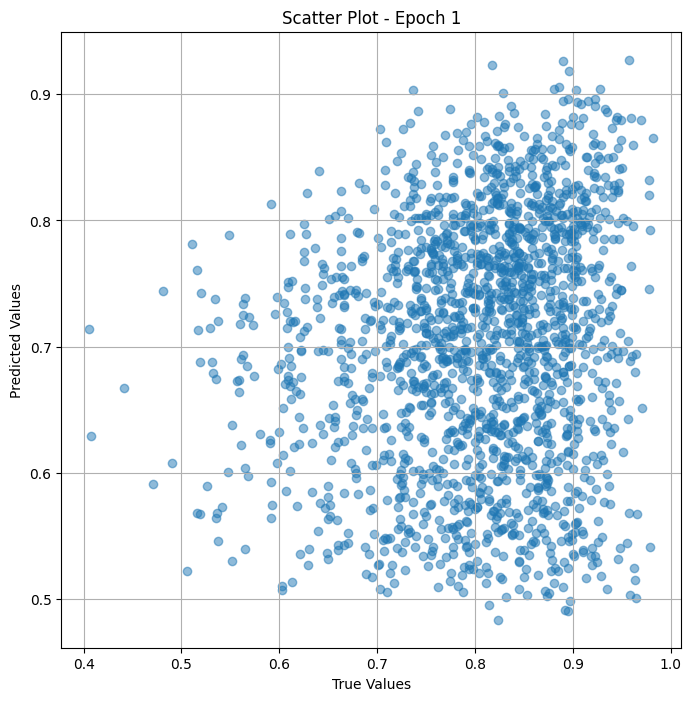

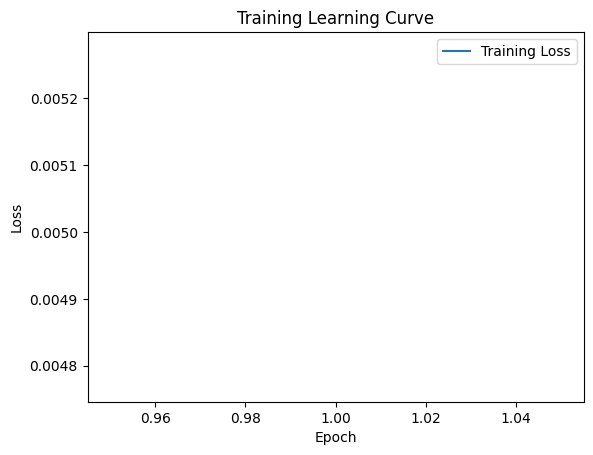


 Epoch: (2/20) Loss = 0.001374542247503996

 Epoch: (2/20) Loss_rmse = 0.03707481920719147

 Epoch: (2/20) R^2 = 0.5187382698059082

 Epoch: (2/20) MAE = 0.0341673269867897
Spearman correlation coefficient: SignificanceResult(statistic=0.7622332910031396, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 0.77551

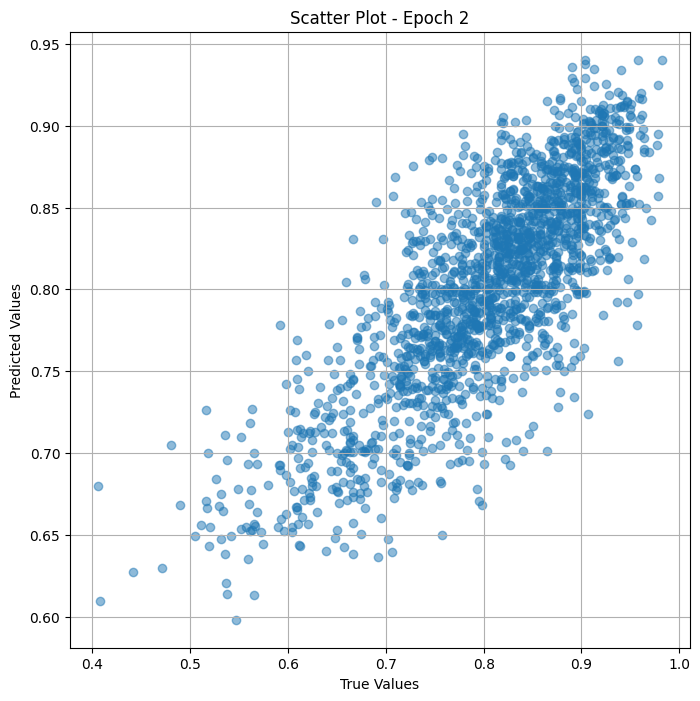

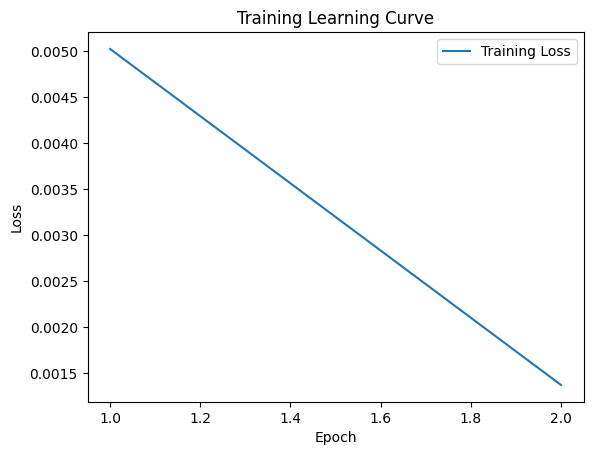


 Epoch: (3/20) Loss = 0.0009218635968863964

 Epoch: (3/20) Loss_rmse = 0.03036220744252205

 Epoch: (3/20) R^2 = 0.6772324442863464

 Epoch: (3/20) MAE = 0.025877736508846283
Spearman correlation coefficient: SignificanceResult(statistic=0.9421574057149958, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 0.77

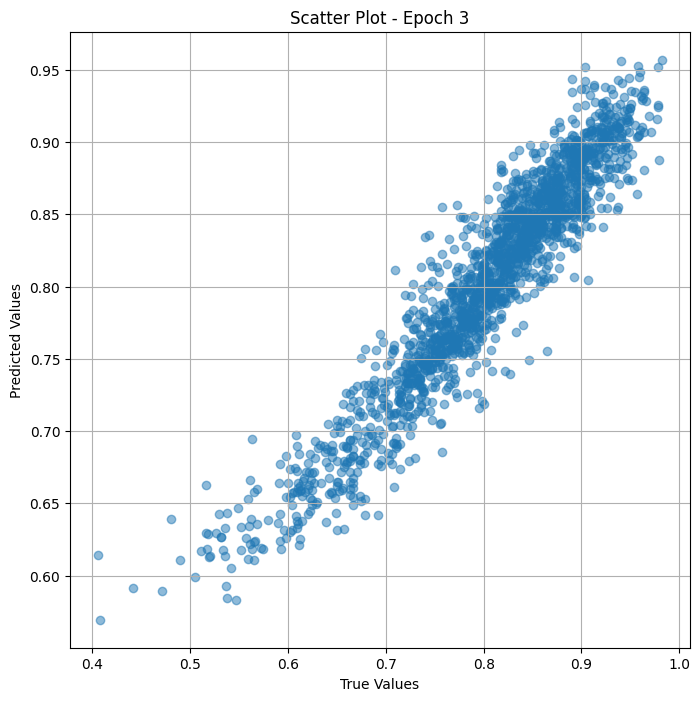

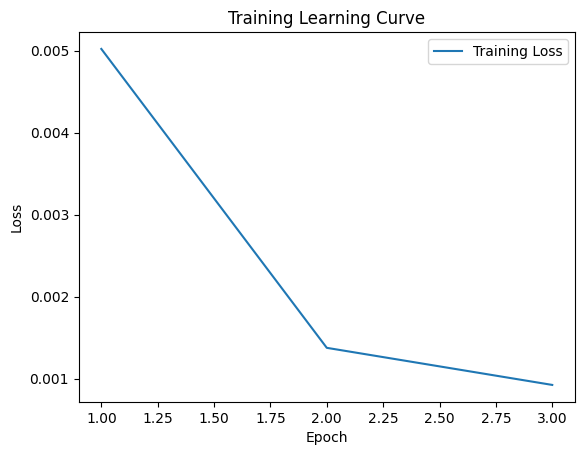


 Epoch: (4/20) Loss = 0.001422778470441699

 Epoch: (4/20) Loss_rmse = 0.0377197340130806

 Epoch: (4/20) R^2 = 0.5018495917320251

 Epoch: (4/20) MAE = 0.029363244771957397
Spearman correlation coefficient: SignificanceResult(statistic=0.9777818401560533, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 0.7755

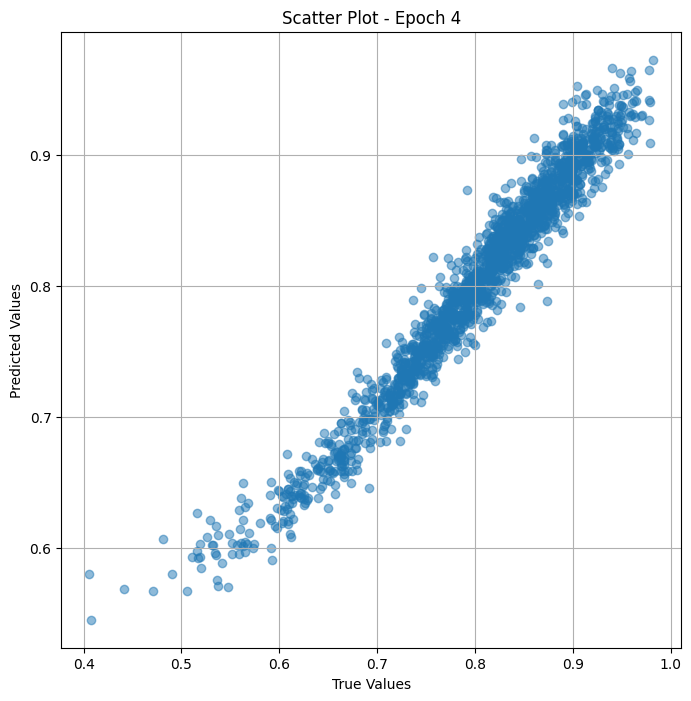

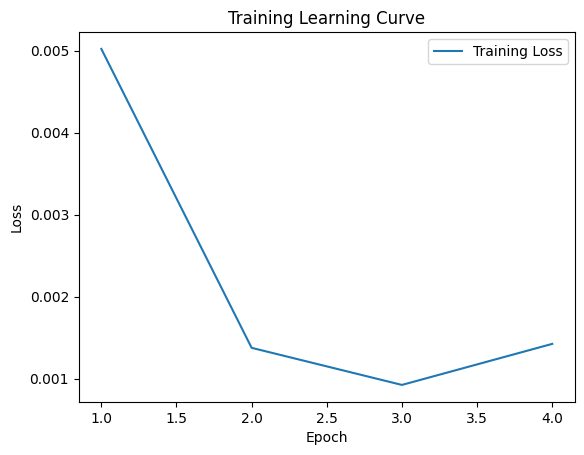


 Epoch: (5/20) Loss = 0.0020905868150293827

 Epoch: (5/20) Loss_rmse = 0.04572293534874916

 Epoch: (5/20) R^2 = 0.26803314685821533

 Epoch: (5/20) MAE = 0.0337352454662323
Spearman correlation coefficient: SignificanceResult(statistic=0.9861729471910591, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 0.775

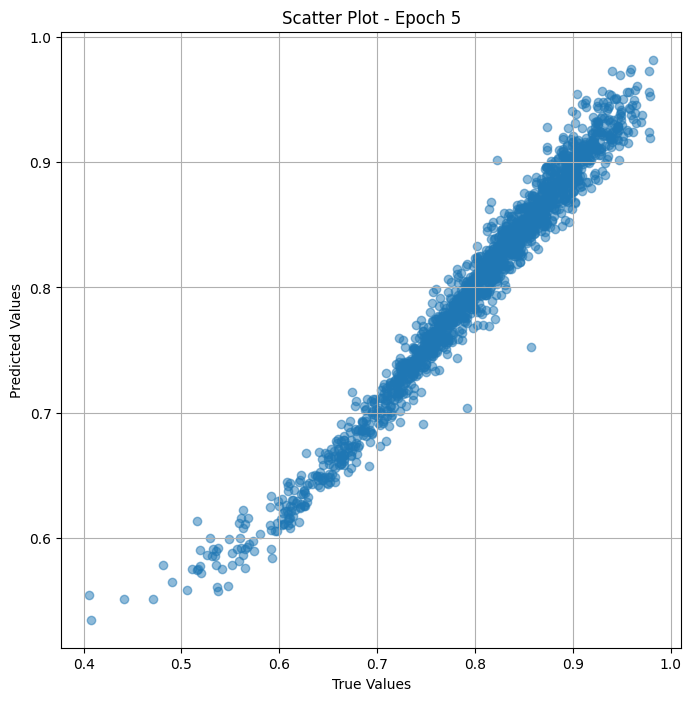

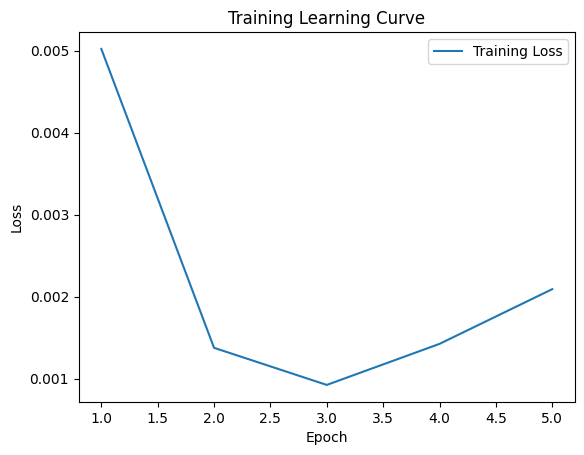

Epoch 0.04: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (6/20) Loss = 0.0015964048216119409

 Epoch: (6/20) Loss_rmse = 0.03995503485202789

 Epoch: (6/20) R^2 = 0.4410586953163147

 Epoch: (6/20) MAE = 0.033537328243255615
Spearman correlation coefficient: SignificanceResult(statistic=0.9849886539284503, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164

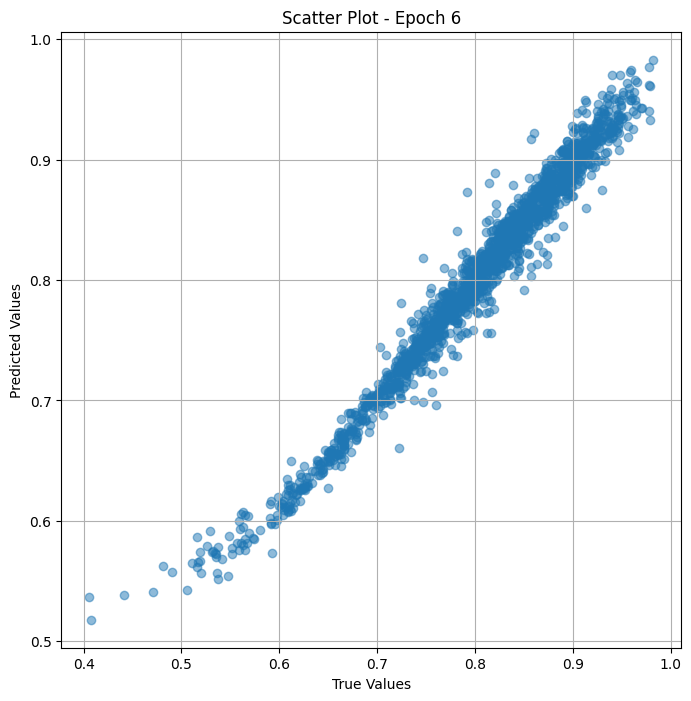

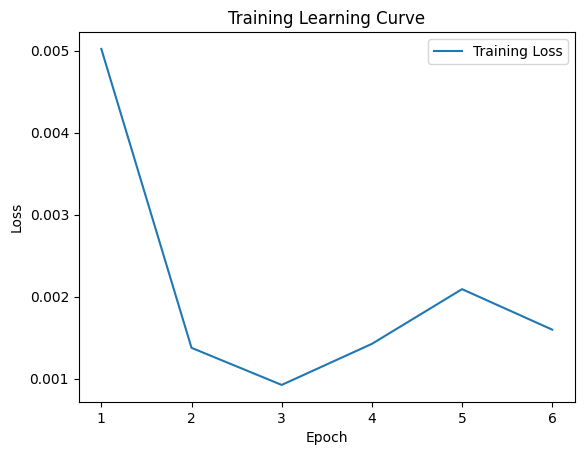


 Epoch: (7/20) Loss = 0.00040139039629139006

 Epoch: (7/20) Loss_rmse = 0.020034730434417725

 Epoch: (7/20) R^2 = 0.8594631552696228

 Epoch: (7/20) MAE = 0.017366334795951843
Spearman correlation coefficient: SignificanceResult(statistic=0.9821649203157268, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 0.

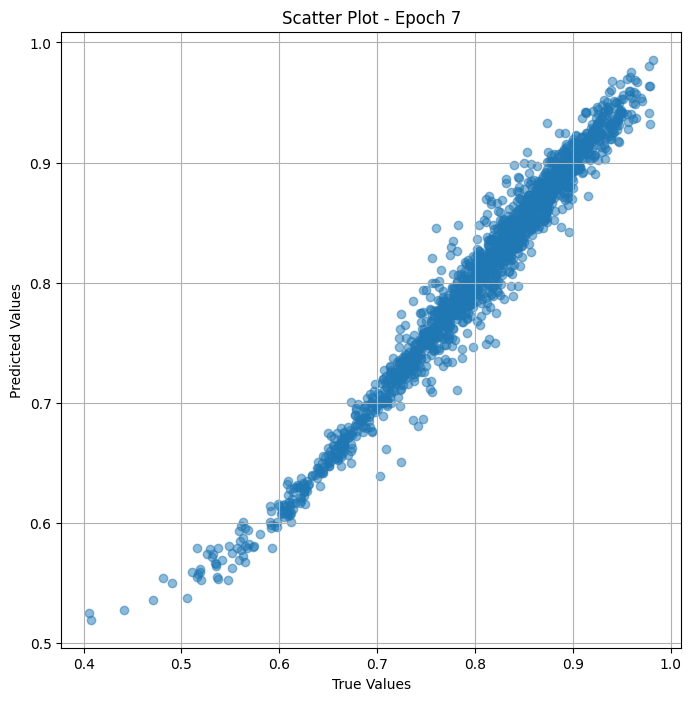

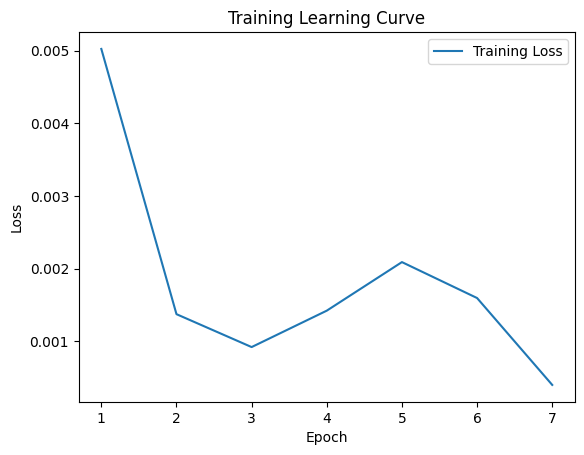


 Epoch: (8/20) Loss = 0.00023082994448486716

 Epoch: (8/20) Loss_rmse = 0.015193088911473751

 Epoch: (8/20) R^2 = 0.9191806316375732

 Epoch: (8/20) MAE = 0.013841763138771057
Spearman correlation coefficient: SignificanceResult(statistic=0.9896882404740499, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 0.

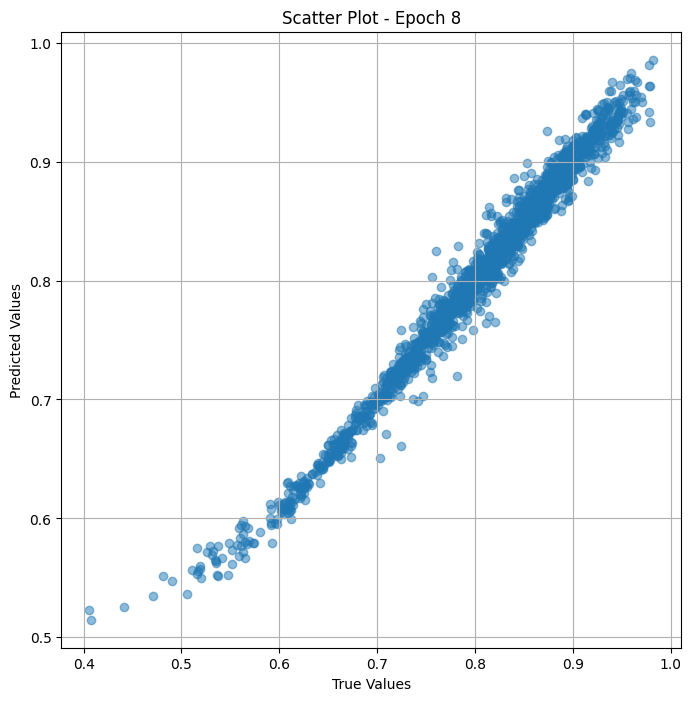

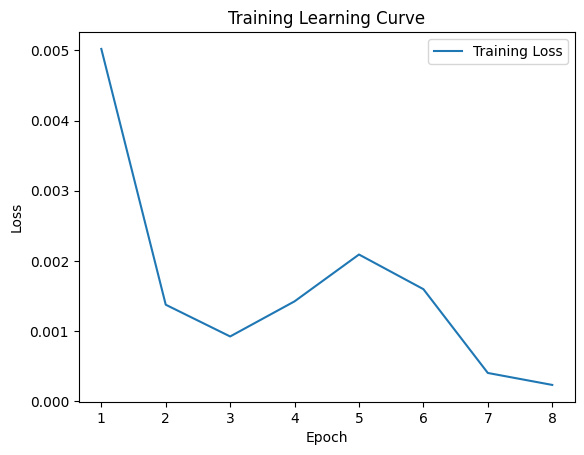


 Epoch: (9/20) Loss = 0.00014055728388484567

 Epoch: (9/20) Loss_rmse = 0.011855686083436012

 Epoch: (9/20) R^2 = 0.950787365436554

 Epoch: (9/20) MAE = 0.011116266250610352
Spearman correlation coefficient: SignificanceResult(statistic=0.9937310470304014, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 0.7

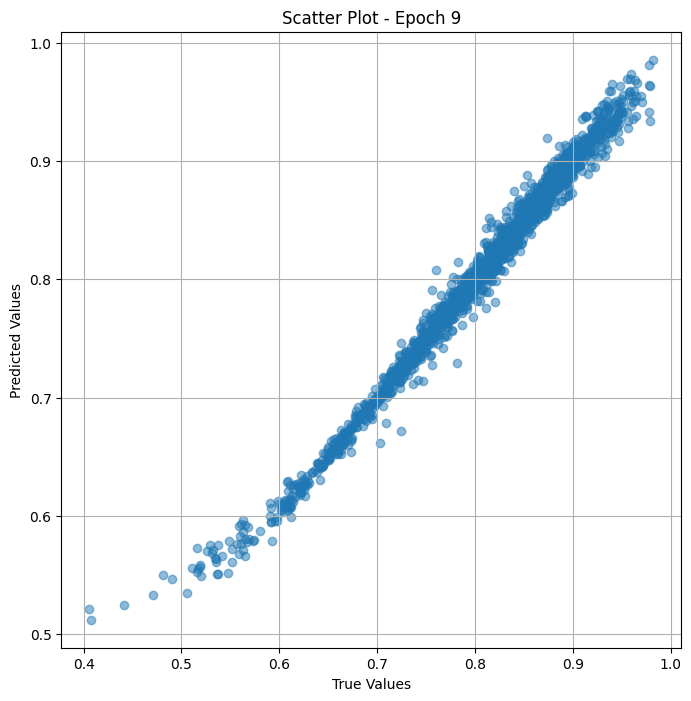

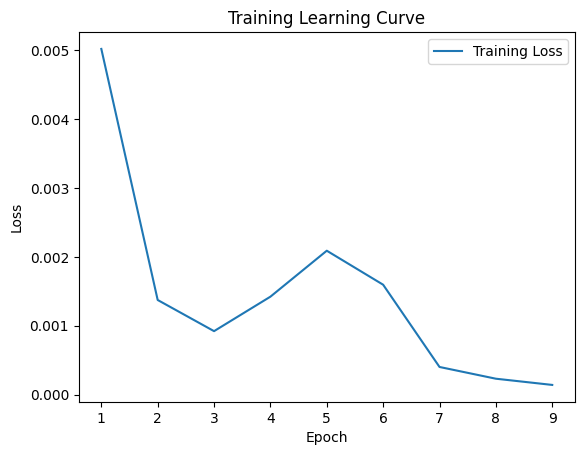


 Epoch: (10/20) Loss = 9.291814785683528e-05

 Epoch: (10/20) Loss_rmse = 0.009639405645430088

 Epoch: (10/20) R^2 = 0.9674670100212097

 Epoch: (10/20) MAE = 0.009059175848960876
Spearman correlation coefficient: SignificanceResult(statistic=0.9959323815029147, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124,

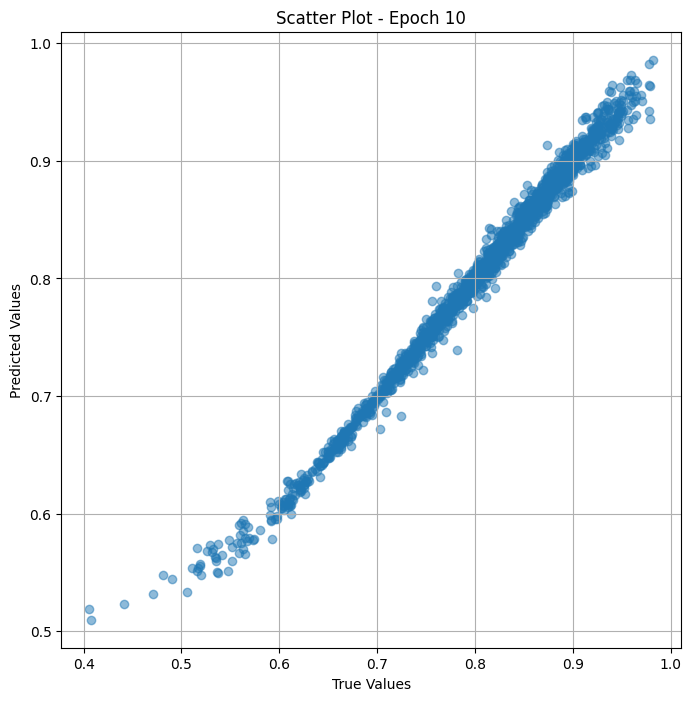

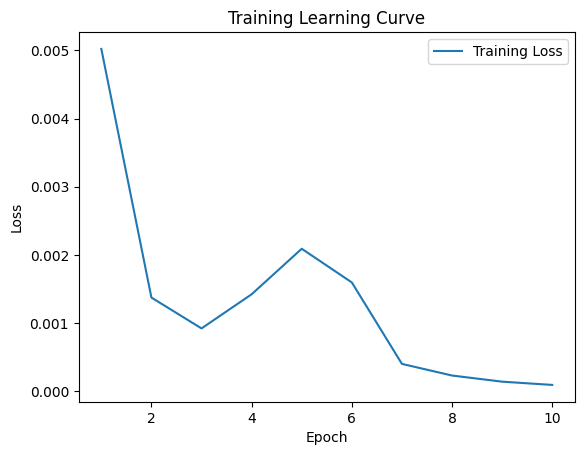


 Epoch: (11/20) Loss = 6.735648639732972e-05

 Epoch: (11/20) Loss_rmse = 0.008207099512219429

 Epoch: (11/20) R^2 = 0.976416826248169

 Epoch: (11/20) MAE = 0.007527396082878113
Spearman correlation coefficient: SignificanceResult(statistic=0.9972064808417295, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 

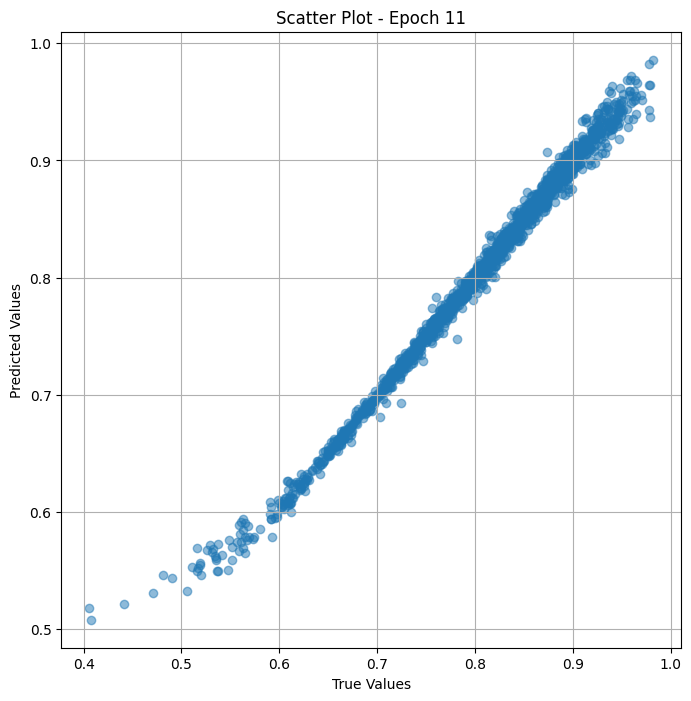

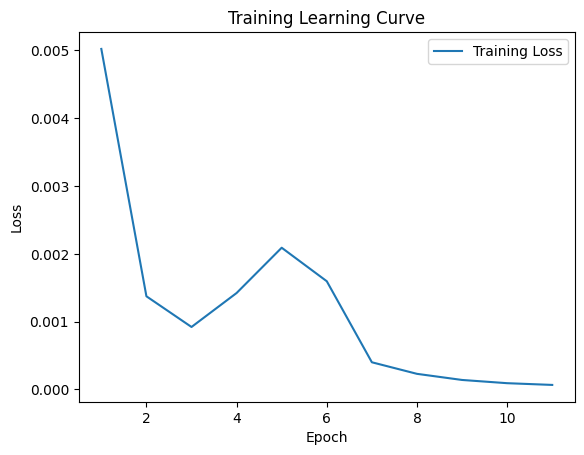


 Epoch: (12/20) Loss = 5.2745068387594074e-05

 Epoch: (12/20) Loss_rmse = 0.007262580096721649

 Epoch: (12/20) R^2 = 0.981532633304596

 Epoch: (12/20) MAE = 0.00690922886133194
Spearman correlation coefficient: SignificanceResult(statistic=0.997963604459671, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 0

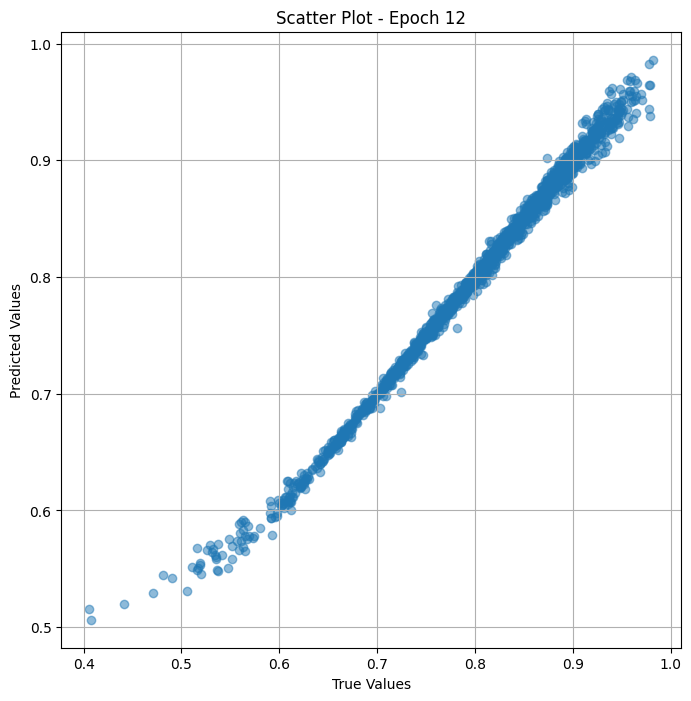

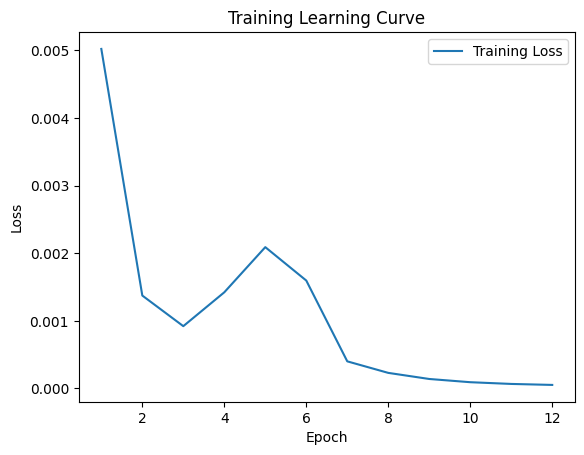


 Epoch: (13/20) Loss = 4.318388528190553e-05

 Epoch: (13/20) Loss_rmse = 0.006571444682776928

 Epoch: (13/20) R^2 = 0.984880268573761

 Epoch: (13/20) MAE = 0.006342269480228424
Spearman correlation coefficient: SignificanceResult(statistic=0.998401819941262, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 0

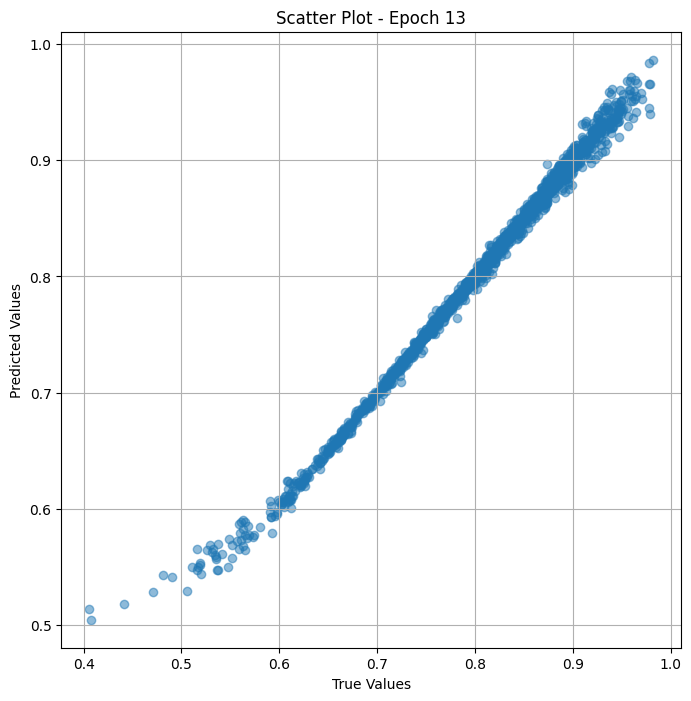

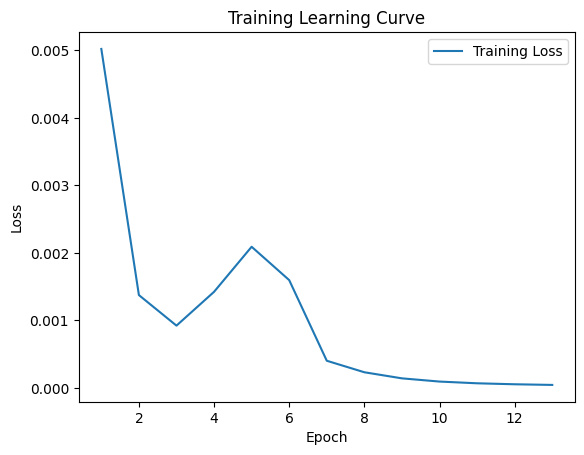


 Epoch: (14/20) Loss = 3.595986345317215e-05

 Epoch: (14/20) Loss_rmse = 0.005996654275804758

 Epoch: (14/20) R^2 = 0.9874095320701599

 Epoch: (14/20) MAE = 0.0058023035526275635
Spearman correlation coefficient: SignificanceResult(statistic=0.9986992640813522, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124

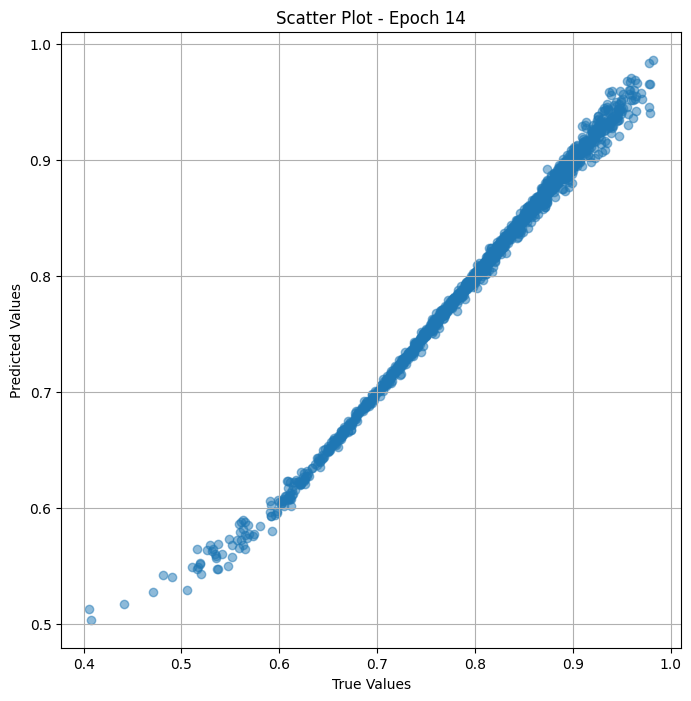

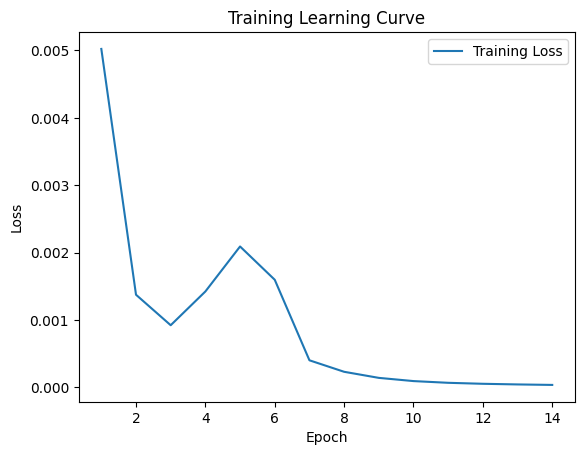


 Epoch: (15/20) Loss = 3.0040349884075113e-05

 Epoch: (15/20) Loss_rmse = 0.00548090785741806

 Epoch: (15/20) R^2 = 0.9894821047782898

 Epoch: (15/20) MAE = 0.005295753479003906
Spearman correlation coefficient: SignificanceResult(statistic=0.998911749949773, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124, 

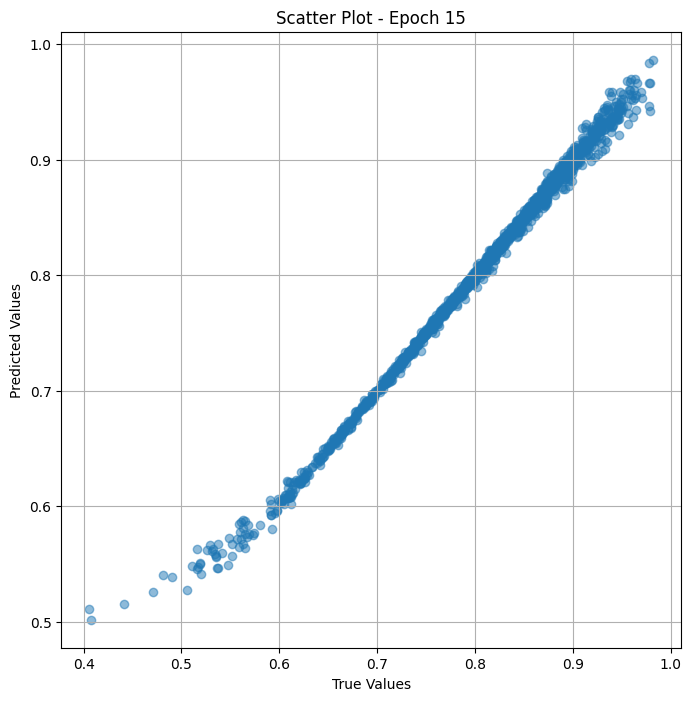

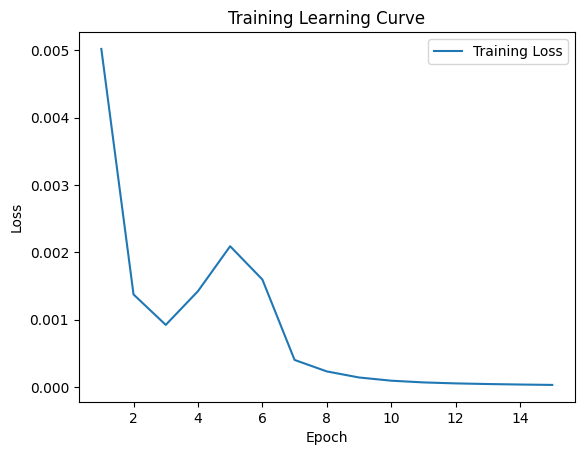


 Epoch: (16/20) Loss = 2.5003217160701752e-05

 Epoch: (16/20) Loss_rmse = 0.005000321660190821

 Epoch: (16/20) R^2 = 0.9912457466125488

 Epoch: (16/20) MAE = 0.004817932844161987
Spearman correlation coefficient: SignificanceResult(statistic=0.9990645852746306, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124

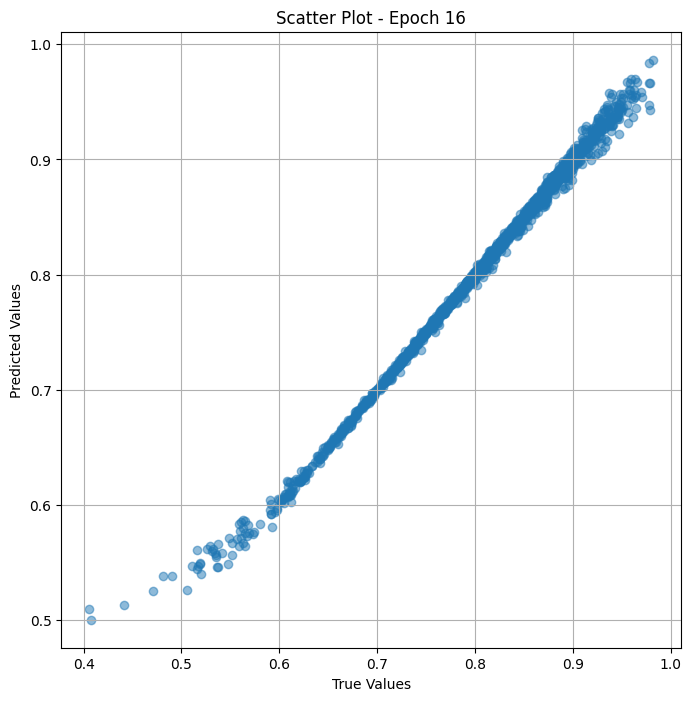

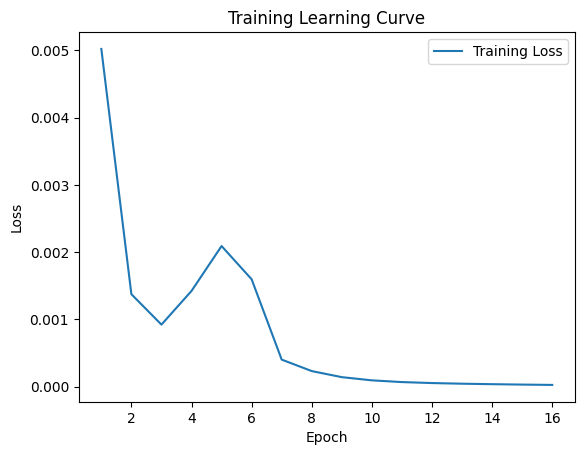


 Epoch: (17/20) Loss = 2.0528976165223867e-05

 Epoch: (17/20) Loss_rmse = 0.004530891310423613

 Epoch: (17/20) R^2 = 0.9928122758865356

 Epoch: (17/20) MAE = 0.004351302981376648
Spearman correlation coefficient: SignificanceResult(statistic=0.9991832784957361, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124

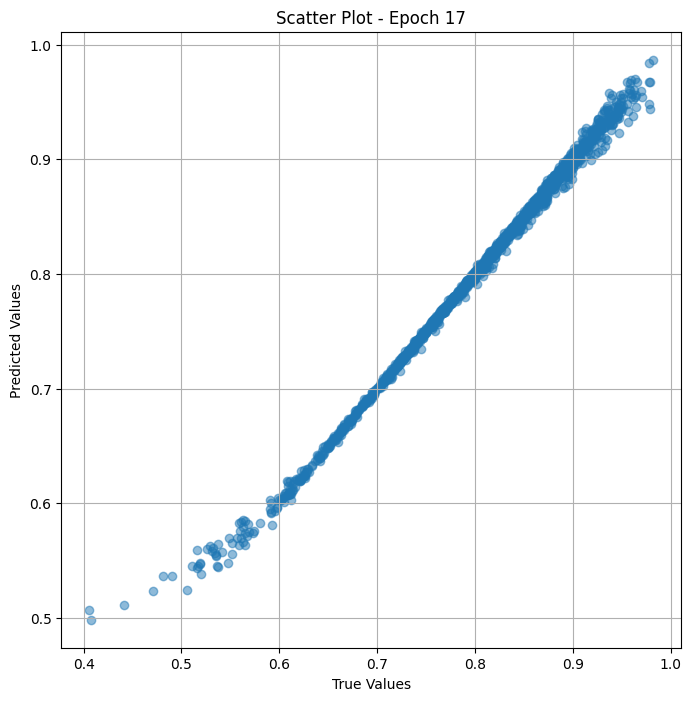

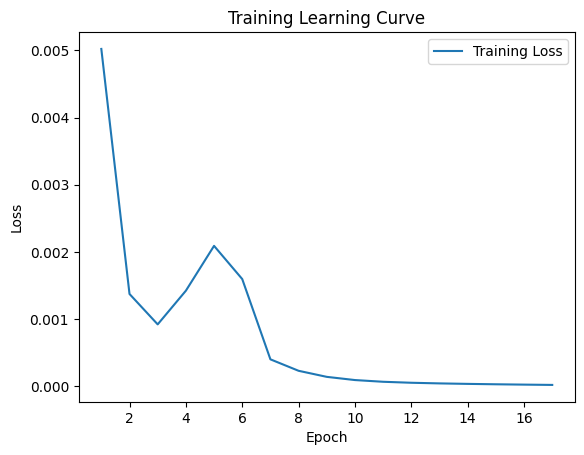


 Epoch: (18/20) Loss = 1.65799956448609e-05

 Epoch: (18/20) Loss_rmse = 0.004071854054927826

 Epoch: (18/20) R^2 = 0.9941949248313904

 Epoch: (18/20) MAE = 0.0039026886224746704
Spearman correlation coefficient: SignificanceResult(statistic=0.9992888603897324, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.7522124,

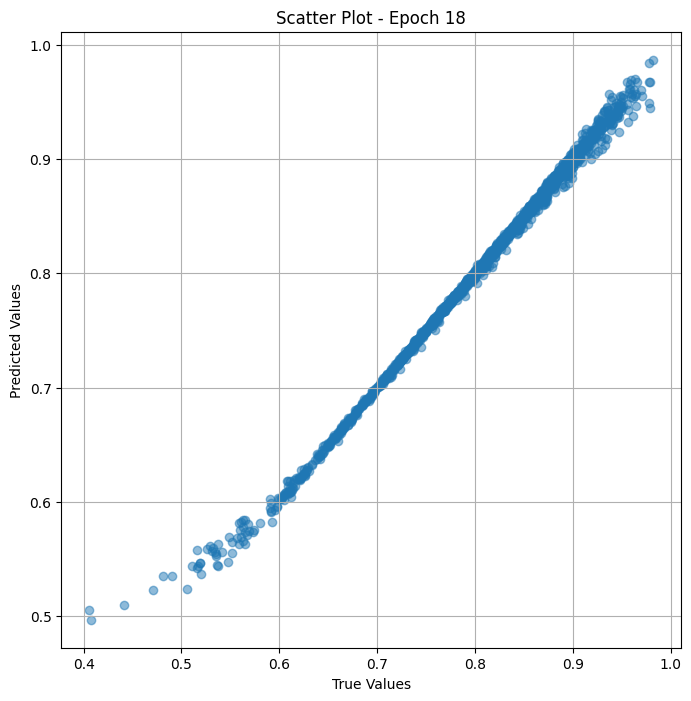

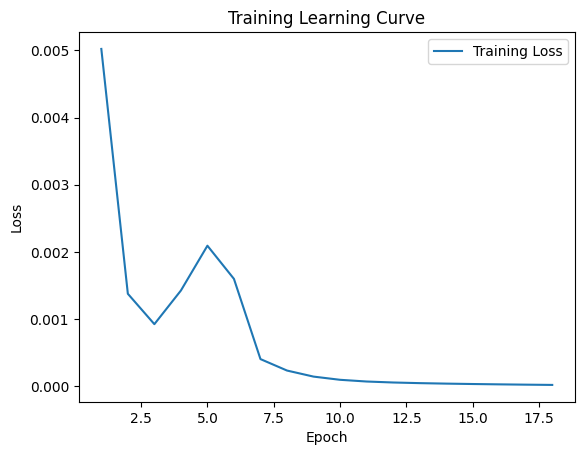


 Epoch: (19/20) Loss = 1.3221162589616142e-05

 Epoch: (19/20) Loss_rmse = 0.0036360917147248983

 Epoch: (19/20) R^2 = 0.9953709244728088

 Epoch: (19/20) MAE = 0.0034784898161888123
Spearman correlation coefficient: SignificanceResult(statistic=0.9993786737627399, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.75221

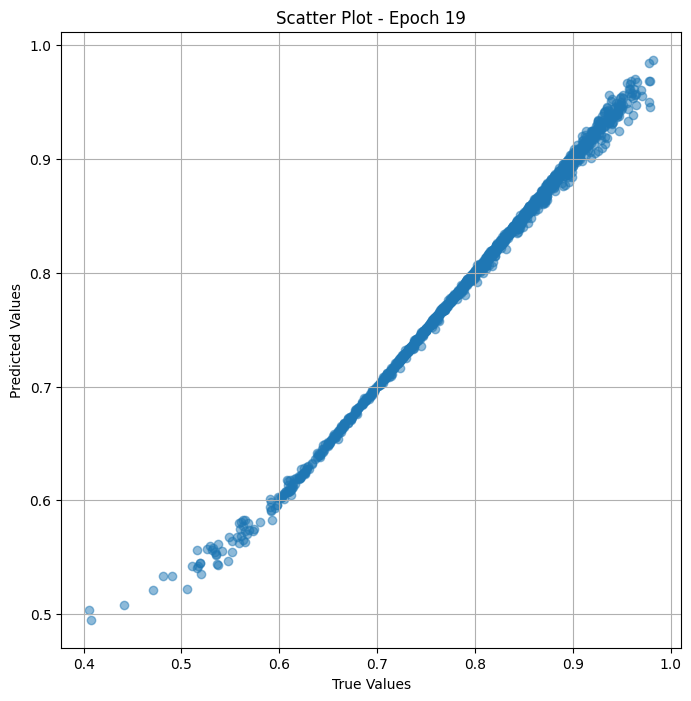

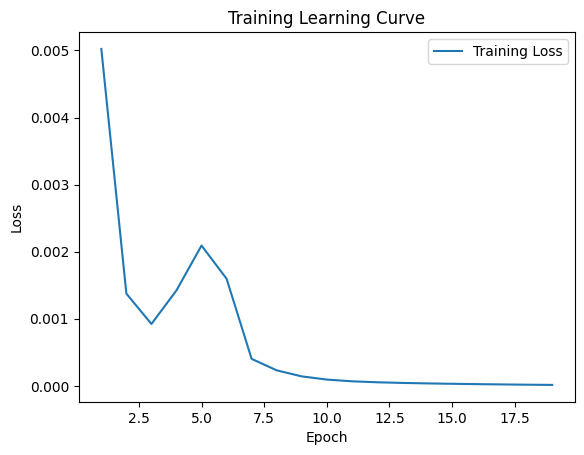


 Epoch: (20/20) Loss = 1.0428993846289814e-05

 Epoch: (20/20) Loss_rmse = 0.003229395253583789

 Epoch: (20/20) R^2 = 0.9963485598564148

 Epoch: (20/20) MAE = 0.0030813440680503845
Spearman correlation coefficient: SignificanceResult(statistic=0.9994597778774158, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.8111111, 0.8736842, 0.8811881, 0.79646015, 0.89215684, 0.8695652, 0.8453608, 0.8947368, 0.8712871, 0.8207547, 0.78846157, 0.8534483, 0.7619048, 0.71568626, 0.8913044, 0.96428573, 0.6132075, 0.77868855, 0.9583333, 0.91, 0.814433, 0.7383177, 0.60227275, 0.7641509, 0.8901099, 0.9259259, 0.6888889, 0.71681416, 0.75213677, 0.8235294, 0.7826087, 0.8137255, 0.60227275, 0.88235295, 0.9255319, 0.7105263, 0.8969072, 0.77, 0.6292135, 0.8108108, 0.83157897, 0.67, 0.8552632, 0.93457943, 0.75641024, 0.7916667, 0.7256637, 0.88461536, 0.9550562, 0.84042555, 0.6875, 0.7280702, 0.72164947, 0.79347825, 0.8446602, 0.64835167, 0.85, 0.752212

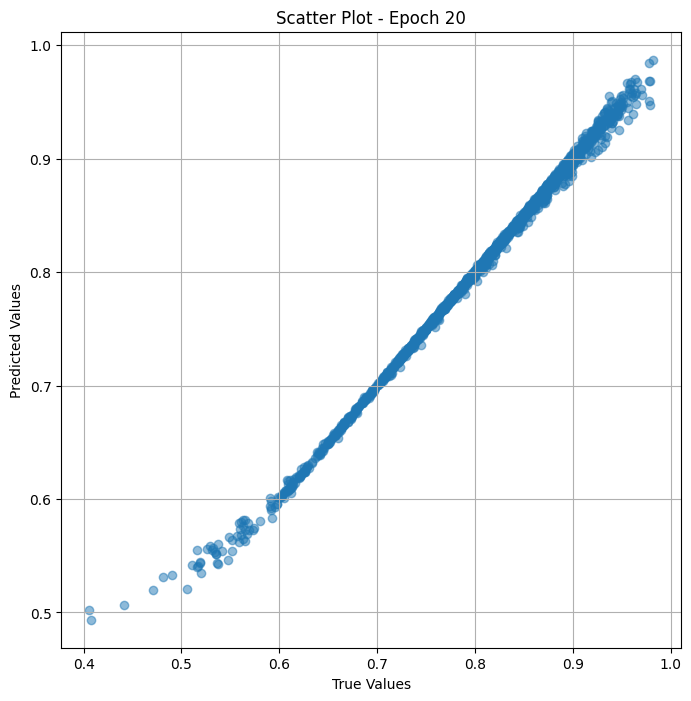

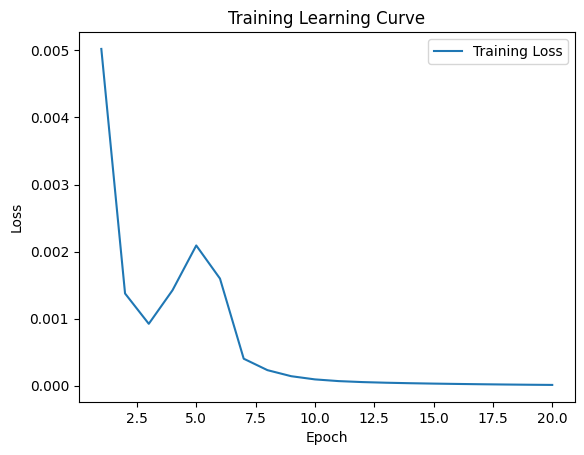

In [ ]:
# Training the model and save weights
fit(20,model_res_fine , train_dl_fine)
torch.save(model_res_fine.state_dict(), "model_weights_fine")

## valid

In [ ]:
params = [param for param in list(model_res_val .parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-4,weight_decay=1e-8)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Val Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res_val, val_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res_val.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in val_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res_val(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/30) Loss = 0.08653192967176437

 Epoch: (1/30) Loss_rmse = 0.2941631078720093

 Epoch: (1/30) R^2 = -17.48780059814453

 Epoch: (1/30) MAE = 0.2854398190975189
Spearman correlation coefficient: SignificanceResult(statistic=-0.23168539787890002, pvalue=0.023128459568327146)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965, 0.7

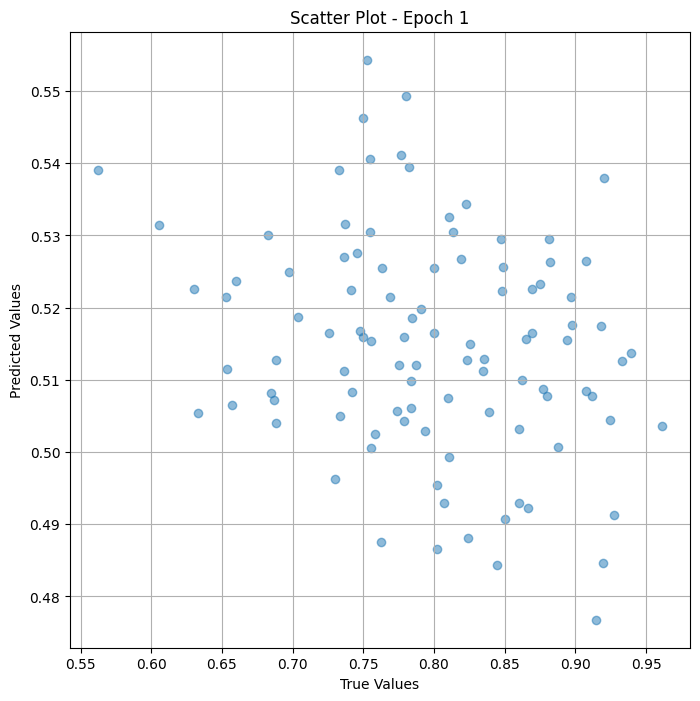

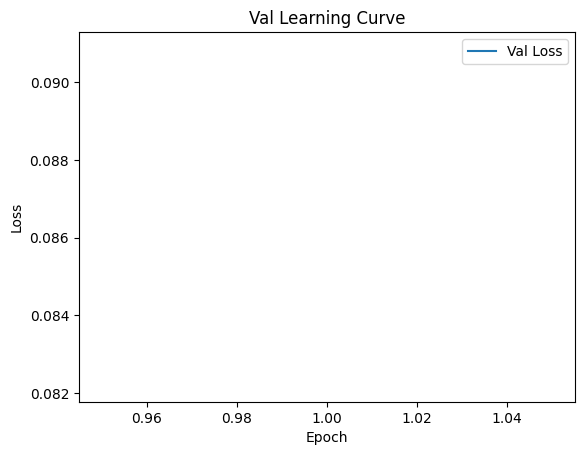


 Epoch: (2/30) Loss = 0.06282700598239899

 Epoch: (2/30) Loss_rmse = 0.25065314769744873

 Epoch: (2/30) R^2 = -12.423173904418945

 Epoch: (2/30) MAE = 0.24364039301872253
Spearman correlation coefficient: SignificanceResult(statistic=0.10579433929901587, pvalue=0.30495174094793015)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965, 0.

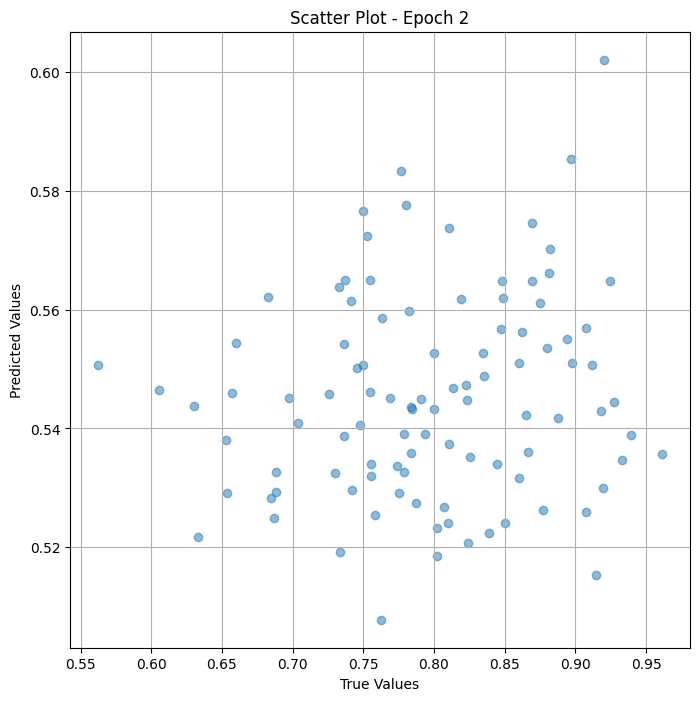

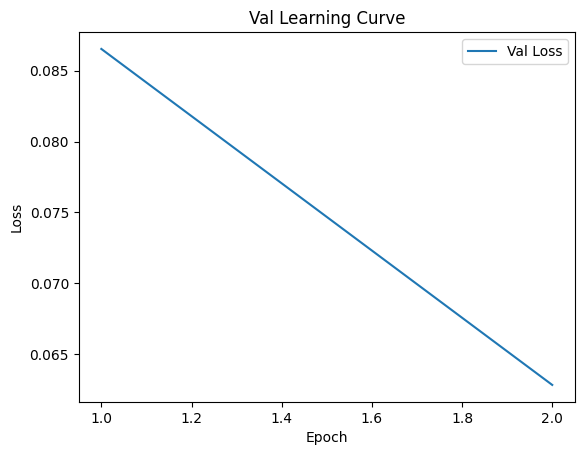


 Epoch: (3/30) Loss = 0.04678570479154587

 Epoch: (3/30) Loss_rmse = 0.21630004048347473

 Epoch: (3/30) R^2 = -8.995903015136719

 Epoch: (3/30) MAE = 0.21126830577850342
Spearman correlation coefficient: SignificanceResult(statistic=0.23906482095604642, pvalue=0.018986969648191368)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965, 0.

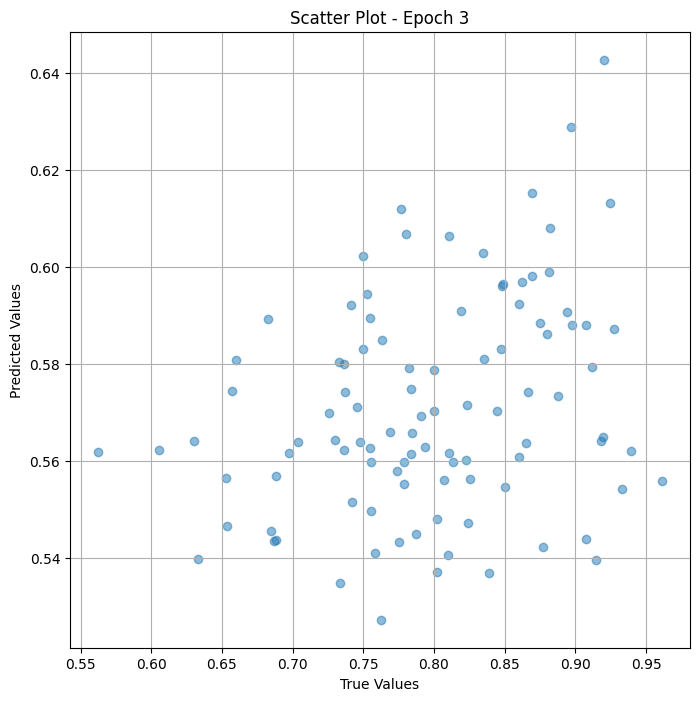

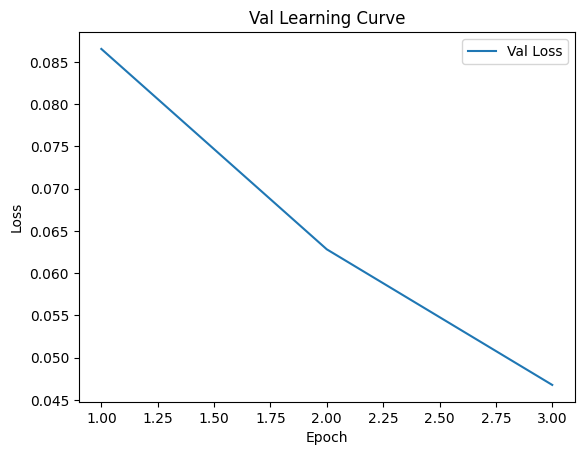


 Epoch: (4/30) Loss = 0.030809886753559113

 Epoch: (4/30) Loss_rmse = 0.1755274534225464

 Epoch: (4/30) R^2 = -5.582622528076172

 Epoch: (4/30) MAE = 0.17310425639152527
Spearman correlation coefficient: SignificanceResult(statistic=0.3564302041609554, pvalue=0.0003647483032687345)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965, 0.

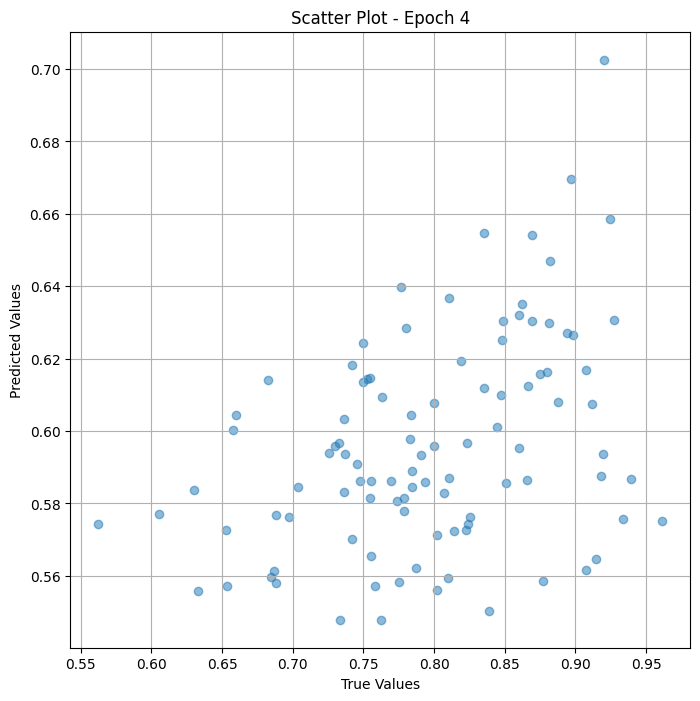

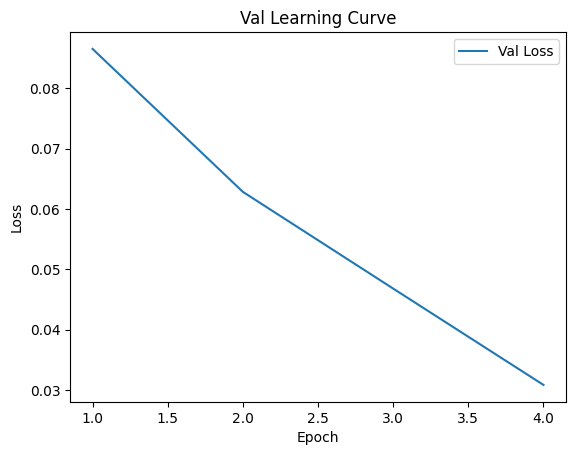


 Epoch: (5/30) Loss = 0.019313082098960876

 Epoch: (5/30) Loss_rmse = 0.13897152245044708

 Epoch: (5/30) R^2 = -3.1262965202331543

 Epoch: (5/30) MAE = 0.13768059015274048
Spearman correlation coefficient: SignificanceResult(statistic=0.4378276824227511, pvalue=8.159062871066183e-06)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965, 

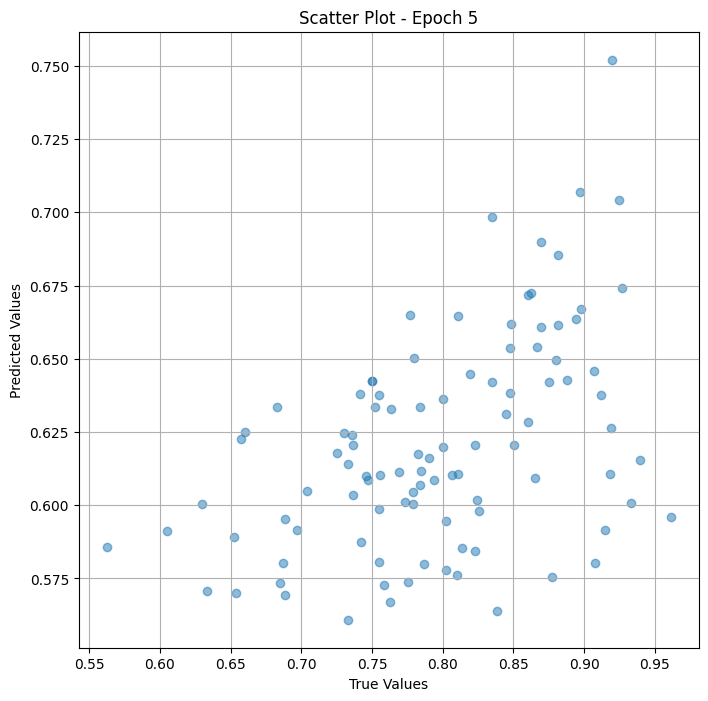

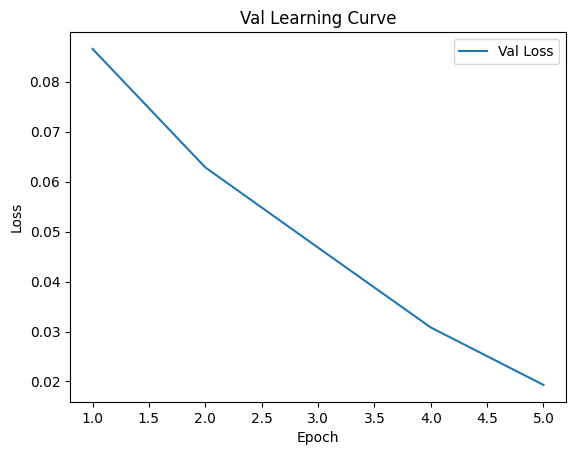


 Epoch: (6/30) Loss = 0.011423520743846893

 Epoch: (6/30) Loss_rmse = 0.10688087344169617

 Epoch: (6/30) R^2 = -1.4406685829162598

 Epoch: (6/30) MAE = 0.10614560544490814
Spearman correlation coefficient: SignificanceResult(statistic=0.5124629503831545, pvalue=9.4232050044118e-08)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965, 0.

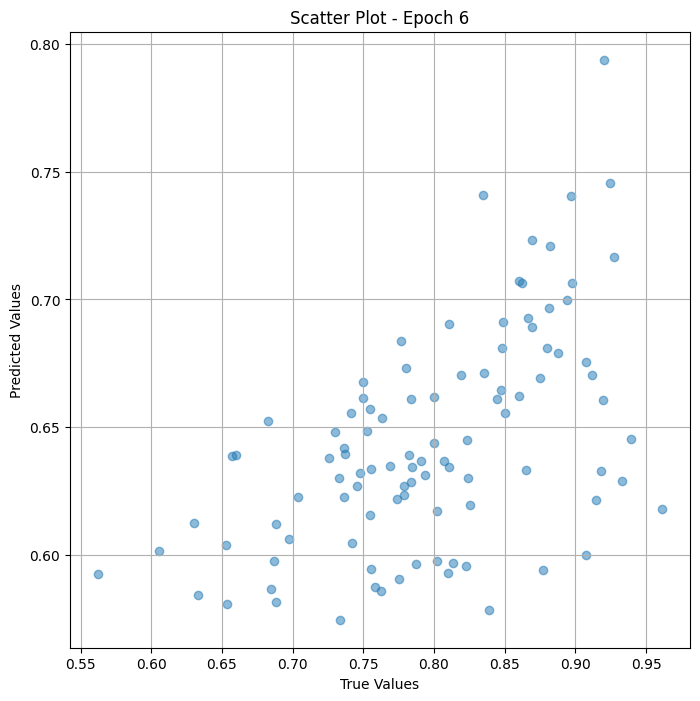

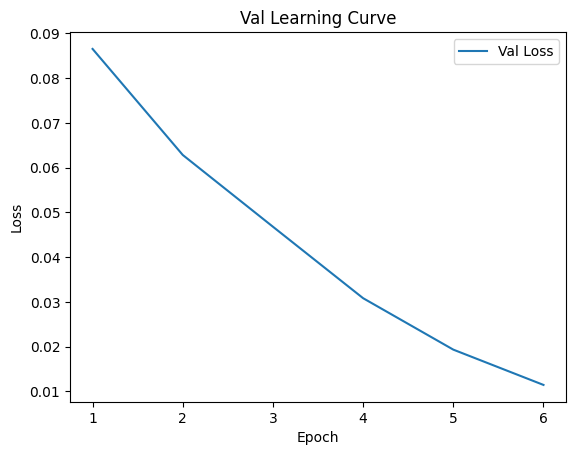


 Epoch: (7/30) Loss = 0.0064730457961559296

 Epoch: (7/30) Loss_rmse = 0.0804552435874939

 Epoch: (7/30) R^2 = -0.38298511505126953

 Epoch: (7/30) MAE = 0.07962928712368011
Spearman correlation coefficient: SignificanceResult(statistic=0.6043191330428911, pvalue=7.067978471074914e-11)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965,

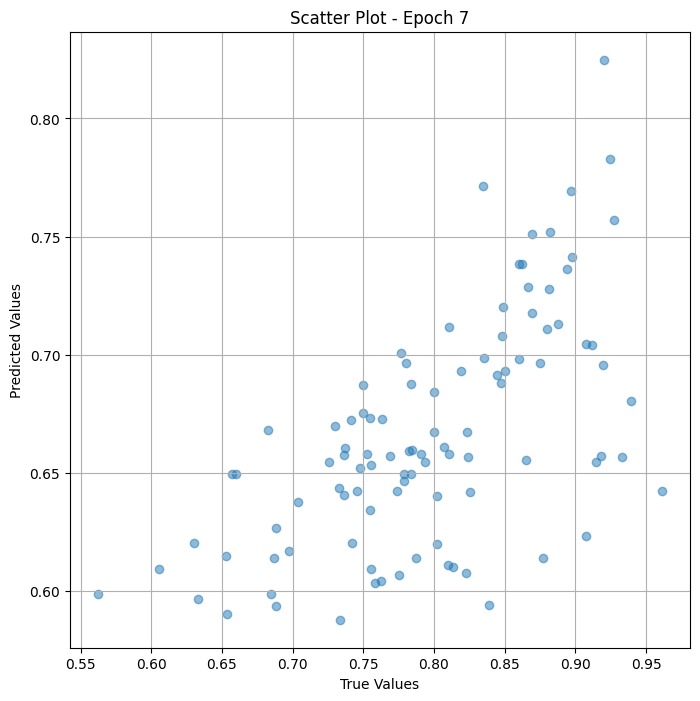

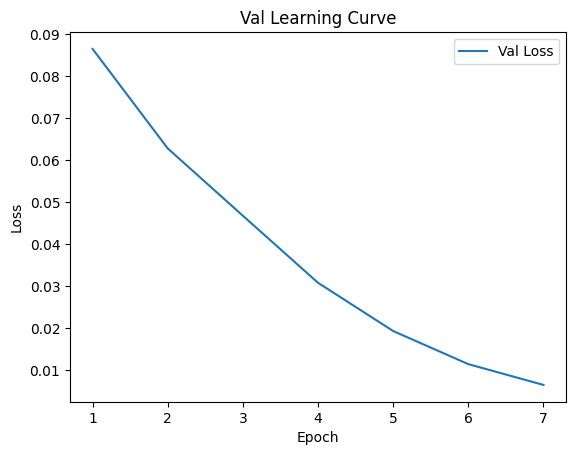


 Epoch: (8/30) Loss = 0.003324881661683321

 Epoch: (8/30) Loss_rmse = 0.057661786675453186

 Epoch: (8/30) R^2 = 0.28962934017181396

 Epoch: (8/30) MAE = 0.05686585605144501
Spearman correlation coefficient: SignificanceResult(statistic=0.6867272124430092, pvalue=1.1271415856090941e-14)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965

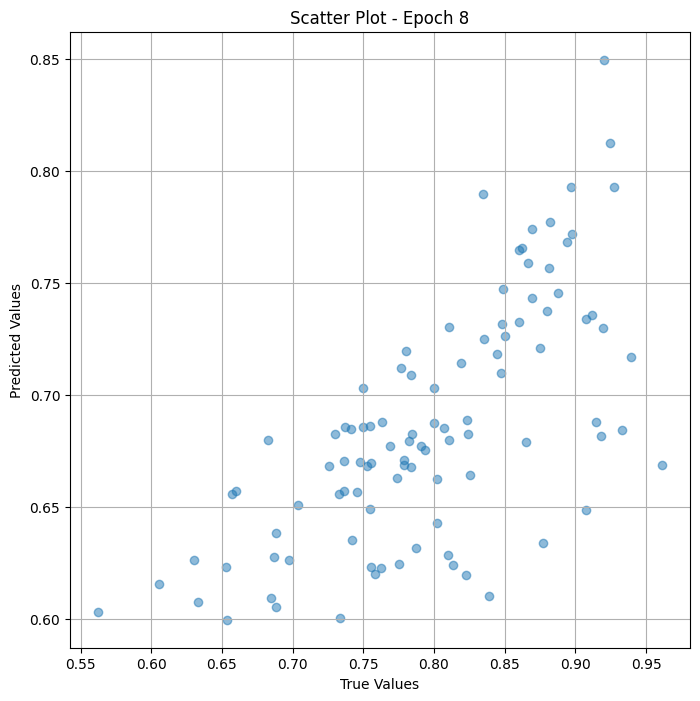

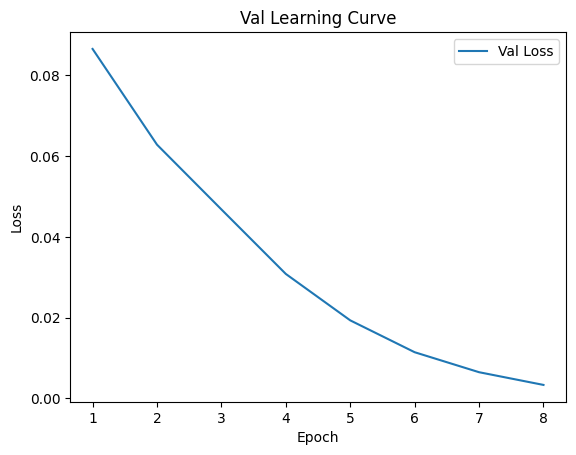


 Epoch: (9/30) Loss = 0.0015007487963885069

 Epoch: (9/30) Loss_rmse = 0.03873949870467186

 Epoch: (9/30) R^2 = 0.6793606281280518

 Epoch: (9/30) MAE = 0.037739694118499756
Spearman correlation coefficient: SignificanceResult(statistic=0.7601077071779785, pvalue=2.6990412619043084e-19)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870965

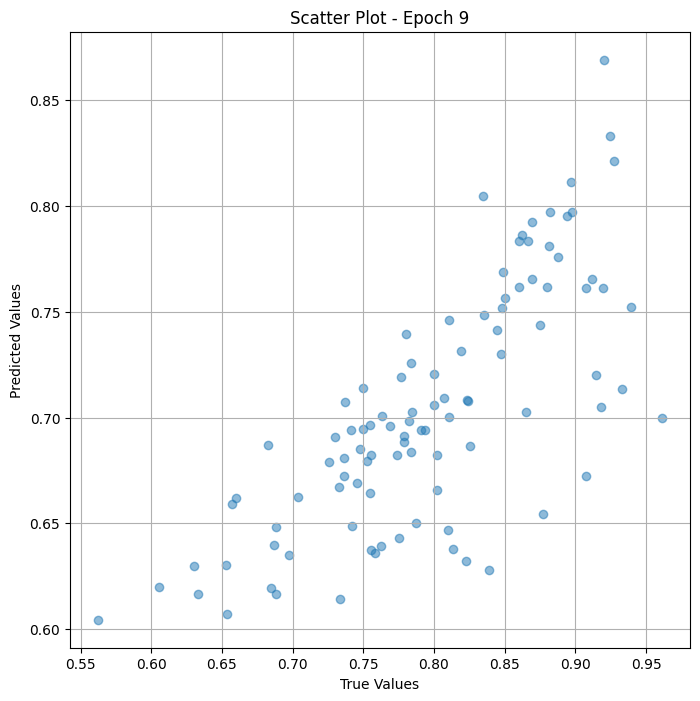

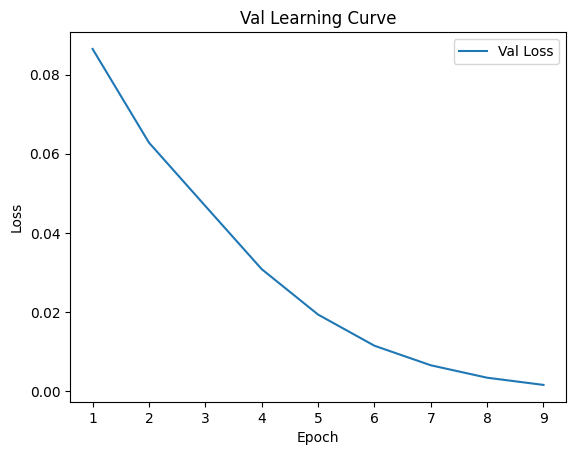


 Epoch: (10/30) Loss = 0.0005767620750702918

 Epoch: (10/30) Loss_rmse = 0.024015871807932854

 Epoch: (10/30) R^2 = 0.8767731189727783

 Epoch: (10/30) MAE = 0.022512182593345642
Spearman correlation coefficient: SignificanceResult(statistic=0.8132354837986473, pvalue=7.941468398880175e-24)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.8387

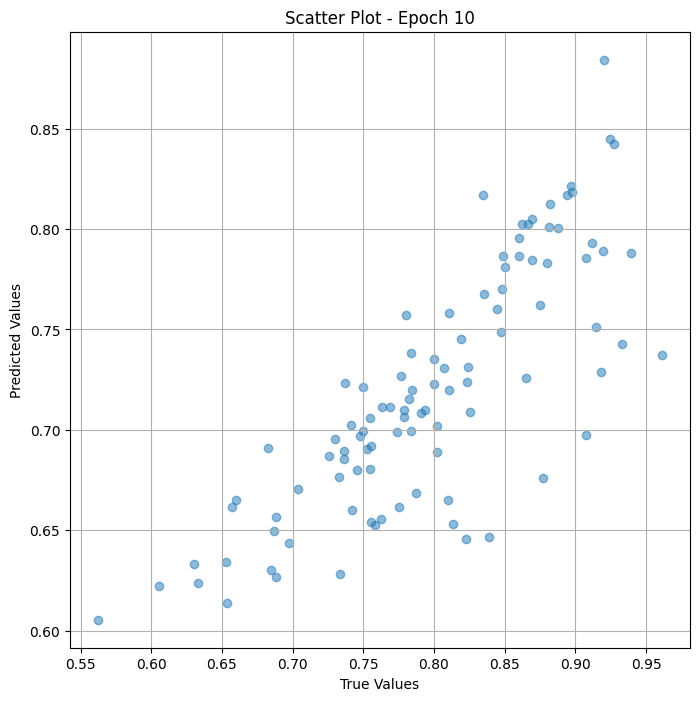

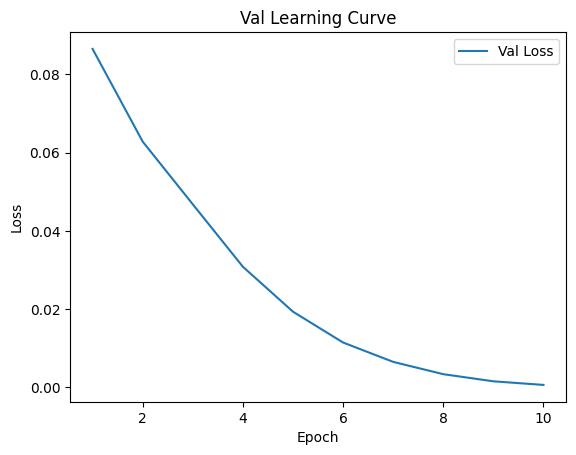


 Epoch: (11/30) Loss = 0.0001668096665525809

 Epoch: (11/30) Loss_rmse = 0.012915481813251972

 Epoch: (11/30) R^2 = 0.9643606543540955

 Epoch: (11/30) MAE = 0.01050896942615509
Spearman correlation coefficient: SignificanceResult(statistic=0.8615408616988647, pvalue=2.0114778267647223e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.8387

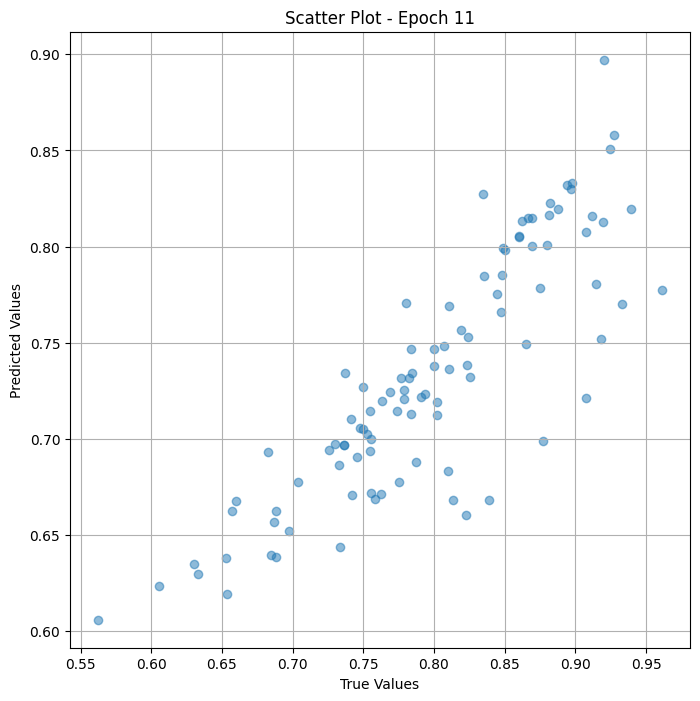

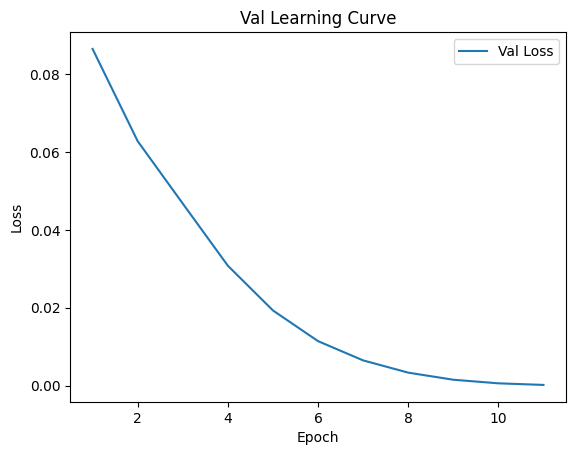


 Epoch: (12/30) Loss = 3.501494575175457e-05

 Epoch: (12/30) Loss_rmse = 0.005917342845350504

 Epoch: (12/30) R^2 = 0.992518961429596

 Epoch: (12/30) MAE = 0.004014566540718079
Spearman correlation coefficient: SignificanceResult(statistic=0.8959216480757535, pvalue=6.828778894726516e-35)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870

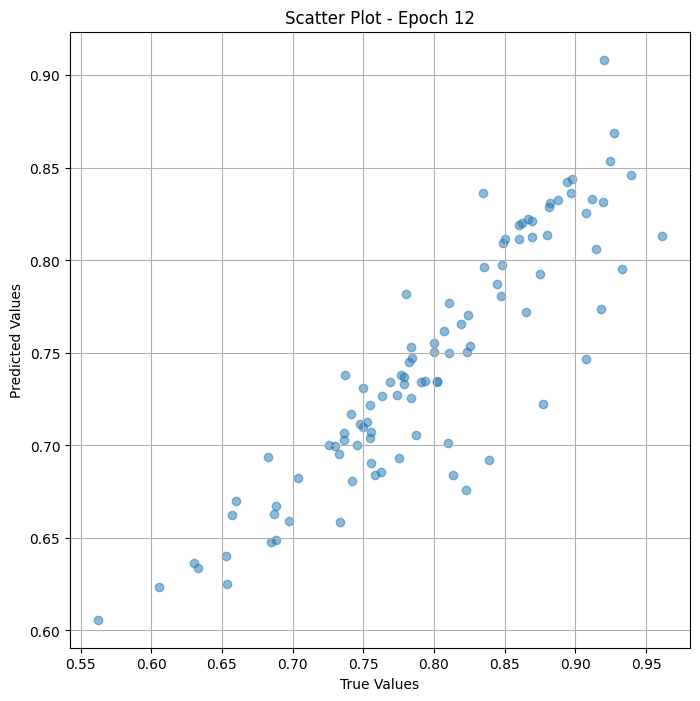

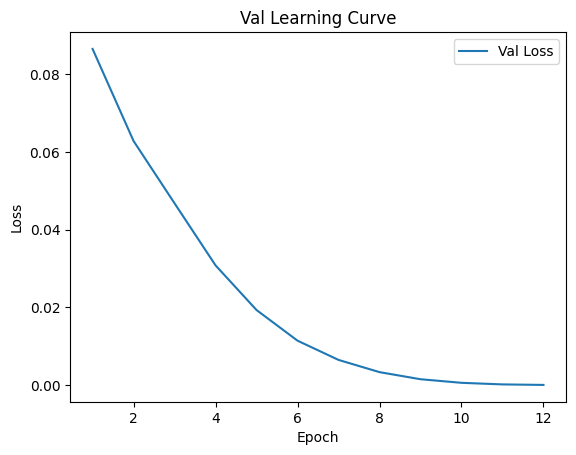


 Epoch: (13/30) Loss = 3.368394754943438e-05

 Epoch: (13/30) Loss_rmse = 0.005803787149488926

 Epoch: (13/30) R^2 = 0.9928033351898193

 Epoch: (13/30) MAE = 0.005083650350570679
Spearman correlation coefficient: SignificanceResult(statistic=0.9296377437710611, pvalue=1.540032740152582e-42)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.8387

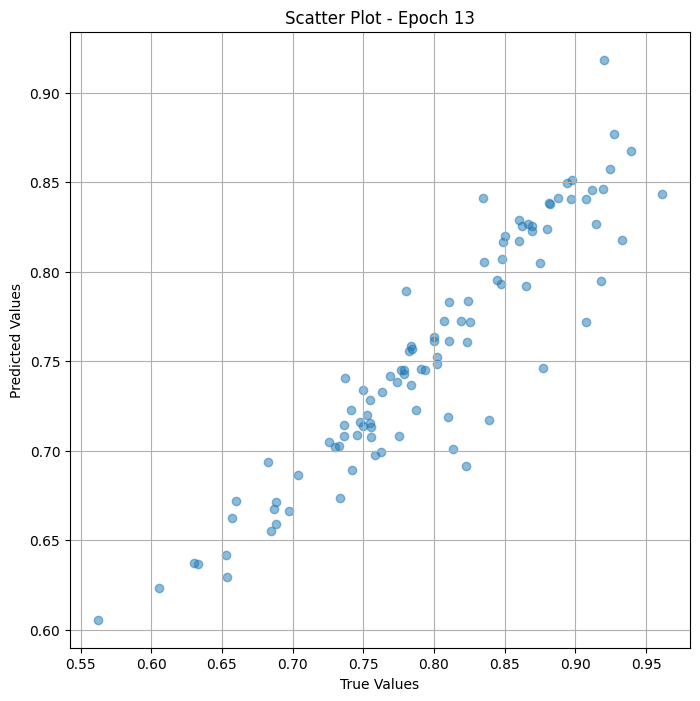

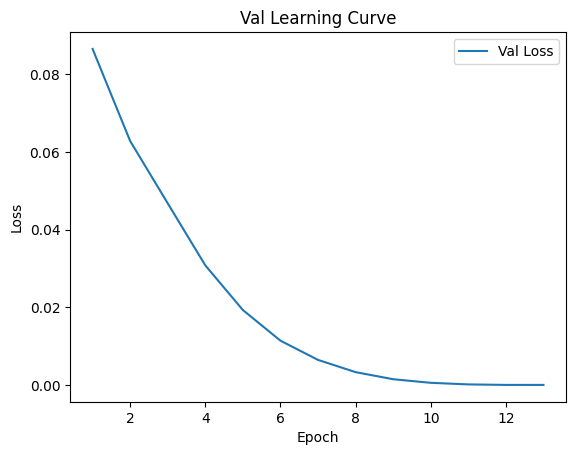


 Epoch: (14/30) Loss = 7.453819125657901e-05

 Epoch: (14/30) Loss_rmse = 0.008633550256490707

 Epoch: (14/30) R^2 = 0.9840747117996216

 Epoch: (14/30) MAE = 0.008222296833992004
Spearman correlation coefficient: SignificanceResult(statistic=0.9516674920748951, pvalue=5.541003502329947e-50)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.8387

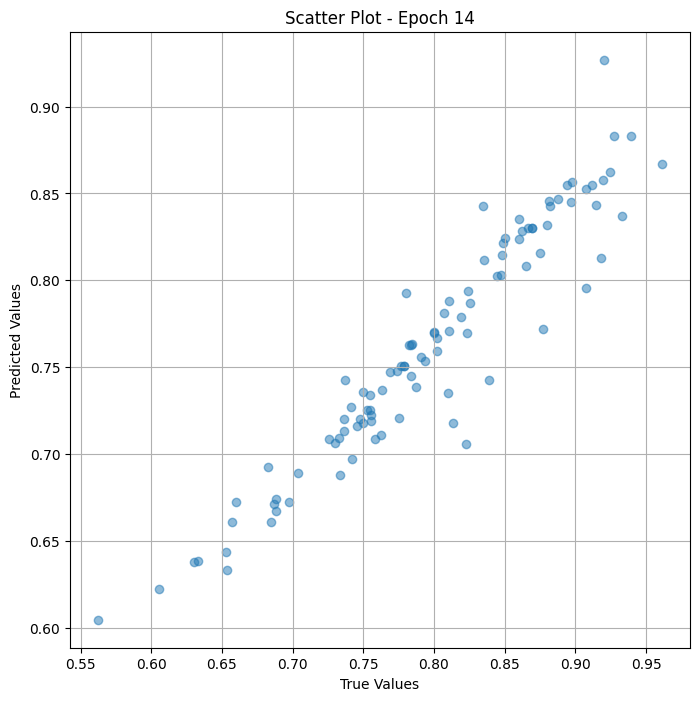

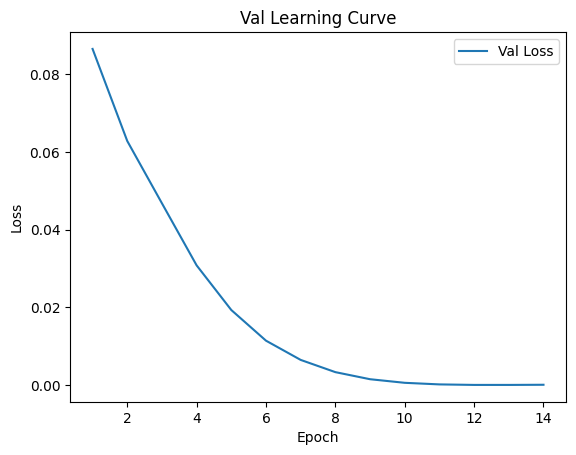


 Epoch: (15/30) Loss = 0.00011761463974835351

 Epoch: (15/30) Loss_rmse = 0.010845028795301914

 Epoch: (15/30) R^2 = 0.9748712778091431

 Epoch: (15/30) MAE = 0.01036912202835083
Spearman correlation coefficient: SignificanceResult(statistic=0.9672605928601521, pvalue=8.875723999037827e-58)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.8387

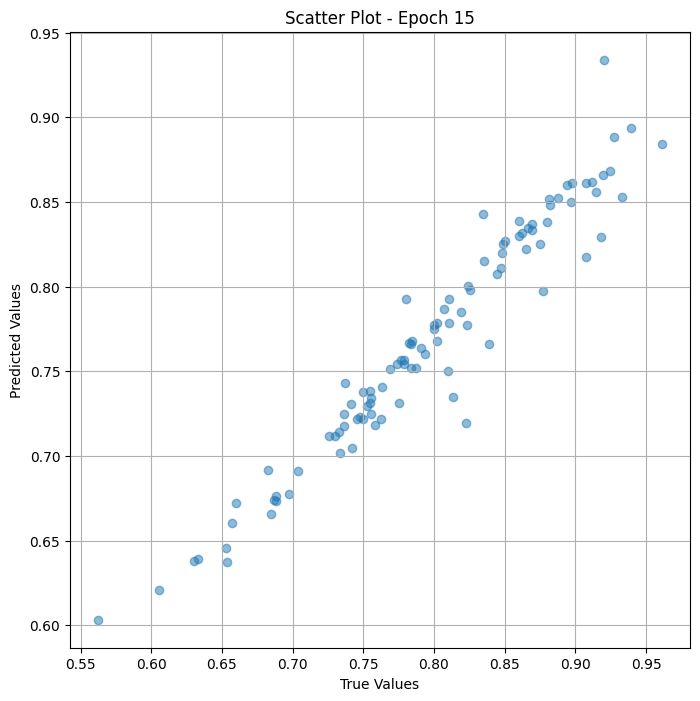

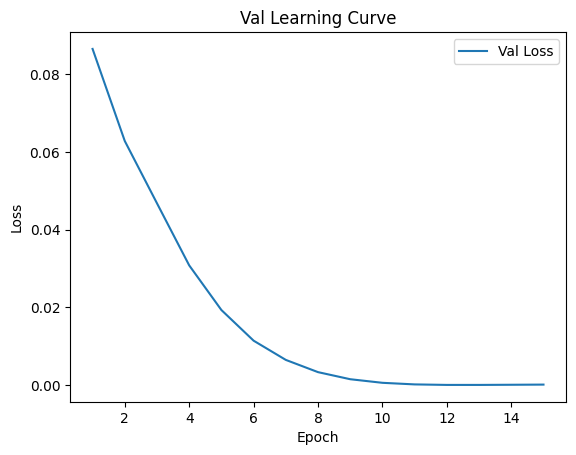

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (16/30) Loss = 0.00014979008119553328

 Epoch: (16/30) Loss_rmse = 0.012238875962793827

 Epoch: (16/30) R^2 = 0.9679968953132629

 Epoch: (16/30) MAE = 0.01100967824459076
Spearman correlation coefficient: SignificanceResult(statistic=0.9804458855641711, pvalue=3.61966730873294e-68)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316,

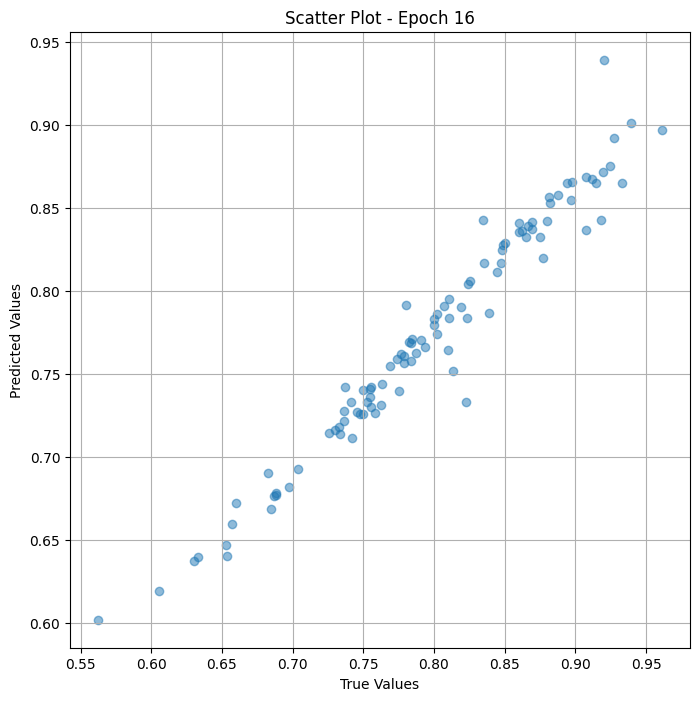

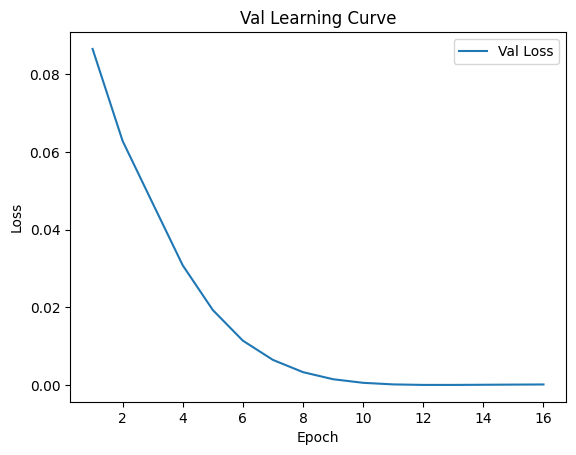


 Epoch: (17/30) Loss = 0.0001549148582853377

 Epoch: (17/30) Loss_rmse = 0.012446479871869087

 Epoch: (17/30) R^2 = 0.9669020175933838

 Epoch: (17/30) MAE = 0.010878399014472961
Spearman correlation coefficient: SignificanceResult(statistic=0.9883000876995897, pvalue=1.4205544749454048e-78)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.838

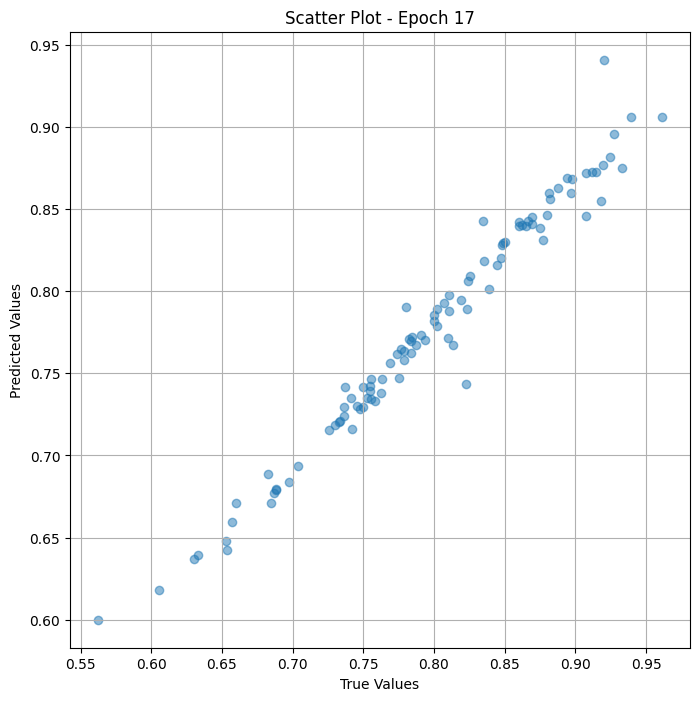

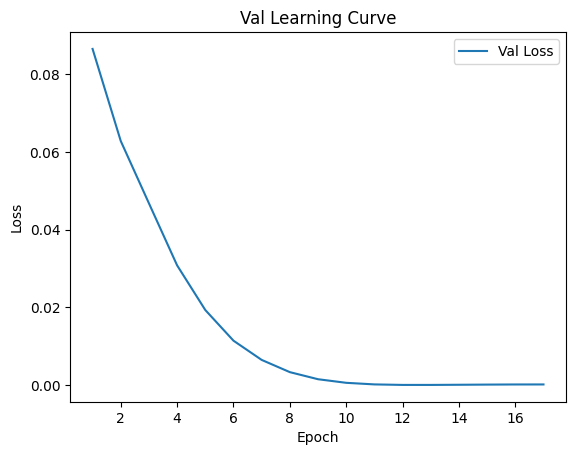


 Epoch: (18/30) Loss = 0.00015553667617496103

 Epoch: (18/30) Loss_rmse = 0.012471434660255909

 Epoch: (18/30) R^2 = 0.9667691588401794

 Epoch: (18/30) MAE = 0.010820060968399048
Spearman correlation coefficient: SignificanceResult(statistic=0.9886527807143062, pvalue=3.3974118165458056e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83

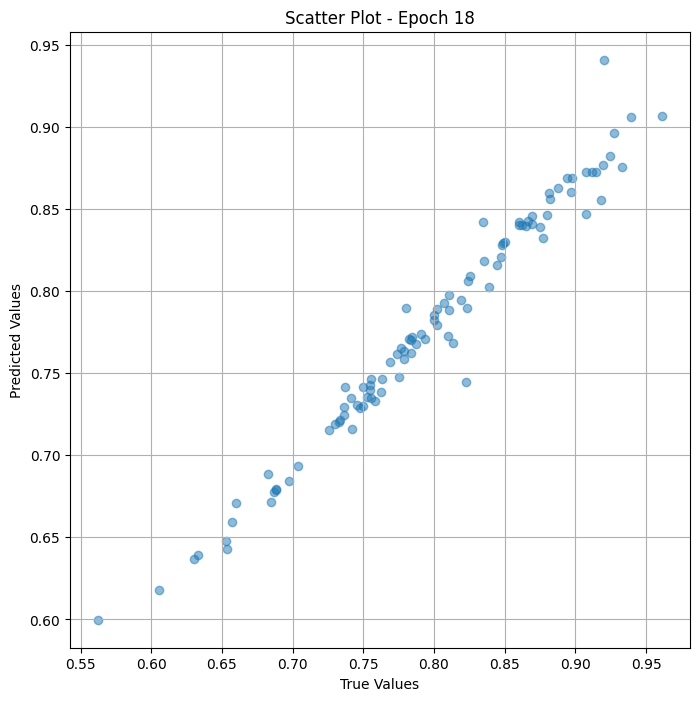

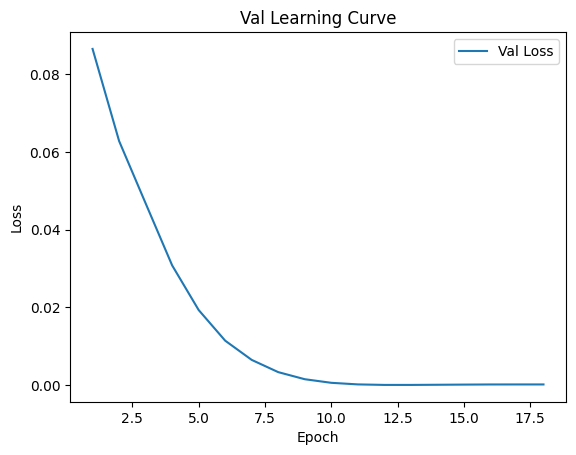

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (19/30) Loss = 0.0001551736204419285

 Epoch: (19/30) Loss_rmse = 0.012456870637834072

 Epoch: (19/30) R^2 = 0.9668467044830322

 Epoch: (19/30) MAE = 0.010734334588050842
Spearman correlation coefficient: SignificanceResult(statistic=0.9888019969897632, pvalue=1.8298638613654465e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.652631

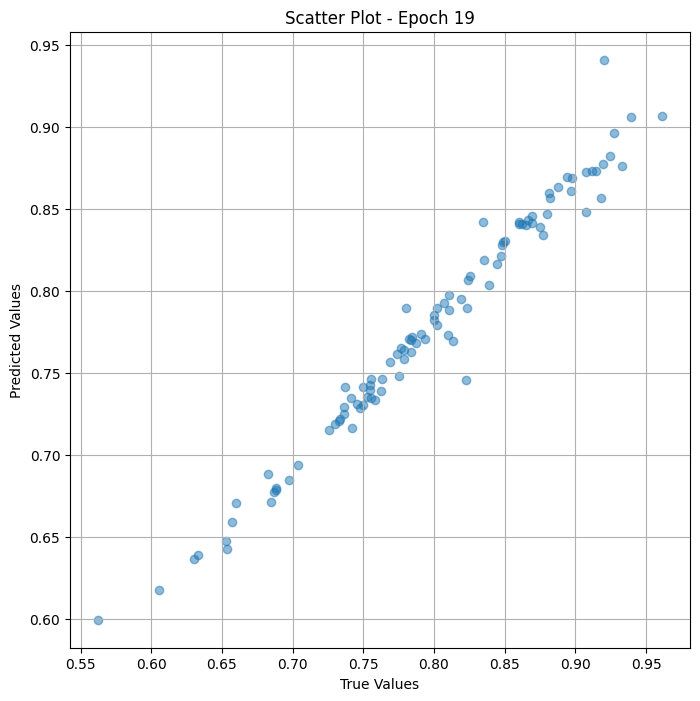

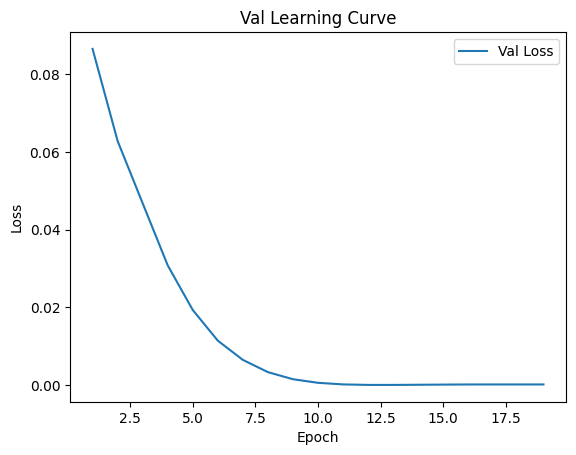


 Epoch: (20/30) Loss = 0.00015461115981452167

 Epoch: (20/30) Loss_rmse = 0.012434273958206177

 Epoch: (20/30) R^2 = 0.9669668674468994

 Epoch: (20/30) MAE = 0.01068870723247528
Spearman correlation coefficient: SignificanceResult(statistic=0.9899414667296167, pvalue=1.210994895346138e-81)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.8387

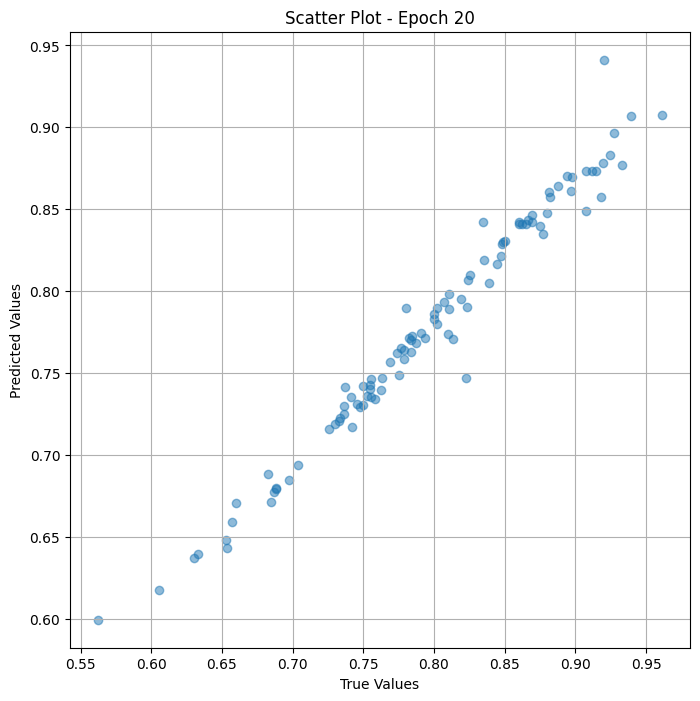

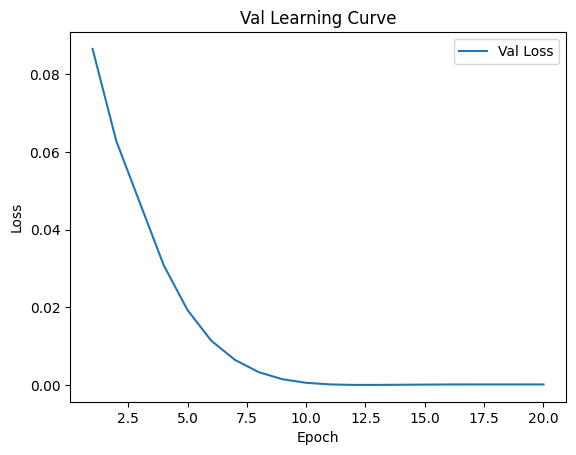


 Epoch: (21/30) Loss = 0.00015445472672581673

 Epoch: (21/30) Loss_rmse = 0.012427981942892075

 Epoch: (21/30) R^2 = 0.9670003056526184

 Epoch: (21/30) MAE = 0.010677069425582886
Spearman correlation coefficient: SignificanceResult(statistic=0.9899414667296167, pvalue=1.210994895346138e-81)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.838

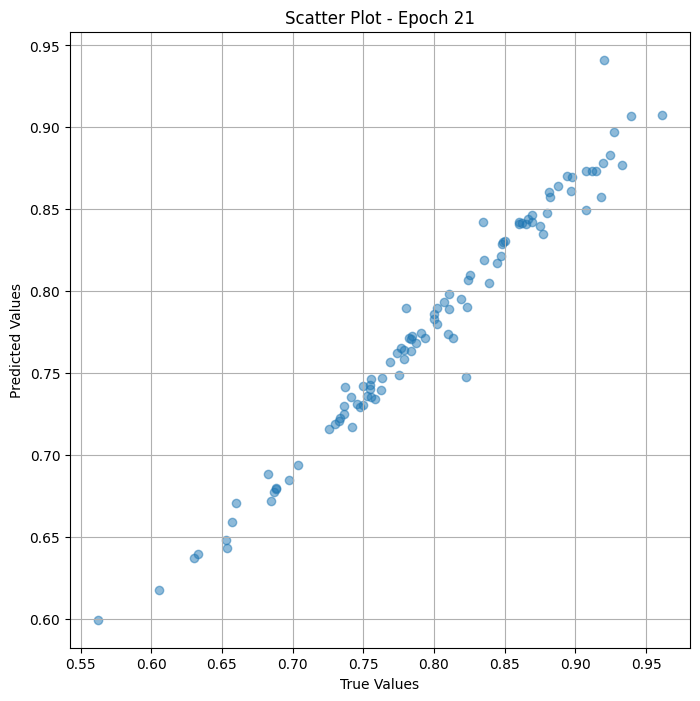

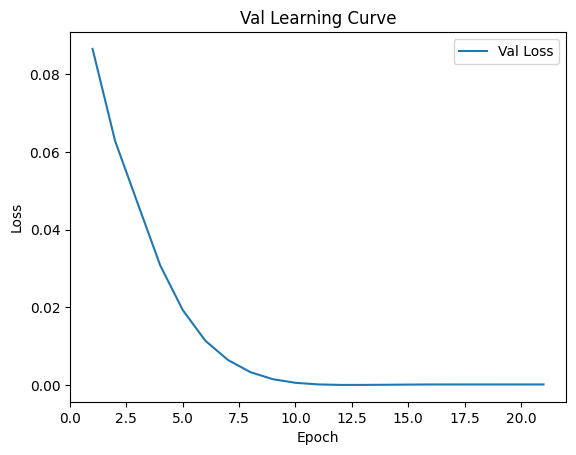

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (22/30) Loss = 0.00015426221943926066

 Epoch: (22/30) Loss_rmse = 0.012420234270393848

 Epoch: (22/30) R^2 = 0.9670414328575134

 Epoch: (22/30) MAE = 0.01066426932811737
Spearman correlation coefficient: SignificanceResult(statistic=0.9901449434688763, pvalue=4.655772735261774e-82)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316

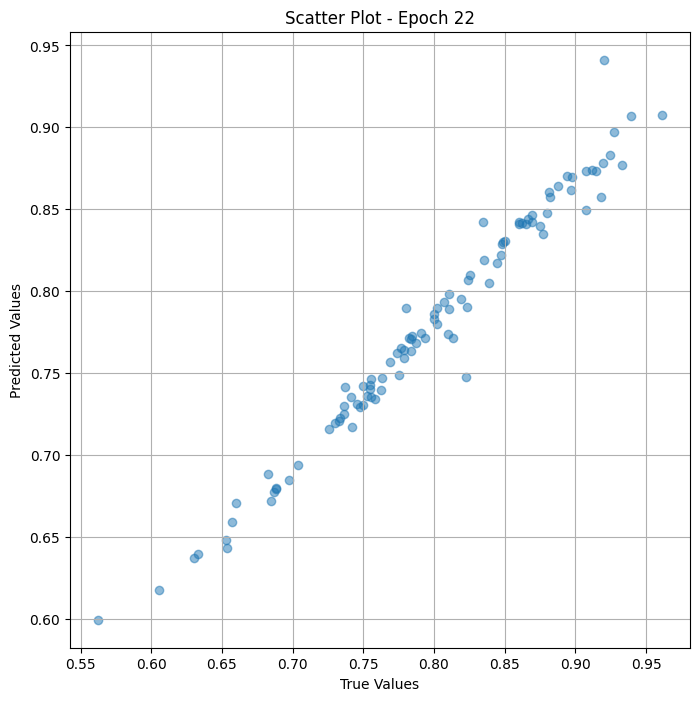

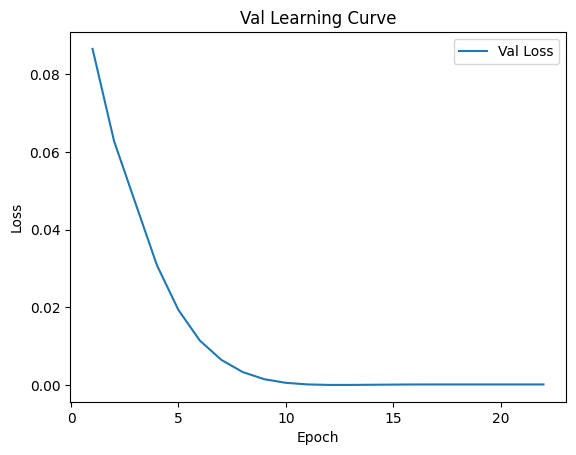


 Epoch: (23/30) Loss = 0.00015417039685416967

 Epoch: (23/30) Loss_rmse = 0.012416536919772625

 Epoch: (23/30) R^2 = 0.9670610427856445

 Epoch: (23/30) MAE = 0.01065872609615326
Spearman correlation coefficient: SignificanceResult(statistic=0.9901449434688763, pvalue=4.655772735261774e-82)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.8387

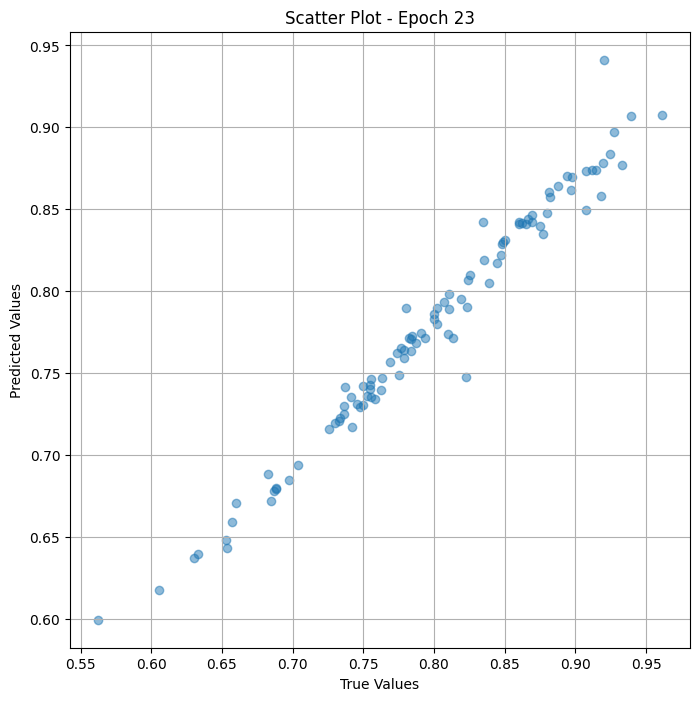

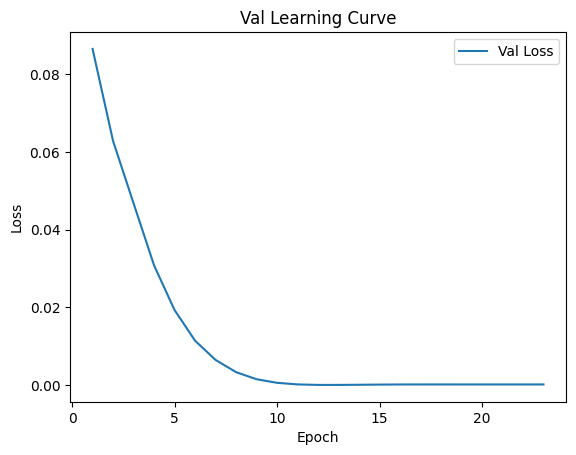


 Epoch: (24/30) Loss = 0.00015415475354529917

 Epoch: (24/30) Loss_rmse = 0.012415907345712185

 Epoch: (24/30) R^2 = 0.967064380645752

 Epoch: (24/30) MAE = 0.010657742619514465
Spearman correlation coefficient: SignificanceResult(statistic=0.9901449434688763, pvalue=4.655772735261774e-82)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.8387

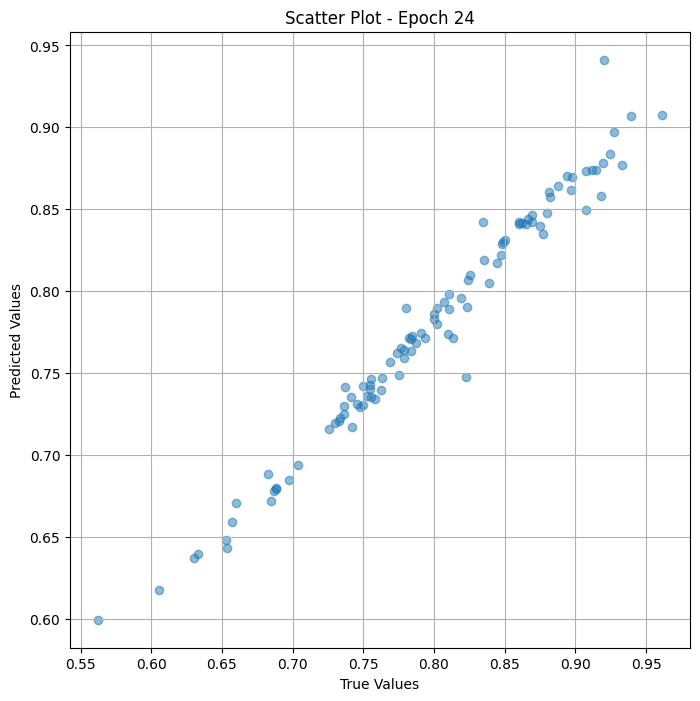

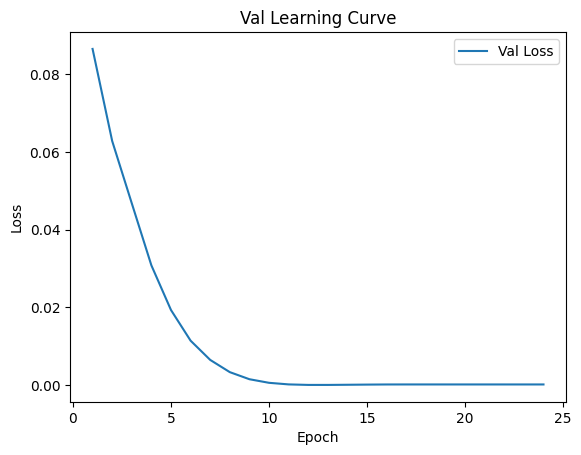

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (25/30) Loss = 0.00015413877554237843

 Epoch: (25/30) Loss_rmse = 0.012415263801813126

 Epoch: (25/30) R^2 = 0.9670677781105042

 Epoch: (25/30) MAE = 0.010656803846359253
Spearman correlation coefficient: SignificanceResult(statistic=0.9901449434688763, pvalue=4.655772735261774e-82)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.652631

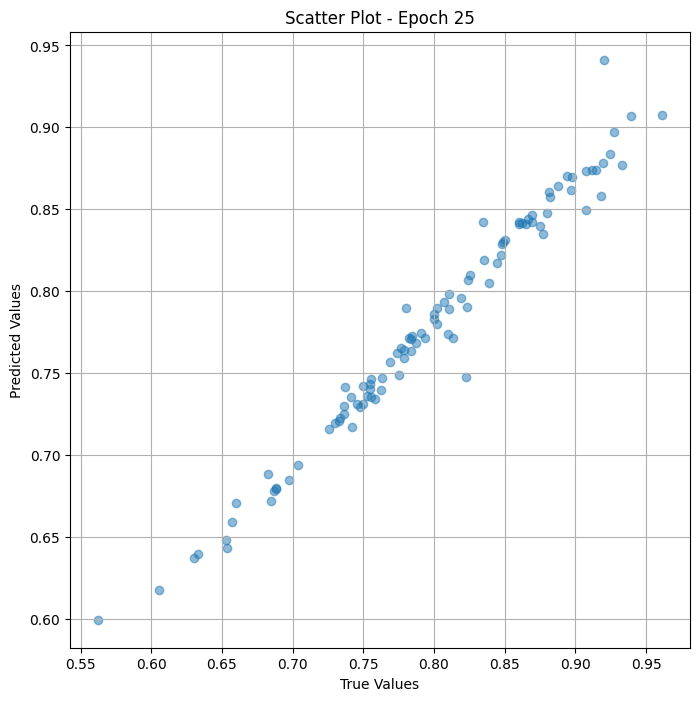

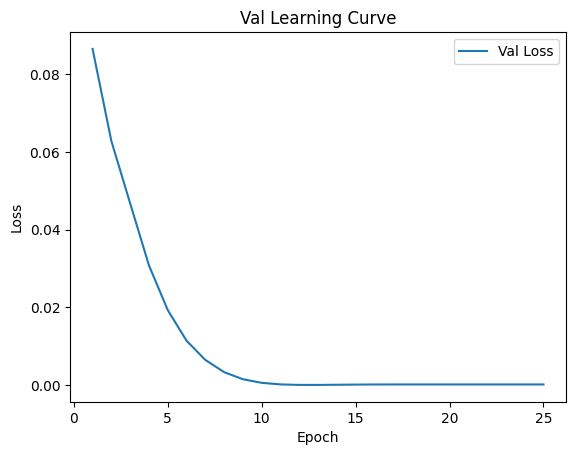


 Epoch: (26/30) Loss = 0.0001541343954158947

 Epoch: (26/30) Loss_rmse = 0.012415087781846523

 Epoch: (26/30) R^2 = 0.9670687317848206

 Epoch: (26/30) MAE = 0.010656565427780151
Spearman correlation coefficient: SignificanceResult(statistic=0.9901449434688763, pvalue=4.655772735261774e-82)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.8387

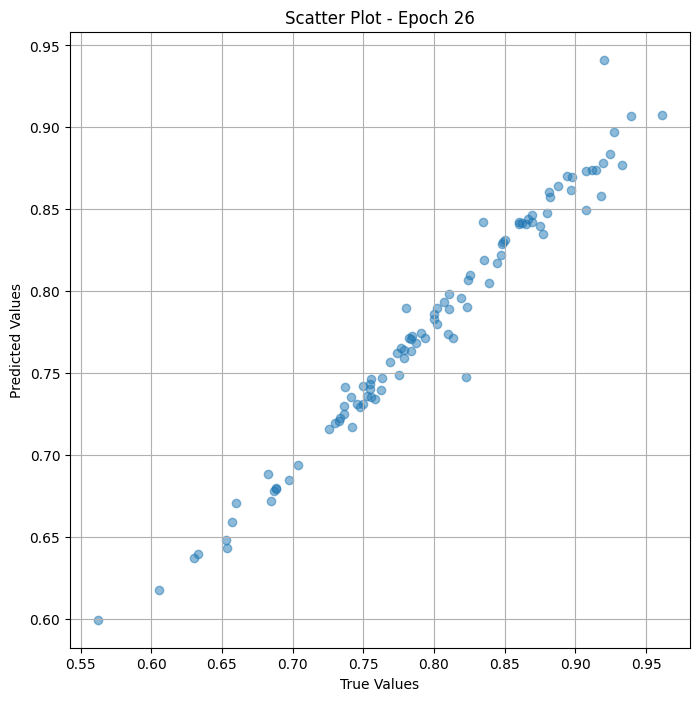

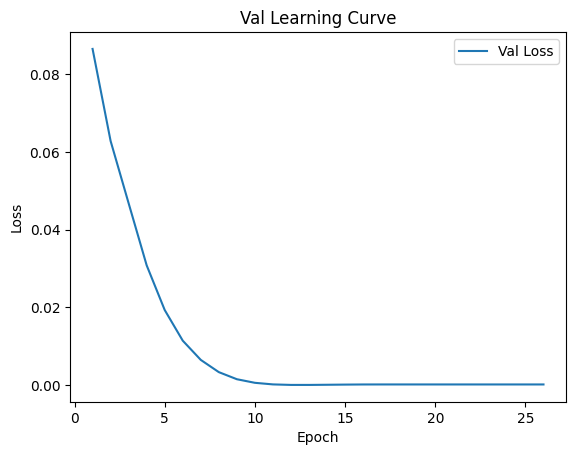


 Epoch: (27/30) Loss = 0.00015413649089168757

 Epoch: (27/30) Loss_rmse = 0.012415171600878239

 Epoch: (27/30) R^2 = 0.9670683145523071

 Epoch: (27/30) MAE = 0.010656684637069702
Spearman correlation coefficient: SignificanceResult(statistic=0.9901449434688763, pvalue=4.655772735261774e-82)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.838

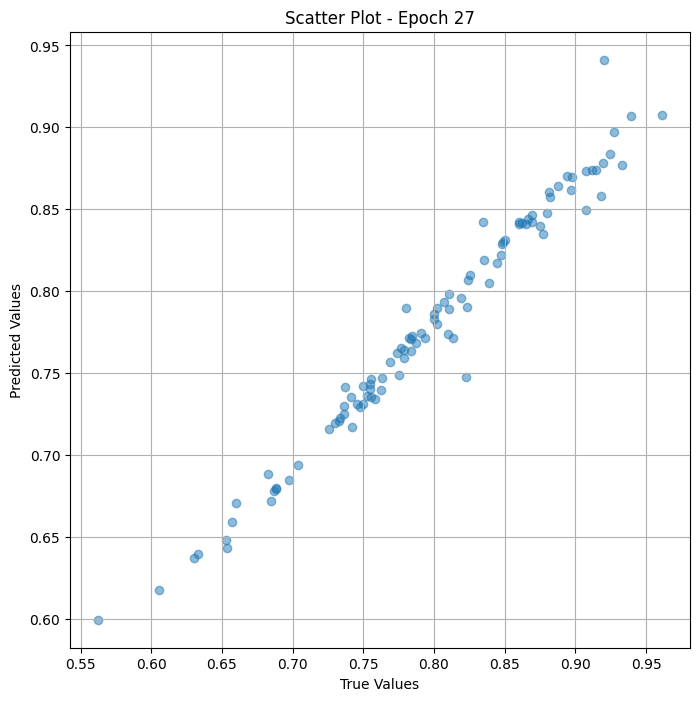

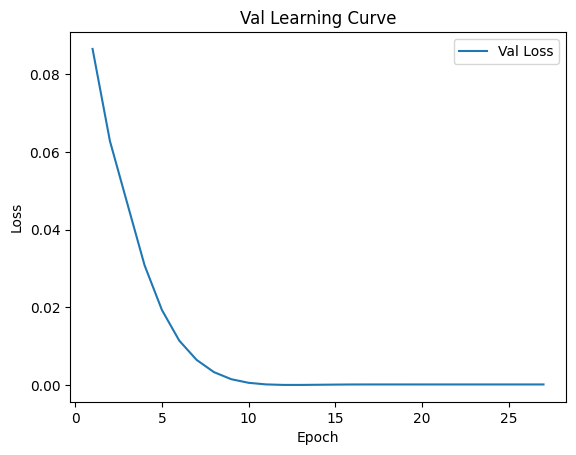


 Epoch: (28/30) Loss = 0.00015413726214319468

 Epoch: (28/30) Loss_rmse = 0.012415203265845776

 Epoch: (28/30) R^2 = 0.9670681357383728

 Epoch: (28/30) MAE = 0.01065671443939209
Spearman correlation coefficient: SignificanceResult(statistic=0.9901449434688763, pvalue=4.655772735261774e-82)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.8387

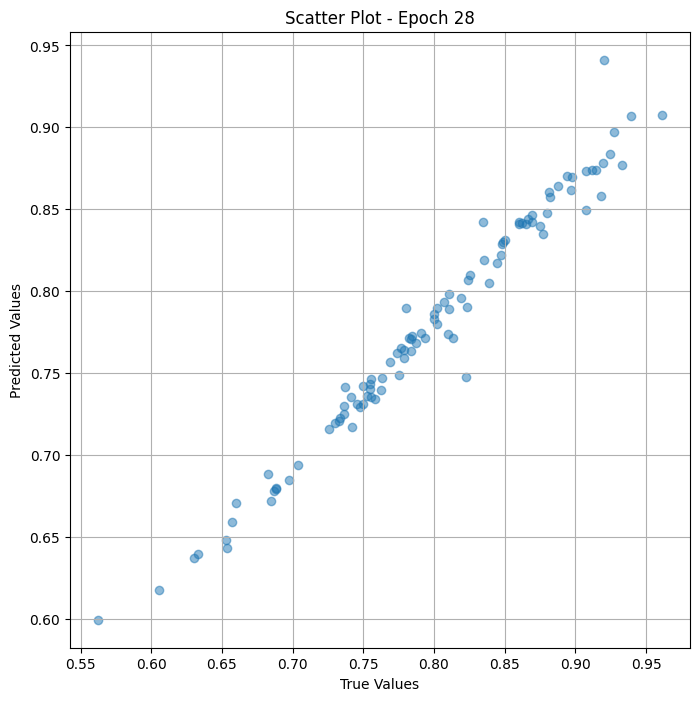

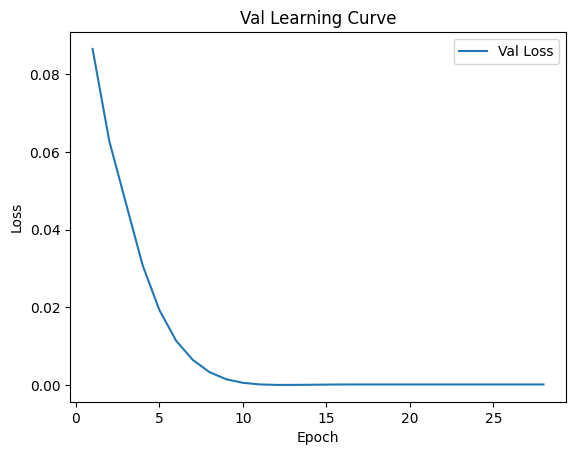


 Epoch: (29/30) Loss = 0.00015413854271173477

 Epoch: (29/30) Loss_rmse = 0.01241525448858738

 Epoch: (29/30) R^2 = 0.9670678377151489

 Epoch: (29/30) MAE = 0.010656803846359253
Spearman correlation coefficient: SignificanceResult(statistic=0.9901449434688763, pvalue=4.655772735261774e-82)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.8387

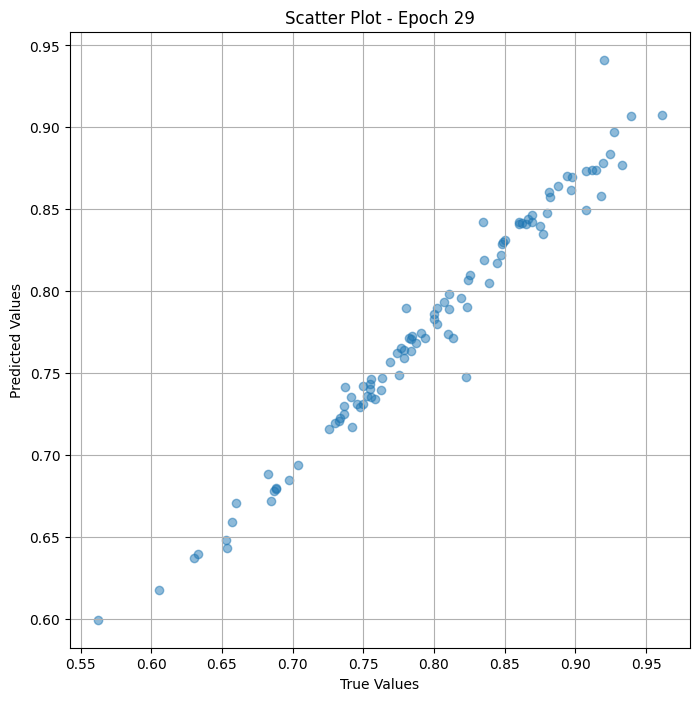

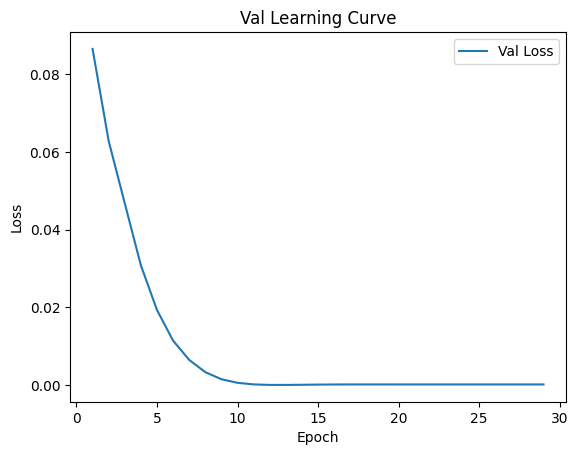


 Epoch: (30/30) Loss = 0.00015413996879942715

 Epoch: (30/30) Loss_rmse = 0.012415312230587006

 Epoch: (30/30) R^2 = 0.967067539691925

 Epoch: (30/30) MAE = 0.01065683364868164
Spearman correlation coefficient: SignificanceResult(statistic=0.9901449434688763, pvalue=4.655772735261774e-82)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8105263, 0.81914896, 0.78409094, 0.8137255, 0.9117647, 0.9191919, 0.9611651, 0.91463417, 0.8695652, 0.93333334, 0.9183673, 0.88, 0.7473684, 0.6847826, 0.8446602, 0.875, 0.6826923, 0.6052632, 0.75555557, 0.6333333, 0.82300884, 0.8969072, 0.77884614, 0.7582418, 0.68817204, 0.76344085, 0.79347825, 0.9245283, 0.8023256, 0.7755102, 0.75, 0.5625, 0.7826087, 0.74157304, 0.86238533, 0.7787611, 0.8811881, 0.74561405, 0.93939394, 0.9270833, 0.8942308, 0.8227848, 0.8877551, 0.73636365, 0.65346533, 0.736, 0.6574074, 0.77678573, 0.86538464, 0.742268, 0.6526316, 0.76237625, 0.75510204, 0.66, 0.82417583, 0.8105263, 0.83870

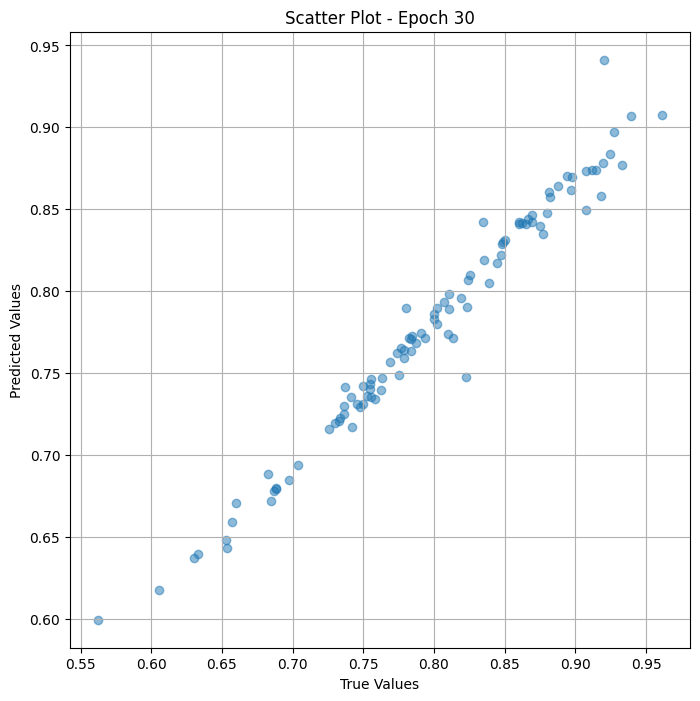

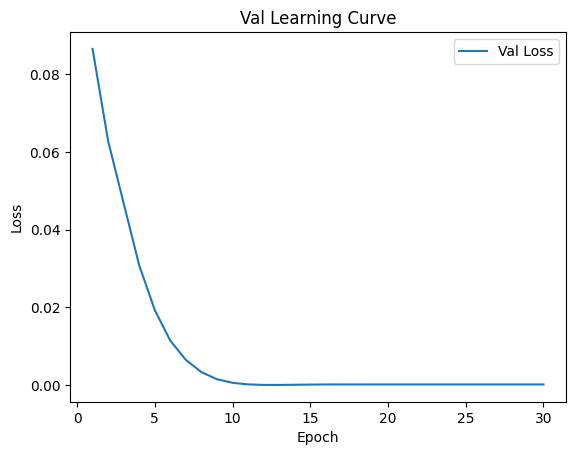

In [ ]:
# val the model and save weights
fit(30, model_res_val  , val_dl )
torch.save(model_res_val.state_dict(), "model_weights_s")

## Test

In [ ]:
params = [param for param in list(model_res_test.parameters()) if param.requires_grad == True ]
optimizer = torch.optim.Adam(params, lr=1e-4 ,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res_test, test_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in test_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res_test(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/30) Loss = 0.06392620503902435

 Epoch: (1/30) Loss_rmse = 0.25283631682395935

 Epoch: (1/30) R^2 = -38.08742141723633

 Epoch: (1/30) MAE = 0.25043338537216187
Spearman correlation coefficient: SignificanceResult(statistic=0.09264233102223779, pvalue=0.36931995089273373)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.7263158, 

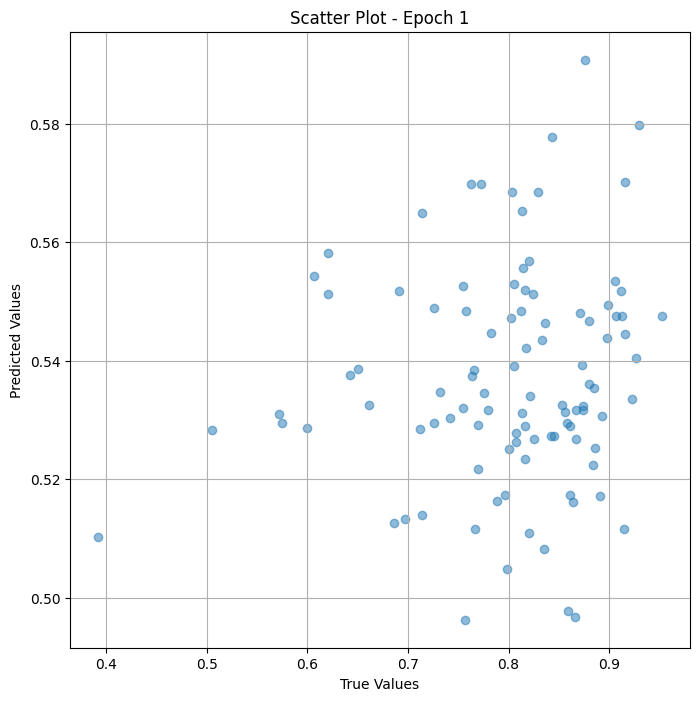

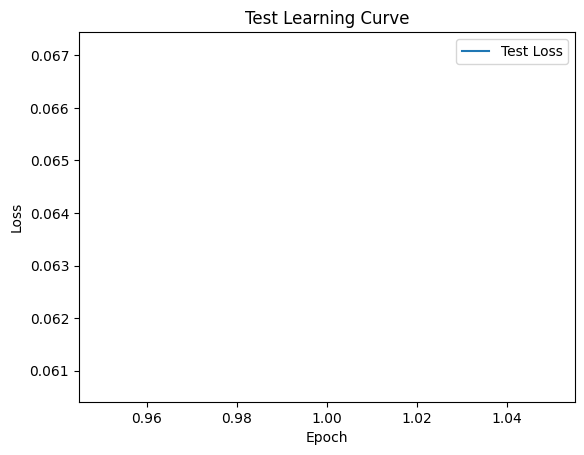


 Epoch: (2/30) Loss = 0.029795141890645027

 Epoch: (2/30) Loss_rmse = 0.17261269688606262

 Epoch: (2/30) R^2 = -17.21811866760254

 Epoch: (2/30) MAE = 0.16725412011146545
Spearman correlation coefficient: SignificanceResult(statistic=-0.05756996161627897, pvalue=0.5774307502818786)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.7263158,

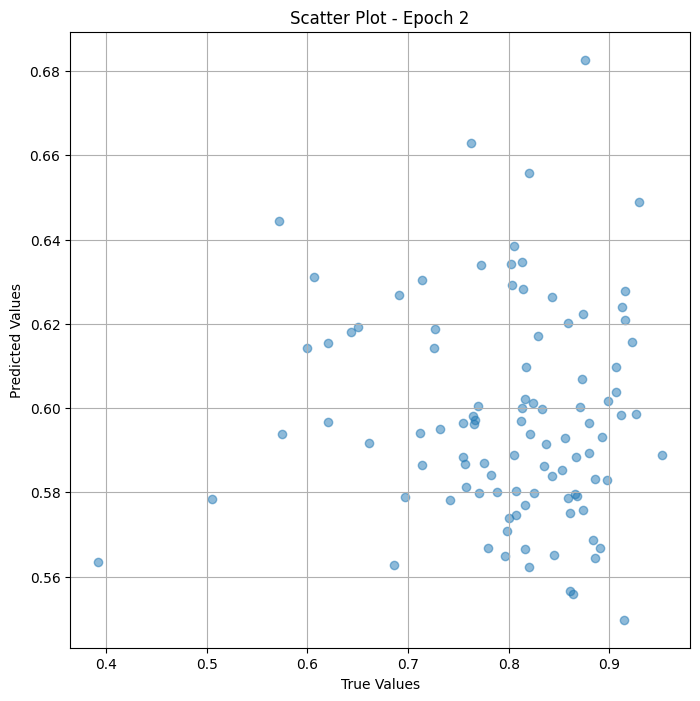

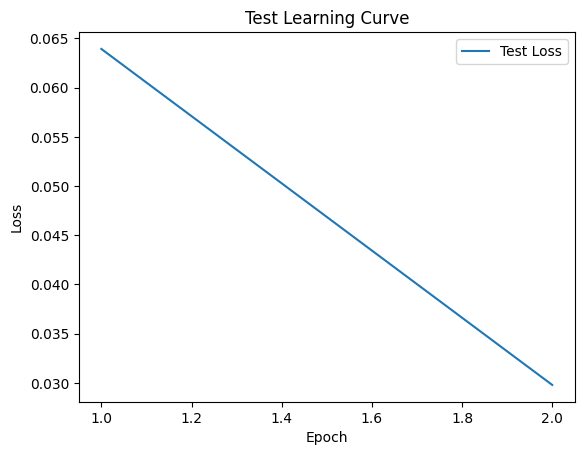


 Epoch: (3/30) Loss = 0.007996050640940666

 Epoch: (3/30) Loss_rmse = 0.08942063897848129

 Epoch: (3/30) R^2 = -3.889153003692627

 Epoch: (3/30) MAE = 0.07863420248031616
Spearman correlation coefficient: SignificanceResult(statistic=-0.11399367870933089, pvalue=0.26877680209577903)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.7263158

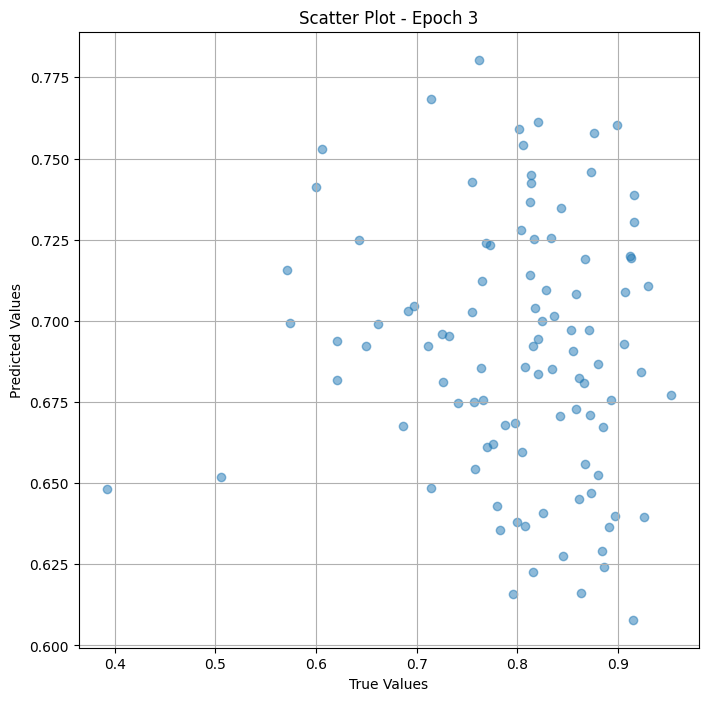

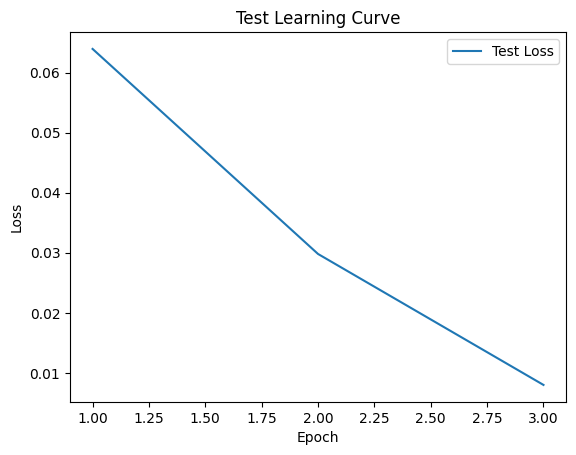


 Epoch: (4/30) Loss = 0.0020388017874211073

 Epoch: (4/30) Loss_rmse = 0.045153092592954636

 Epoch: (4/30) R^2 = -0.24661707878112793

 Epoch: (4/30) MAE = 0.034881770610809326
Spearman correlation coefficient: SignificanceResult(statistic=0.05115370529099623, pvalue=0.6206278954521491)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.7263

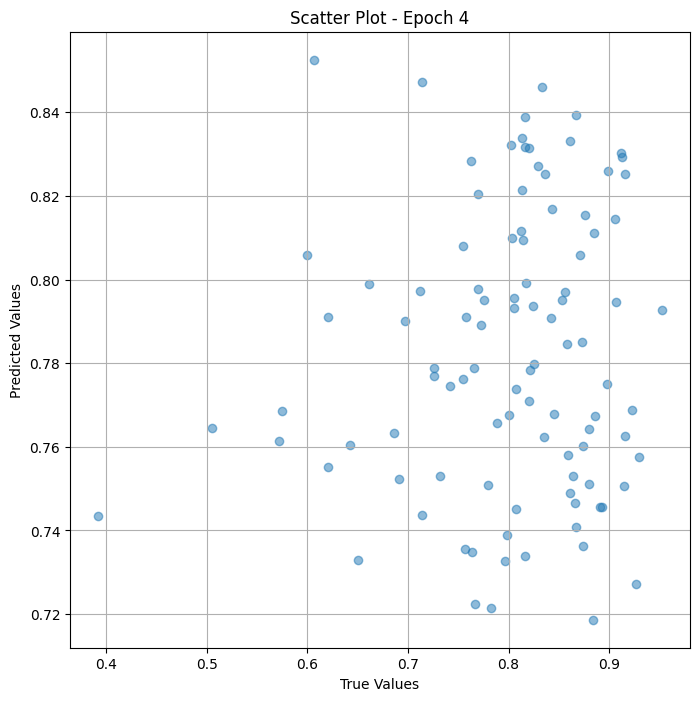

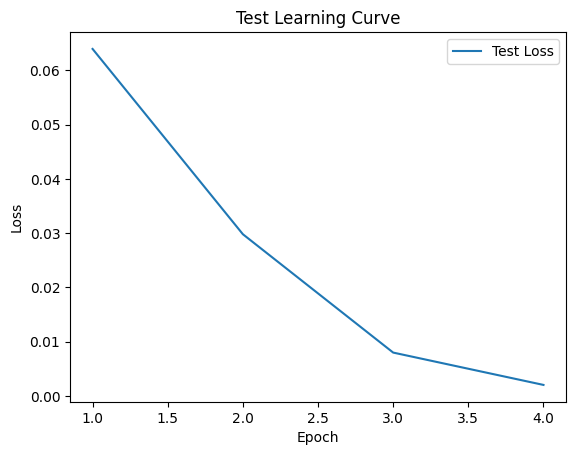


 Epoch: (5/30) Loss = 0.0018059763824567199

 Epoch: (5/30) Loss_rmse = 0.042496781796216965

 Epoch: (5/30) R^2 = -0.10425698757171631

 Epoch: (5/30) MAE = 0.03929939866065979
Spearman correlation coefficient: SignificanceResult(statistic=0.39329752170631105, pvalue=7.369753506858544e-05)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.72

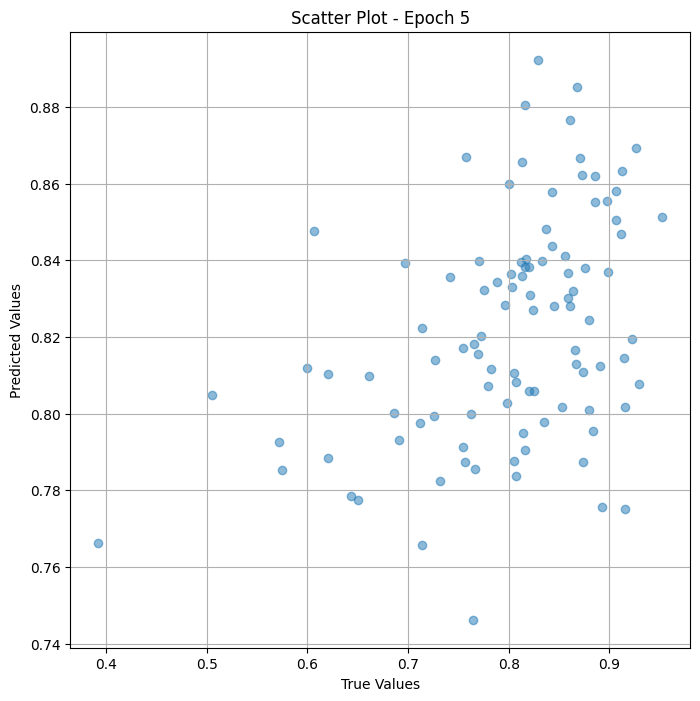

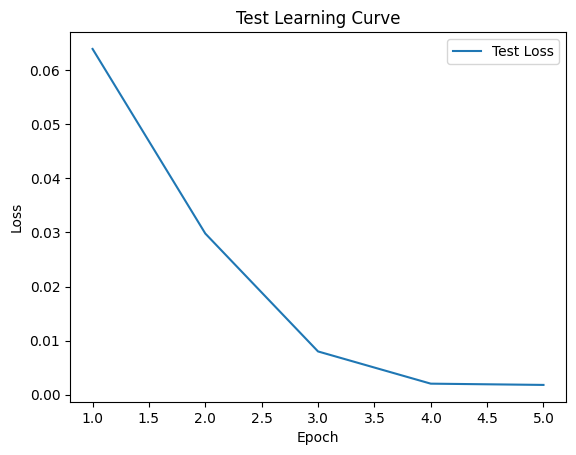


 Epoch: (6/30) Loss = 0.0013160177040845156

 Epoch: (6/30) Loss_rmse = 0.036276958882808685

 Epoch: (6/30) R^2 = 0.19532626867294312

 Epoch: (6/30) MAE = 0.03431732952594757
Spearman correlation coefficient: SignificanceResult(statistic=0.48737774526656147, pvalue=4.7549415059736887e-07)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.72

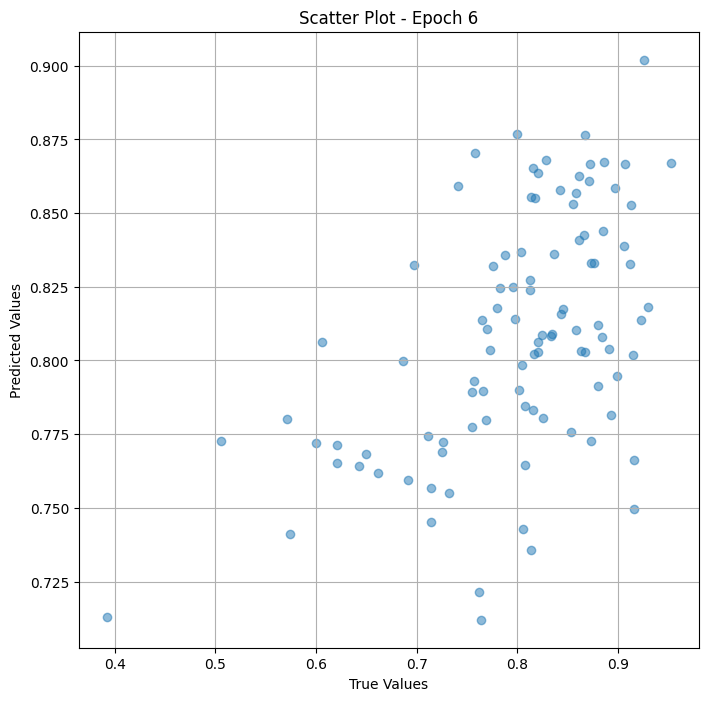

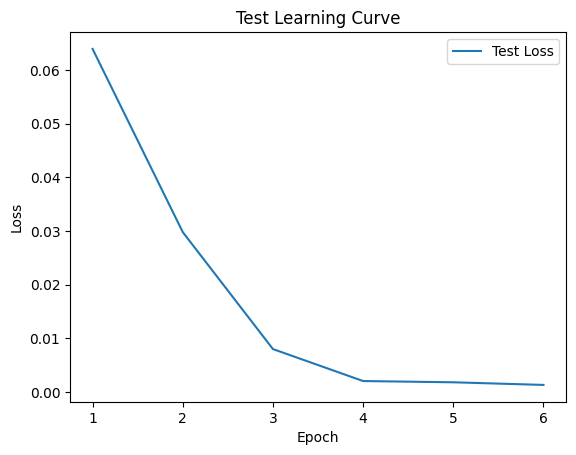


 Epoch: (7/30) Loss = 0.0003380863054189831

 Epoch: (7/30) Loss_rmse = 0.018387123942375183

 Epoch: (7/30) R^2 = 0.7932785153388977

 Epoch: (7/30) MAE = 0.016893163323402405
Spearman correlation coefficient: SignificanceResult(statistic=0.5568917104651057, pvalue=3.8107542165388795e-09)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.726

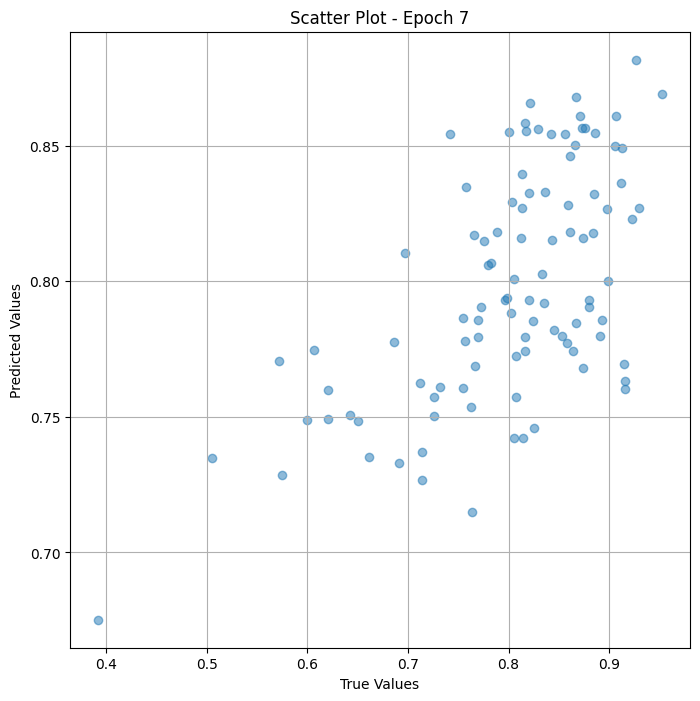

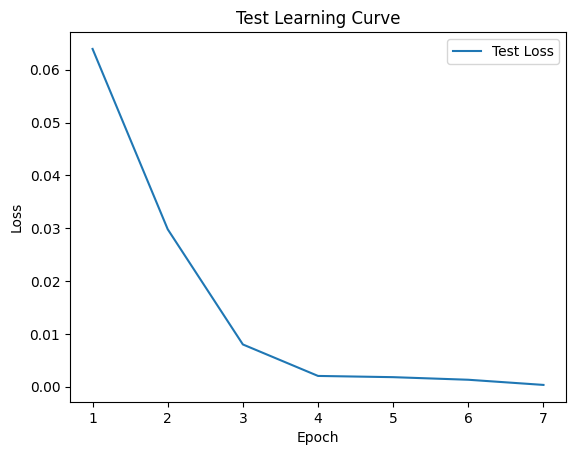


 Epoch: (8/30) Loss = 0.0003298252122476697

 Epoch: (8/30) Loss_rmse = 0.018161090090870857

 Epoch: (8/30) R^2 = 0.7983297109603882

 Epoch: (8/30) MAE = 0.018036484718322754
Spearman correlation coefficient: SignificanceResult(statistic=0.6938170621509491, pvalue=4.6351214300952944e-15)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.726

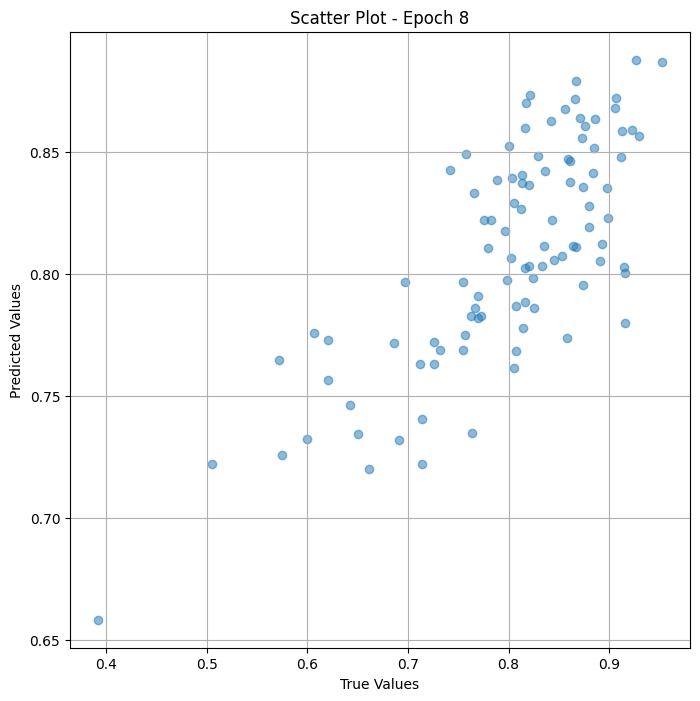

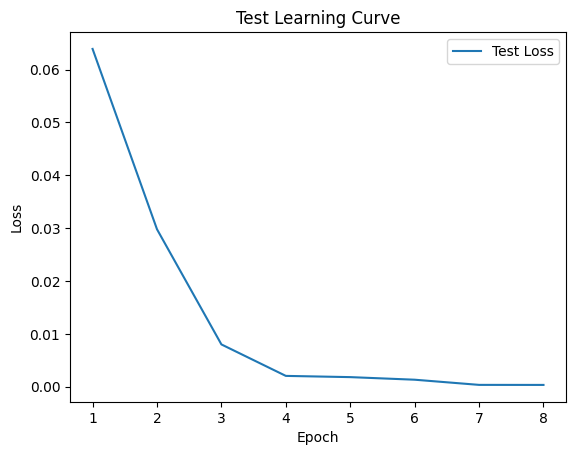


 Epoch: (9/30) Loss = 9.328109445050359e-05

 Epoch: (9/30) Loss_rmse = 0.009658213704824448

 Epoch: (9/30) R^2 = 0.9429636597633362

 Epoch: (9/30) MAE = 0.008063405752182007
Spearman correlation coefficient: SignificanceResult(statistic=0.7643890992170875, pvalue=1.290809826366541e-19)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.7263

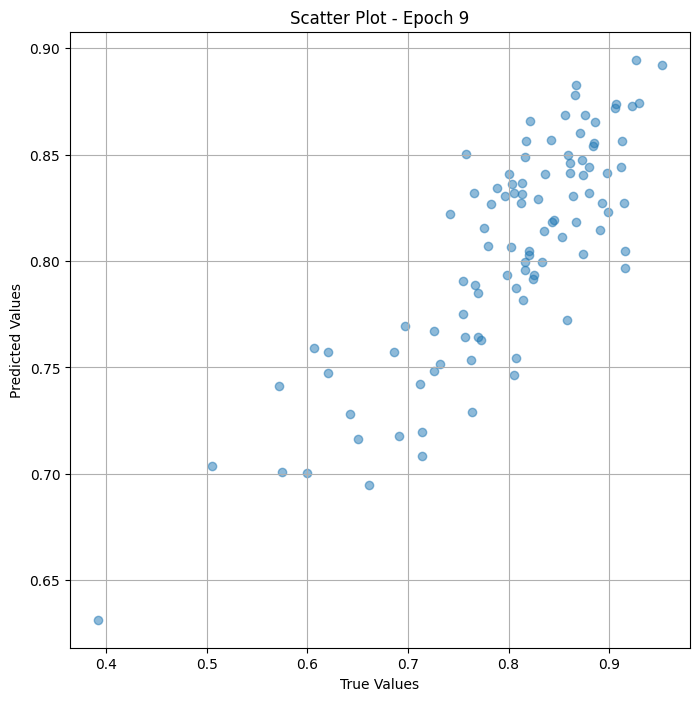

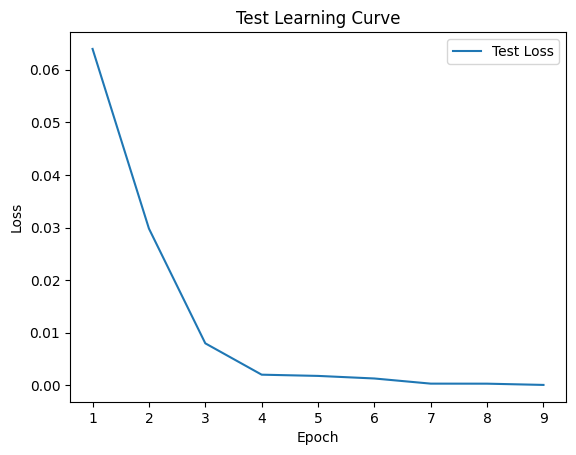


 Epoch: (10/30) Loss = 8.138838165905327e-05

 Epoch: (10/30) Loss_rmse = 0.009021551348268986

 Epoch: (10/30) R^2 = 0.9502354264259338

 Epoch: (10/30) MAE = 0.008632242679595947
Spearman correlation coefficient: SignificanceResult(statistic=0.829779297136803, pvalue=1.526006115167275e-25)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.7

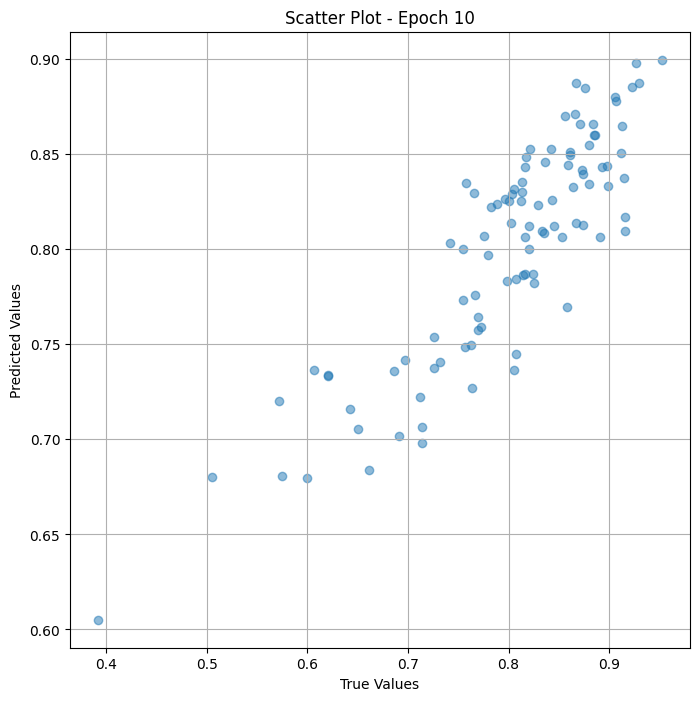

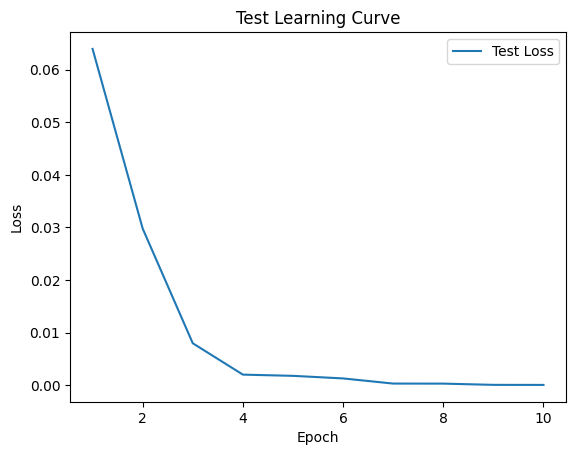


 Epoch: (11/30) Loss = 3.8854152080602944e-05

 Epoch: (11/30) Loss_rmse = 0.0062333098612725735

 Epoch: (11/30) R^2 = 0.9762427806854248

 Epoch: (11/30) MAE = 0.005001351237297058
Spearman correlation coefficient: SignificanceResult(statistic=0.882336982405953, pvalue=1.5782092452388734e-32)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 

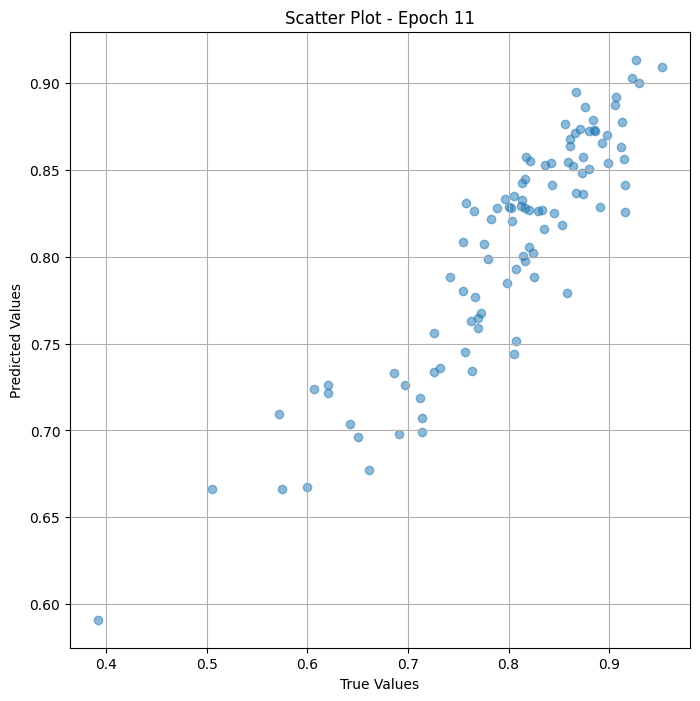

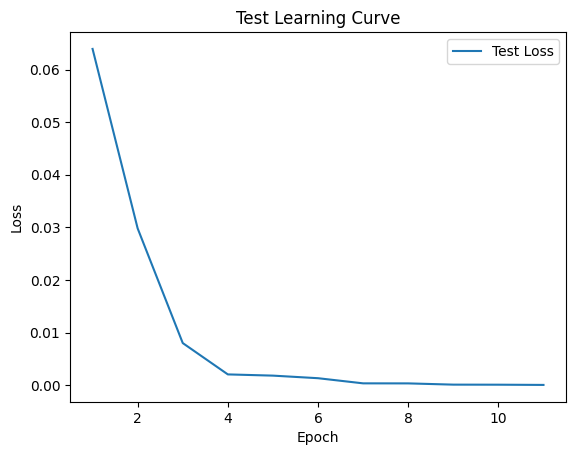


 Epoch: (12/30) Loss = 1.3148533071216661e-05

 Epoch: (12/30) Loss_rmse = 0.00362609070725739

 Epoch: (12/30) R^2 = 0.9919604063034058

 Epoch: (12/30) MAE = 0.003192335367202759
Spearman correlation coefficient: SignificanceResult(statistic=0.9287836243885496, pvalue=2.6617536272881314e-42)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0

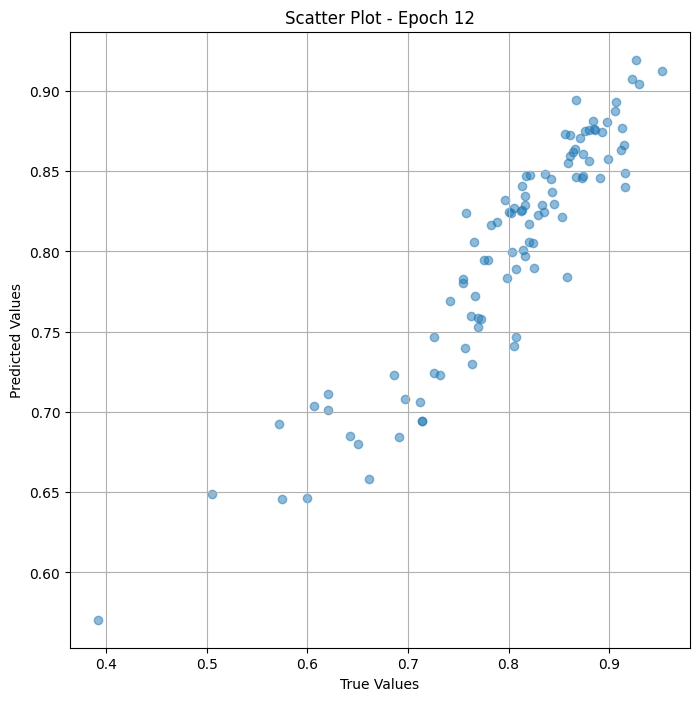

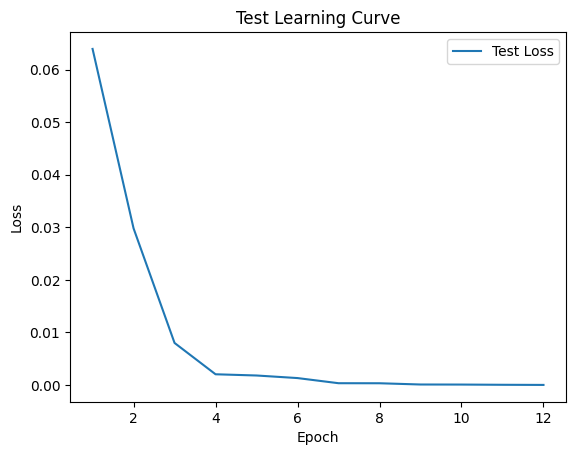


 Epoch: (13/30) Loss = 2.6024849830719177e-06

 Epoch: (13/30) Loss_rmse = 0.0016132219461724162

 Epoch: (13/30) R^2 = 0.9984087347984314

 Epoch: (13/30) MAE = 0.0013616383075714111
Spearman correlation coefficient: SignificanceResult(statistic=0.947639007670036, pvalue=2.174370552091132e-48)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 

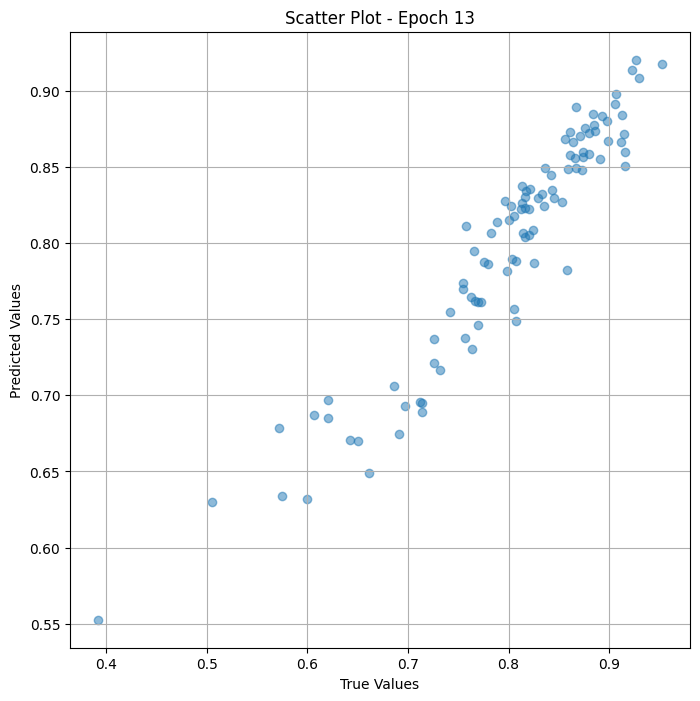

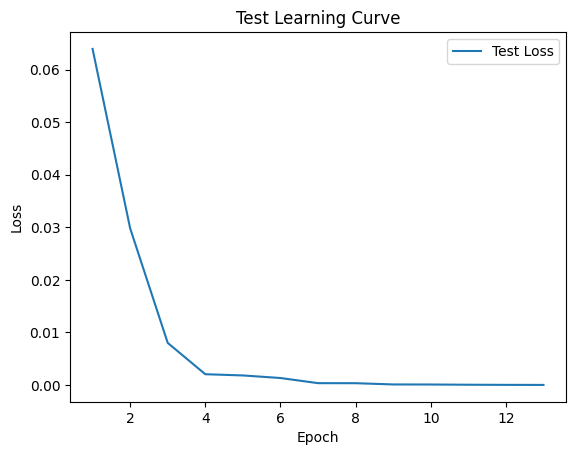


 Epoch: (14/30) Loss = 7.350976375164464e-06

 Epoch: (14/30) Loss_rmse = 0.002711268374696374

 Epoch: (14/30) R^2 = 0.9955052733421326

 Epoch: (14/30) MAE = 0.002363070845603943
Spearman correlation coefficient: SignificanceResult(statistic=0.9640255565938023, pvalue=6.909180544055867e-56)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0.

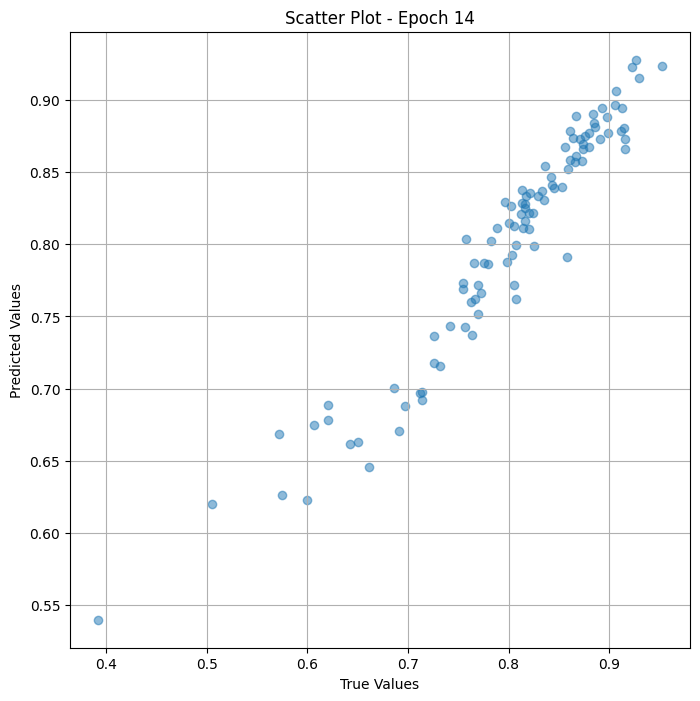

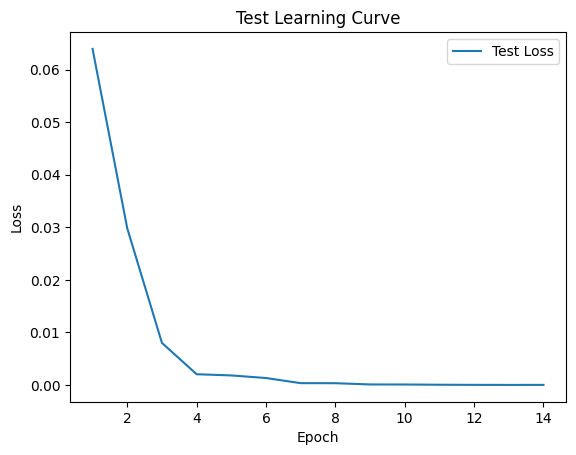


 Epoch: (15/30) Loss = 1.1731914128176868e-05

 Epoch: (15/30) Loss_rmse = 0.0034251881297677755

 Epoch: (15/30) R^2 = 0.9928265810012817

 Epoch: (15/30) MAE = 0.0029885172843933105
Spearman correlation coefficient: SignificanceResult(statistic=0.9765325086697235, pvalue=1.752807192222181e-64)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093,

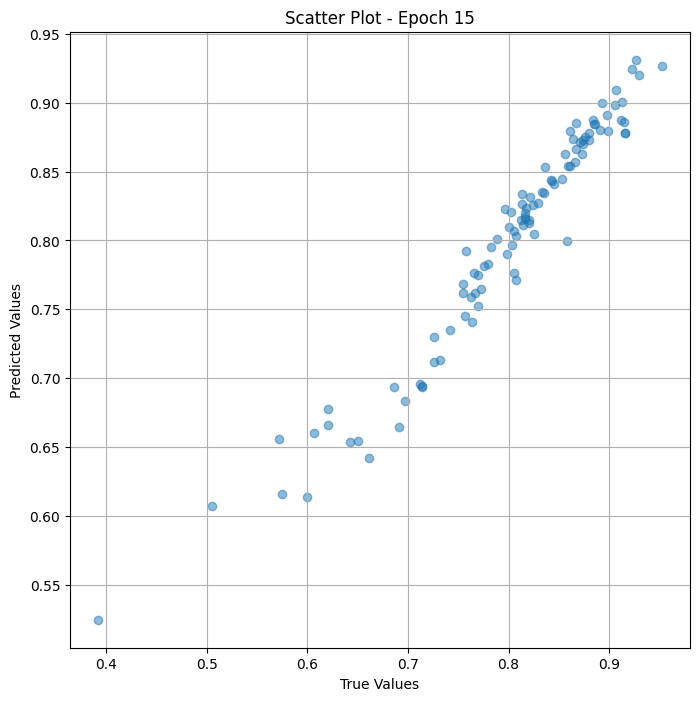

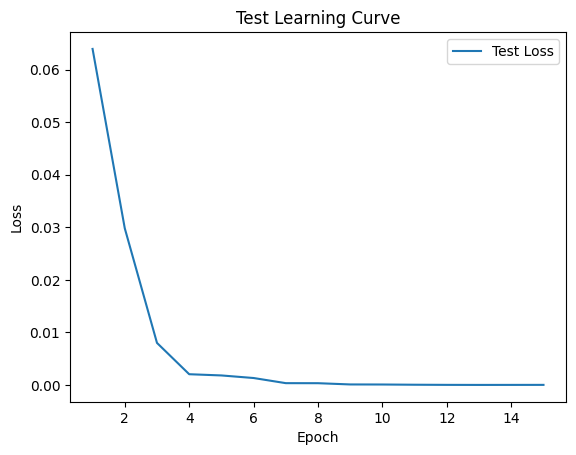

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (16/30) Loss = 1.2023677300021518e-05

 Epoch: (16/30) Loss_rmse = 0.00346751743927598

 Epoch: (16/30) R^2 = 0.992648184299469

 Epoch: (16/30) MAE = 0.002856731414794922
Spearman correlation coefficient: SignificanceResult(statistic=0.9857567249513138, pvalue=1.3883764156992413e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.813725

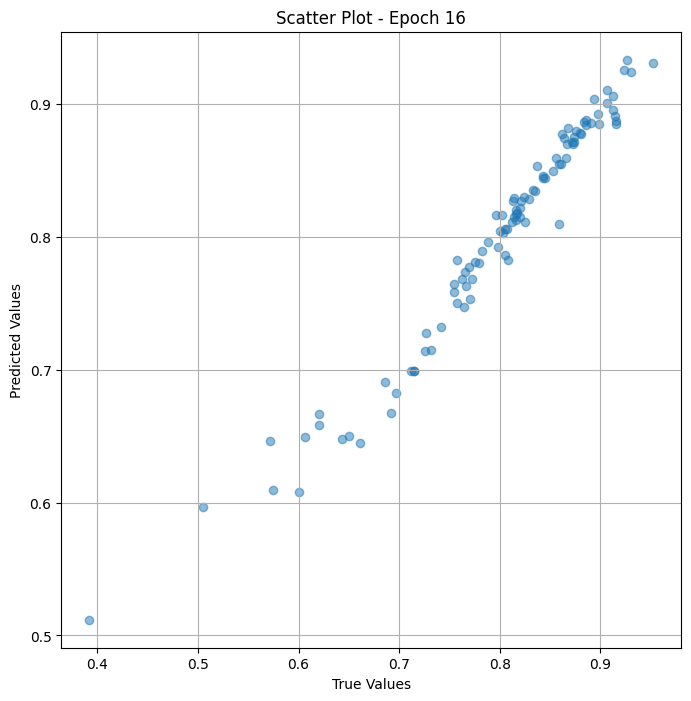

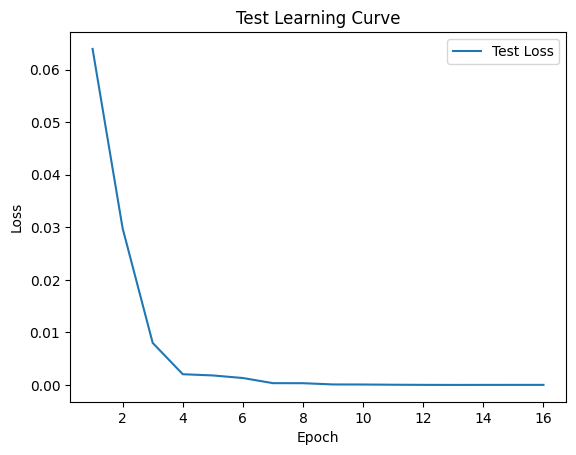


 Epoch: (17/30) Loss = 2.170262177969562e-06

 Epoch: (17/30) Loss_rmse = 0.0014731809496879578

 Epoch: (17/30) R^2 = 0.9986730217933655

 Epoch: (17/30) MAE = 0.0013047009706497192
Spearman correlation coefficient: SignificanceResult(statistic=0.9918135081420933, pvalue=7.90682264406149e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0

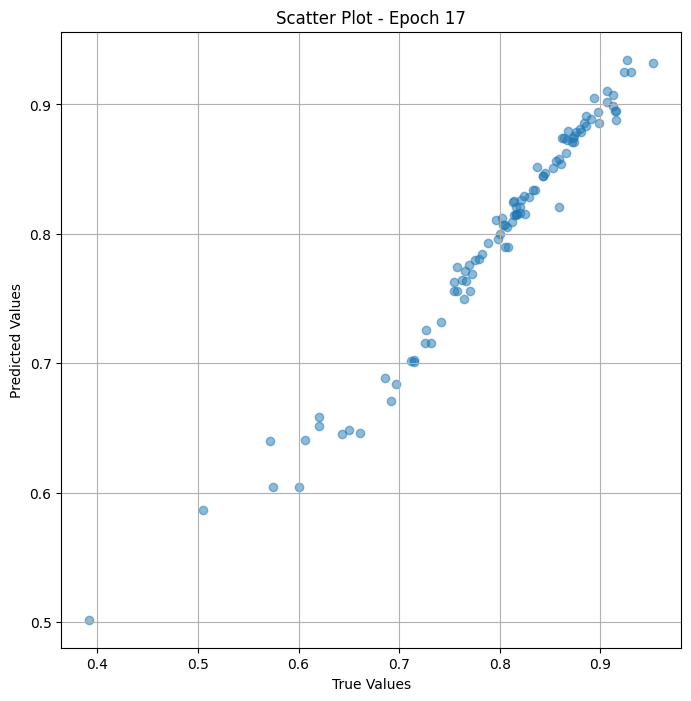

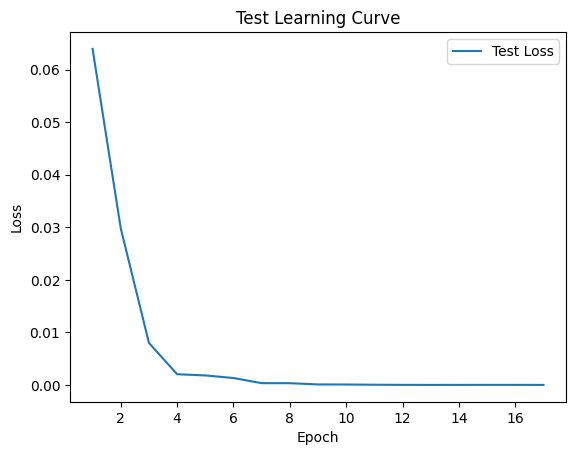


 Epoch: (18/30) Loss = 6.564647492268705e-07

 Epoch: (18/30) Loss_rmse = 0.0008102251449599862

 Epoch: (18/30) R^2 = 0.9995986223220825

 Epoch: (18/30) MAE = 0.0005704760551452637
Spearman correlation coefficient: SignificanceResult(statistic=0.9922068938364552, pvalue=7.88250087539589e-87)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0

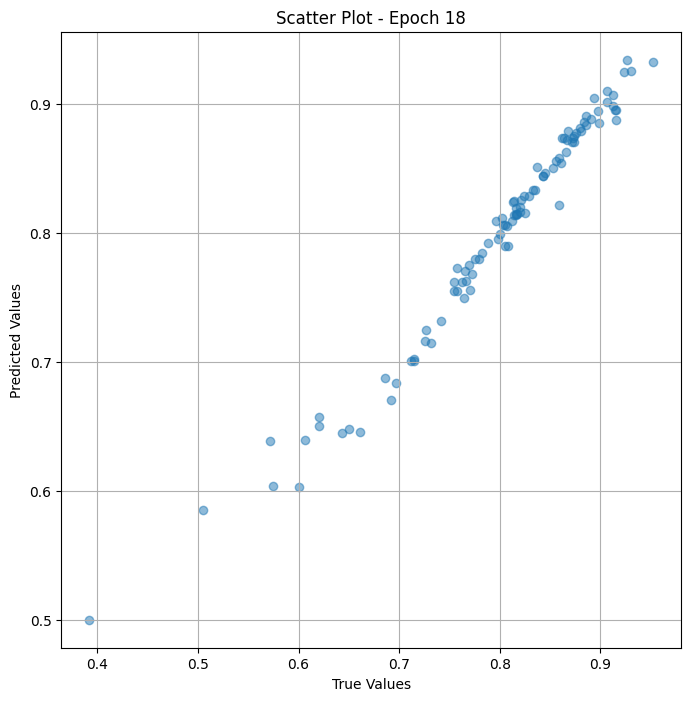

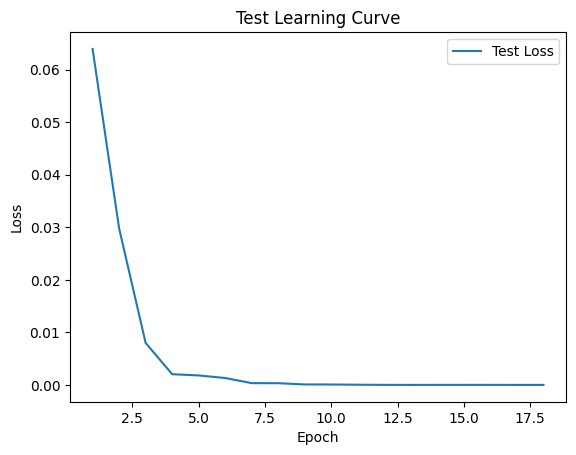


 Epoch: (19/30) Loss = 4.853786208514066e-07

 Epoch: (19/30) Loss_rmse = 0.0006966912187635899

 Epoch: (19/30) R^2 = 0.9997032284736633

 Epoch: (19/30) MAE = 0.0005473792552947998
Spearman correlation coefficient: SignificanceResult(statistic=0.9926138445547609, pvalue=6.396285175916833e-88)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 

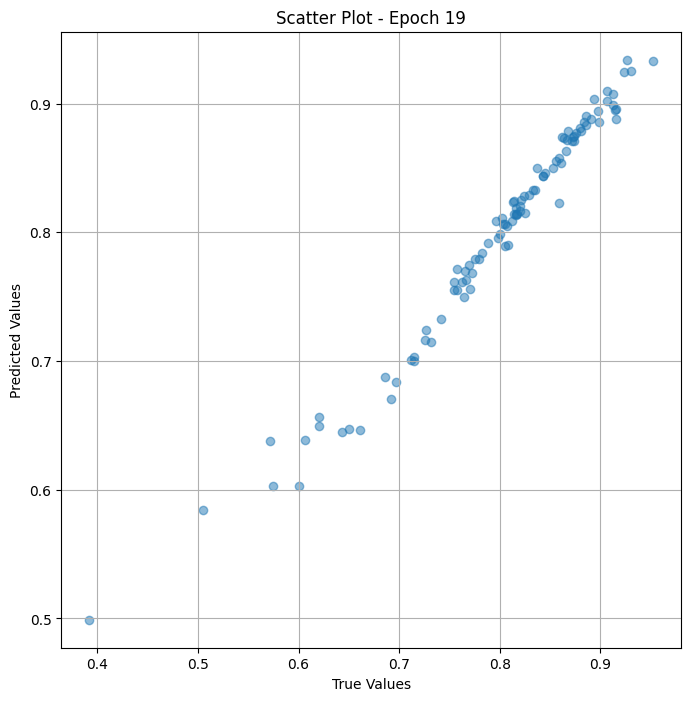

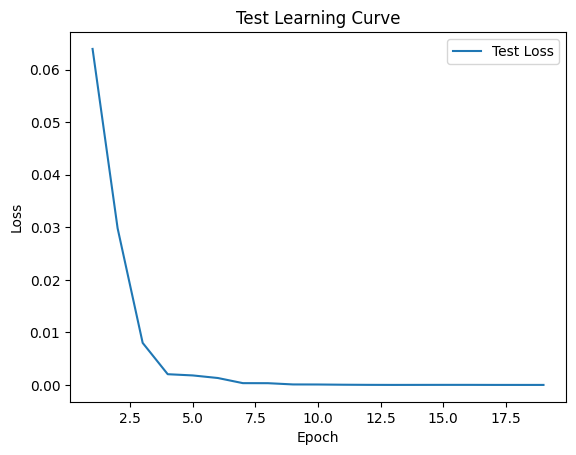


 Epoch: (20/30) Loss = 5.928010295974673e-07

 Epoch: (20/30) Loss_rmse = 0.0007699357229284942

 Epoch: (20/30) R^2 = 0.9996375441551208

 Epoch: (20/30) MAE = 0.000572502613067627
Spearman correlation coefficient: SignificanceResult(statistic=0.9931293154646145, pvalue=2.1593365889992646e-89)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 

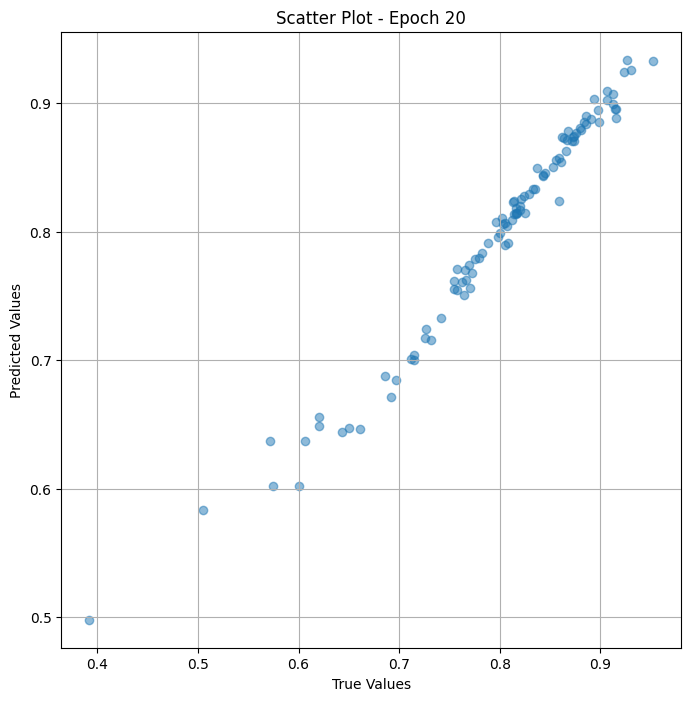

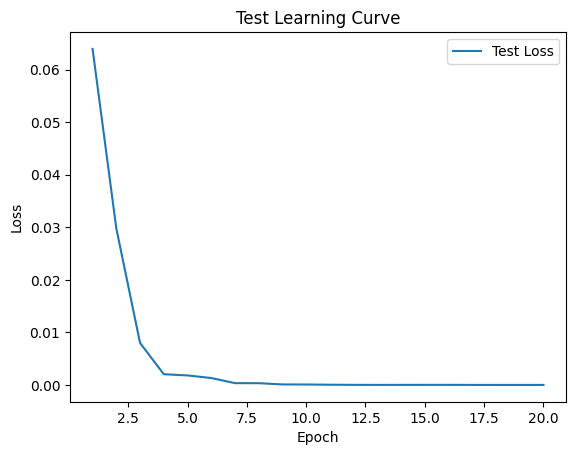


 Epoch: (21/30) Loss = 4.2515335962889367e-07

 Epoch: (21/30) Loss_rmse = 0.0006520378519780934

 Epoch: (21/30) R^2 = 0.9997400641441345

 Epoch: (21/30) MAE = 0.0005218088626861572
Spearman correlation coefficient: SignificanceResult(statistic=0.993251400680106, pvalue=9.32307532332989e-90)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 0

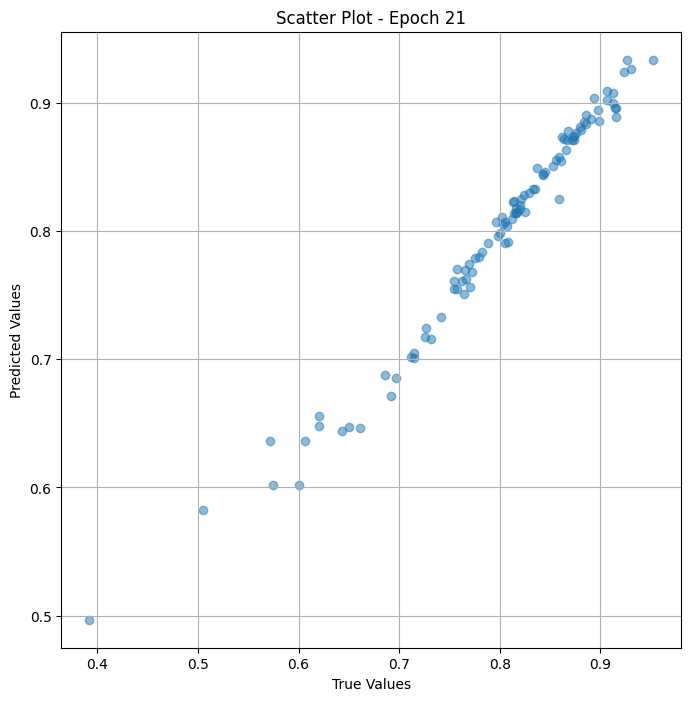

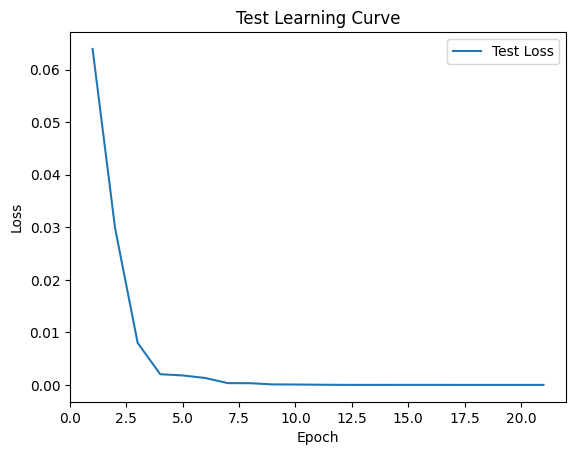


 Epoch: (22/30) Loss = 2.2651941833373712e-07

 Epoch: (22/30) Loss_rmse = 0.0004759405564982444

 Epoch: (22/30) R^2 = 0.999861478805542

 Epoch: (22/30) MAE = 0.0004077404737472534
Spearman correlation coefficient: SignificanceResult(statistic=0.9936583513984115, pvalue=5.058396708540606e-91)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 

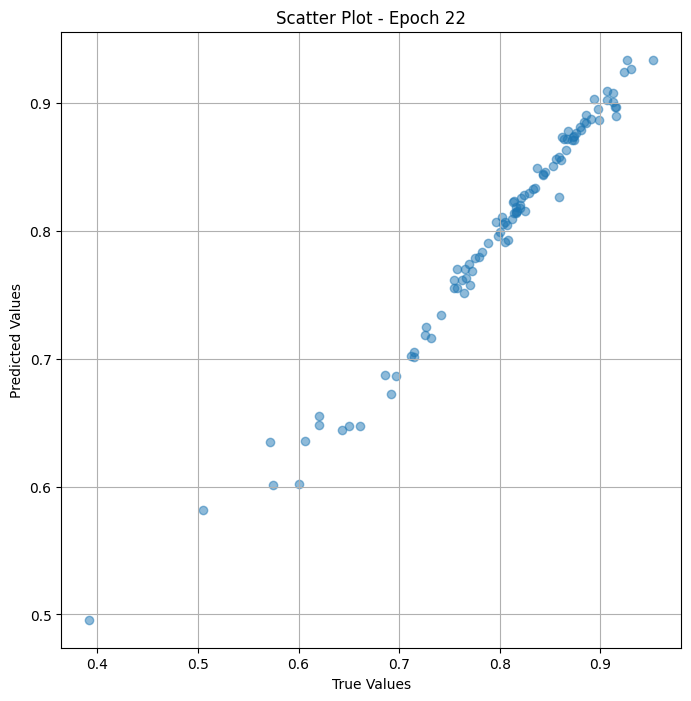

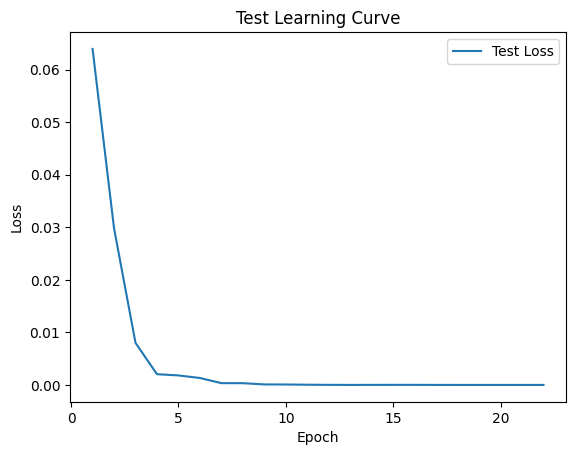


 Epoch: (23/30) Loss = 1.7368884641655313e-07

 Epoch: (23/30) Loss_rmse = 0.00041675992542877793

 Epoch: (23/30) R^2 = 0.9998937845230103

 Epoch: (23/30) MAE = 0.0003180950880050659
Spearman correlation coefficient: SignificanceResult(statistic=0.9938821742934795, pvalue=9.39226057091656e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093,

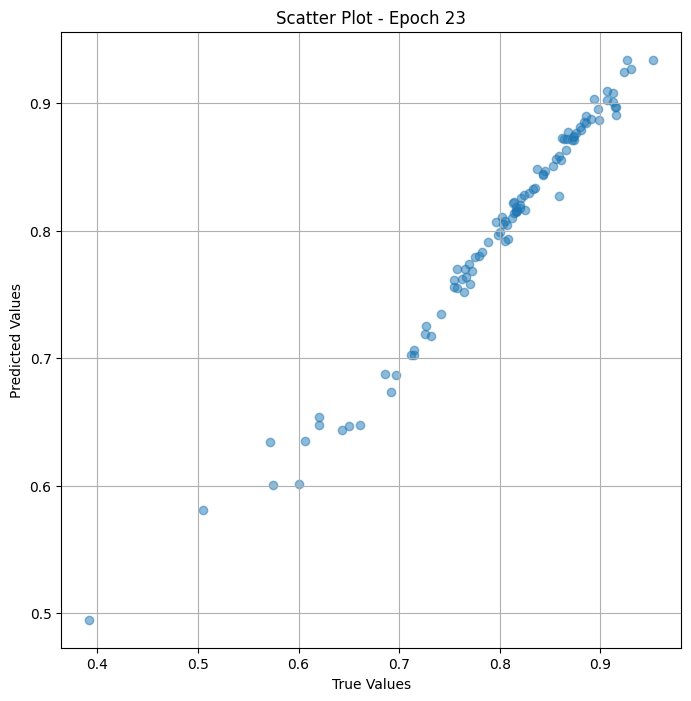

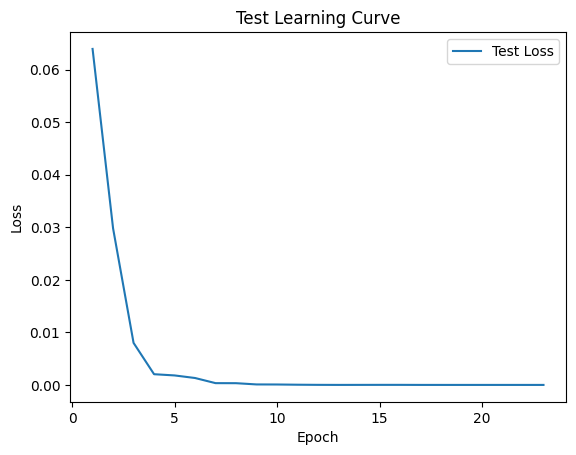


 Epoch: (24/30) Loss = 1.4874993325975083e-07

 Epoch: (24/30) Loss_rmse = 0.00038568113814108074

 Epoch: (24/30) R^2 = 0.9999090433120728

 Epoch: (24/30) MAE = 0.000341951847076416
Spearman correlation coefficient: SignificanceResult(statistic=0.9940788671406604, pvalue=2.0307743764057998e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093

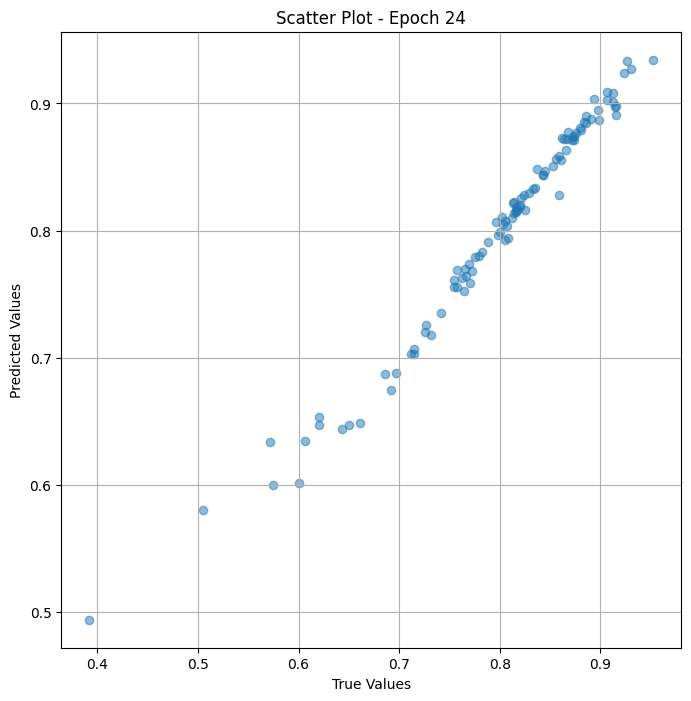

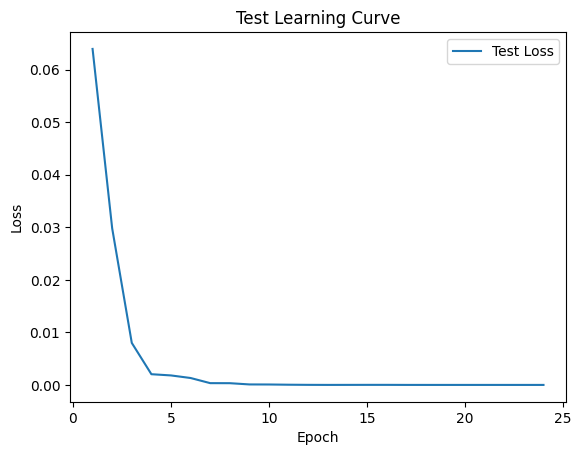


 Epoch: (25/30) Loss = 1.061746033315103e-07

 Epoch: (25/30) Loss_rmse = 0.0003258444485254586

 Epoch: (25/30) R^2 = 0.9999350905418396

 Epoch: (25/30) MAE = 0.0002803504467010498
Spearman correlation coefficient: SignificanceResult(statistic=0.9943433851075592, pvalue=2.384465033784054e-93)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 

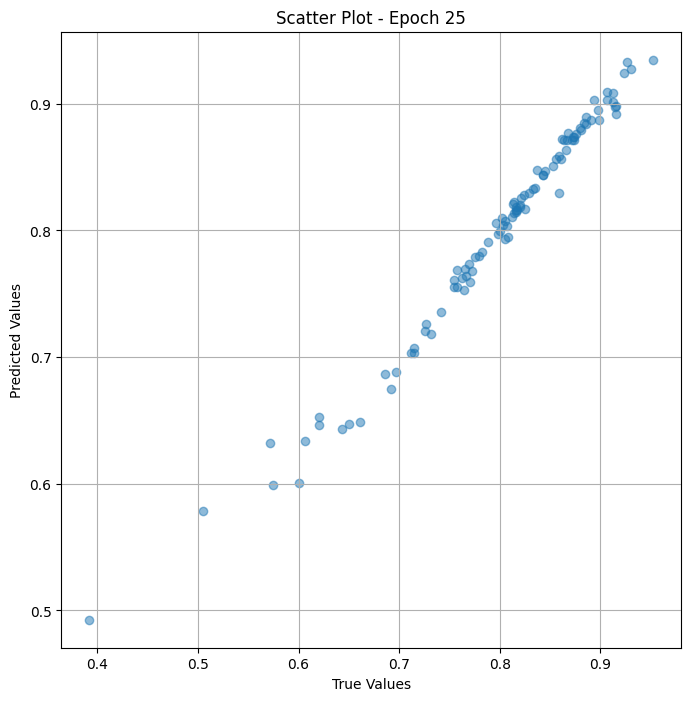

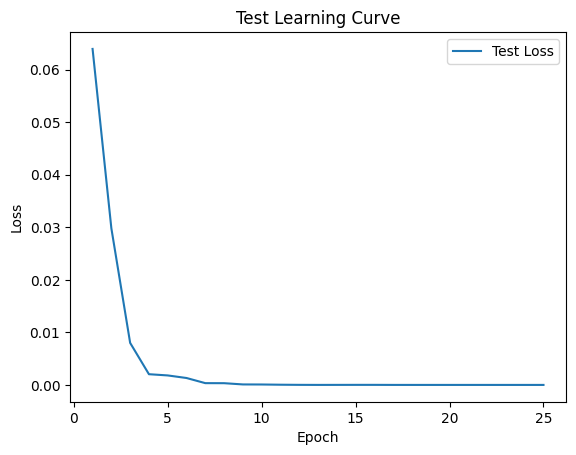


 Epoch: (26/30) Loss = 8.384544258888127e-08

 Epoch: (26/30) Loss_rmse = 0.0002895607613027096

 Epoch: (26/30) R^2 = 0.9999487400054932

 Epoch: (26/30) MAE = 0.00027532875537872314
Spearman correlation coefficient: SignificanceResult(statistic=0.994485817858966, pvalue=7.215045023284216e-94)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 

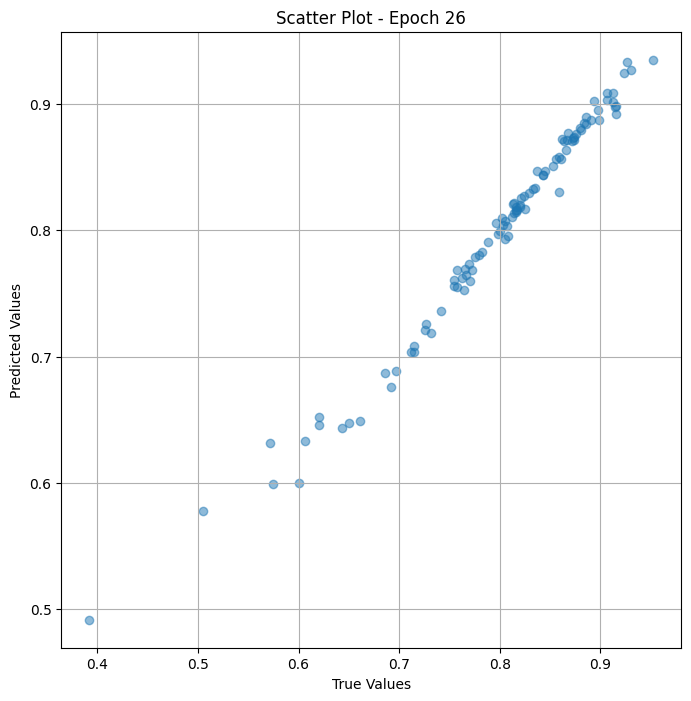

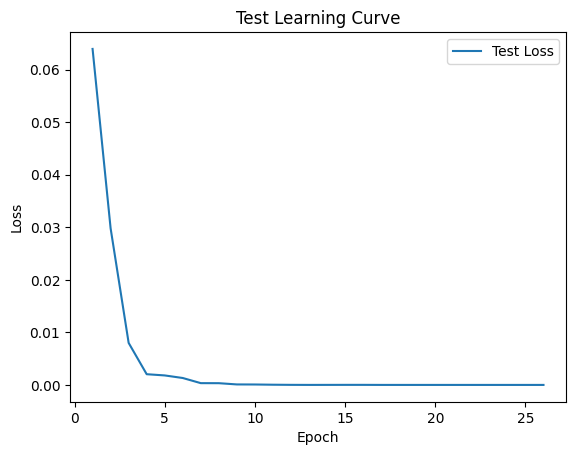


 Epoch: (27/30) Loss = 8.659029049340461e-08

 Epoch: (27/30) Loss_rmse = 0.0002942622813861817

 Epoch: (27/30) R^2 = 0.9999470710754395

 Epoch: (27/30) MAE = 0.000255391001701355
Spearman correlation coefficient: SignificanceResult(statistic=0.9946825107061468, pvalue=1.3145198195057579e-94)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 

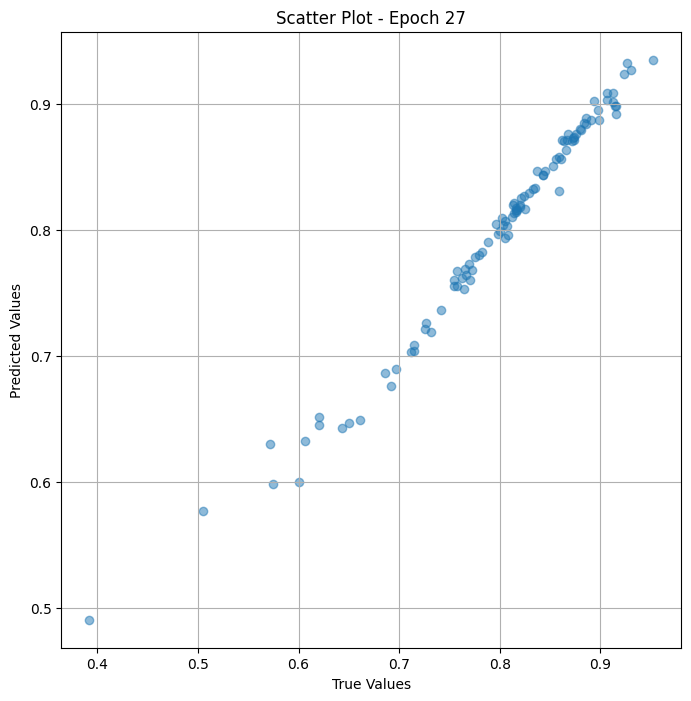

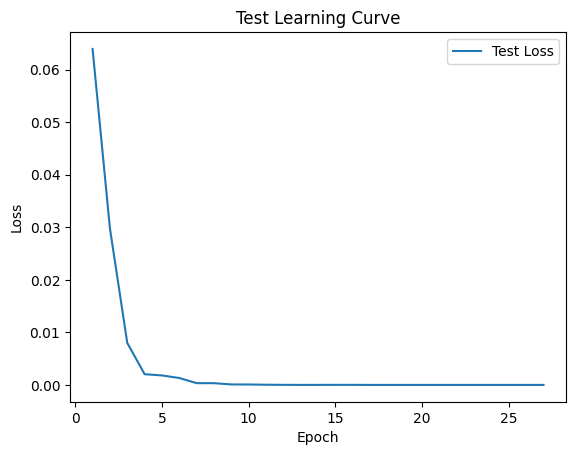


 Epoch: (28/30) Loss = 8.561983833033082e-08

 Epoch: (28/30) Loss_rmse = 0.0002926086890511215

 Epoch: (28/30) R^2 = 0.9999476671218872

 Epoch: (28/30) MAE = 0.0002356022596359253
Spearman correlation coefficient: SignificanceResult(statistic=0.9948588560174125, pvalue=2.7045434362856707e-95)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093,

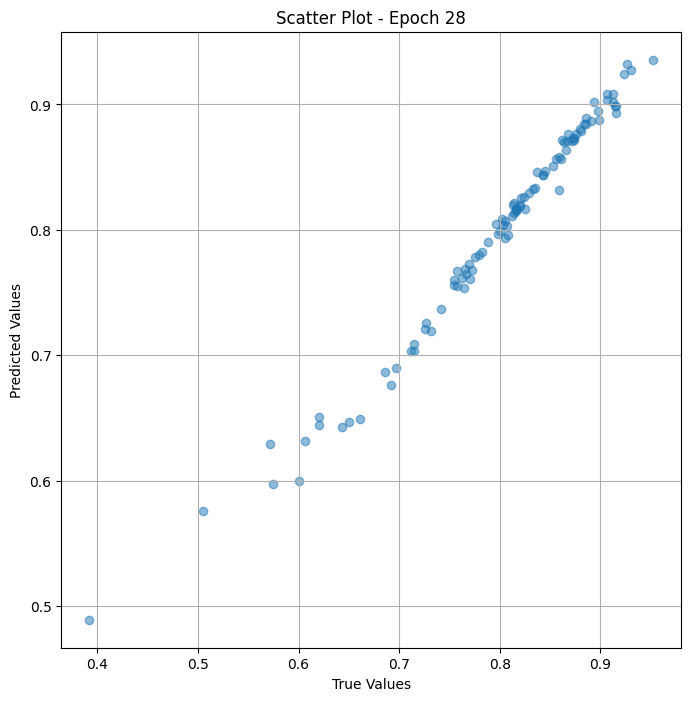

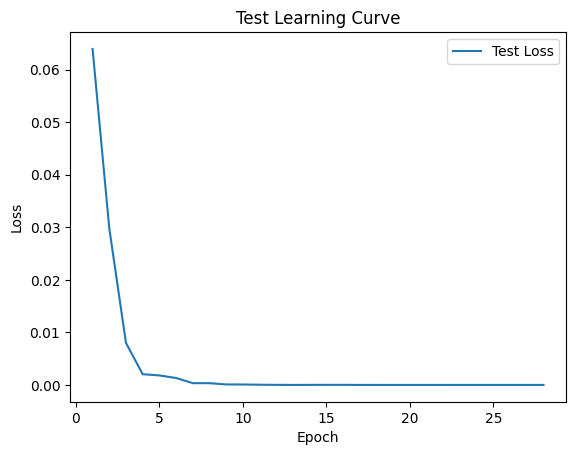


 Epoch: (29/30) Loss = 7.568364424059837e-08

 Epoch: (29/30) Loss_rmse = 0.0002751066058408469

 Epoch: (29/30) R^2 = 0.9999537467956543

 Epoch: (29/30) MAE = 0.0002330988645553589
Spearman correlation coefficient: SignificanceResult(statistic=0.9951437215202265, pvalue=1.8678680798306725e-96)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093,

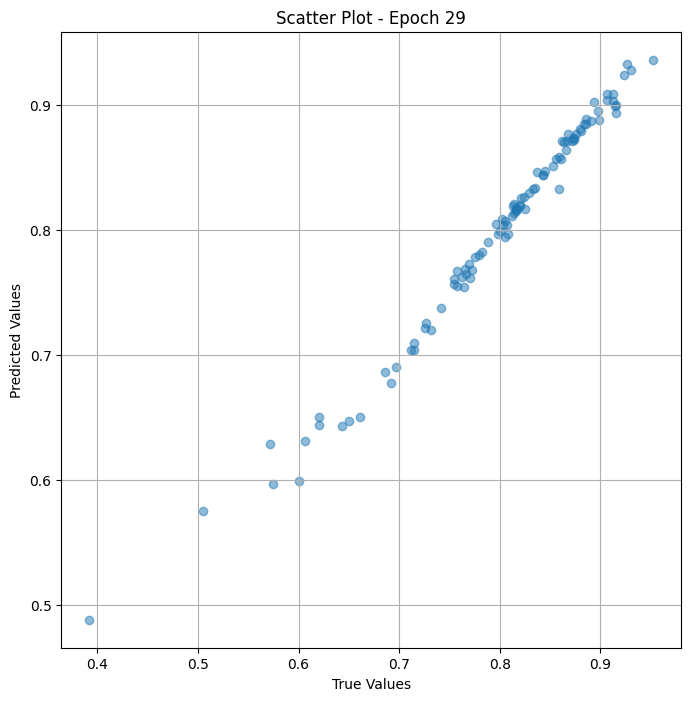

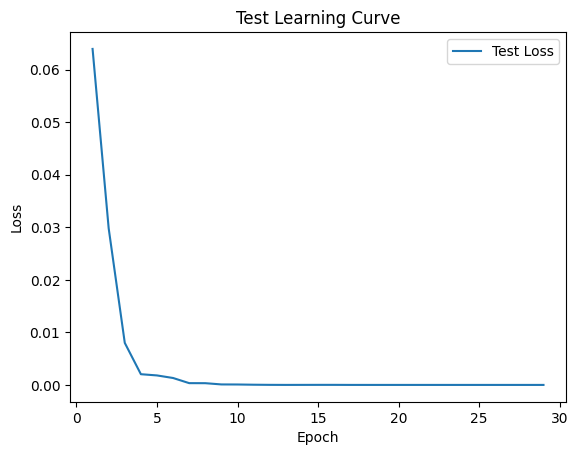


 Epoch: (30/30) Loss = 7.078178043684602e-08

 Epoch: (30/30) Loss_rmse = 0.0002660484460648149

 Epoch: (30/30) R^2 = 0.9999567270278931

 Epoch: (30/30) MAE = 0.0002473890781402588
Spearman correlation coefficient: SignificanceResult(statistic=0.9954828471188143, pvalue=6.266820406624203e-98)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8857143, 0.8736842, 0.9148936, 0.8909091, 0.8210526, 0.88, 0.81609195, 0.85858583, 0.7570093, 0.7798165, 0.75757575, 0.77011496, 0.8453608, 0.7980769, 0.8974359, 0.8252427, 0.91566265, 0.6862745, 0.7826087, 0.8, 0.8348624, 0.79611653, 0.75454545, 0.8586956, 0.8613861, 0.9263158, 0.86585367, 0.8803419, 0.8636364, 0.86725664, 0.76635516, 0.50526315, 0.89320385, 0.8202247, 0.7757009, 0.8125, 0.7117117, 0.8557692, 0.69148934, 0.9230769, 0.6972477, 0.90697676, 0.8076923, 0.8674699, 0.93, 0.80508476, 0.8854167, 0.62068963, 0.872549, 0.71428573, 0.8137255, 0.853211, 0.39215687, 0.8072289, 0.8173077, 0.88372093, 

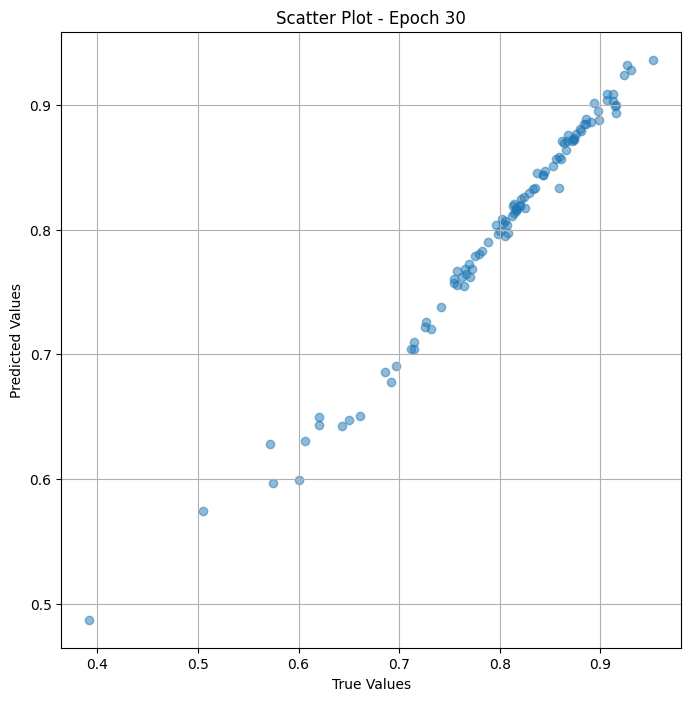

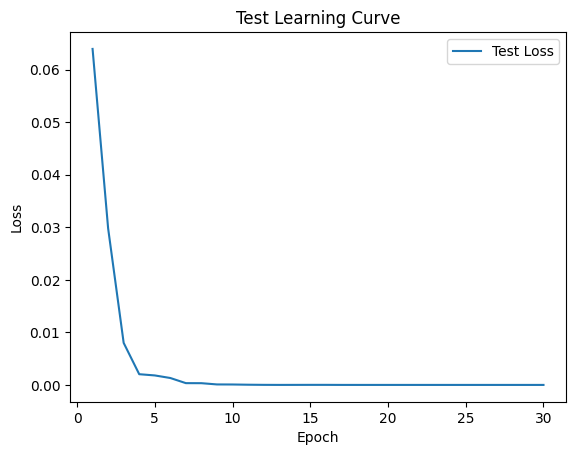

In [ ]:
# val the model and save weights
fit(30,model_res_test , test_dl )
torch.save(model_res_test.state_dict(), "model_weights_s")

In [ ]:
true_values_list_test = []
predicted_values_list_test = []

for x_trans, yb in test_dl:
    preds = model_res_test(x_trans)
    true_values_list_test.extend(yb.cpu().detach().numpy())
    predicted_values_list_test.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_animal' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result_fine = pd.DataFrame({
    'Image Path': df_test_animal['preprocessed_image_path'],
    'True Value': true_values_list_test,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_test # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result_fine)

                                         Image Path  True Value  \
0   /content/animal/n01846331_1102_preprocessed.jpg    0.885714   
1   /content/animal/n01846331_2820_preprocessed.jpg    0.873684   
2    /content/animal/n02118333_329_preprocessed.jpg    0.914894   
3     /content/animal/000000144157_preprocessed.jpg    0.890909   
4     /content/animal/000000140360_preprocessed.jpg    0.821053   
..                                              ...         ...   
95  /content/animal/n01846331_6225_preprocessed.jpg    0.650000   
96  /content/animal/n02129165_5082_preprocessed.jpg    0.828829   
97  /content/animal/n01811909_5541_preprocessed.jpg    0.820225   
98    /content/animal/000000257214_preprocessed.jpg    0.876106   
99    /content/animal/000000551602_preprocessed.jpg    0.762295   

    Predicted Value  
0          0.876642  
1          0.875590  
2          0.889046  
3          0.867599  
4          0.820864  
..              ...  
95         0.649828  
96         0.828869

# ทดสอบกับรูปอื่นๆ

In [ ]:
model = Resmem_model_fine_animal()
image = Image.open("/content/food/000000000438.jpg")

# Define preprocessing transforms
preprocess = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize to match the input size expected by the model
    transforms.ToTensor(),           # Convert to a PyTorch tensor
    #transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0])  # Normalize the image
])

# Apply preprocessing transforms
input_data = preprocess(image)

# Add batch dimension as the model expects a batch
input_data = input_data.unsqueeze(0)

# Assuming ViTMem_model is a PyTorch model
model = Resmem_model_fine_animal()
memorability = model(input_data)

print(f"Estimated memorability: {memorability}")



Estimated memorability: tensor([[0.5113]], grad_fn=<SigmoidBackward0>)
